#Import Data ༼ つ ◕_◕ ༽つ

In [ ]:
import pandas as pd
import gdown
try:
  import py7zr
except:
  !pip install py7zr
  import py7zr
import os
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import warnings; warnings.simplefilter('ignore')

In [ ]:
#Download Data Drive

url = "https://drive.google.com/uc?id=1JnGbYeXyuWZfbfOfC6bDj7wAwE4dUbF1"

path = '/content/data.csv'

try:
  df = pd.read_csv(path, sep=';')

except:
  gdown.download(url, path, quiet=False)
  df = pd.read_csv(path, sep=';')

Data sudah diubah ke csv secara manual di PC kami, lalu diupload ke google drive untuk mempercepat pembacaan file dibandingkan xlsx.

In [ ]:
df = df.drop_duplicates()

Memastikan data sudah bebas dari observasi duplikat.

In [ ]:
df.set_index('ID', inplace=True)
df.head()

,WILAYAH,JENIS KELAMIN,USIA,LAMA BERDINAS,PENDIDIKAN TERAKHIR,TINGGI BADAN,BERAT BADAN,LINGKAR PINGGANG,Status Perkawinan,PENGELUARAN/BULAN,...,Sumber air bersih di tempat tinggal saudara ?,Penggunaan air bersih untuk makan & minum bersumber dari :,Berapa jarak jamban dengan sumur dirumah saudara ?,Bagaimana saluran pembuangan air (sanitasi) rumah tangga?,Apakah terdapat tempat sampah di sekitar rumah?,Berapa jarak tempat sampah dengan rumah saudara ?,Apakah di sekitar tempat tinggal Saudara tersedia fasilitas umum (fasum) untuk kegiatan/aktivitas olah raga?,Kelompok Umur,NILAI IMT,IMT
ID,,,,,,,,,,,,,,,,,,,,,
1,KALBAR,LAKI - LAKI,34.0,16.0,SMA,"168,9",85,100.0,Menikah,Rp. 7 Juta s.d. 10 Juta,...,Air PAM,Tadah hujan,Lebih dari 12 meter,Ada,"Ada, terbuka",Lebih dari 10 meter,Tidak ada,25 - 34,"29,80",Obesitas
2,KALBAR,LAKI - LAKI,43.0,23.0,SMA,"169,5",70,80.0,Menikah,Rp. 2 Juta s.d. 6 Juta,...,Air PAM,Air mineral isi ulang,Lebih dari 12 meter,Ada,"Ada, tertutup",Lebih dari 10 meter,Tidak ada,35 - 44,"24,36",Normal
3,KALBAR,LAKI - LAKI,21.0,1.0,SMA,"169,5",60,78.0,Belum Menikah,Rp. 2 Juta s.d. 6 Juta,...,Air PAM,Air mineral isi ulang,Tidak memiliki jamban sehat,Ada,Tidak ada,NaN,Tidak ada,15 - 24,"20,88",Normal
4,KALBAR,LAKI - LAKI,40.0,23.0,S2,"166,8",80,34.0,Menikah,Rp. 7 Juta s.d. 10 Juta,...,Air PAM,Air mineral isi ulang,Tidak memiliki jamban sehat,Ada,"Ada, tertutup",Lebih dari 10 meter,Tidak ada,35 - 44,"28,75",Obesitas
5,KALBAR,LAKI - LAKI,28.0,9.0,SMA,"164,5",62,32.0,Menikah,Rp. 2 Juta s.d. 6 Juta,...,Air PAM,Air mineral isi ulang,Lebih dari 12 meter,Ada,"Ada, tertutup",Lebih dari 10 meter,Ada,25 - 34,"22,91",Normal


In [ ]:
df.shape

(289801, 78)

#Preprocessing (ﾉ◕ヮ◕)ﾉ*:･ﾟ✧

##Column Names (╯°□°）╯︵ ┻━┻
---
Membersihkan nama-nama kolom

Mengstandarisasi nama kolom dengan membuat setiap nama kolom menjadi huruf kecil

In [ ]:
df.columns = df.columns.str.lower()
df.columns

Index(['wilayah', 'jenis kelamin', 'usia', 'lama berdinas',
       'pendidikan terakhir', 'tinggi badan', 'berat badan',
       'lingkar pinggang', 'status perkawinan', 'pengeluaran/bulan',
       'apakah saudara pernah di diagnosa atau menderita penyakit jantung ?',
       'apakah saudara pernah di diagnosa atau menderita penyakit stroke ?',
       'apakah saudara pernah di diagnosa atau menderita penyakit diabetes melitus ?',
       'apakah saudara pernah di diagnosa atau menderita penyakit hipertensi ?',
       'apakah saudara pernah di diagnosa atau menderita penyakit kanker ?',
       'apakah saudara pernah di diagnosa atau menderita penyakit ginjal ?',
       'apakah saudara pernah di diagnosa atau menderita penyakit tumor ?',
       'apakah saudara pernah di diagnosa atau menderita penyakit osteoartritis ?',
       'apakah saudara pernah di diagnosa atau menderita penyakit lambung ?',
       'apakah saudara pernah di diagnosa atau menderita penyakit liver ?',
       'apakah saud

Menghilangkan kata-kata yang sifatnya repetifif dan kurang penting secara kontekstual

In [ ]:
substrings_to_remove = ["apakah saudara pernah di diagnosa atau menderita",
                       "?", "merasa", " - ", "  ", "mengalami"]
for substring in substrings_to_remove:
  df.columns = df.columns.str.replace(substring, '')
df.columns = df.columns.str.strip()
df.columns

Index(['wilayah', 'jenis kelamin', 'usia', 'lama berdinas',
       'pendidikan terakhir', 'tinggi badan', 'berat badan',
       'lingkar pinggang', 'status perkawinan', 'pengeluaran/bulan',
       'penyakit jantung', 'penyakit stroke', 'penyakit diabetes melitus',
       'penyakit hipertensi', 'penyakit kanker', 'penyakit ginjal',
       'penyakit tumor', 'penyakit osteoartritis', 'penyakit lambung',
       'penyakit liver', 'penyakittuberculosis (tbc)',
       'penyakitdemam berdarah dengue (dbd)', 'penyakitcovid-19',
       'penyakithiv/aids', 'penyakitdiare', 'penyakitmalaria',
       'penyakitgonore atau sipilis', 'penyakitthypus',
       'penyakitdermatitis (skabies)/ peradangan atau iritasi kulit',
       'penyakitmikosis (infeksi jamur)', 'sering menderita sakit kepala',
       'tidak nafsu makan', 'sulit tidur', 'mudah takut',
       'tegang, cemas atau kuatir', 'tangan anda gemetar',
       'pencernaan anda terganggu / buruk', 'sulit untuk berpikir jernih',
       'tidak bahag

In [ ]:
column_name_mapping = {
  "apakah saudara pernah di diagnosa atau menderita": "diagnosa_menderita",
  "penyakittuberculosis (tbc)": "penyakit_tbc",
  "penyakitdemam berdarah dengue (dbd)": "penyakit_dbd",
  "penyakitcovid-19": "penyakit_covid19",
  "penyakithiv/aids": "penyakit_hiv_aids",
  "penyakitdiare": "penyakit_diare",
  "penyakitmalaria": "penyakit_malaria",
  "penyakitgonore atau sipilis": "penyakit_gonore_sipilis",
  "penyakitthypus": "penyakit_thypus",
  "penyakitdermatitis (skabies)/ peradangan atau iritasi kulit": "penyakit_dermatitis",
  "penyakitmikosis (infeksi jamur)": "penyakit_mikosis",
  "sering menderita sakit kepala": "sakit_kepala",
  "pendidikan terakhir": "pendidikan",
  "tinggi badan": "tinggi",
  "berat badan": "berat",
  "lingkar pinggang": "lingkar_pinggang",
  "status perkawinan": "status_kawin",
  "pengeluaran/bulan": "pengeluaran",
  "sering menderita sakit kepala": "sakit_kepala",
  'pencernaan anda terganggu / buruk': 'masalah_pencernaan',
  'pekerjaan anda sehari – hari terganggu': 'pekerjaan_terganggu',
  'kehilangan minat pada berbagai hal': 'hilang_minat',
  'tidakberharga': 'tidak_berharga',
  'mempunyai pikiran untuk mengakhiri hidup': 'ingin_bundir',
  "apakah saudara menderita penyakit gigi dan mulut (karies/gigi berlubang)": "penyakit_gigi",
  "jika ya berapa jumlah gigi saudara yang karies": "(jk)jumlah_gigi_karies",
  "berapa kali saudara olahraga/aktifitas fisik selama seminggu": "olahraga/minggu",
  'seberapa banyak saudara mengkonsumsi air mineral dalam satu hari': "minum_air",
  'seberapa sering saudara mengkonsumsi buah dan sayur dalam sehari': "buah_sayur",
  'dalam 1 hari berapa kali saudara mandi/ mencuci badan': "mandi",
  'berapa lama saudara mandi': 'durasi_mandi',
  'apakah saudara merokok': 'merokok',
  'jika ya, berapa batang saudara merokok dalam sehari': '(jk)jumlah_rokok_per_hari',
  'seberapa banyak saudara mengkonsumsi gula/pemanis setiap harinya': 'konsumsi_gula_harian',
  'seberapa banyak saudara mengkonsumsi alkohol setiap hari': 'konsumsi_alkohol_harian',
  'seberapa banyak saudara mengkonsumsi makanan-makanan junk food dan berminyak dalam sehari': 'konsumsi_junk_food_harian',
  'dalam satu hari berapa kali saudara membersihkan/ menggosok gigi': 'frekuensi_menggosok_gigi_per_hari',
  'berapa lama saudara menggosok gigi': 'durasi_menggosok_gigi',
  'dalam sehari, berapa kali saudara mengganti pakaian dalam': 'frekuensi_ganti_pakaian_dalam_per_hari',
  'apakah saudara selalu mencuci tangan dengan air bersih dan sabun sebelum makan': 'cuci_tangan_sebelum_makan',
  'apakah tempat tinggal saudara mempunyai penghawaan/sirkulasi udara yang cukup': 'penghawaan_cukup',
  'apakah lingkungan tempat tinggal saudara saat ini terkontaminasi/ terganggu akibat polusi udara yang tidak sehat': 'kontaminasi_udara',
  'sumber air bersih di tempat tinggal saudara': 'sumber_air_bersih',
  'penggunaan air bersih untuk makan & minum bersumber dari :': 'sumber_air_makan_minum',
  'berapa jarak jamban dengan sumur dirumah saudara': 'jarak_jamban_sumur',
  'bagaimana saluran pembuangan air (sanitasi) rumah tangga': 'saluran_pembuangan_air',
  'apakah terdapat tempat sampah di sekitar rumah': 'ada_tempat_sampah',
  'berapa jarak tempat sampah dengan rumah saudara': 'jarak_tempat_sampah',
  'apakah di sekitar tempat tinggal saudara tersedia fasilitas umum (fasum) untuk kegiatan/aktivitas olah raga': 'fasilitas_olahraga',
}

df = df.rename(columns=column_name_mapping)
df.columns = df.columns.str.replace(' – ', '_')
df.columns = df.columns.str.replace(' ', '_')
df.columns

Index(['wilayah', 'jenis_kelamin', 'usia', 'lama_berdinas', 'pendidikan',
       'tinggi', 'berat', 'lingkar_pinggang', 'status_kawin', 'pengeluaran',
       'penyakit_jantung', 'penyakit_stroke', 'penyakit_diabetes_melitus',
       'penyakit_hipertensi', 'penyakit_kanker', 'penyakit_ginjal',
       'penyakit_tumor', 'penyakit_osteoartritis', 'penyakit_lambung',
       'penyakit_liver', 'penyakit_tbc', 'penyakit_dbd', 'penyakit_covid19',
       'penyakit_hiv_aids', 'penyakit_diare', 'penyakit_malaria',
       'penyakit_gonore_sipilis', 'penyakit_thypus', 'penyakit_dermatitis',
       'penyakit_mikosis', 'sakit_kepala', 'tidak_nafsu_makan', 'sulit_tidur',
       'mudah_takut', 'tegang,_cemas_atau_kuatir', 'tangan_anda_gemetar',
       'masalah_pencernaan', 'sulit_untuk_berpikir_jernih', 'tidak_bahagia',
       'menangis_lebih_sering', 'sulit_untuk_menikmati_kegiatan_sehari_hari',
       'sulit_untuk_mengambil_keputusan', 'pekerjaan_terganggu',
       'tidak_mampu_melakukan_hal_hal_yang_

##Data Types (╯°□°）╯︵ ┻━┻
---
Membuat data type menjadi konsisten

###Part 1

In [ ]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None, 'display.max_colwidth', None):
    print(df.dtypes)

wilayah                                                       object
jenis_kelamin                                                 object
usia                                                         float64
lama_berdinas                                                 object
pendidikan                                                    object
tinggi                                                        object
berat                                                         object
lingkar_pinggang                                             float64
status_kawin                                                  object
pengeluaran                                                   object
penyakit_jantung                                              object
penyakit_stroke                                               object
penyakit_diabetes_melitus                                     object
penyakit_hipertensi                                           object
penyakit_kanker                   

In [ ]:
df['jenis_kelamin'].unique()

array(['LAKI - LAKI', 'PEREMPUAN'], dtype=object)

In [ ]:
df['lama_berdinas'].unique()

array([16.0, 23.0, 1.0, 9.0, 25.0, 20.0, 10.0, 3.0, 2.0, 29.0, 28.0, 34.0,
       7.0, 19.0, 33.0, 24.0, 22.0, 26.0, 11.0, 18.0, 4.0, 5.0, 6.0, 31.0,
       8.0, 27.0, 32.0, 17.0, 13.0, 30.0, 21.0, 0.0, 35.0, 15.0, 1.5,
       36.0, 1.6, 52.0, 44.0, 37.0, 16.7, 1.7, 38.0, 43.0, 47.0, 55.0,
       41.0, 54.0, 97.0, 51.0, 48.0, 58.0, 39.0, 53.0, 56.0, 14.0, 57.0,
       12.0, 46.0, 42.0, 90.0, 99.0, 50.0, 87.0, 45.0, 49.0, 40.0, 93.0,
       80.0, 1998.0, 2004.0, 98.0, 96.0, 2001.0, 91.0, 2006.0, 95.0, 94.0,
       88.0, 76.0, '18', '10', '26', '4', '13', '6', '25', '19', '1', '7',
       '22', '16', '17', '9', '28', '20', '8', '27', '23', '11', '30',
       '42', '14', '15', '24', '21', '5', '29', '2', '32', '36', '35',
       '31', '3', '34', '12', '56', '38', '33', '99', '08', '07', '87',
       '37', '02', '05', '53', '09', '06', '43', '50', '93', '04', '49',
       '39', '40', '01', '44', '2015', '2013', '46', '45', '8.5', '0',
       '48', '58', '98', '86', '47', '97', '1,5', '52',

In [ ]:
df.loc[[250096, 112659, 244679]]

,wilayah,jenis_kelamin,usia,lama_berdinas,pendidikan,tinggi,berat,lingkar_pinggang,status_kawin,pengeluaran,...,sumber_air_bersih,sumber_air_makan_minum,jarak_jamban_sumur,saluran_pembuangan_air,ada_tempat_sampah,jarak_tempat_sampah,fasilitas_olahraga,kelompok_umur,nilai_imt,imt
ID,,,,,,,,,,,,,,,,,,,,,
250096,PAPUA,LAKI - LAKI,42.0,000,SMA,170,64,65.0,Belum Menikah,Rp. 2 Juta s.d. 6 Juta,...,Sumur/Kali,Air mineral isi ulang,Kurang dari 12 meter,Ada,"Ada, terbuka",Kurang dari 10 meter,Tidak ada,35 - 44,"22,15",Normal
112659,JABAR,LAKI - LAKI,46.0,00,S1,164,70,80.0,Duda,Rp. 2 Juta s.d. 6 Juta,...,Sumur/Kali,Air sumur,Lebih dari 12 meter,Ada,"Ada, tertutup",Lebih dari 10 meter,Ada,45 - 54,"26,03",Gemuk
244679,JATIM,LAKI - LAKI,18.0,00,SMA,169,64,50.0,Belum Menikah,Rp. 2 Juta s.d. 6 Juta,...,Air PAM,Air sumur,Kurang dari 12 meter,Ada,"Ada, terbuka",Lebih dari 10 meter,Ada,15 - 24,"22,41",Normal


Memastikan lama_berdinas nilai 00 dan 000

In [ ]:
df['lama_berdinas'].isna().sum()

0

In [ ]:
#Nilai yang mengandung angka 0 di depan dan diikuti angka 0 lagi akan diganti dengan space kosong
df['lama_berdinas'] = df['lama_berdinas'].astype(str).str.replace(r'\.0$', '', regex=True)

#Standarisasi bilangan float untuk menggunakan tanda '.'
df['lama_berdinas'] = df['lama_berdinas'].str.replace(',', '.')

#Karena ada yang memasukkan dalam format ddddmmyyyy maka akan diambil 4 angka terakhir yang melambangkan tahun
df['lama_berdinas'] = df['lama_berdinas'].apply(lambda x: x[-4:] if len(x) > 4 else x)

df['lama_berdinas'].unique()

array(['16', '23', '1', '9', '25', '20', '10', '3', '2', '29', '28', '34',
       '7', '19', '33', '24', '22', '26', '11', '18', '4', '5', '6', '31',
       '8', '27', '32', '17', '13', '30', '21', '0', '35', '15', '1.5',
       '36', '1.6', '52', '44', '37', '16.7', '1.7', '38', '43', '47',
       '55', '41', '54', '97', '51', '48', '58', '39', '53', '56', '14',
       '57', '12', '46', '42', '90', '99', '50', '87', '45', '49', '40',
       '93', '80', '1998', '2004', '98', '96', '2001', '91', '2006', '95',
       '94', '88', '76', '08', '07', '02', '05', '09', '06', '04', '01',
       '2015', '2013', '8.5', '86', '2012', '7.5', '0.7', '92', '17.5',
       '60', '5.10', '2027', '2021', '3.5', '89', '6.5', '19.5', '1993',
       '9.5', '75', '1.8', '22.6', '2008', '2018', '2022', '2003', '4.5',
       '2016', '81', '0.3', '19.6', '03', '2000', '1999', '78', '1.5 ',
       '2007', '19.3', '2005', '2002', '2014', '1997', '22.7', '85', '64',
       '70', '0.5', '00', '019', '100', '9.7', 

Terdapat tahun hingga tanggal sehingga diambil hanya tahunnya, lalu koma sebagai desimal diubah ke titik.

In [ ]:
df['lama_berdinas'].isna().sum()

0

In [ ]:
df[df['lama_berdinas']=='000']

,wilayah,jenis_kelamin,usia,lama_berdinas,pendidikan,tinggi,berat,lingkar_pinggang,status_kawin,pengeluaran,...,sumber_air_bersih,sumber_air_makan_minum,jarak_jamban_sumur,saluran_pembuangan_air,ada_tempat_sampah,jarak_tempat_sampah,fasilitas_olahraga,kelompok_umur,nilai_imt,imt
ID,,,,,,,,,,,,,,,,,,,,,
250096,PAPUA,LAKI - LAKI,42.0,000,SMA,170,64,65.0,Belum Menikah,Rp. 2 Juta s.d. 6 Juta,...,Sumur/Kali,Air mineral isi ulang,Kurang dari 12 meter,Ada,"Ada, terbuka",Kurang dari 10 meter,Tidak ada,35 - 44,"22,15",Normal


In [ ]:
df['lama_berdinas'] = df['lama_berdinas'].astype('float64')

#Mencari lamanya berdinas dengan mengurangi tahun dimulainya dinas (asumsikan begitu) dengan tahun 2023
df['lama_berdinas'] = df['lama_berdinas'].apply(lambda x: 2023-x if x > 1000 else x)

Menghitung lama_berdinas untuk tanggal

In [ ]:
df['lama_berdinas'].unique()

array([ 16. ,  23. ,   1. ,   9. ,  25. ,  20. ,  10. ,   3. ,   2. ,
        29. ,  28. ,  34. ,   7. ,  19. ,  33. ,  24. ,  22. ,  26. ,
        11. ,  18. ,   4. ,   5. ,   6. ,  31. ,   8. ,  27. ,  32. ,
        17. ,  13. ,  30. ,  21. ,   0. ,  35. ,  15. ,   1.5,  36. ,
         1.6,  52. ,  44. ,  37. ,  16.7,   1.7,  38. ,  43. ,  47. ,
        55. ,  41. ,  54. ,  97. ,  51. ,  48. ,  58. ,  39. ,  53. ,
        56. ,  14. ,  57. ,  12. ,  46. ,  42. ,  90. ,  99. ,  50. ,
        87. ,  45. ,  49. ,  40. ,  93. ,  80. ,  98. ,  96. ,  91. ,
        95. ,  94. ,  88. ,  76. ,   8.5,  86. ,   7.5,   0.7,  92. ,
        17.5,  60. ,   5.1,  -4. ,   3.5,  89. ,   6.5,  19.5,   9.5,
        75. ,   1.8,  22.6,   4.5,  81. ,   0.3,  19.6,  78. ,  19.3,
        22.7,  85. ,  64. ,  70. ,   0.5, 100. ,   9.7,  23.6,   7.6,
        72. ,  82. ,  15.6,  84. ,   2.5,  22.5,   0.6,  83. ,   9.6,
        16.5,  22.8,   5.6,  65. ,  34.4,   5.5,  68. , 180. ,  18.5,
        14.5,   1.1,

In [ ]:
df['lama_berdinas'].isna().sum()

0

In [ ]:
df['pendidikan'].unique()

array(['SMA', 'S2', 'SMP', 'S1', 'D3', 'S3'], dtype=object)

In [ ]:
df['tinggi'].unique()

array(['168,9', '169,5', '166,8', '164,5', '165,5', '168,5', '175',
       '172,5', '166,5', '166', '172', '167', '175,8', '163,5', '167,8',
       '72,5', '168,8', '174,5', '161', '172,6', '160,5', '175,5',
       '171,5', '17', '165', '170', '150', '165,9', '156', '168', '167,5',
       '166,3', '159,5', '169', '173,5', '171', '1,65', '166,9', '176,5',
       '1,71', '166,6', '1,76', '171,3', '156,5', '157,5', '17,1 ', '160',
       '1,75', '1,66', '1,72', '1,68', '162,5', '17,5', '177,5', '169,2',
       '178', '176', '180,5', '16,6', '1,7', '178,5', '167,2', '171,8',
       '170,3', '165,4', '1,69', '173,4', '170,2', '15,5', '182', '158,5',
       '185,5', '158', '164,4', '165,7', '167,6', '1,64', '161,5',
       '179,5', '165,58', '169,7', '168,2', '1,77', '173', '170,5',
       '17,6', '163', '16,7', '164', '171,6', '176,6', '16,39', '188,5',
       '173,8', '172,8', '164,7', '155', '174,8', '168,58', '5', '174',
       '153', '180', '181', '16', '177', '162', '159', '187', '15',

In [ ]:
df['tinggi'] = df['tinggi'].astype(str)

#Mengstandarisasi nilai float dengan menggunakan tanda '.'
df['tinggi'] = df['tinggi'].str.replace(',', '.')
df['tinggi'] = df['tinggi'].astype('float64')

#Mengubah dari satuan meter menjadi centimeter, sehingga value*100
df['tinggi'] = df['tinggi'].apply(lambda x: x*100 if x < 3 else x)

#Diduga kelebihan angka 1 sehingga tinggi melebihi ribuan, sehingga value/10
#Dicek 2x untuk berjaga-jaga apabila tingginya ada yang puluhan ribu
df['tinggi'] = df['tinggi'].apply(lambda x: x/10 if x > 900 else x)
df['tinggi'] = df['tinggi'].apply(lambda x: x/10 if x > 900 else x)
df['tinggi'].unique()

array([168.9 , 169.5 , 166.8 , 164.5 , 165.5 , 168.5 , 175.  , 172.5 ,
       166.5 , 166.  , 172.  , 167.  , 175.8 , 163.5 , 167.8 ,  72.5 ,
       168.8 , 174.5 , 161.  , 172.6 , 160.5 , 175.5 , 171.5 ,  17.  ,
       165.  , 170.  , 150.  , 165.9 , 156.  , 168.  , 167.5 , 166.3 ,
       159.5 , 169.  , 173.5 , 171.  , 166.9 , 176.5 , 166.6 , 176.  ,
       171.3 , 156.5 , 157.5 ,  17.1 , 160.  , 162.5 ,  17.5 , 177.5 ,
       169.2 , 178.  , 180.5 ,  16.6 , 178.5 , 167.2 , 171.8 , 170.3 ,
       165.4 , 173.4 , 170.2 ,  15.5 , 182.  , 158.5 , 185.5 , 158.  ,
       164.4 , 165.7 , 167.6 , 164.  , 161.5 , 179.5 , 165.58, 169.7 ,
       168.2 , 177.  , 173.  , 170.5 ,  17.6 , 163.  ,  16.7 , 171.6 ,
       176.6 ,  16.39, 188.5 , 173.8 , 172.8 , 164.7 , 155.  , 174.8 ,
       168.58,   5.  , 174.  , 153.  , 180.  , 181.  ,  16.  , 162.  ,
       159.  , 187.  ,  15.  , 179.  , 185.  , 151.  , 157.  ,  18.  ,
       152.  ,  26.  ,  20.  , 148.  , 154.  ,  19.  ,  72.  ,  23.  ,
      

Tinggi memiliki satuan yang berbeda (seperti cm dan m) sehingga dipastikan sama

In [ ]:
df['berat'].unique()

array(['85', '70', '60', '80', '62', '63', '71', '69,55', '74', '82',
       '53', '54,5', '70,65', '78', '72', '65', '75', '84', '68', '89',
       '57,5', '50', '73', '45,5', '58', '56', '52,5', '6,77', '59,5',
       '83', '67', '66,5', '73,5', '69', '76', '52', '90', '98', '87',
       '83,5', '59', '86', '95', '79', '75,5', '66', '78,5', '69,5',
       '77,3', '62,5', '85,2', '92', '54', '71,6', '68,5', '51,5', '87,6',
       '58,5', '80,1', '55', '62,1', '71,8', '70,5', '115', '63,5', '57',
       '88', '98,5', '64', '71,2', '81', '7041', '94', '95,8', '56,5',
       '84,6', '7836', '60,8', '64,4', '68,9', '53,8', '90,7', '180',
       '179', '176', '175', '173', '172', '171', '170', '169', '168',
       '167', '166', '165', '164', '163', '152', '110', '100', '90210',
       '82777', '82102', '90105', '70890', '73100', '70125', '80100',
       '85101', '85100', '80110', '69100', '78110', '70102', '64102',
       '72605', '79103', '79100', '71770', '75110', '78105', '70100',
     

In [ ]:
df['berat'] = df['berat'].astype(str)

#Mengstandarisasi nilai float dengan menggunakan tanda '.'
df['berat'] = df['berat'].str.replace(',', '.')
df['berat'] = df['berat'].astype('float64')

#Mengubah satuan menjadi kg
df['berat'] = df['berat'].apply(lambda x: x*10 if x < 3 else x)

#Dilakukan 4x karena ada yang beratnya mencapai puluhan ribu
df['berat'] = df['berat'].apply(lambda x: x/10 if x > 350 else x) #Reference of heaviest human in Indonesia
df['berat'] = df['berat'].apply(lambda x: x/10 if x > 350 else x)
df['berat'] = df['berat'].apply(lambda x: x/10 if x > 350 else x)
df['berat'] = df['berat'].apply(lambda x: x/10 if x > 350 else x)
df['berat'].unique()

array([ 85.   ,  70.   ,  60.   ,  80.   ,  62.   ,  63.   ,  71.   ,
        69.55 ,  74.   ,  82.   ,  53.   ,  54.5  ,  70.65 ,  78.   ,
        72.   ,  65.   ,  75.   ,  84.   ,  68.   ,  89.   ,  57.5  ,
        50.   ,  73.   ,  45.5  ,  58.   ,  56.   ,  52.5  ,   6.77 ,
        59.5  ,  83.   ,  67.   ,  66.5  ,  73.5  ,  69.   ,  76.   ,
        52.   ,  90.   ,  98.   ,  87.   ,  83.5  ,  59.   ,  86.   ,
        95.   ,  79.   ,  75.5  ,  66.   ,  78.5  ,  69.5  ,  77.3  ,
        62.5  ,  85.2  ,  92.   ,  54.   ,  71.6  ,  68.5  ,  51.5  ,
        87.6  ,  58.5  ,  80.1  ,  55.   ,  62.1  ,  71.8  ,  70.5  ,
       115.   ,  63.5  ,  57.   ,  88.   ,  98.5  ,  64.   ,  71.2  ,
        81.   ,  70.41 ,  94.   ,  95.8  ,  56.5  ,  84.6  ,  78.36 ,
        60.8  ,  64.4  ,  68.9  ,  53.8  ,  90.7  , 180.   , 179.   ,
       176.   , 175.   , 173.   , 172.   , 171.   , 170.   , 169.   ,
       168.   , 167.   , 166.   , 165.   , 164.   , 163.   , 152.   ,
       110.   , 100.

perlakuan mirip dengan tinggi

###Part 2

In [ ]:
df['status_kawin'].unique()

array(['Menikah', 'Belum Menikah', 'Duda', 'Janda'], dtype=object)

In [ ]:
df.loc[(df['status_kawin'] == 'Janda') | (df['status_kawin'] == 'Duda'), 'status_kawin'] = 'Janda/Duda'

In [ ]:
df['pengeluaran'].unique()

array(['Rp. 7 Juta s.d. 10 Juta', 'Rp. 2 Juta s.d. 6 Juta',
       'Rp. 11 Juta s.d. 14 Juta', 'Di atas Rp. 15 Juta'], dtype=object)

In [ ]:
df['penyakit_jantung'].unique()

array(['Tidak', 'Ya'], dtype=object)

In [ ]:
df['mudah_takut'].unique()

array(['Tidak', 'Kadang - kadang', 'Ya'], dtype=object)

In [ ]:
df['(jk)jumlah_gigi_karies'].unique()

array([nan, '1 - 3 gigi karies/berlubang', '> 6 gigi karies/berlubang',
       '4 - 5 gigi karies/berlubang'], dtype=object)

In [ ]:
df['olahraga/minggu'].unique()

array(['4 kali atau lebih dalam seminggu',
       'Kurang dari 4 kali dalam seminggu', 'Tidak pernah'], dtype=object)

In [ ]:
df['minum_air'].unique()

array(['Lebih dari 2 liter', '2 Liter', 'Kurang dari 2 Liter'],
      dtype=object)

In [ ]:
df['buah_sayur'].unique()

array(['Kurang dari 400gr', '400gr/lebih', 'Tidak pernah'], dtype=object)

In [ ]:
df['konsumsi_alkohol_harian'].unique()

array(['Tidak pernah', 'Kurang dari 25ml', 'lebih dari 25ml'],
      dtype=object)

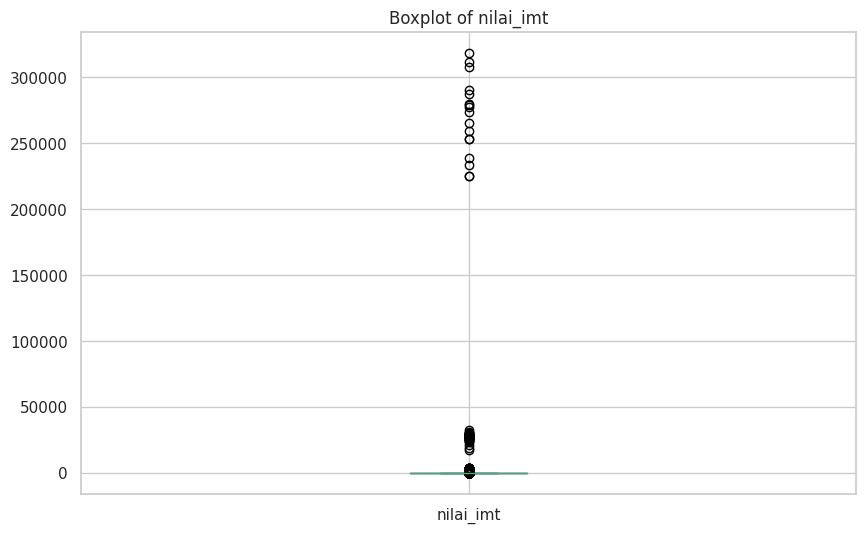

In [ ]:
df['nilai_imt'] = df['nilai_imt'].astype(str)

#Mengstandarisasi nilai float dengan menggunakan tanda '.'
df['nilai_imt'] = df['nilai_imt'].str.replace(',', '.')
df = df[df['nilai_imt'] != '#VALUE!']
df['nilai_imt'] = df['nilai_imt'].astype('float64')

plt.figure(figsize=(10, 6))
df['nilai_imt'].plot(kind='box')
plt.title('Boxplot of nilai_imt')
plt.show()

##Outliers

###Smallest and Largest Numerical Values

In [ ]:
df_num = df.copy()
df_num = df_num[['usia', 'lama_berdinas', 'tinggi', 'berat', 'lingkar_pinggang', 'nilai_imt']]

In [ ]:
df_num.describe()

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
count,2.897940e+05,289794.000000,289794.000000,289794.000000,289794.000000,289794.000000
mean,4.317345e+02,16.861933,169.278197,73.359157,65.558365,50.528620
std,7.551583e+04,9.682083,6.898484,11.210567,188.432564,2100.095186
min,1.500000e+01,-4.000000,5.000000,6.770000,-75.000000,0.370000
25%,2.900000e+01,9.000000,167.000000,66.000000,36.000000,23.310000
50%,3.800000e+01,18.000000,170.000000,72.000000,73.000000,25.100000
75%,4.400000e+01,23.000000,172.000000,80.000000,84.000000,27.550000
max,2.309198e+07,180.000000,575.000000,202.200000,100000.000000,318877.550000


In [ ]:
df_num.nsmallest(10, 'usia')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
ID,,,,,,
336,15.0,27.0,168.0,166.0,90.0,58.82
1771,15.0,23.0,66.0,78.0,35.0,179.06
10579,15.0,28.0,170.0,93.0,100.0,32.18
15639,15.0,23.0,170.0,90.0,100.0,31.14
16359,15.0,19.0,170.0,90.0,38.0,31.14
24190,15.0,20.0,169.0,86.0,100.0,30.11
24318,15.0,14.0,163.0,80.0,34.0,30.11
26837,15.0,15.0,169.0,85.0,75.0,29.76
31963,15.0,20.0,170.0,85.0,40.0,29.41


In [ ]:
df_num.nlargest(10, 'usia')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
ID,,,,,,
179111,23091982.0,20.0,170.0,70.0,30.0,24.22
128296,21071984.0,19.0,171.0,75.0,36.0,25.65
251554,12051987.0,17.0,165.0,60.0,65.0,22.04
214343,12041979.0,22.0,164.0,63.0,72.0,23.42
233767,10051996.0,9.0,169.0,65.0,33.0,22.76
225632,10032023.0,23.0,168.0,65.0,33.0,23.03
283234,8021981.0,23.0,166.0,55.0,31.0,19.96
54093,8011996.0,8.0,163.0,75.0,75.0,28.23
250979,7091992.0,9.0,169.0,63.0,76.0,22.06


In [ ]:
df_num.nsmallest(10, 'lama_berdinas')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
ID,,,,,,
37091,25.0,-4.0,171.0,85.00,54.0,29.07
96,21.0,0.0,165.5,59.00,72.0,21.54
354,21.0,0.0,168.0,60.00,30.0,21.26
1164,20.0,0.0,172.0,68.82,58.0,2326.26
1649,21.0,0.0,163.0,62.70,70.0,235.99
1735,21.0,0.0,169.0,55.70,75.0,195.02
1994,20.0,0.0,69.0,64.00,32.0,134.43
2076,43.0,0.0,168.0,187.00,10.0,66.26
2175,18.0,0.0,165.0,170.00,75.0,62.44


In [ ]:
df_num.nlargest(10, 'lama_berdinas')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
ID,,,,,,
213108,21.0,180.0,169.0,67.00,63.0,23.46
245900,21.0,180.0,168.0,63.00,65.0,22.32
261821,19.0,180.0,167.0,60.00,55.0,21.51
239617,22.0,170.0,170.0,65.00,33.0,22.49
115792,21.0,100.0,170.0,75.00,27.0,25.95
232017,29.0,100.0,175.0,70.00,80.0,22.86
243492,20.0,100.0,170.0,65.00,165.0,22.49
904,45.0,99.0,172.0,75.34,34.0,2546.65
4491,41.0,99.0,167.0,98.00,39.0,35.14


In [ ]:
df_num.nsmallest(10, 'tinggi')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
ID,,,,,,
378,28.0,5.0,5.0,80.0,35.0,32000.00
553,37.0,14.0,15.0,68.0,80.0,3022.22
617,34.0,15.0,15.0,65.0,90.0,2888.89
618,35.0,15.0,15.0,65.0,35.0,2888.89
642,47.0,15.0,15.0,64.0,60.0,2844.44
790,54.0,34.0,15.0,60.0,77.0,2666.67
791,20.0,1.0,15.0,60.0,70.0,2666.67
1019,53.0,27.0,15.0,55.0,65.0,2444.44
499,40.0,16.0,16.0,85.0,114.0,3320.31


In [ ]:
df_num.nlargest(10, 'tinggi')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
ID,,,,,,
289799,51.0,51.0,575.0,57.0,28.0,1.72
289740,46.0,23.0,365.0,70.0,100.0,5.25
289661,47.0,27.0,279.0,85.0,80.0,10.92
289674,30.0,9.0,277.0,81.0,79.0,10.56
289666,23.0,5.0,276.0,82.0,36.0,10.76
289732,46.0,26.0,276.0,65.0,103.0,8.53
289646,42.0,24.0,275.0,85.0,39.0,11.24
289673,55.0,32.0,275.0,80.0,38.0,10.58
289693,40.0,20.0,275.0,75.0,74.0,9.92


In [ ]:
df_num.nsmallest(10, 'berat')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
ID,,,,,,
53,51.0,10.0,168.0,6.77,73.0,2.40
437,19.0,1.0,165.0,10.00,100.0,0.37
289738,23.0,2.0,166.0,15.00,73.0,5.44
289735,42.0,20.0,167.0,22.00,31.0,7.89
289718,27.0,6.0,172.0,27.00,31.0,9.13
289683,29.0,10.0,169.0,29.00,32.0,10.15
289644,40.0,40.0,163.0,30.00,33.0,11.29
289654,29.0,8.0,165.0,30.00,29.0,11.02
289655,26.0,9.0,165.0,30.00,65.0,11.02


In [ ]:
df_num.nlargest(10, 'berat')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
ID,,,,,,
1325,56.0,34.0,163.0,202.2,95.0,761.04
2083,42.0,22.0,173.0,197.0,38.0,65.82
2315,22.0,2.0,180.0,196.0,46.0,60.49
2731,35.0,18.0,196.0,196.0,55.0,51.02
2251,41.0,22.0,179.0,195.0,95.0,60.86
2354,30.0,10.0,180.0,195.0,92.0,60.19
2355,47.0,28.0,180.0,195.0,42.0,60.19
2727,47.0,34.0,195.0,195.0,36.0,51.28
2090,41.0,19.0,172.0,193.0,82.0,65.24


In [ ]:
df_num.nsmallest(10, 'lingkar_pinggang')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
ID,,,,,,
63709,48.0,26.0,172.0,82.0,-75.0,27.72
231694,30.0,9.0,175.0,70.0,-70.0,22.86
161,37.0,18.0,171.0,68.0,0.0,23.26
1308,22.0,1.0,17.0,58.0,0.0,2006.92
1969,35.0,16.0,74.0,76.0,0.0,138.79
3079,51.0,29.0,175.0,120.0,0.0,39.18
6875,28.0,7.0,165.0,91.0,0.0,33.43
11178,37.0,16.0,163.0,85.0,0.0,31.99
13916,26.0,5.0,174.0,95.0,0.0,31.38


In [ ]:
df_num.nlargest(10, 'lingkar_pinggang')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
ID,,,,,,
287707,21.0,2.0,175.0,58.0,100000.0,18.94
114816,36.0,17.0,170.0,75.0,7075.0,25.95
241088,21.0,1.0,170.0,65.0,6578.0,22.49
200839,40.0,19.0,165.0,65.0,3535.0,23.88
89169,55.0,32.0,166.0,74.0,1054.0,26.85
26294,46.0,25.0,168.0,84.0,1000.0,29.76
49916,42.0,23.0,171.0,83.0,1000.0,28.38
145425,50.0,29.0,167.0,70.0,1000.0,25.10
231105,25.0,4.0,175.0,70.0,1000.0,22.86


In [ ]:
df_num.nsmallest(10, 'nilai_imt')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
ID,,,,,,
437,19.0,1.0,165.0,10.00,100.0,0.37
289799,51.0,51.0,575.0,57.00,28.0,1.72
53,51.0,10.0,168.0,6.77,73.0,2.40
289740,46.0,23.0,365.0,70.00,100.0,5.25
289738,23.0,2.0,166.0,15.00,73.0,5.44
289736,53.0,25.0,265.0,50.00,37.0,7.12
289734,26.0,7.0,264.0,55.00,30.0,7.89
289735,42.0,20.0,167.0,22.00,31.0,7.89
289733,56.0,35.0,269.0,61.00,60.0,8.43


In [ ]:
df_num.nlargest(10, 'nilai_imt')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
ID,,,,,,
113,56.0,34.0,168.0,90.0,42.0,318877.55
102,46.0,26.0,166.0,86.0,92.0,312091.74
106,48.0,27.0,168.0,87.0,36.0,308248.30
83,46.0,25.0,176.0,90.0,42.0,290547.52
241,38.0,18.0,177.0,90.0,98.0,287273.77
283,51.0,30.0,169.0,80.0,78.0,280102.24
215,41.0,22.0,164.0,75.0,80.0,278851.87
101,55.0,32.0,175.0,85.0,90.0,277551.02
109,51.0,29.0,171.0,80.0,33.0,273588.45


###Outliers Handling

####Usia

In [ ]:
df_num.head(2)

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
ID,,,,,,
1,34.0,16.0,168.9,85.0,100.0,29.80
2,43.0,23.0,169.5,70.0,80.0,24.36


In [ ]:
df_num['usia'].describe()

count    2.897940e+05
mean     4.317345e+02
std      7.551583e+04
min      1.500000e+01
25%      2.900000e+01
50%      3.800000e+01
75%      4.400000e+01
max      2.309198e+07
Name: usia, dtype: float64

In [ ]:
df_num['usia'] = df_num['usia'].astype(str).str.replace(r'\.0$', '', regex=True)

df_num['usia'].unique()

array(['34', '43', '21', '40', '28', '47', '41', '23', '19', '22', '25',
       '46', '39', '50', '55', '26', '42', '32', '44', '31', '37', '24',
       '27', '57', '53', '56', '20', '36', '49', '51', '29', '54', '38',
       '48', '45', '30', '52', '35', '33', '58', '15', '16', '17', '5429',
       '18', '81', '83', '59', '80', '85', '88', '100', '64', '78', '77',
       '67', '371', '79', '61', '72', '5431', '68', '99', '66', '90',
       '4120', '70', '442', '92', '5633', '69', '75', '93', '87',
       '8011996', '97', '382', '60', '89', '84', '422', '82', '4626',
       '62', '4323', '76', '4325', '4826', '96', '86', '65', '63', '73',
       '30.03', '2910', '298', '21071984', '71', '4927', '4220', '4222',
       '533', '5736', '4020', '4822', '95', '2071967', '553', '23091982',
       '381', '2619', '94', '2022', '74', '4621', '12041979', '370',
       '462525', '10032023', '10051996', '5333', '280701', '522', '279',
       '7091992', '12051987', '5129', '401', '8021981', '191'],


banyak usia bernilai tahun dengan format ddmmyy dan ddmmyyyy

In [ ]:
df_num['usia'] = df_num['usia'].apply(lambda x: x[-4:] if len(x) > 6 else x)

df_num_placeholder = df_num[df_num['usia'].str.len()>4]

df_num_placeholder['usia'] = df_num_placeholder['usia'].apply(lambda x: x[-2:])

df_num_placeholder['usia'] = df_num_placeholder['usia'].astype('float64')

df_num_placeholder['usia'] = df_num_placeholder['usia'].apply(lambda x: 23-x)

df_num.loc[df_num_placeholder.index, :] = df_num_placeholder

df_num['usia'] = df_num['usia'].astype("float64")

df_num['usia'] = df_num['usia'].apply(lambda x: 2023-x if x > 1500 else x)

df_num.loc[(df_num['usia'] > 190) | (df_num['usia'] < 10), 'usia'] = pd.NA

proses sekaligus usia dan buat missing values untuk usia tidak wajar.
Proses pembersihan usia dengan pembuatan string, lalu mengambil 2 atau 4 elemen terakhir agar hanya tahunnya yang terambil untuk kemudian dihitung berapa tahun usianya.

In [ ]:
del(df_num_placeholder)

In [ ]:
df_num['usia'].describe()

count    289752.000000
mean         37.019641
std           9.898764
min          15.000000
25%          29.000000
50%          38.000000
75%          44.000000
max         100.000000
Name: usia, dtype: float64

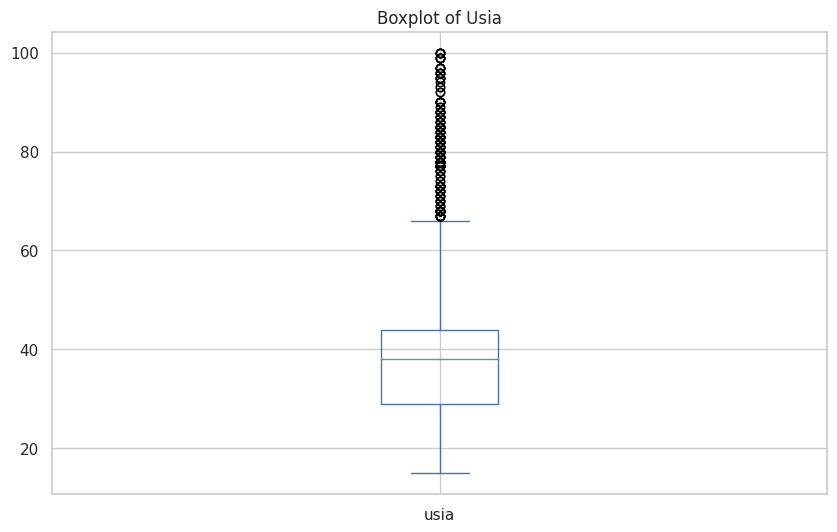

In [ ]:
plt.figure(figsize=(10, 6))
df_num['usia'].plot(kind='box')
plt.title('Boxplot of Usia')
plt.show()

####Lama Berdinas

In [ ]:
df_num['lama_berdinas'].describe()

count    289794.000000
mean         16.861933
std           9.682083
min          -4.000000
25%           9.000000
50%          18.000000
75%          23.000000
max         180.000000
Name: lama_berdinas, dtype: float64

In [ ]:
df_num.loc[df_num['usia'] < df_num['lama_berdinas'] + 10, 'lama_berdinas'] = np.nan
df_num.loc[(df_num['lama_berdinas'] < 0)] = np.nan

lama berdinas diproses dengan membuat missing values lama berdinas yang tidak wajar, yaitu yg kurang dari 10 tahun saat mulai berdinas (batasan yang bisa sebenarnya diperketat lagi)

In [ ]:
df_num['lama_berdinas'].describe()

count    285267.000000
mean         16.556987
std           9.093035
min           0.000000
25%           9.000000
50%          18.000000
75%          23.000000
max          60.000000
Name: lama_berdinas, dtype: float64

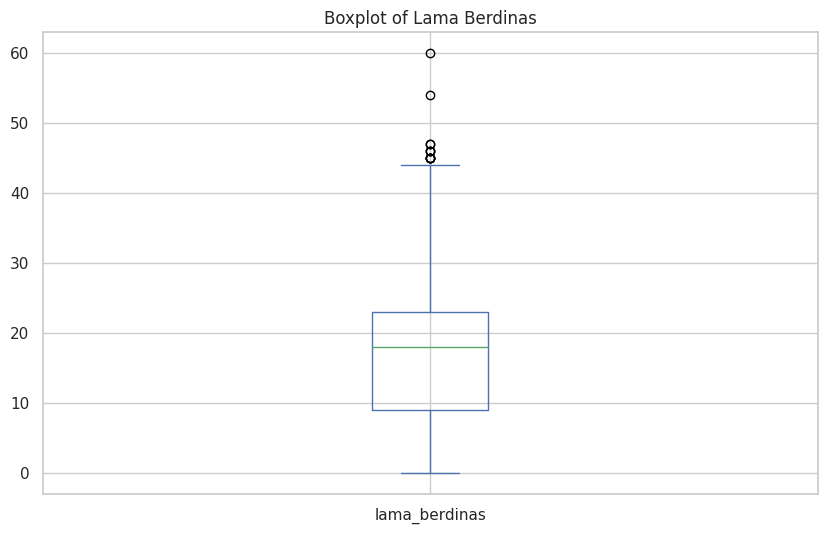

In [ ]:
plt.figure(figsize=(10, 6))
df_num['lama_berdinas'].plot(kind='box')
plt.title('Boxplot of Lama Berdinas')
plt.show()

####Tinggi

In [ ]:
df_num['tinggi'].describe()

count    289793.000000
mean        169.278191
std           6.898495
min           5.000000
25%         167.000000
50%         170.000000
75%         172.000000
max         575.000000
Name: tinggi, dtype: float64

In [ ]:
#Mengeluarkan Noise yaitu nilai-nilai yang tidak wajar seperti tinggi > 80 atau tinggi < 50, dengan melihat nilai tinggi saja serta kombinasi tinggi dan berat
#Diasumsikan nilai-nilai tersebut tidak valid sehingga akan dianggap NaN
df_num.loc[(df_num['tinggi'] > 280) | (df_num['tinggi'] < 50) | ((df_num['tinggi'] < 100) & (df_num['berat'] < 40)) | ((df_num['tinggi'] > 240) & (df_num['berat'] < 100)), 'tinggi'] = np.nan

In [ ]:
df_num['tinggi'].describe()

count    289591.000000
mean        169.298761
std           5.955860
min          53.000000
25%         167.000000
50%         170.000000
75%         172.000000
max         273.000000
Name: tinggi, dtype: float64

In [ ]:
df_num.nlargest(10, 'tinggi')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
ID,,,,,,
289608,40.0,20.0,273.0,100.0,112.0,13.42
219941,28.0,7.0,271.0,171.0,70.0,23.28
217211,39.0,19.0,270.0,170.0,100.0,23.32
170104,20.0,NaN,200.0,98.0,85.0,24.50
289499,44.0,25.0,199.0,65.0,65.0,16.41
229015,39.0,20.0,198.0,90.0,115.0,22.96
235845,35.0,14.0,198.0,89.0,35.0,22.70
260072,40.0,19.0,198.0,85.0,34.0,21.68
287171,48.0,28.0,198.0,75.0,100.0,19.13


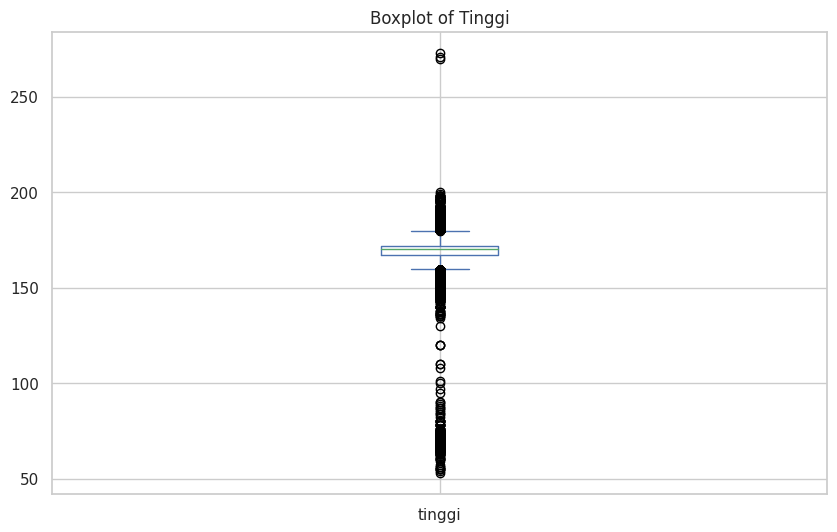

In [ ]:
plt.figure(figsize=(10, 6))
df_num['tinggi'].plot(kind='box')
plt.title('Boxplot of Tinggi')
plt.show()

####Berat

In [ ]:
df_num['berat'].describe()

count    289793.000000
mean         73.359116
std          11.210566
min           6.770000
25%          66.000000
50%          72.000000
75%          80.000000
max         202.200000
Name: berat, dtype: float64

In [ ]:
df_num.nsmallest(10, 'berat')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
ID,,,,,,
53,51.0,10.0,168.0,6.77,73.0,2.40
437,19.0,1.0,165.0,10.00,100.0,0.37
289738,23.0,2.0,166.0,15.00,73.0,5.44
289735,42.0,20.0,167.0,22.00,31.0,7.89
289718,27.0,6.0,172.0,27.00,31.0,9.13
289683,29.0,10.0,169.0,29.00,32.0,10.15
289644,40.0,NaN,163.0,30.00,33.0,11.29
289654,29.0,8.0,165.0,30.00,29.0,11.02
289655,26.0,9.0,165.0,30.00,65.0,11.02


In [ ]:
#Mengeluarkan Noise yaitu nilai-nilai yang tidak wajar dengan melihat kombinasi tinggi dan berat
#Diasumsikan nilai-nilai tersebut tidak valid sehingga akan dianggap NaN
df_num.loc[((df_num['tinggi'] > 140) & (df_num['berat'] < 25)) | ((df_num['tinggi'] > 160) & (df_num['berat'] < 35)), 'berat'] = np.nan

In [ ]:
df_num['berat'].describe()

count    289774.000000
mean         73.362126
std          11.204589
min          34.000000
25%          66.000000
50%          72.000000
75%          80.000000
max         202.200000
Name: berat, dtype: float64

In [ ]:
df_num.nsmallest(10, 'berat')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
ID,,,,,,
289594,51.0,15.0,155.0,34.0,68.0,14.15
289466,53.0,23.0,145.0,35.0,43.0,16.65
289583,54.0,23.0,155.0,35.0,65.0,14.57
289612,25.0,7.0,164.0,35.0,32.0,13.01
289615,56.0,30.0,165.0,35.0,35.0,12.86
289617,47.0,25.0,166.0,35.0,34.0,12.70
289620,36.0,17.0,167.0,35.0,32.0,12.55
289624,56.0,NaN,168.0,35.0,35.0,12.40
289625,54.0,34.0,169.0,35.0,75.0,12.25


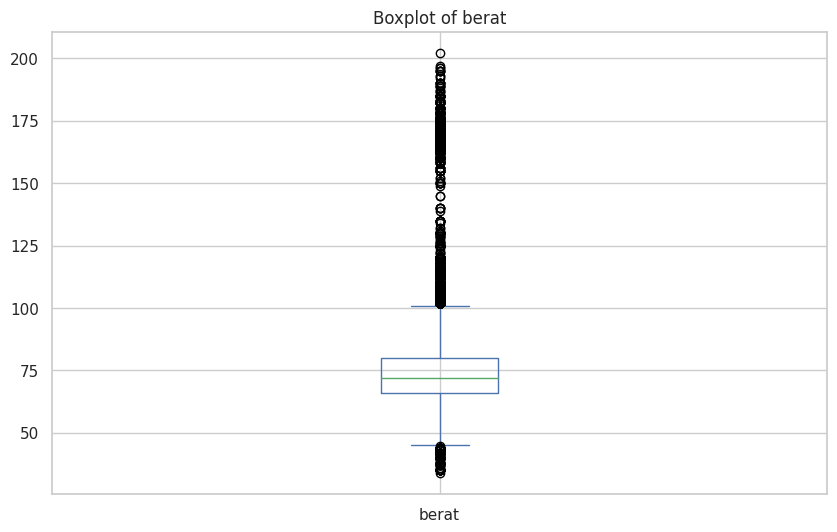

In [ ]:
plt.figure(figsize=(10, 6))
df_num['berat'].plot(kind='box')
plt.title('Boxplot of berat')
plt.show()

####Lingkar Pinggang

In [ ]:
df_num['lingkar_pinggang'].describe()

count    289793.000000
mean         65.558405
std         188.432888
min         -75.000000
25%          36.000000
50%          73.000000
75%          84.000000
max      100000.000000
Name: lingkar_pinggang, dtype: float64

In [ ]:
df_num.nlargest(10, 'lingkar_pinggang')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
ID,,,,,,
287707,21.0,2.0,175.0,58.0,100000.0,18.94
114816,36.0,17.0,170.0,75.0,7075.0,25.95
241088,21.0,1.0,170.0,65.0,6578.0,22.49
200839,40.0,19.0,165.0,65.0,3535.0,23.88
89169,55.0,32.0,166.0,74.0,1054.0,26.85
26294,46.0,25.0,168.0,84.0,1000.0,29.76
49916,42.0,23.0,171.0,83.0,1000.0,28.38
145425,50.0,29.0,167.0,70.0,1000.0,25.10
231105,25.0,4.0,175.0,70.0,1000.0,22.86


####Nilai IMT

In [ ]:
df_num['nilai_imt'].describe()

count    289793.000000
mean         50.528694
std        2100.098809
min           0.370000
25%          23.310000
50%          25.100000
75%          27.550000
max      318877.550000
Name: nilai_imt, dtype: float64

In [ ]:
df_num.nlargest(10, 'nilai_imt')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt
ID,,,,,,
113,56.0,34.0,168.0,90.0,42.0,318877.55
102,46.0,26.0,166.0,86.0,92.0,312091.74
106,48.0,27.0,168.0,87.0,36.0,308248.30
83,46.0,25.0,176.0,90.0,42.0,290547.52
241,38.0,18.0,177.0,90.0,98.0,287273.77
283,51.0,30.0,169.0,80.0,78.0,280102.24
215,41.0,22.0,164.0,75.0,80.0,278851.87
101,55.0,32.0,175.0,85.0,90.0,277551.02
109,51.0,29.0,171.0,80.0,33.0,273588.45


In [ ]:
#Membuat variabel nilai imt yang sudah direvisi karena nilai pada variabel nilai imt sebelumnya ada yang tidak wajar
#Nilai IMT dibuat dari baris yang ada kedua nilai dari tinggi dan beratnya
df_num['nilai_imt_rev'] = np.where(df_num['tinggi'].notnull() & df_num['berat'].notnull(), df_num['berat']/(df_num['tinggi']/100)**2, np.nan)
df_num['nilai_imt_rev'].describe()

count    289572.000000
mean         25.700094
std           6.174633
min          11.299070
25%          23.306680
50%          25.099502
75%          27.513385
max         426.035503
Name: nilai_imt_rev, dtype: float64

In [ ]:
df_num.nlargest(50, 'nilai_imt_rev')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt,nilai_imt_rev
ID,,,,,,,
1332,30.0,9.0,65.0,180.0,75.0,426.04,426.035503
1333,37.0,NaN,63.0,163.0,70.0,410.68,410.682792
1336,47.0,27.0,67.0,167.0,36.0,372.02,372.020495
1337,57.0,35.0,67.0,167.0,63.0,372.02,372.020495
1338,55.0,32.0,68.0,170.0,95.0,367.65,367.647059
1339,55.0,32.0,68.0,167.0,35.0,361.16,361.159170
1340,57.0,29.0,69.0,170.0,75.0,357.07,357.067843
1341,48.0,26.0,71.0,175.0,33.0,347.15,347.153343
1345,38.0,17.0,70.0,167.0,85.0,340.82,340.816327


In [ ]:
#Mengeluarkan Noise
df_num.loc[df_num['nilai_imt_rev']>120, 'nilai_imt_rev'] = np.nan

In [ ]:
df_num.nlargest(50, 'nilai_imt_rev')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt,nilai_imt_rev
ID,,,,,,,
2041,28.0,8.0,78.0,73.0,65.0,119.99,119.986851
2042,46.0,25.0,74.0,65.0,30.0,118.70,118.699781
2043,42.0,23.0,87.0,89.0,87.0,117.58,117.584886
2044,47.0,28.0,87.0,87.0,42.0,114.94,114.942529
2045,56.0,31.0,80.0,73.0,97.0,114.06,114.062500
2046,44.0,23.0,89.0,89.0,108.0,112.36,112.359551
2047,30.0,3.0,72.0,56.0,34.0,108.02,108.024691
2048,28.0,9.0,90.0,87.0,110.0,107.41,107.407407
2049,45.0,26.0,80.0,65.0,80.0,101.56,101.562500


In [ ]:
df_num.nsmallest(50, 'nilai_imt_rev')

,usia,lama_berdinas,tinggi,berat,lingkar_pinggang,nilai_imt,nilai_imt_rev
ID,,,,,,,
289643,28.0,18.0,176.0,35.0,35.0,11.30,11.299070
289639,29.0,8.0,175.0,35.0,68.0,11.43,11.428571
289634,30.0,10.0,173.0,35.0,98.0,11.69,11.694343
289630,50.0,23.0,176.0,37.0,85.0,11.94,11.944731
289629,40.0,18.0,175.0,37.0,36.0,12.08,12.081633
289625,54.0,34.0,169.0,35.0,75.0,12.25,12.254473
289624,56.0,NaN,168.0,35.0,35.0,12.40,12.400794
289623,41.0,22.0,175.0,38.0,80.0,12.41,12.408163
289620,36.0,17.0,167.0,35.0,32.0,12.55,12.549751


###Outliers Splitting

In [ ]:
#Membuat kriteria nilai-nilai yang menjadi outlier untuk nanti diolah secara terpisah
tinggi_condition = (df_num['tinggi'] < 135) | (df_num['tinggi'] > 220)
berat_condition = (df_num['berat'] < 40) | (df_num['berat'] > 180)
nilai_imt_condition = (df_num['nilai_imt_rev'] < 13) | (df_num['nilai_imt_rev'] > 50)

outliers_condition = tinggi_condition | berat_condition | nilai_imt_condition

df_num_outliers = df_num[outliers_condition]
df_num_no_outliers = df_num[~outliers_condition]

###Splitting df

In [ ]:
df_num_outliers.shape, df_num_no_outliers.shape, df_num.shape

((1140, 7), (288654, 7), (289794, 7))

In [ ]:
df.shape

(289794, 78)

In [ ]:
#Menggabungkan kembali dataframe yang hanya berisikan variabel numerik yang sudah difilter berdasarkan kondisi outlier dengan kolom-kolom lain dari dataframe awal
df_outliers = df.copy()
df.loc[:, df_num_no_outliers.columns] = np.nan
df_outliers.loc[:, df_num_outliers.columns] = np.nan
df_outliers.update(df_num_outliers)
df.update(df_num_no_outliers)

mask1 = df.index.isin(df_num_no_outliers.index)
df = df[mask1]

mask2 = df_outliers.index.isin(df_num_outliers.index)
df_outliers = df_outliers[mask2]

In [ ]:
df.shape, df_outliers.shape

((288654, 79), (1140, 79))

In [ ]:
df_outliers.columns

Index(['wilayah', 'jenis_kelamin', 'usia', 'lama_berdinas', 'pendidikan',
       'tinggi', 'berat', 'lingkar_pinggang', 'status_kawin', 'pengeluaran',
       'penyakit_jantung', 'penyakit_stroke', 'penyakit_diabetes_melitus',
       'penyakit_hipertensi', 'penyakit_kanker', 'penyakit_ginjal',
       'penyakit_tumor', 'penyakit_osteoartritis', 'penyakit_lambung',
       'penyakit_liver', 'penyakit_tbc', 'penyakit_dbd', 'penyakit_covid19',
       'penyakit_hiv_aids', 'penyakit_diare', 'penyakit_malaria',
       'penyakit_gonore_sipilis', 'penyakit_thypus', 'penyakit_dermatitis',
       'penyakit_mikosis', 'sakit_kepala', 'tidak_nafsu_makan', 'sulit_tidur',
       'mudah_takut', 'tegang,_cemas_atau_kuatir', 'tangan_anda_gemetar',
       'masalah_pencernaan', 'sulit_untuk_berpikir_jernih', 'tidak_bahagia',
       'menangis_lebih_sering', 'sulit_untuk_menikmati_kegiatan_sehari_hari',
       'sulit_untuk_mengambil_keputusan', 'pekerjaan_terganggu',
       'tidak_mampu_melakukan_hal_hal_yang_

In [ ]:
df.columns

Index(['wilayah', 'jenis_kelamin', 'usia', 'lama_berdinas', 'pendidikan',
       'tinggi', 'berat', 'lingkar_pinggang', 'status_kawin', 'pengeluaran',
       'penyakit_jantung', 'penyakit_stroke', 'penyakit_diabetes_melitus',
       'penyakit_hipertensi', 'penyakit_kanker', 'penyakit_ginjal',
       'penyakit_tumor', 'penyakit_osteoartritis', 'penyakit_lambung',
       'penyakit_liver', 'penyakit_tbc', 'penyakit_dbd', 'penyakit_covid19',
       'penyakit_hiv_aids', 'penyakit_diare', 'penyakit_malaria',
       'penyakit_gonore_sipilis', 'penyakit_thypus', 'penyakit_dermatitis',
       'penyakit_mikosis', 'sakit_kepala', 'tidak_nafsu_makan', 'sulit_tidur',
       'mudah_takut', 'tegang,_cemas_atau_kuatir', 'tangan_anda_gemetar',
       'masalah_pencernaan', 'sulit_untuk_berpikir_jernih', 'tidak_bahagia',
       'menangis_lebih_sering', 'sulit_untuk_menikmati_kegiatan_sehari_hari',
       'sulit_untuk_mengambil_keputusan', 'pekerjaan_terganggu',
       'tidak_mampu_melakukan_hal_hal_yang_

In [ ]:
#Mengdrop variabel nilai_imt karena sudah terwakili oleh variabel nilai_imt_rev
df.drop(columns = ['nilai_imt'], axis=1, inplace=True)
df_outliers.drop(columns = ['nilai_imt'], axis=1, inplace=True)
df.shape, df_outliers.shape

((288654, 78), (1140, 78))

## <h2> Missing Values </h2> ##

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 288654 entries, 1 to 289801
Data columns (total 78 columns):
 #   Column                                                     Non-Null Count   Dtype  
---  ------                                                     --------------   -----  
 0   wilayah                                                    288654 non-null  object 
 1   jenis_kelamin                                              288654 non-null  object 
 2   usia                                                       288611 non-null  float64
 3   lama_berdinas                                              284243 non-null  float64
 4   pendidikan                                                 288654 non-null  object 
 5   tinggi                                                     288452 non-null  float64
 6   berat                                                      288634 non-null  float64
 7   lingkar_pinggang                                           288653 non-null  float64

In [ ]:
df.isna().sum()

wilayah                    0
jenis_kelamin              0
usia                      43
lama_berdinas           4411
pendidikan                 0
                       ...  
jarak_tempat_sampah    41455
fasilitas_olahraga         0
kelompok_umur              0
imt                        0
nilai_imt_rev            221
Length: 78, dtype: int64

Terlihat bahwa NaN paling banyak terdapat di variabel `(jk)jumlah_gigi_karies`, `(jk)jumlah_rokok_per_hari`, dan `jarak_tempat_sampah`. Dihipotesiskan bahwa value di baris di variabel-variabel tersebut NaN karena mereka tidak orang di baris tersebut tidak memiliki ketiga variabel tersebut.

Setelah memfilter data di GColab dan di Excel, terlihat bahwa hipotesis terbukti benar bahwa NaN di ketiga variabel tersebut diasosiasikan dengan tidak memiliki (tidak memiliki penyakit gigi, tidak merokok, dan tidak ada tempat sampah)

Hal ini berarti NaN bisa diganti nilainya dengan sebuah bilangan bulat, yaitu $0$

In [ ]:
df.loc[df['(jk)jumlah_gigi_karies'].isna(), ['penyakit_gigi', '(jk)jumlah_gigi_karies']]

,penyakit_gigi,(jk)jumlah_gigi_karies
ID,,
1,Tidak,NaN
2,Tidak,NaN
3,Tidak,NaN
4,Tidak,NaN
5,Tidak,NaN
...,...,...
289794,Tidak,NaN
289796,Tidak,NaN
289797,Tidak,NaN


In [ ]:
df['(jk)jumlah_gigi_karies'] = df['(jk)jumlah_gigi_karies'].fillna(0)

In [ ]:
df.loc[df['(jk)jumlah_gigi_karies'].isna(), ['penyakit_gigi', '(jk)jumlah_gigi_karies']]

,penyakit_gigi,(jk)jumlah_gigi_karies
ID,,


In [ ]:
df.loc[df['(jk)jumlah_rokok_per_hari'].isna(), ['merokok', '(jk)jumlah_rokok_per_hari']]

,merokok,(jk)jumlah_rokok_per_hari
ID,,
2,Tidak,NaN
3,Tidak,NaN
4,Tidak,NaN
7,Tidak,NaN
8,Tidak,NaN
...,...,...
289791,Tidak,NaN
289793,Tidak,NaN
289794,Tidak,NaN


In [ ]:
df['(jk)jumlah_rokok_per_hari'] = df['(jk)jumlah_rokok_per_hari'].fillna(0)

In [ ]:
df.loc[df['(jk)jumlah_rokok_per_hari'].isna(), ['merokok', '(jk)jumlah_rokok_per_hari']]

,merokok,(jk)jumlah_rokok_per_hari
ID,,


In [ ]:
df.loc[df['jarak_tempat_sampah'].isna(), ['ada_tempat_sampah', 'jarak_tempat_sampah']]

,ada_tempat_sampah,jarak_tempat_sampah
ID,,
3,Tidak ada,NaN
6,Tidak ada,NaN
7,Tidak ada,NaN
13,Tidak ada,NaN
19,Tidak ada,NaN
...,...,...
289761,Tidak ada,NaN
289769,Tidak ada,NaN
289770,Tidak ada,NaN


In [ ]:
df['jarak_tempat_sampah'] = df['jarak_tempat_sampah'].fillna(0)

In [ ]:
df.loc[df['jarak_tempat_sampah'].isna(), ['ada_tempat_sampah', 'jarak_tempat_sampah']]

,ada_tempat_sampah,jarak_tempat_sampah
ID,,


In [ ]:
df_outliers.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1140 entries, 23 to 289643
Data columns (total 78 columns):
 #   Column                                                     Non-Null Count  Dtype  
---  ------                                                     --------------  -----  
 0   wilayah                                                    1140 non-null   object 
 1   jenis_kelamin                                              1140 non-null   object 
 2   usia                                                       1140 non-null   float64
 3   lama_berdinas                                              1024 non-null   float64
 4   pendidikan                                                 1140 non-null   object 
 5   tinggi                                                     1139 non-null   float64
 6   berat                                                      1140 non-null   float64
 7   lingkar_pinggang                                           1140 non-null   float64
 8   statu

Pada `df_outliers` hal yang sama juga terjadi seperti di `df`, sehingga NaN di variabel `(jk)jumlah_gigi_karies`, `(jk)jumlah_rokok_per_hari`, dan `jarak_tempat_sampah` akan diganti dengan bilangan bulat $0$

In [ ]:
df_outliers['(jk)jumlah_gigi_karies'] = df_outliers['(jk)jumlah_gigi_karies'].fillna(0)
df_outliers['(jk)jumlah_rokok_per_hari'] = df_outliers['(jk)jumlah_rokok_per_hari'].fillna(0)
df_outliers['jarak_tempat_sampah'] = df_outliers['jarak_tempat_sampah'].fillna(0)

## <h2> Converting 'object' to 'category' Data Type </h2> ##

Perubahan tipe data variabel-variabel kategorik dari 'object' ke 'category' bertujuan agar value-value di variabel kategorik tersebut meskipun berbentuk string, tetapi string tersebut mewakilkan suatu kategori, bukan hanya string biasa saja. Hal ini akan berguna ketika melakukan proses visualisasi dan modelling.

In [ ]:
# Select the object columns
object_cols1 = df_outliers.select_dtypes(include=['object']).columns
object_cols2 = df.select_dtypes(include=['object']).columns

# Convert the object columns to category
df_outliers[object_cols1] = df_outliers[object_cols1].astype('category')
df[object_cols2] = df[object_cols2].astype('category')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 288654 entries, 1 to 289801
Data columns (total 78 columns):
 #   Column                                                     Non-Null Count   Dtype   
---  ------                                                     --------------   -----   
 0   wilayah                                                    288654 non-null  category
 1   jenis_kelamin                                              288654 non-null  category
 2   usia                                                       288611 non-null  float64 
 3   lama_berdinas                                              284243 non-null  float64 
 4   pendidikan                                                 288654 non-null  category
 5   tinggi                                                     288452 non-null  float64 
 6   berat                                                      288634 non-null  float64 
 7   lingkar_pinggang                                           288653 non-null

In [ ]:
df_outliers.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1140 entries, 23 to 289643
Data columns (total 78 columns):
 #   Column                                                     Non-Null Count  Dtype   
---  ------                                                     --------------  -----   
 0   wilayah                                                    1140 non-null   category
 1   jenis_kelamin                                              1140 non-null   category
 2   usia                                                       1140 non-null   float64 
 3   lama_berdinas                                              1024 non-null   float64 
 4   pendidikan                                                 1140 non-null   category
 5   tinggi                                                     1139 non-null   float64 
 6   berat                                                      1140 non-null   float64 
 7   lingkar_pinggang                                           1140 non-null   float64 


##Removing Unnecessary Variables in Environment ヾ(•ω•`)o

In [ ]:
del(tinggi_condition,
    berat_condition,
    nilai_imt_condition,
    outliers_condition,
    df_num_no_outliers,
    df_num_outliers,
    mask1,
    mask2,
    object_cols1,
    object_cols2)

##Adding Features

In [ ]:
province_to_island = {
    'KALBAR': 'Kalimantan',
    'BENGKULU': 'Sumatra',
    'SULSEL': 'Sulawesi',
    'SULUT': 'Sulawesi',
    'KEPRI': 'Sumatra',
    'NTT': 'Nusa Tenggara',
    'JATIM': 'Java',
    'SULTENG': 'Sulawesi',
    'JAMBI': 'Sumatra',
    'SUMUT': 'Sumatra',
    'JABAR': 'Java',
    'ACEH': 'Sumatra',
    'BALI': 'Bali',
    'BANTEN': 'Java',
    'DIY': 'Java',
    'GORONTALO': 'Sulawesi',
    'JATENG': 'Java',
    'KALSEL': 'Kalimantan',
    'KALTENG': 'Kalimantan',
    'KALTIM': 'Kalimantan',
    'KALTARA': 'Kalimantan',
    'BABEL': 'Sumatra',
    'LAMPUNG': 'Sumatra',
    'MALUKU': 'Maluku',
    'MALUT': 'Maluku',
    'METROJAYA': 'Java',
    'NTB': 'Nusa Tenggara',
    'PAPUA': 'Papua',
    'PABAR': 'Papua',
    'RIAU': 'Sumatra',
    'SULBAR': 'Sulawesi',
    'SULTRA': 'Sulawesi',
    'SUMBAR': 'Sumatra',
    'SUMSEL': 'Sumatra'
}

df['pulau'] = df['wilayah'].map(province_to_island)

In [ ]:
df[['wilayah', 'pulau']]

,wilayah,pulau
ID,,
1,KALBAR,Kalimantan
2,KALBAR,Kalimantan
3,KALBAR,Kalimantan
4,KALBAR,Kalimantan
5,KALBAR,Kalimantan
...,...,...
289797,KALSEL,Kalimantan
289798,JATENG,Java
289799,SUMSEL,Sumatra


In [ ]:
df['bmi_category'] = pd.cut(df['nilai_imt_rev'], bins=[0, 18.5, 24.9, 29.9, 34.9, 39.9, float('inf')],
                            labels=['Underweight', 'Normal weight', 'Overweight', 'Obesity Class I', 'Obesity Class II', 'Obesity Class III'])

In [ ]:
df['bmi_category'].value_counts()

Normal weight        133702
Overweight           130023
Obesity Class I       21665
Obesity Class II       1698
Underweight            1102
Obesity Class III       243
Name: bmi_category, dtype: int64

#Visualisasi (〜￣▽￣)〜

##Functions
---
Beberapa plot sering digunakan karena banyaknya variabel kategorik sehingga dibuat function untuk mempermudah dan mempercepat pemakaian. Penjelasan bagaimana plot bekerja ada pada *comment* di masing-masing function utama.

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set style
sns.set(style="whitegrid")

In [ ]:
df.columns

Index(['wilayah', 'jenis_kelamin', 'usia', 'lama_berdinas', 'pendidikan',
       'tinggi', 'berat', 'lingkar_pinggang', 'status_kawin', 'pengeluaran',
       'penyakit_jantung', 'penyakit_stroke', 'penyakit_diabetes_melitus',
       'penyakit_hipertensi', 'penyakit_kanker', 'penyakit_ginjal',
       'penyakit_tumor', 'penyakit_osteoartritis', 'penyakit_lambung',
       'penyakit_liver', 'penyakit_tbc', 'penyakit_dbd', 'penyakit_covid19',
       'penyakit_hiv_aids', 'penyakit_diare', 'penyakit_malaria',
       'penyakit_gonore_sipilis', 'penyakit_thypus', 'penyakit_dermatitis',
       'penyakit_mikosis', 'sakit_kepala', 'tidak_nafsu_makan', 'sulit_tidur',
       'mudah_takut', 'tegang,_cemas_atau_kuatir', 'tangan_anda_gemetar',
       'masalah_pencernaan', 'sulit_untuk_berpikir_jernih', 'tidak_bahagia',
       'menangis_lebih_sering', 'sulit_untuk_menikmati_kegiatan_sehari_hari',
       'sulit_untuk_mengambil_keputusan', 'pekerjaan_terganggu',
       'tidak_mampu_melakukan_hal_hal_yang_

In [ ]:
def barplot_prop_percent(x, hue, df=df, size=(12, 6),
                         title='Title', hue_filter=None, out=False,
                         hue_palette="muted", rot=0):
  '''
  barplot for percentage of each category, grouped by percentage of hues in each
  categories

  Interpret by how high each hue values' percentage compared to the
  same hue values' percentage in different group/categories.

  x: categorical columns in the x-axis
  hue: 2nd variable to be compared in the barplot
  df: Pandas DataFrame to be used
  size: size of the figure
  title: title of the plot
  hue_filter: list of unique values want to be included in the hue
  out: default False, True for legend labels outside the figure
  hue_palette: custom color for the hues to highlight certain hue values
  rot: rotate x-axis label by certain degrees
  '''
  plt.figure(figsize=(12, 6))

  # Filter data and select relevant columns
  if hue_filter:
      filtered_df = df[df[hue].isin(hue_filter)]
  else:
      filtered_df = df
  columns = [x, hue]

  # Create a DataFrame with percentages for each category within each group
  percentage_df = (filtered_df.groupby(columns).size() / filtered_df.groupby(x).size()).reset_index(name='percentage')
  percentage_df = percentage_df[percentage_df[hue]!=0]

  # Plotting
  plt.figure(figsize=(12, 6))
  ax = sns.barplot(x=x, y="percentage", hue=hue, data=percentage_df, palette=hue_palette)

  # Annotate percentages on each bar
  for p in ax.patches:
      percentage = '{:.1%}'.format(p.get_height())
      x = p.get_x() + p.get_width() / 2
      y = p.get_height()
      ax.annotate(percentage, (x, y), ha='center', va='bottom')

  if out:
    # Move legend outside the plot grid
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
  plt.xticks(rotation=rot)
  plt.title(title)
  plt.show()

In [ ]:
def barplot_prop_percent_hue(x, hue, df=df, size=(12, 6),
                             title='Title', hue_filter=None, out=False,
                             hue_palette="muted", rot=0):
    '''
    barplot for percentage of each category, grouped by percentage of hues spread
    out in all categories

    Interpret by each how high the hue values' percentage
    compared to other hue values' percentage in that same category.

    x: categorical columns in the x-axis
    hue: 2nd variable to be compared in the barplot
    df: Pandas DataFrame to be used
    size: size of the figure
    title: title of the plot
    hue_filter: list of unique values want to be included in the hue
    out: default False, True for legend labels outside the figure
    hue_palette: custom color for the hues to highlight certain hue values
    '''
    plt.figure(figsize=size)

    # Filter data and select relevant columns
    if hue_filter:
        filtered_df = df[df[hue].isin(hue_filter)]
    else:
        filtered_df = df
    columns = [x, hue]

    # Create a DataFrame with percentages for each category across all groups
    total_counts = filtered_df.groupby(hue).size()
    percentage_df = (filtered_df.groupby(columns).size() / total_counts).reset_index(name='percentage')
    percentage_df = percentage_df[percentage_df[hue]!=0]

    # Plotting
    ax = sns.barplot(x=x, y="percentage", hue=hue, data=percentage_df, palette=hue_palette)

    # Annotate percentages on each bar
    for p in ax.patches:
        percentage = '{:.1%}'.format(p.get_height())
        x = p.get_x() + p.get_width() / 2
        y = p.get_height()
        ax.annotate(percentage, (x, y), ha='center', va='bottom')
    if out:
        # Move legend outside the plot grid
        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

    plt.xticks(rotation=45)
    plt.title(title)
    plt.show()

##Part 1
---
Pada bagian ini, beberapa visualisasi dilakukan dalam tahap percobaan. Langkah ini adalah langkah mencoba secara umum tanpa terkekang topik tertentu.

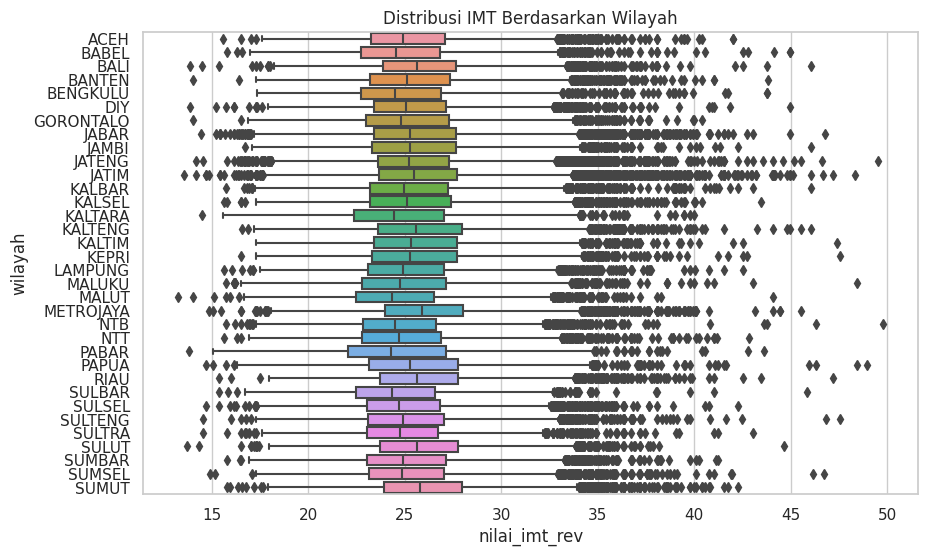

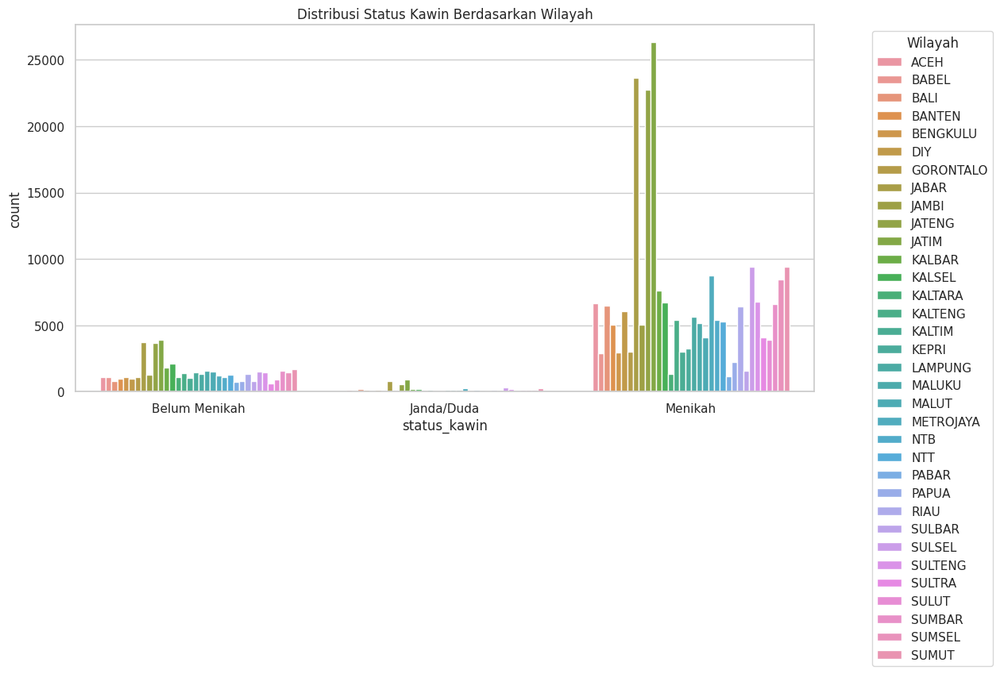

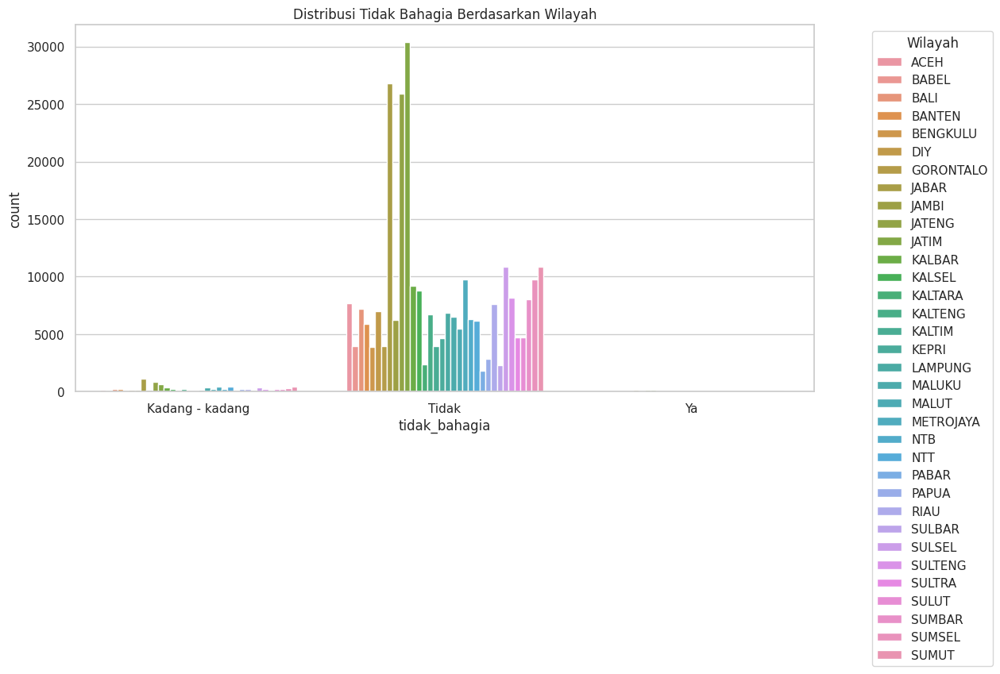

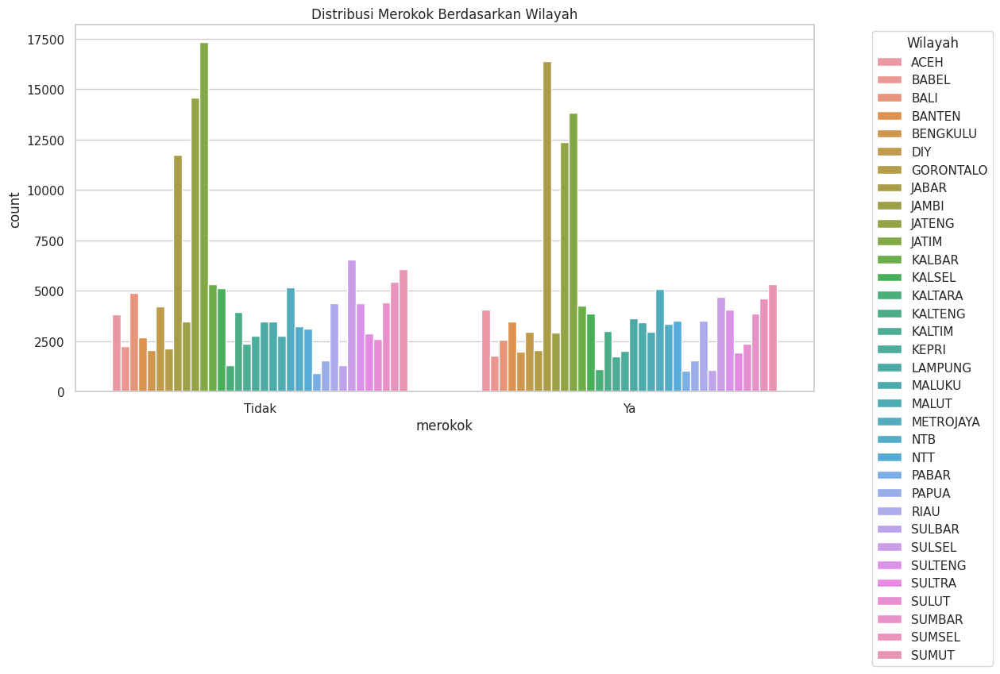

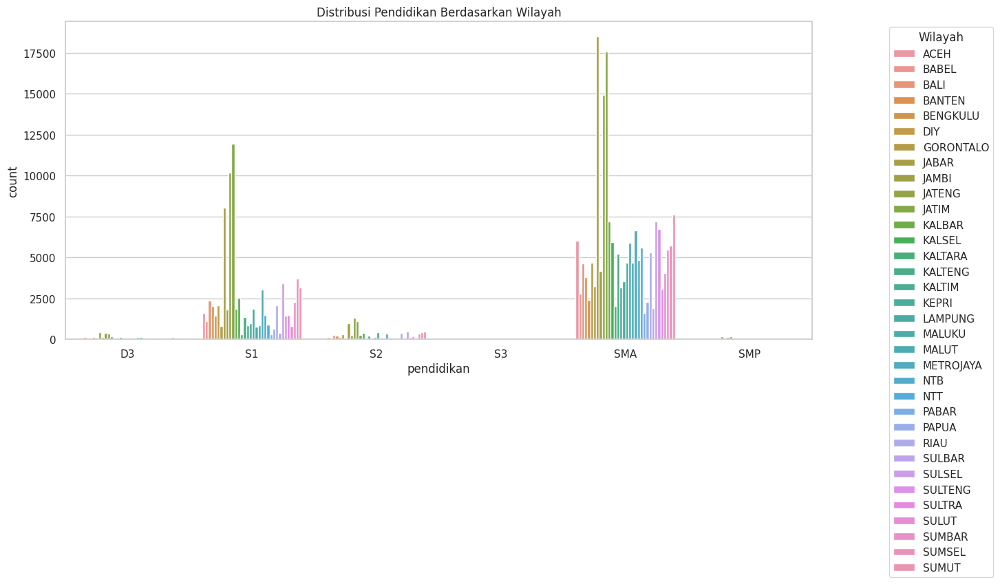

In [ ]:
# Plot BMI
plt.figure(figsize=(10, 6))
sns.boxplot(x="nilai_imt_rev", y="wilayah", data=df)
plt.title("Distribusi IMT Berdasarkan Wilayah")
plt.show()

# Plot Status Kawin
plt.figure(figsize=(12, 6))
sns.countplot(x="status_kawin", hue="wilayah", data=df)
plt.title("Distribusi Status Kawin Berdasarkan Wilayah")
plt.legend(loc='upper right', title='Wilayah', bbox_to_anchor=(1.25, 1))
plt.show()

# Plot Tidak Bahagia
plt.figure(figsize=(12, 6))
sns.countplot(x="tidak_bahagia", hue="wilayah", data=df)
plt.title("Distribusi Tidak Bahagia Berdasarkan Wilayah")
plt.legend(loc='upper right', title='Wilayah', bbox_to_anchor=(1.25, 1))
plt.show()

# Plot Merokok
plt.figure(figsize=(12, 6))
sns.countplot(x="merokok", hue="wilayah", data=df)
plt.title("Distribusi Merokok Berdasarkan Wilayah")
plt.legend(loc='upper right', title='Wilayah', bbox_to_anchor=(1.25, 1))
plt.show()

# Plot Pendidikan
plt.figure(figsize=(14, 6))
sns.countplot(x="pendidikan", hue="wilayah", data=df)
plt.title("Distribusi Pendidikan Berdasarkan Wilayah")
plt.legend(loc='upper right', title='Wilayah', bbox_to_anchor=(1.25, 1))
plt.show()

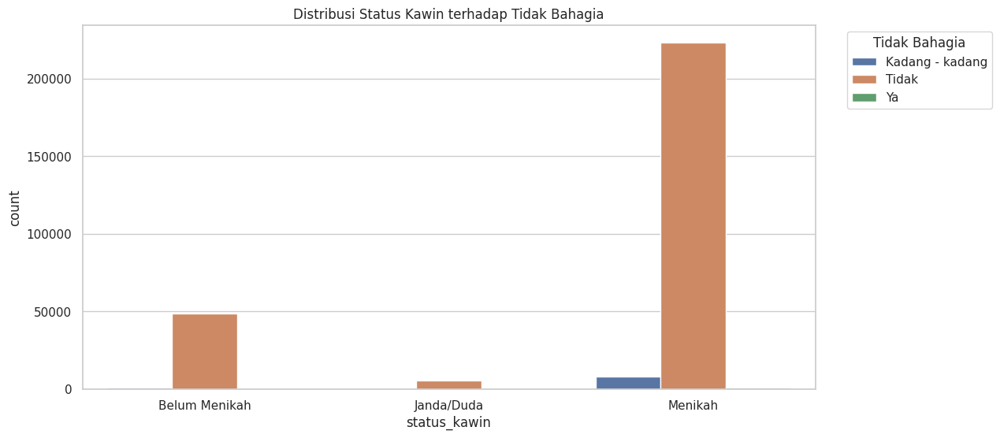

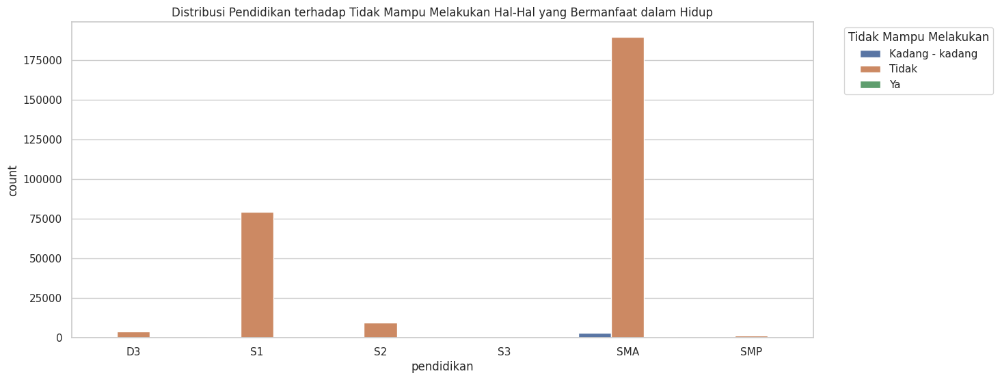

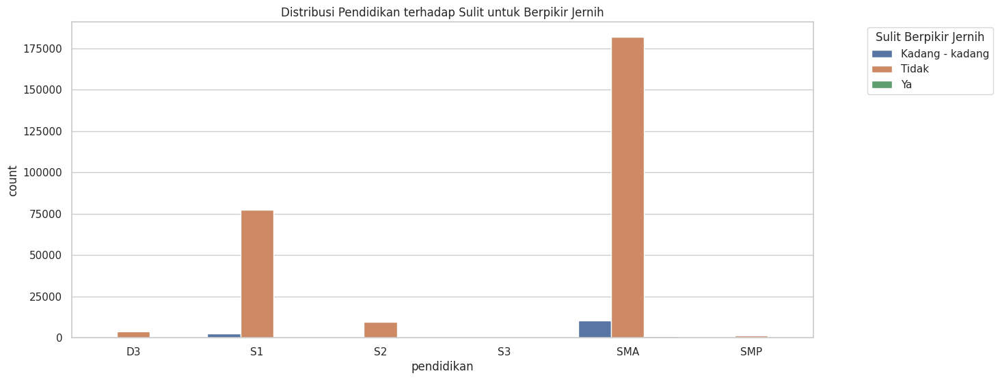

In [ ]:
# Status Kawin vs Tidak Bahagia
plt.figure(figsize=(12, 6))
sns.countplot(x="status_kawin", hue="tidak_bahagia", data=df)
plt.title("Distribusi Status Kawin terhadap Tidak Bahagia")
plt.legend(title='Tidak Bahagia', bbox_to_anchor=(1.25, 1))
plt.show()

# Pendidikan vs Tidak Mampu Melakukan Hal-Hal yang Bermanfaat dalam Hidup
plt.figure(figsize=(14, 6))
sns.countplot(x="pendidikan", hue="tidak_mampu_melakukan_hal_hal_yang_bermanfaat_dalam_hidup", data=df)
plt.title("Distribusi Pendidikan terhadap Tidak Mampu Melakukan Hal-Hal yang Bermanfaat dalam Hidup")
plt.legend(title='Tidak Mampu Melakukan', bbox_to_anchor=(1.25, 1))
plt.show()

# Pendidikan vs Sulit untuk Berpikir Jernih
plt.figure(figsize=(14, 6))
sns.countplot(x="pendidikan", hue="sulit_untuk_berpikir_jernih", data=df)
plt.title("Distribusi Pendidikan terhadap Sulit untuk Berpikir Jernih")
plt.legend(title='Sulit Berpikir Jernih', bbox_to_anchor=(1.25, 1))
plt.show()


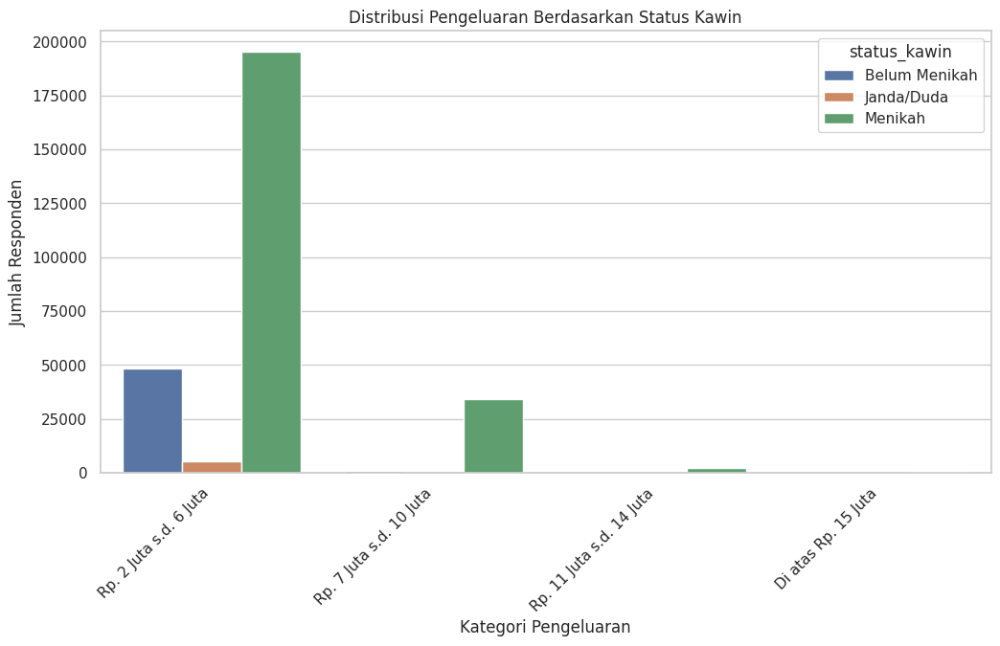

In [ ]:
# Plot Pengeluaran terhadap Status Kawin
plt.figure(figsize=(12, 6))
sns.countplot(x="pengeluaran", hue="status_kawin", data=df, order=df['pengeluaran'].value_counts().index)
plt.title("Distribusi Pengeluaran Berdasarkan Status Kawin")
plt.xlabel("Kategori Pengeluaran")
plt.ylabel("Jumlah Responden")
plt.xticks(rotation=45, ha="right")  # Rotasi label untuk memudahkan membaca
plt.show()

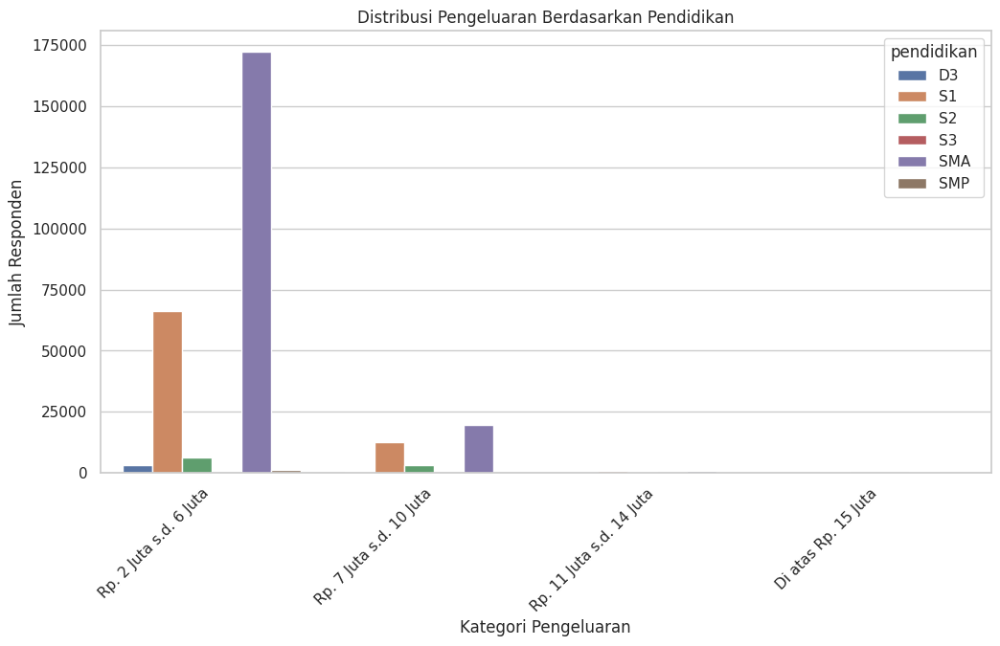

In [ ]:
# Plot Pengeluaran terhadap Pendidikan
plt.figure(figsize=(12, 6))
sns.countplot(x="pengeluaran", hue="pendidikan", data=df, order=df['pengeluaran'].value_counts().index)
plt.title("Distribusi Pengeluaran Berdasarkan Pendidikan")
plt.xlabel("Kategori Pengeluaran")
plt.ylabel("Jumlah Responden")
plt.xticks(rotation=45, ha="right")  # Rotasi label untuk memudahkan membaca
plt.show()


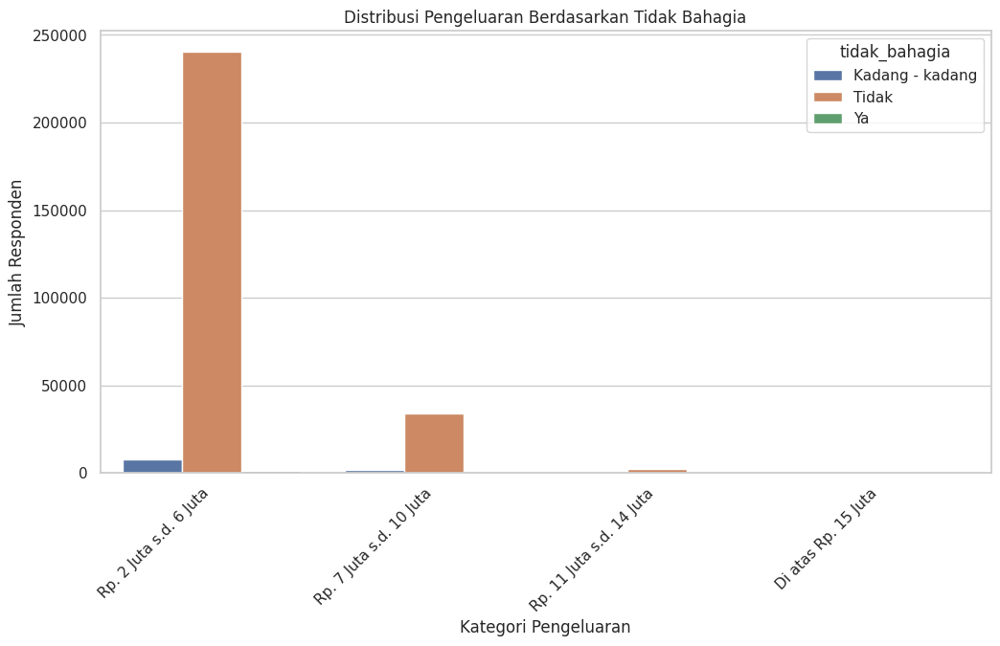

In [ ]:
# Plot Pengeluaran terhadap Tidak Bahagia
plt.figure(figsize=(12, 6))
sns.countplot(x="pengeluaran", hue="tidak_bahagia", data=df, order=df['pengeluaran'].value_counts().index)
plt.title("Distribusi Pengeluaran Berdasarkan Tidak Bahagia")
plt.xlabel("Kategori Pengeluaran")
plt.ylabel("Jumlah Responden")
plt.xticks(rotation=45, ha="right")  # Rotasi label untuk memudahkan membaca
plt.show()


In [ ]:
df.columns

Index(['wilayah', 'jenis_kelamin', 'usia', 'lama_berdinas', 'pendidikan',
       'tinggi', 'berat', 'lingkar_pinggang', 'status_kawin', 'pengeluaran',
       'penyakit_jantung', 'penyakit_stroke', 'penyakit_diabetes_melitus',
       'penyakit_hipertensi', 'penyakit_kanker', 'penyakit_ginjal',
       'penyakit_tumor', 'penyakit_osteoartritis', 'penyakit_lambung',
       'penyakit_liver', 'penyakit_tbc', 'penyakit_dbd', 'penyakit_covid19',
       'penyakit_hiv_aids', 'penyakit_diare', 'penyakit_malaria',
       'penyakit_gonore_sipilis', 'penyakit_thypus', 'penyakit_dermatitis',
       'penyakit_mikosis', 'sakit_kepala', 'tidak_nafsu_makan', 'sulit_tidur',
       'mudah_takut', 'tegang,_cemas_atau_kuatir', 'tangan_anda_gemetar',
       'masalah_pencernaan', 'sulit_untuk_berpikir_jernih', 'tidak_bahagia',
       'menangis_lebih_sering', 'sulit_untuk_menikmati_kegiatan_sehari_hari',
       'sulit_untuk_mengambil_keputusan', 'pekerjaan_terganggu',
       'tidak_mampu_melakukan_hal_hal_yang_

<Figure size 1200x600 with 0 Axes>

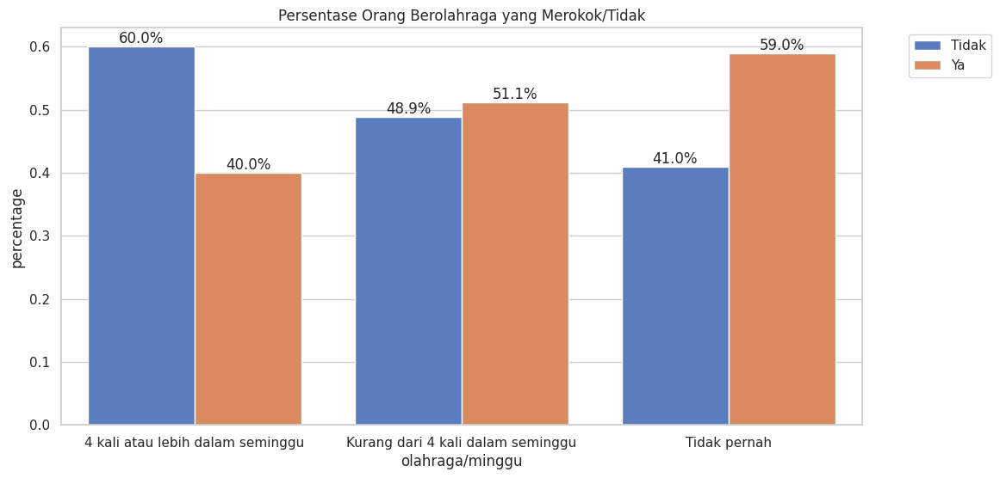

In [ ]:
barplot_prop_percent(x="olahraga/minggu",
                     hue="merokok",
                     df=df,
                     size=(12, 6),
                     title="Persentase Orang Berolahraga yang Merokok/Tidak",
                     out=True)

<Figure size 1200x600 with 0 Axes>

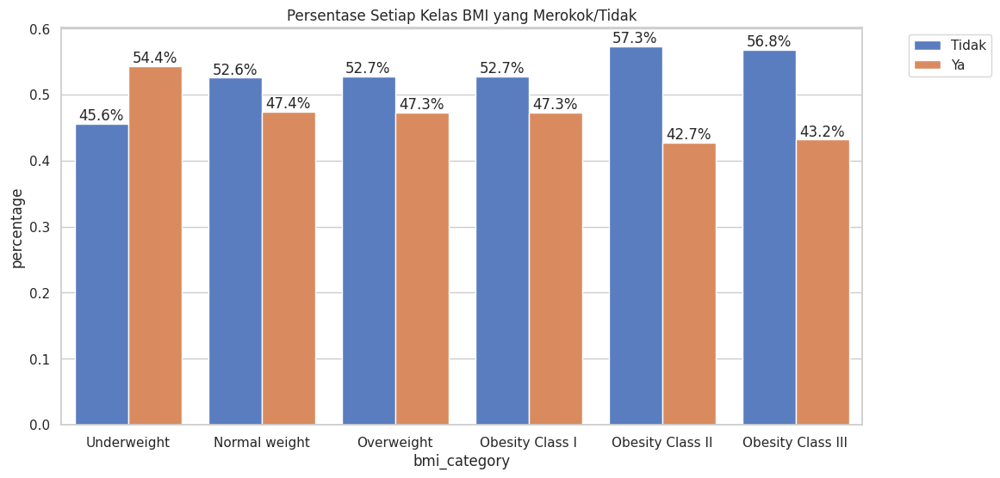

In [ ]:
barplot_prop_percent(x="bmi_category",
                     hue="merokok",
                     df=df,
                     size=(12, 6),
                     title="Persentase Setiap Kelas BMI yang Merokok/Tidak",
                     out=True)

<Figure size 1200x600 with 0 Axes>

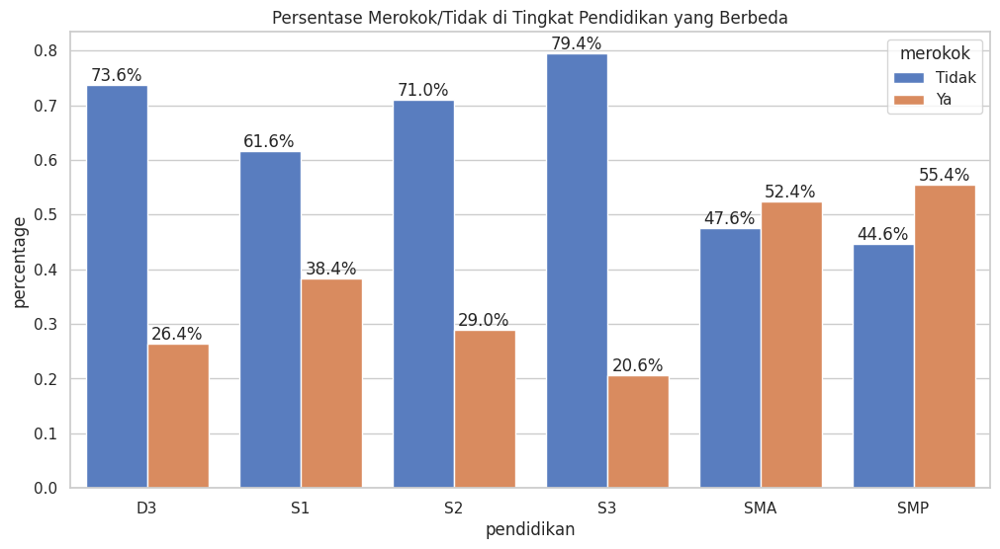

In [ ]:
barplot_prop_percent(x="pendidikan",
                     hue="merokok",
                     df=df,
                     size=(12, 6),
                     title="Persentase Merokok/Tidak di Tingkat Pendidikan yang Berbeda")

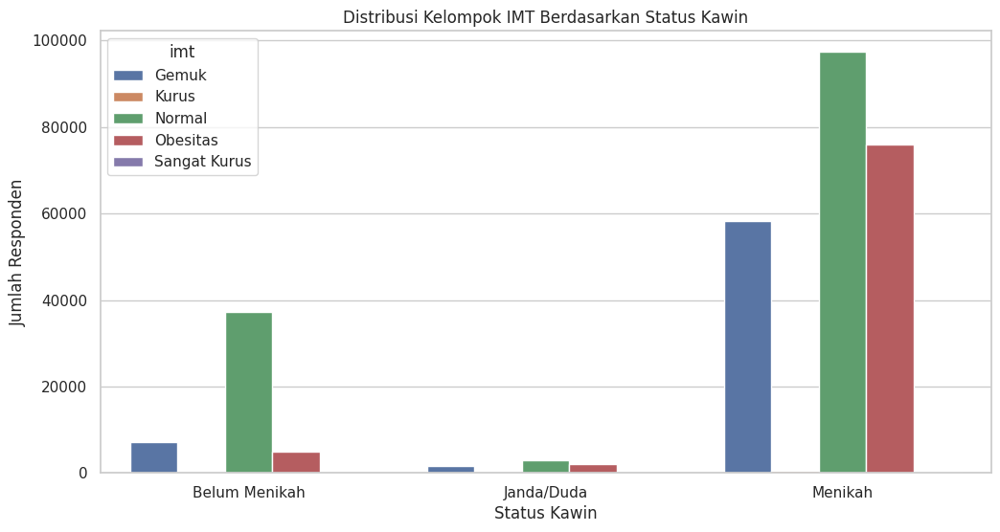

In [ ]:
# Plot Kelompok IMT terhadap Status Kawin
plt.figure(figsize=(12, 6))
sns.countplot(x="status_kawin", hue="imt", data=df)
plt.title("Distribusi Kelompok IMT Berdasarkan Status Kawin")
plt.xlabel("Status Kawin")
plt.ylabel("Jumlah Responden")
plt.show()

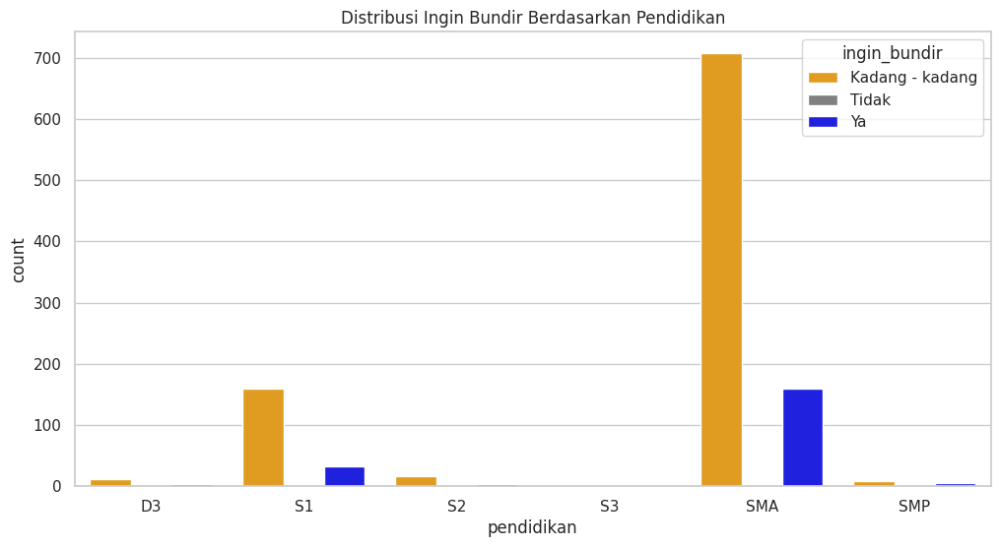

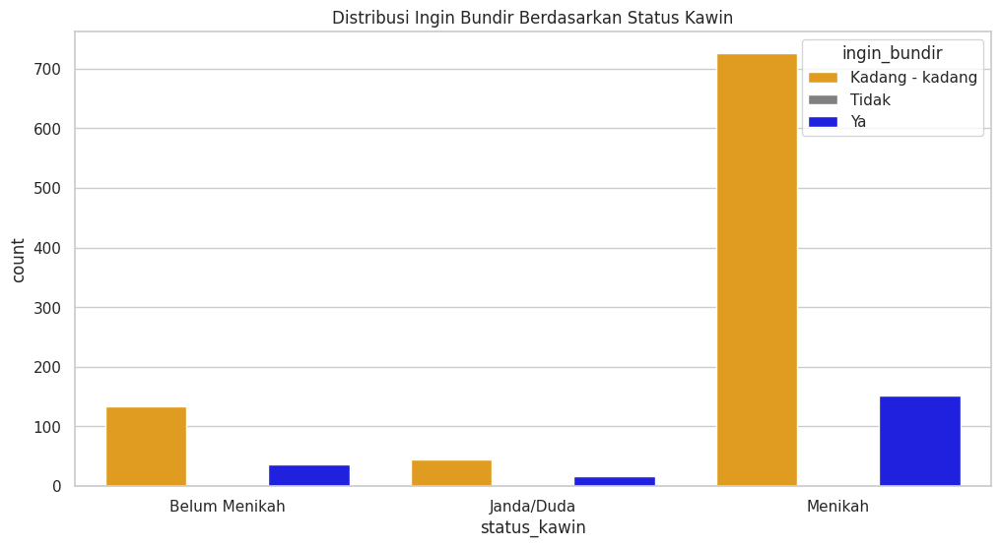

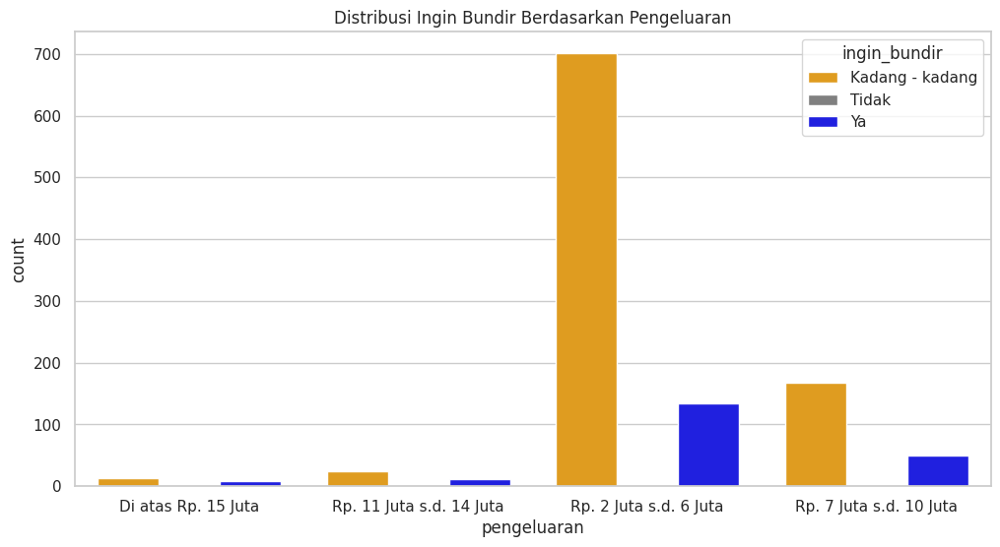

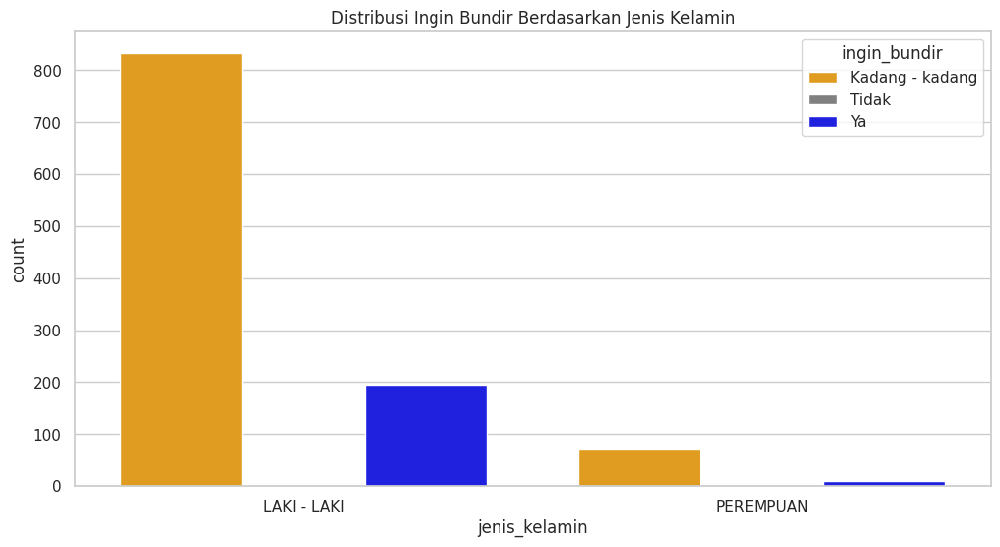

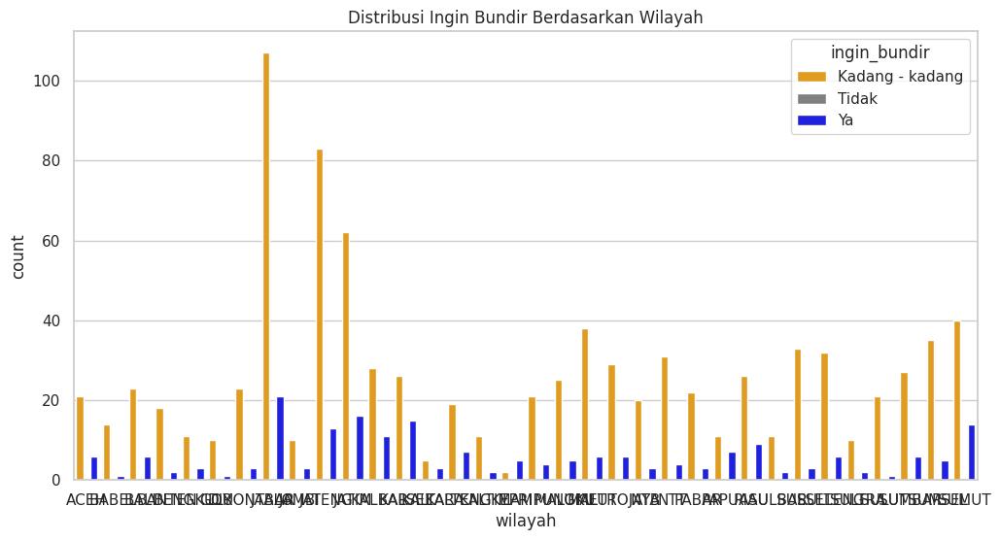

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set style
sns.set(style="whitegrid")

# Plot Pendidikan terhadap Ingin Bundir
plt.figure(figsize=(12, 6))
df_filtered = df[df['ingin_bundir'].isin(['Ya', 'Kadang - kadang'])]
palette = {"Ya": "blue", "Kadang - kadang": "orange", "Tidak": "gray"}
sns.countplot(x="pendidikan", hue="ingin_bundir", data=df_filtered, palette=palette)
plt.title("Distribusi Ingin Bundir Berdasarkan Pendidikan")
plt.show()

# Plot Status Kawin terhadap Ingin Bundir
plt.figure(figsize=(12, 6))
sns.countplot(x="status_kawin", hue="ingin_bundir", data=df[df['ingin_bundir'].isin(['Ya', 'Kadang - kadang'])], palette=palette)
plt.title("Distribusi Ingin Bundir Berdasarkan Status Kawin")
plt.show()

# Plot Pengeluaran terhadap Ingin Bundir
plt.figure(figsize=(12, 6))
sns.countplot(x="pengeluaran", hue="ingin_bundir", data=df[df['ingin_bundir'].isin(['Ya', 'Kadang - kadang'])], palette=palette)
plt.title("Distribusi Ingin Bundir Berdasarkan Pengeluaran")
plt.show()

# Plot Jenis Kelamin terhadap Ingin Bundir
plt.figure(figsize=(12, 6))
sns.countplot(x="jenis_kelamin", hue="ingin_bundir", data=df[df['ingin_bundir'].isin(['Ya', 'Kadang - kadang'])], palette=palette)
plt.title("Distribusi Ingin Bundir Berdasarkan Jenis Kelamin")
plt.show()

# Plot Wilayah terhadap Ingin Bundir
plt.figure(figsize=(12, 6))
sns.countplot(x="wilayah", hue="ingin_bundir", data=df[df['ingin_bundir'].isin(['Ya', 'Kadang - kadang'])], palette=palette)
plt.title("Distribusi Ingin Bundir Berdasarkan Wilayah")
plt.show()


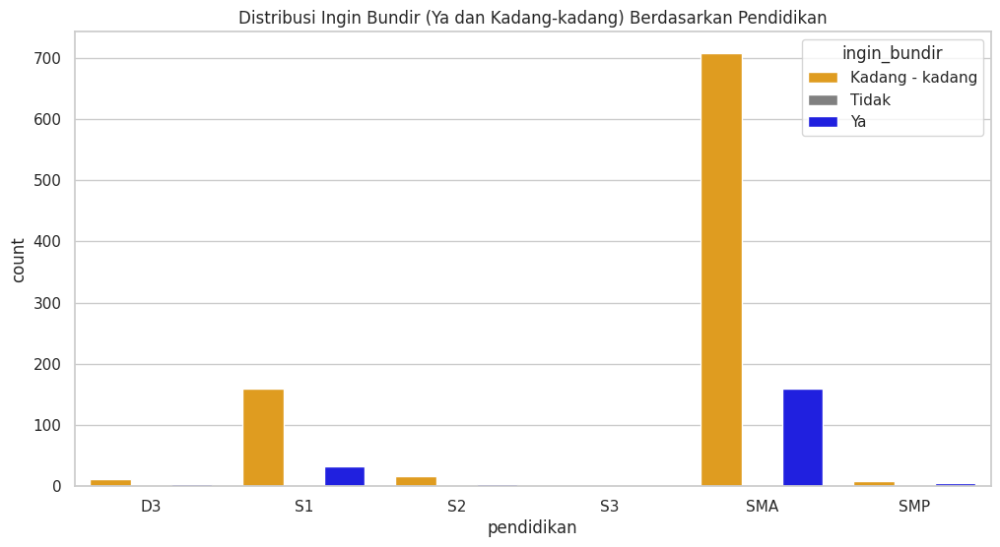

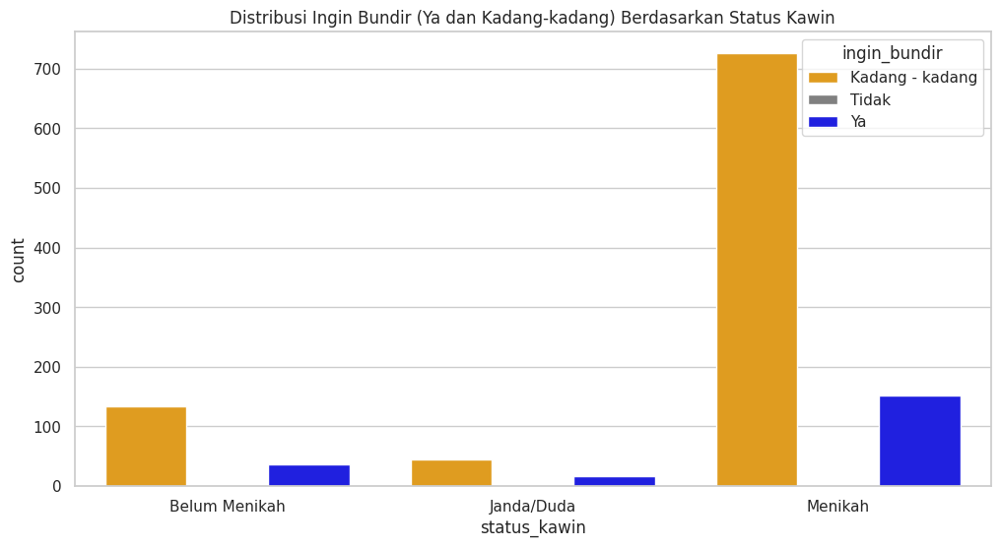

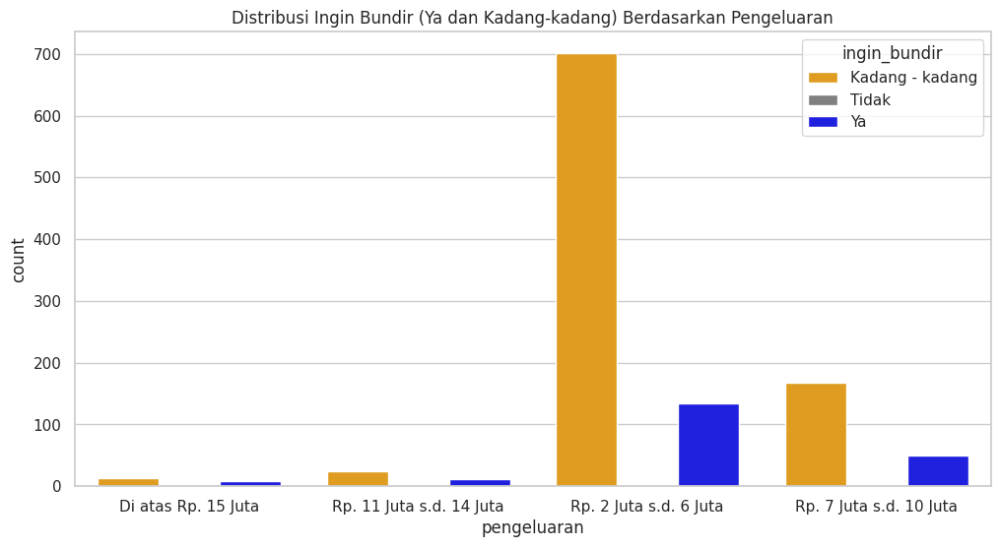

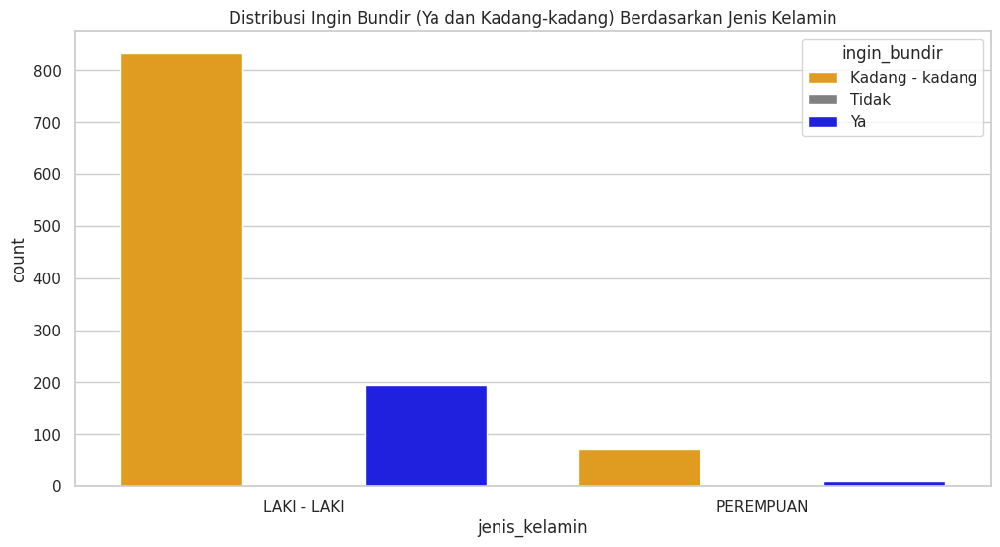

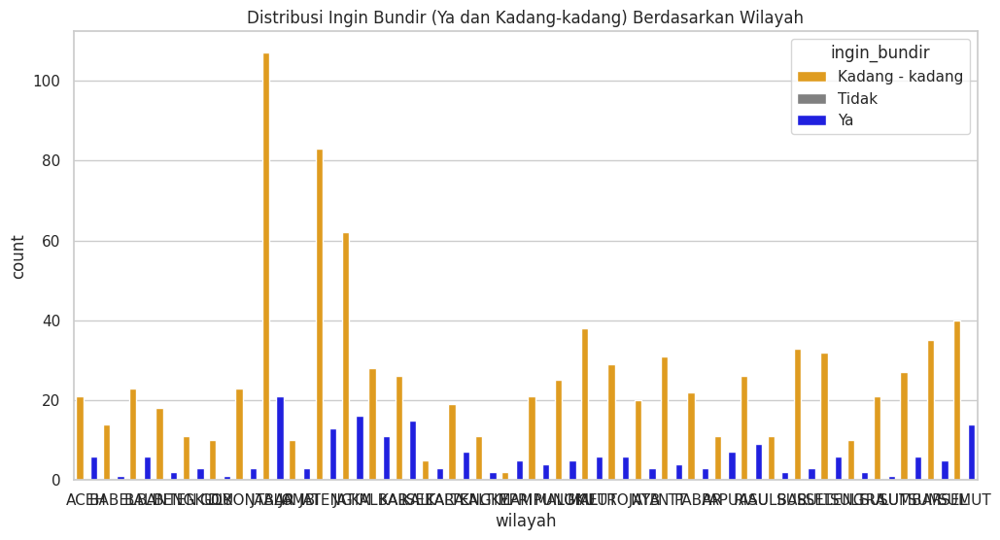

In [ ]:
# Plot Pendidikan terhadap Ingin Bundir (Ya dan Kadang-kadang)
plt.figure(figsize=(12, 6))
df_filtered = df[df['ingin_bundir'].isin(['Ya', 'Kadang - kadang'])]
palette = {"Ya": "blue", "Kadang - kadang": "orange", "Tidak": "gray"}
sns.countplot(x="pendidikan", hue="ingin_bundir", data=df_filtered, palette=palette)
plt.title("Distribusi Ingin Bundir (Ya dan Kadang-kadang) Berdasarkan Pendidikan")
plt.show()

# Plot Status Kawin terhadap Ingin Bundir (Ya dan Kadang-kadang)
plt.figure(figsize=(12, 6))
sns.countplot(x="status_kawin", hue="ingin_bundir", data=df_filtered, palette=palette)
plt.title("Distribusi Ingin Bundir (Ya dan Kadang-kadang) Berdasarkan Status Kawin")
plt.show()

# Plot Pengeluaran terhadap Ingin Bundir (Ya dan Kadang-kadang)
plt.figure(figsize=(12, 6))
sns.countplot(x="pengeluaran", hue="ingin_bundir", data=df_filtered, palette=palette)
plt.title("Distribusi Ingin Bundir (Ya dan Kadang-kadang) Berdasarkan Pengeluaran")
plt.show()

# Plot Jenis Kelamin terhadap Ingin Bundir (Ya dan Kadang-kadang)
plt.figure(figsize=(12, 6))
sns.countplot(x="jenis_kelamin", hue="ingin_bundir", data=df_filtered, palette=palette)
plt.title("Distribusi Ingin Bundir (Ya dan Kadang-kadang) Berdasarkan Jenis Kelamin")
plt.show()

# Plot Wilayah terhadap Ingin Bundir (Ya dan Kadang-kadang)
plt.figure(figsize=(12, 6))
sns.countplot(x="wilayah", hue="ingin_bundir", data=df_filtered, palette=palette)
plt.title("Distribusi Ingin Bundir (Ya dan Kadang-kadang) Berdasarkan Wilayah")
plt.show()


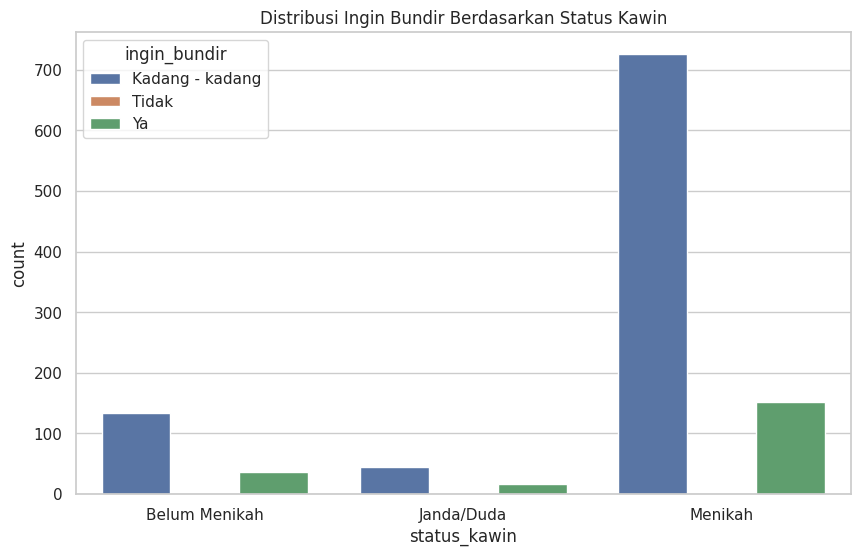

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(x="status_kawin", hue="ingin_bundir", data=df[df['ingin_bundir'].isin(['Ya', 'Kadang - kadang'])])
plt.title("Distribusi Ingin Bundir Berdasarkan Status Kawin")
plt.show()

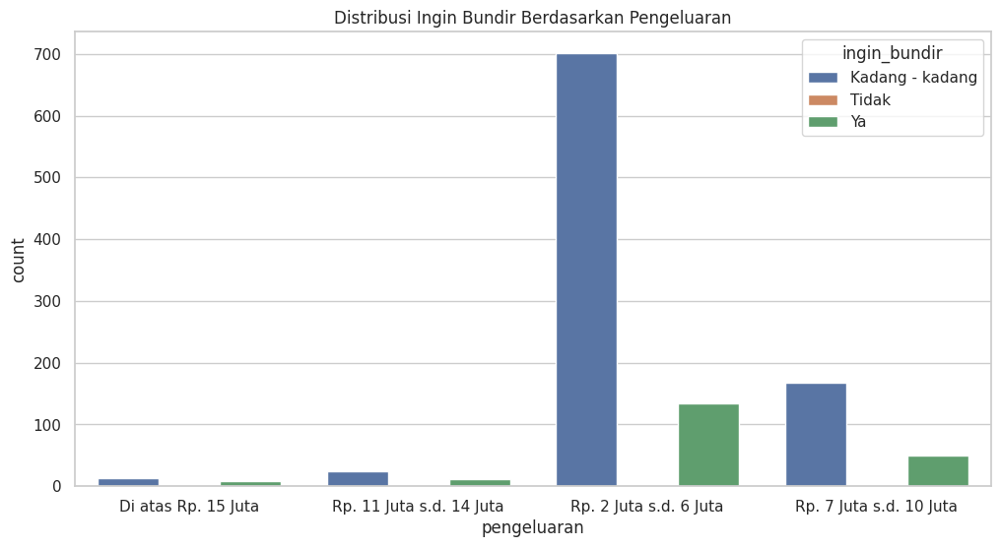

In [ ]:
plt.figure(figsize=(12, 6))
sns.countplot(x="pengeluaran", hue="ingin_bundir", data=df[df['ingin_bundir'].isin(['Ya', 'Kadang - kadang'])])
plt.title("Distribusi Ingin Bundir Berdasarkan Pengeluaran")
plt.show()

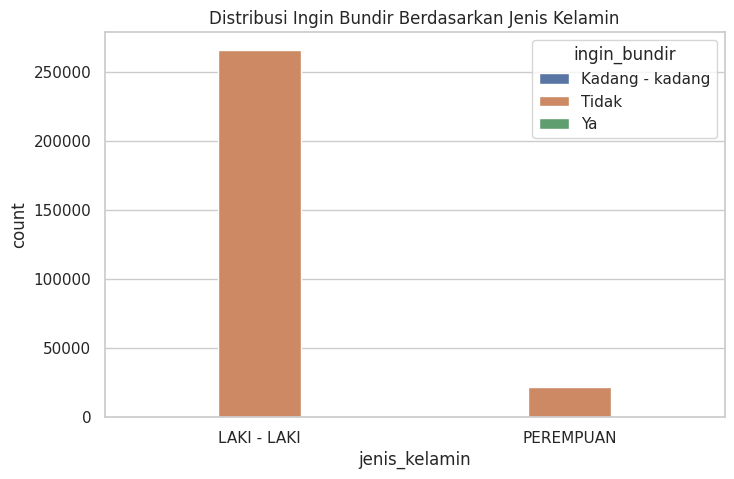

In [ ]:
plt.figure(figsize=(8, 5))
sns.countplot(x="jenis_kelamin", hue="ingin_bundir", data=df)
plt.title("Distribusi Ingin Bundir Berdasarkan Jenis Kelamin")
plt.show()

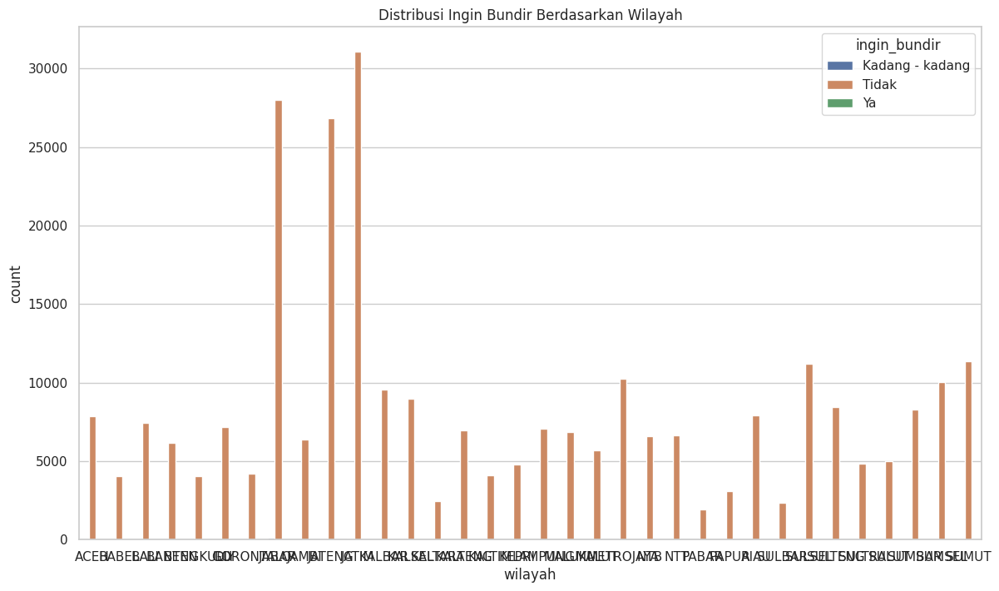

In [ ]:
plt.figure(figsize=(14, 8))
sns.countplot(x="wilayah", hue="ingin_bundir", data=df)
plt.title("Distribusi Ingin Bundir Berdasarkan Wilayah")
plt.show()


In [ ]:
print(df['ingin_bundir'].value_counts())

Tidak              287545
Kadang - kadang       905
Ya                    204
Name: ingin_bundir, dtype: int64


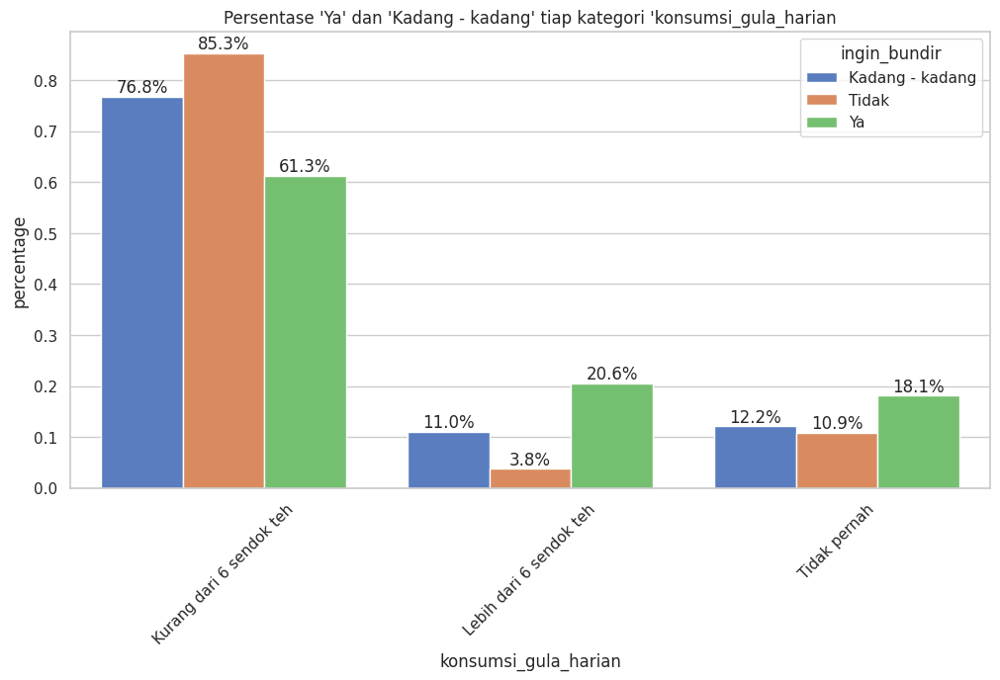

In [ ]:
barplot_prop_percent_hue(x="konsumsi_gula_harian",
                     hue="ingin_bundir",
                     df=df,
                     size=(12, 6),
                     title="Persentase 'Ya' dan 'Kadang - kadang' tiap kategori 'konsumsi_gula_harian")

<Figure size 1200x600 with 0 Axes>

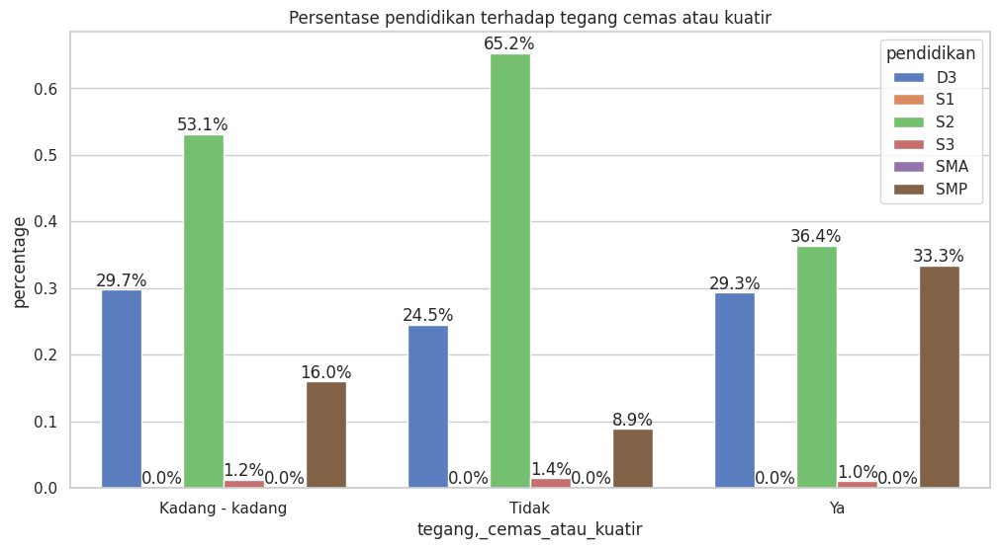

In [ ]:
barplot_prop_percent(x="tegang,_cemas_atau_kuatir",
                     hue="pendidikan",
                     df=df,
                     size=(12, 6),
                     title="Persentase pendidikan terhadap tegang cemas atau kuatir",
                     hue_filter=['D3', 'S2', 'S3', 'SMP'])

<Figure size 1200x600 with 0 Axes>

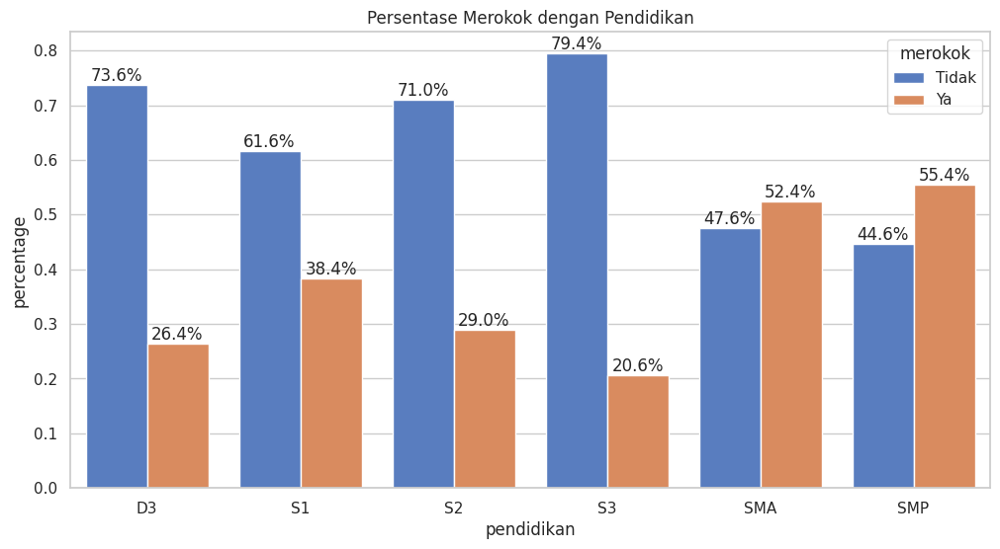

In [ ]:
barplot_prop_percent(x="pendidikan",
                     hue="merokok",
                     df=df,
                     size=(12, 6),
                     title="Persentase Merokok dengan Pendidikan")

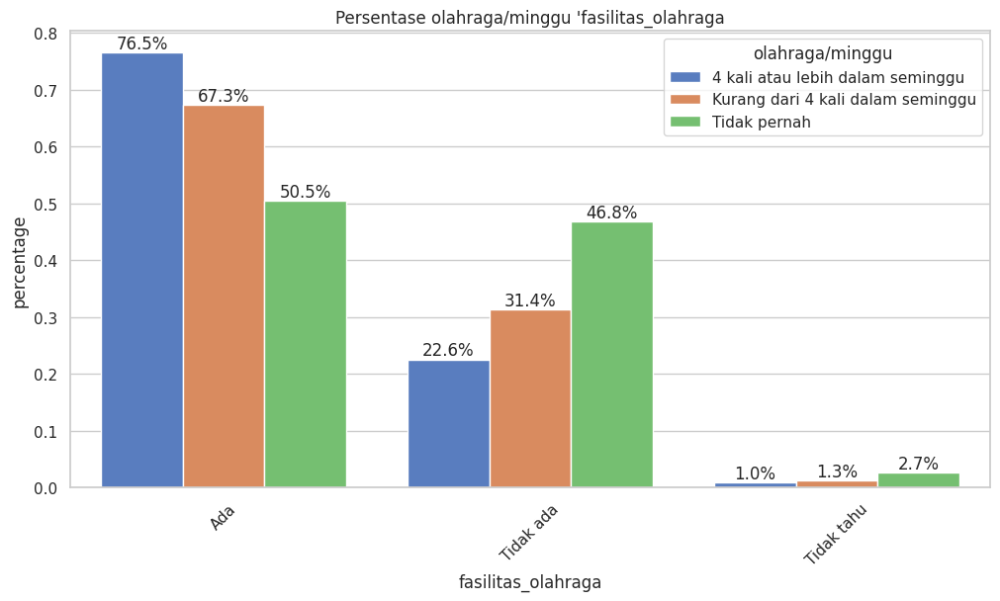

In [ ]:
barplot_prop_percent_hue(x="fasilitas_olahraga",
                     hue="olahraga/minggu",
                     df=df,
                     size=(12, 6),
                     title="Persentase olahraga/minggu 'fasilitas_olahraga")

<Figure size 1200x600 with 0 Axes>

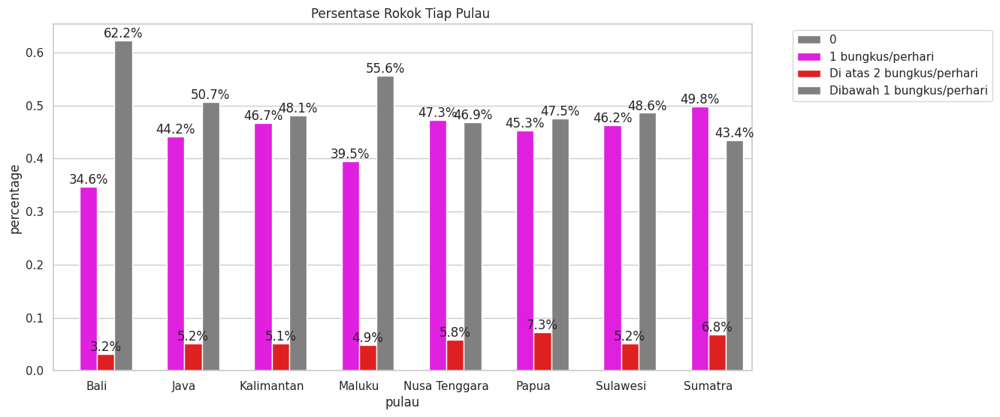

In [ ]:
barplot_prop_percent(x="pulau",
                     hue="(jk)jumlah_rokok_per_hari",
                     df=df,
                     size=(12, 6),
                     title="Persentase Rokok Tiap Pulau ",
                     hue_filter=['1 bungkus/perhari', 'Di atas 2 bungkus/perhari', 'Dibawah 1 bungkus/perhari'],
                     out=True,
                     hue_palette=['grey', 'magenta', 'red', 'grey'])

##Generasi mana yg cenderung terganggu kesehatan mentalnya (1)
---
Dibuat kolom buru untuk generasi untuk kemudian dianalisis dari kelompok generasi.

In [ ]:
# Fungsi untuk mengubah umur menjadi generasi
def kategorikan_generasi(usia):
    if usia > 58:
        return 'Baby Boomers'
    elif 43 <= usia <= 58:
        return 'Generasi X'
    elif 27 <= usia < 43:
        return 'Milenial'
    elif usia <27:
        return 'Generasi Z'
# Menambahkan kolom 'generasi' ke DataFrame
df['generasi'] = df['usia'].apply(kategorikan_generasi)

# Menampilkan DataFrame hasil
print(df)

       wilayah jenis_kelamin  usia  lama_berdinas pendidikan  tinggi  berat  \
ID                                                                            
1       KALBAR   LAKI - LAKI  34.0           16.0        SMA   168.9   85.0   
2       KALBAR   LAKI - LAKI  43.0           23.0        SMA   169.5   70.0   
3       KALBAR   LAKI - LAKI  21.0            1.0        SMA   169.5   60.0   
4       KALBAR   LAKI - LAKI  40.0           23.0         S2   166.8   80.0   
5       KALBAR   LAKI - LAKI  28.0            9.0        SMA   164.5   62.0   
...        ...           ...   ...            ...        ...     ...    ...   
289797  KALSEL   LAKI - LAKI  23.0            4.0        SMA   169.0   60.0   
289798  JATENG     PEREMPUAN  54.0           27.0        SMA   155.0   60.0   
289799  SUMSEL   LAKI - LAKI  51.0            NaN        SMA     NaN   57.0   
289800   JABAR   LAKI - LAKI  35.0           17.0        SMA   179.0   55.0   
289801   JABAR   LAKI - LAKI  19.0            1.0   

<Figure size 1200x600 with 0 Axes>

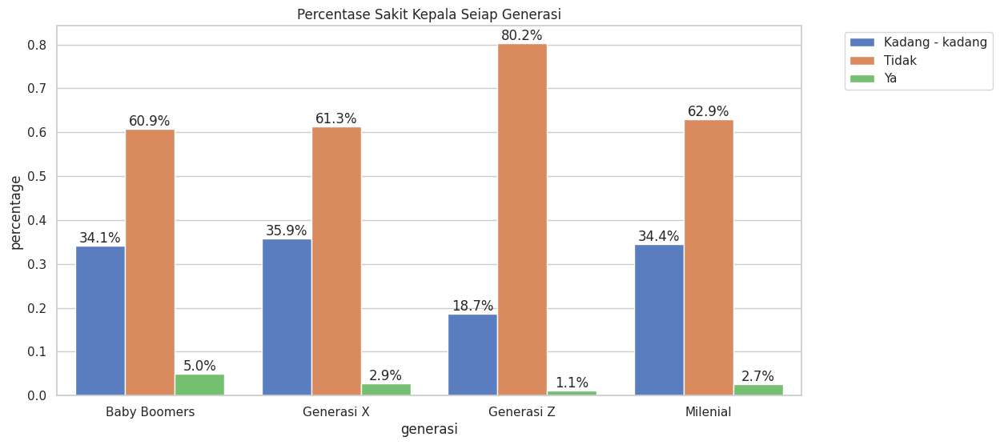

In [ ]:
#generasi dengan sakit kepala
barplot_prop_percent(x="generasi",
                     hue="sakit_kepala",
                     df=df,
                     size=(12, 6),
                     title="Percentase Sakit Kepala Seiap Generasi",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'],out=True)

<Figure size 1200x600 with 0 Axes>

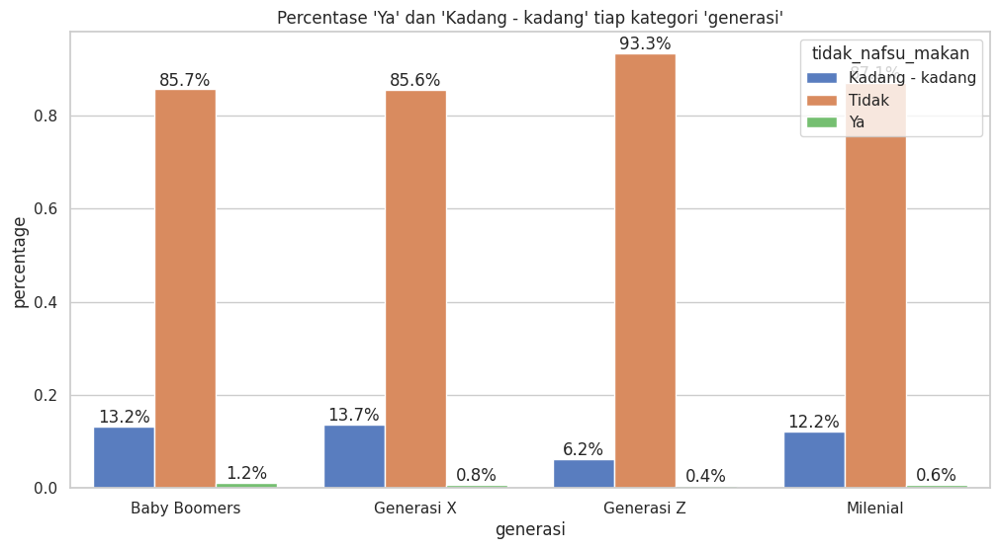

In [ ]:
#generasi dengan tidak nafsu makan
barplot_prop_percent(x="generasi",
                     hue="tidak_nafsu_makan",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

<Figure size 1200x600 with 0 Axes>

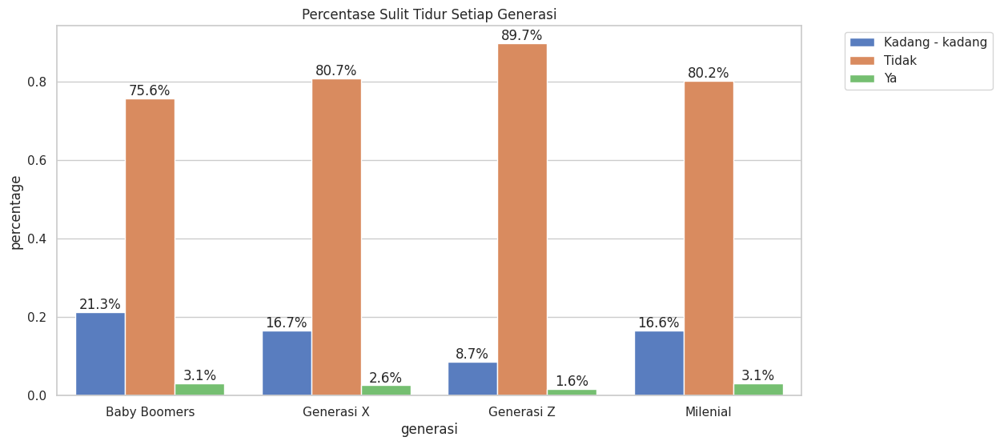

In [ ]:
#generasi dengan sulit tidur
barplot_prop_percent(x="generasi",
                     hue="sulit_tidur",
                     df=df,
                     size=(12, 6),
                     title="Percentase Sulit Tidur Setiap Generasi",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'],out=True)

<Figure size 1200x600 with 0 Axes>

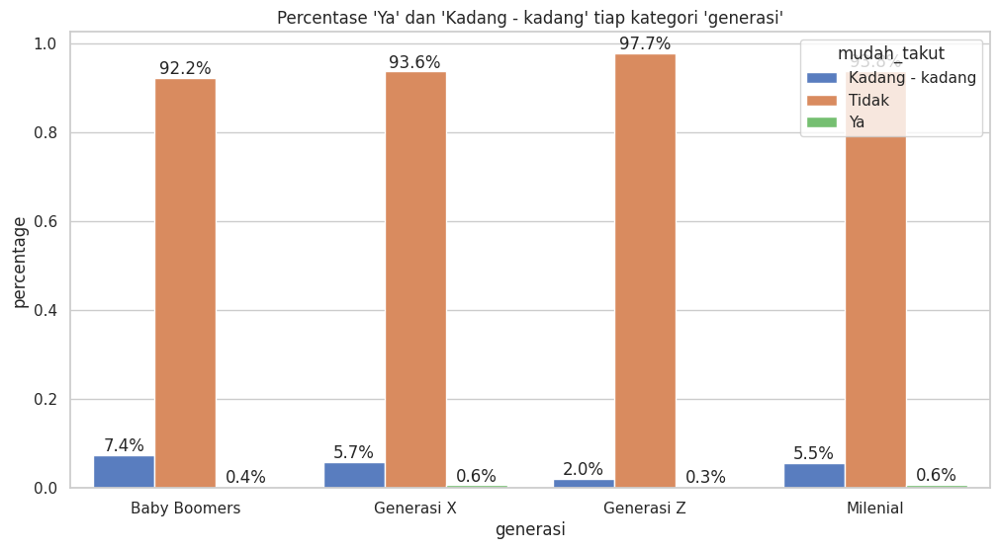

In [ ]:
#generasi dengan mudah_takut
barplot_prop_percent(x="generasi",
                     hue="mudah_takut",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

<Figure size 1200x600 with 0 Axes>

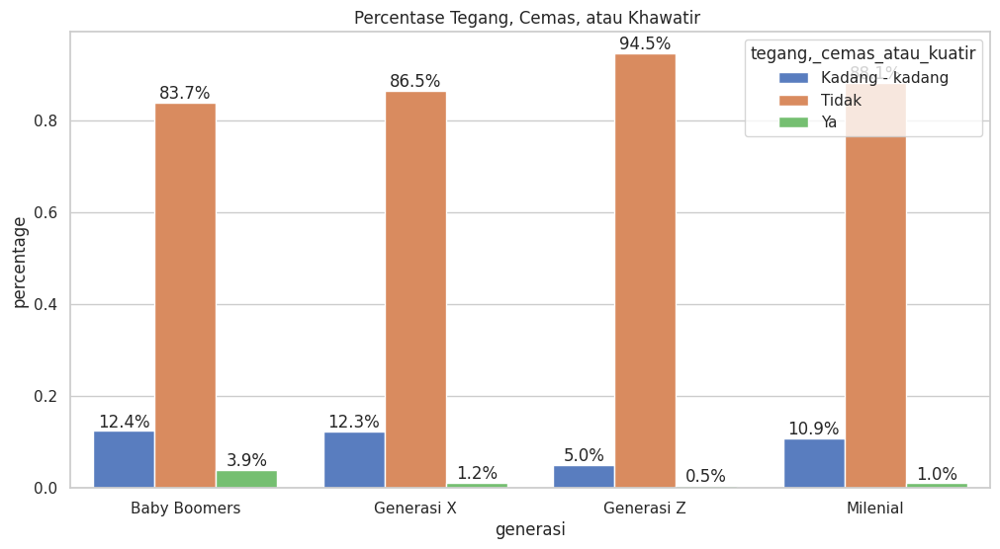

In [ ]:
#generasi dengan tegang, cemas, atau khawatir
barplot_prop_percent(x="generasi",
                     hue="tegang,_cemas_atau_kuatir",
                     df=df,
                     size=(12, 6),
                     title="Percentase Tegang, Cemas, atau Khawatir ",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

<Figure size 1200x600 with 0 Axes>

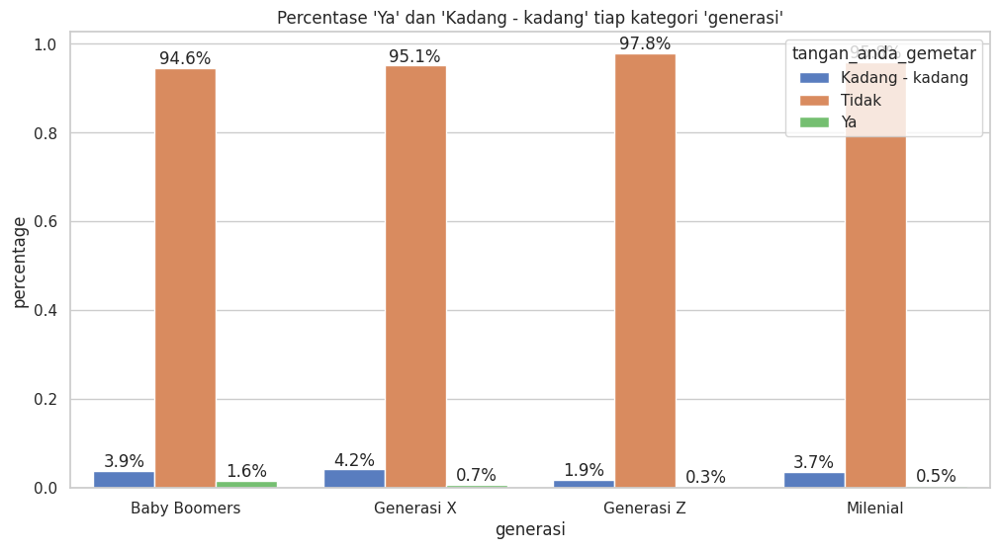

In [ ]:
#generasi dengan tangan anda gemetar
barplot_prop_percent(x="generasi",
                     hue="tangan_anda_gemetar",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

<Figure size 1200x600 with 0 Axes>

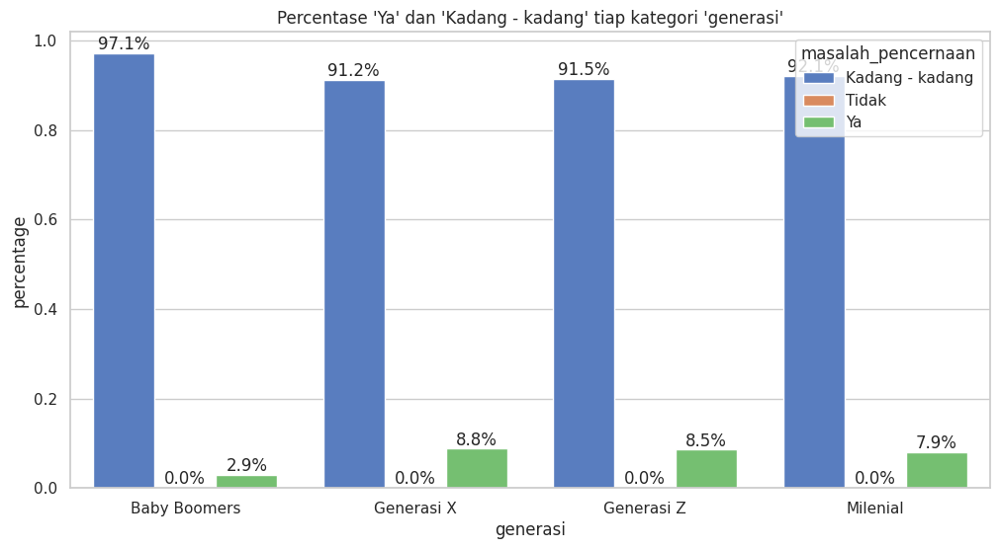

In [ ]:
#generasi dengan masalah pencernaan terganggu
barplot_prop_percent(x="generasi",
                     hue="masalah_pencernaan",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang'])

<Figure size 1200x600 with 0 Axes>

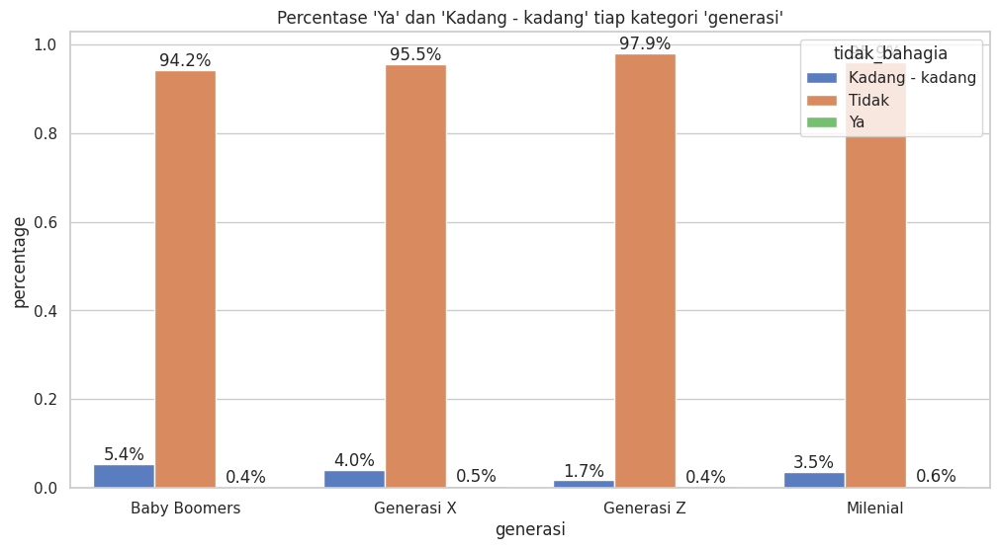

In [ ]:
#generasi dengan tidak bahagia
barplot_prop_percent(x="generasi",
                     hue="tidak_bahagia",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

<Figure size 1200x600 with 0 Axes>

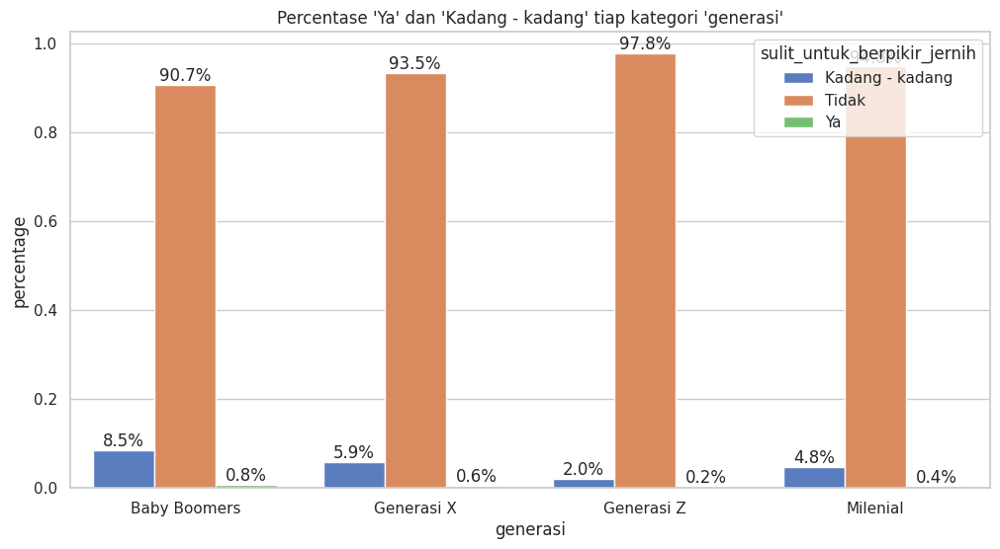

In [ ]:
#generasi dengan sulit berpikir jernih
barplot_prop_percent(x="generasi",
                     hue="sulit_untuk_berpikir_jernih",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

<Figure size 1200x600 with 0 Axes>

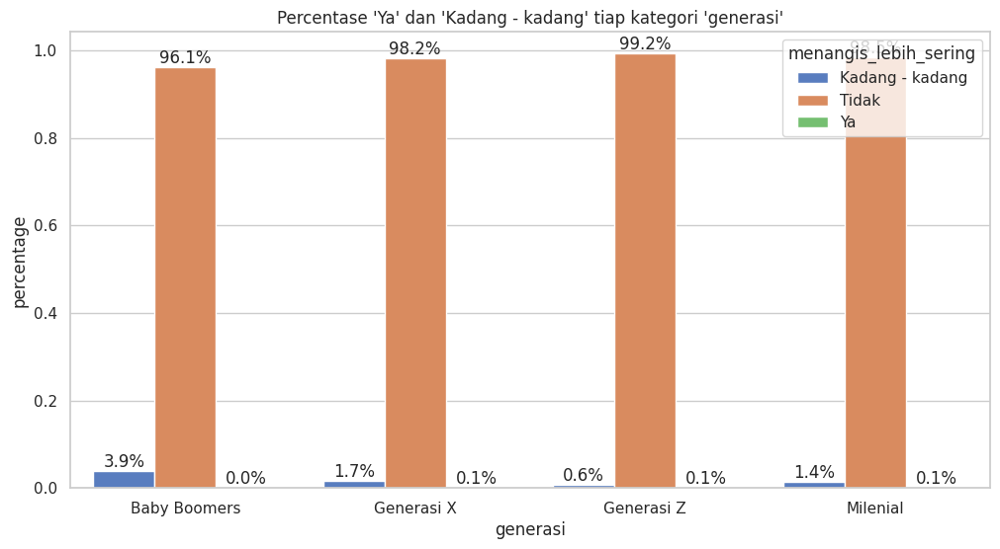

In [ ]:
#generasi dengan menangis lebih sering
barplot_prop_percent(x="generasi",
                     hue="menangis_lebih_sering",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

<Figure size 1200x600 with 0 Axes>

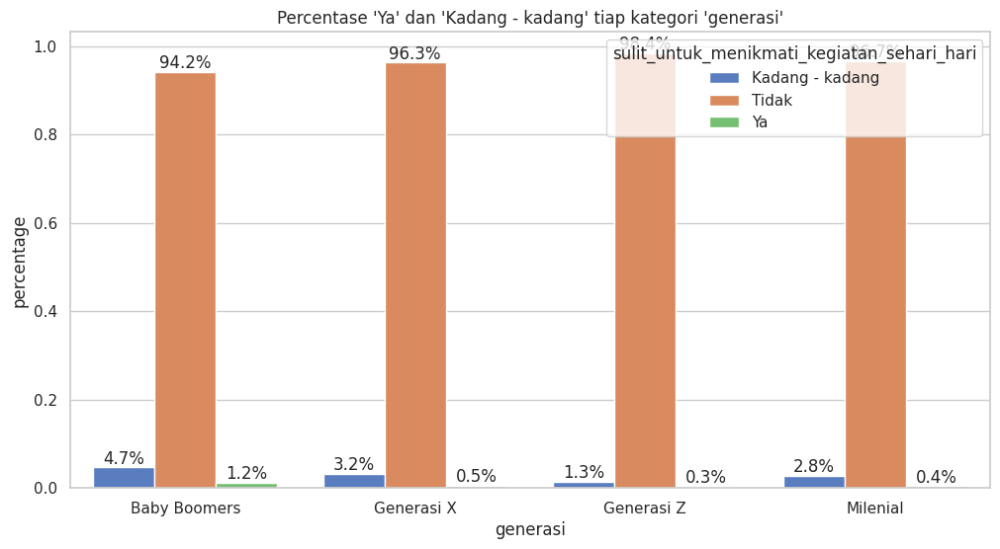

In [ ]:
#generasi dengan sulit untuk menikmati kegiatan sehari hari
barplot_prop_percent(x="generasi",
                     hue="sulit_untuk_menikmati_kegiatan_sehari_hari",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

<Figure size 1200x600 with 0 Axes>

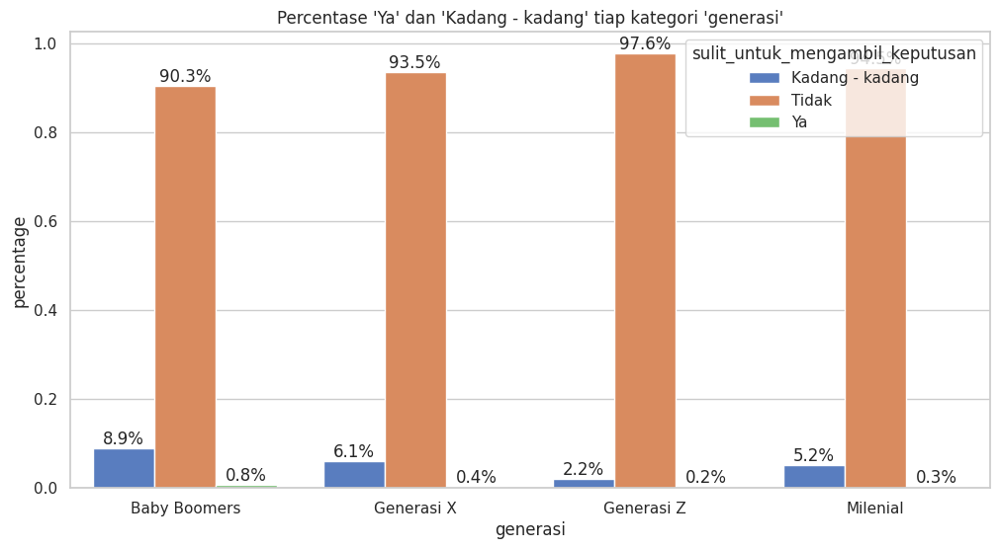

In [ ]:
#generasi dengan sulit untuk mengambil keputusan
barplot_prop_percent(x="generasi",
                     hue="sulit_untuk_mengambil_keputusan",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

<Figure size 1200x600 with 0 Axes>

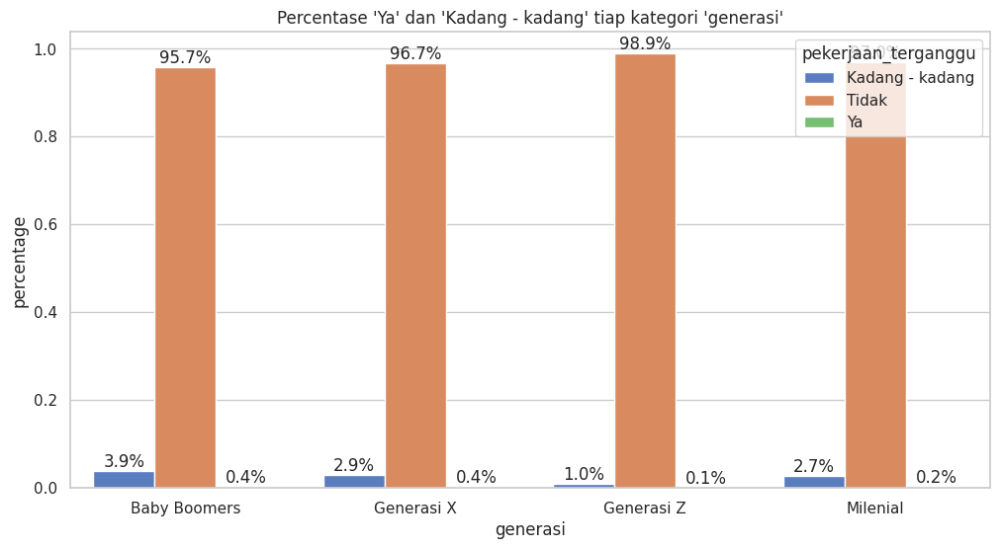

In [ ]:
#generasi dengan sulit untuk pekerjaan terganggu
barplot_prop_percent(x="generasi",
                     hue="pekerjaan_terganggu",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

<Figure size 1200x600 with 0 Axes>

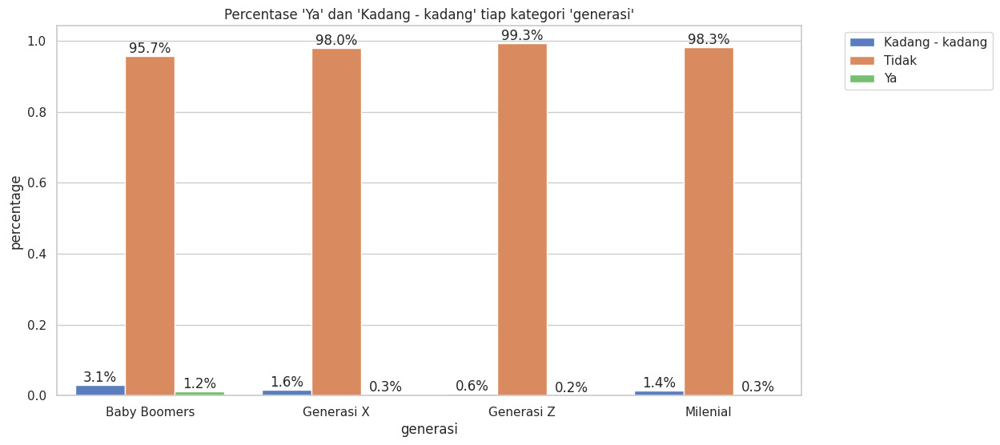

In [ ]:
#generasi dengan tidak mampu melakukan hal hal yang bermanfaat dalam hidup
barplot_prop_percent(x="generasi",
                     hue="tidak_mampu_melakukan_hal_hal_yang_bermanfaat_dalam_hidup",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'], out = True)

<Figure size 1200x600 with 0 Axes>

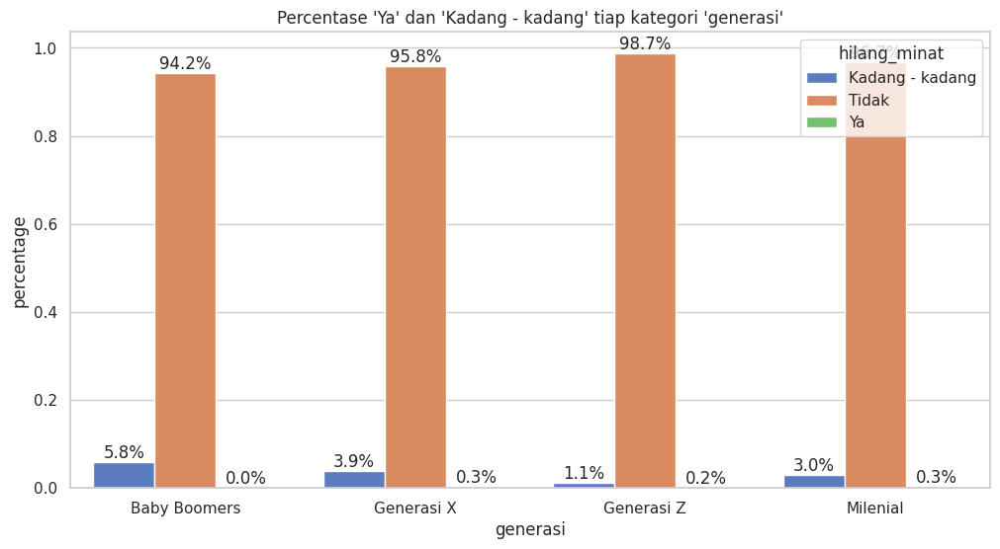

In [ ]:
#generasi dengan hilang minat
barplot_prop_percent(x="generasi",
                     hue="hilang_minat",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

<Figure size 1200x600 with 0 Axes>

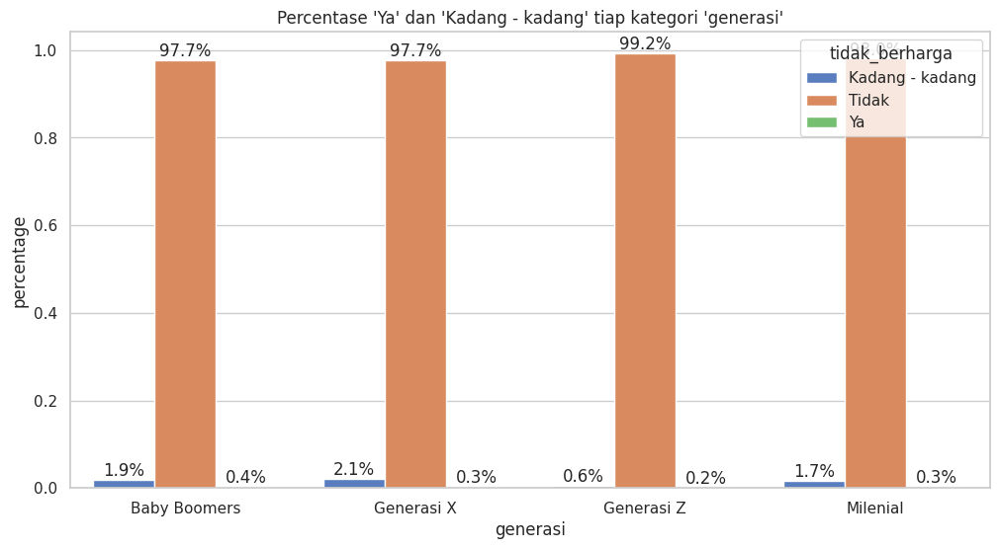

In [ ]:
#generasi dengan tidak berharga
barplot_prop_percent(x="generasi",
                     hue="tidak_berharga",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

<Figure size 1200x600 with 0 Axes>

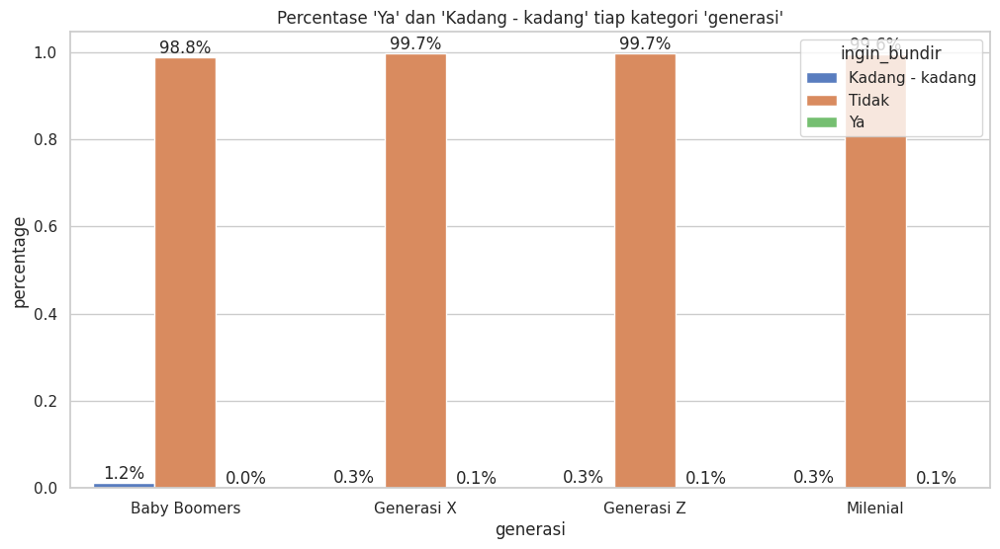

In [ ]:
#generasi dengan ingin bundir
barplot_prop_percent(x="generasi",
                     hue="ingin_bundir",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

<Figure size 1200x600 with 0 Axes>

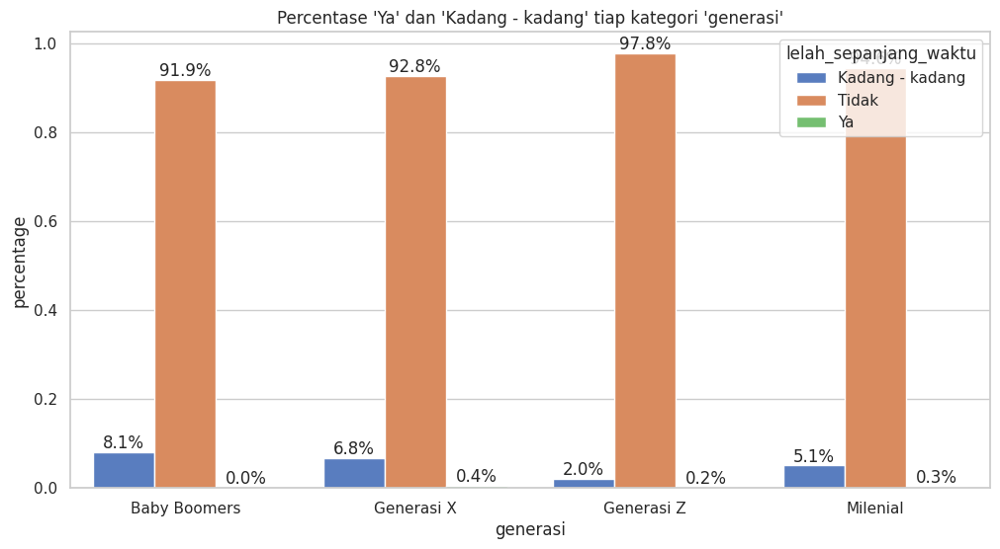

In [ ]:
#generasi dengan lelah sepanjang waktu
barplot_prop_percent(x="generasi",
                     hue="lelah_sepanjang_waktu",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

<Figure size 1200x600 with 0 Axes>

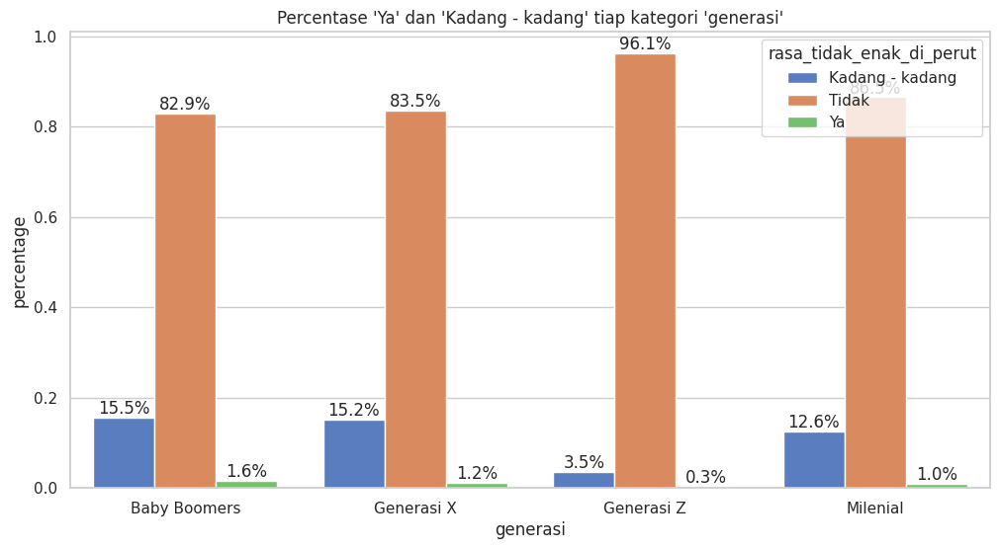

In [ ]:
#generasi dengan rasa tidak enak di perut
barplot_prop_percent(x="generasi",
                     hue="rasa_tidak_enak_di_perut",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

##Generasi mana yg cenderung terganggu kesehatan mentalnya (2)

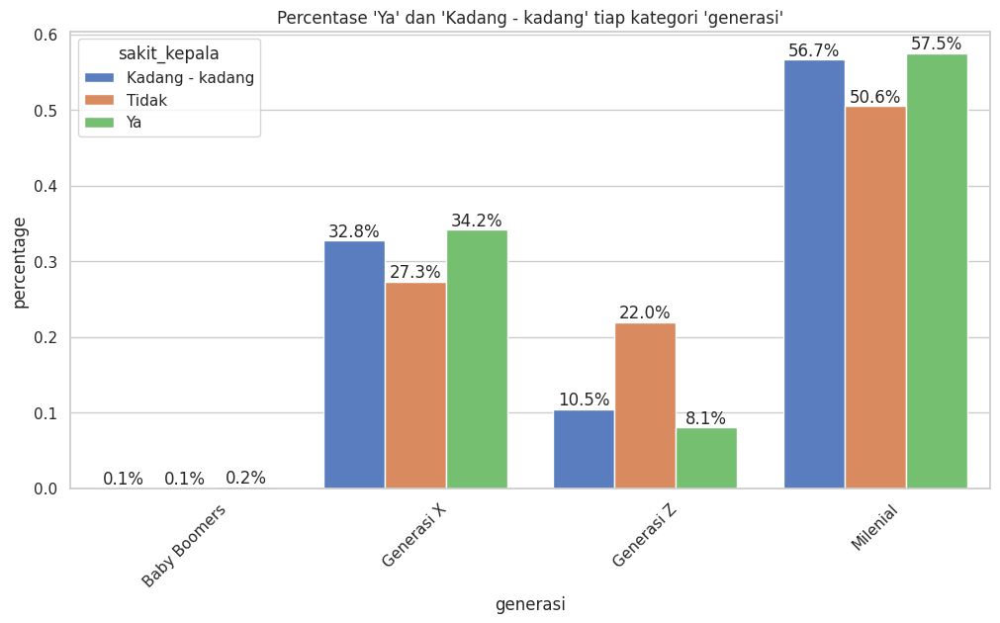

In [ ]:
#generasi dengan sakit kepala
barplot_prop_percent_hue(x="generasi",
                     hue="sakit_kepala",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

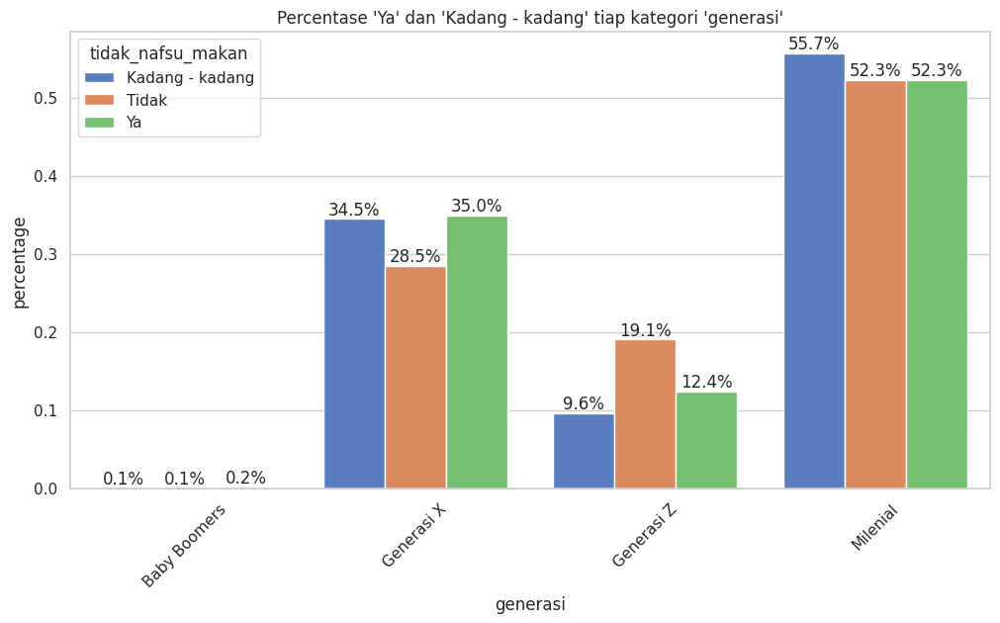

In [ ]:
#generasi dengan tidak nafsu makan
barplot_prop_percent_hue(x="generasi",
                     hue="tidak_nafsu_makan",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

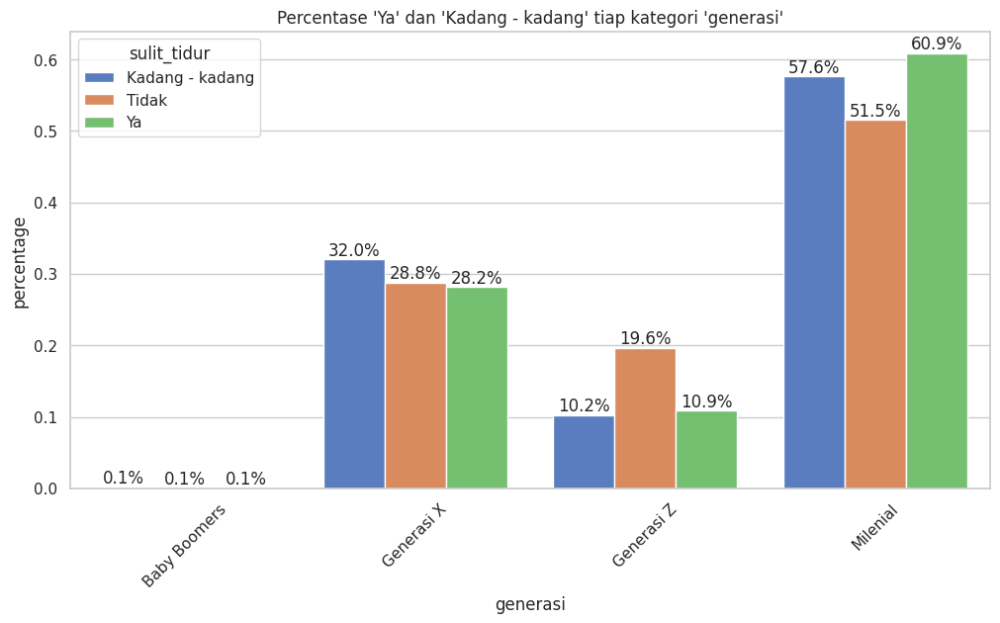

In [ ]:
#generasi dengan sulit tidur
barplot_prop_percent_hue(x="generasi",
                     hue="sulit_tidur",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

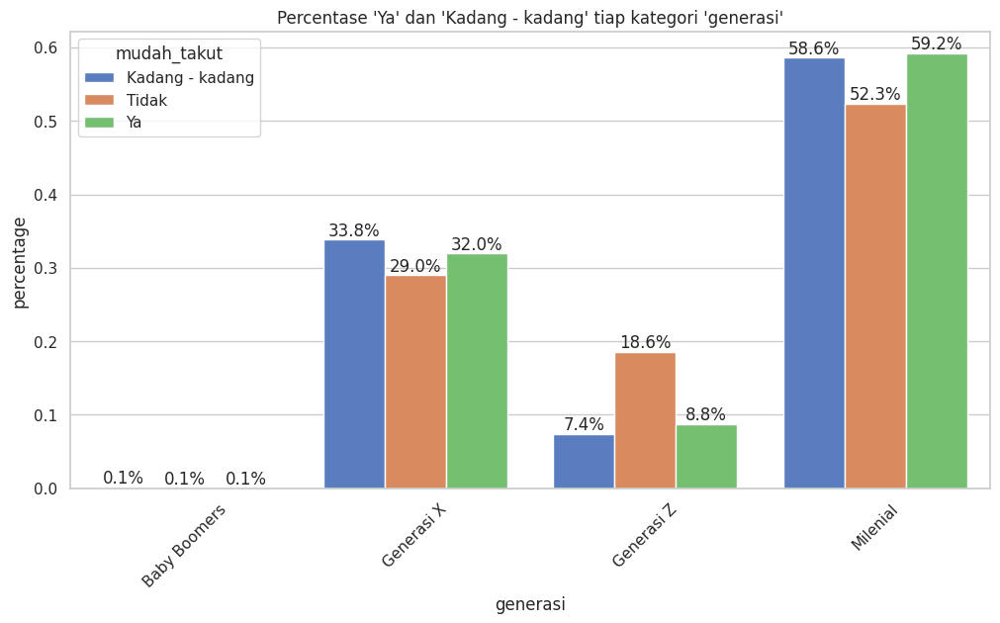

In [ ]:
#generasi dengan mudah_takut
barplot_prop_percent_hue(x="generasi",
                     hue="mudah_takut",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

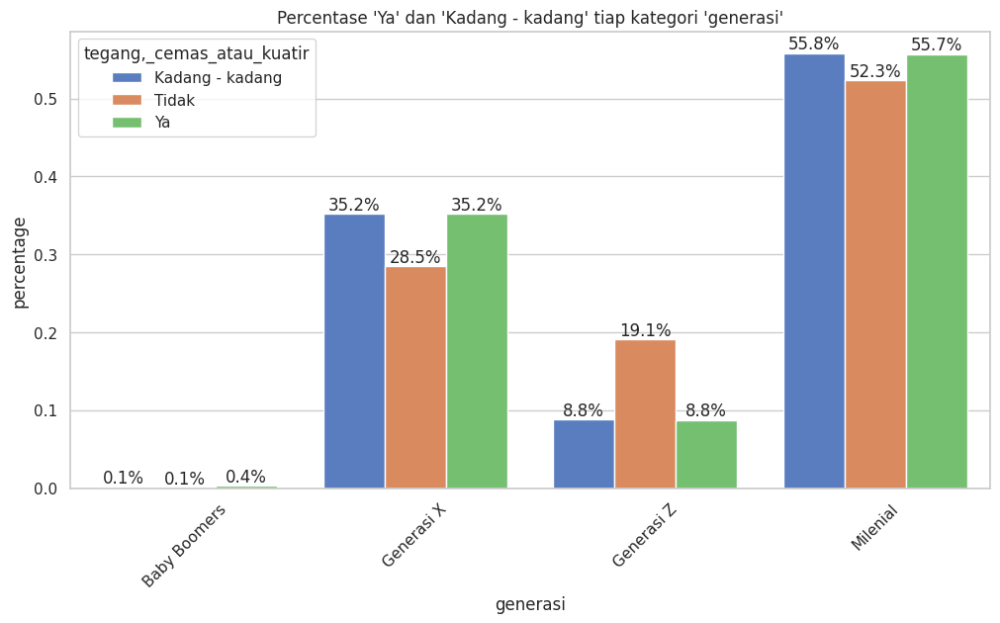

In [ ]:
#generasi dengan tegang, cemas, atau khawatir
barplot_prop_percent_hue(x="generasi",
                     hue="tegang,_cemas_atau_kuatir",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

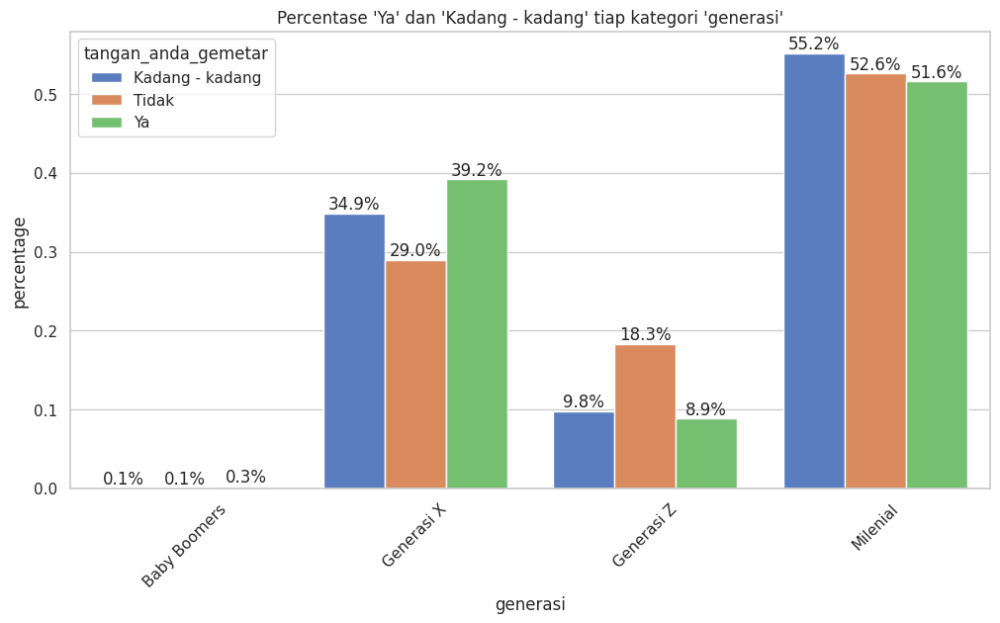

In [ ]:
#generasi dengan tangan anda gemetar
barplot_prop_percent_hue(x="generasi",
                     hue="tangan_anda_gemetar",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

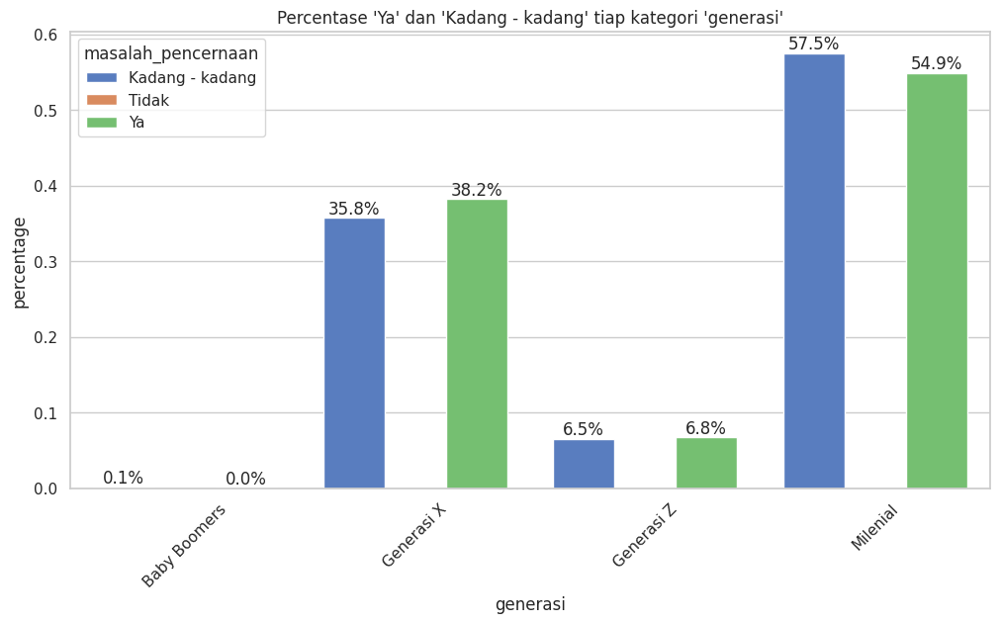

In [ ]:
#generasi dengan masalah pencernaan terganggu
barplot_prop_percent_hue(x="generasi",
                     hue="masalah_pencernaan",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang'])

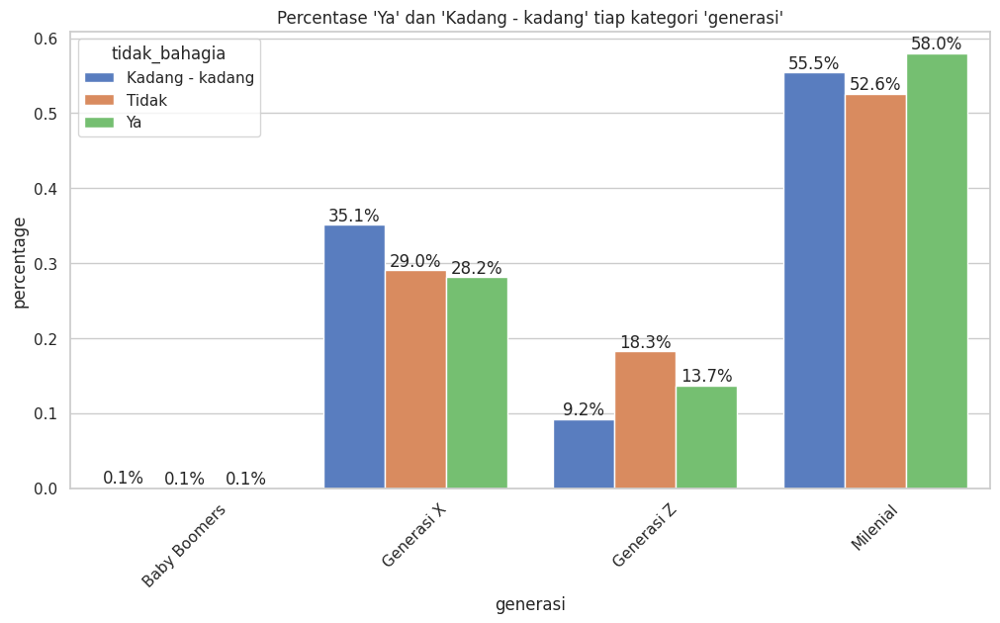

In [ ]:
#generasi dengan tidak bahagia
barplot_prop_percent_hue(x="generasi",
                     hue="tidak_bahagia",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

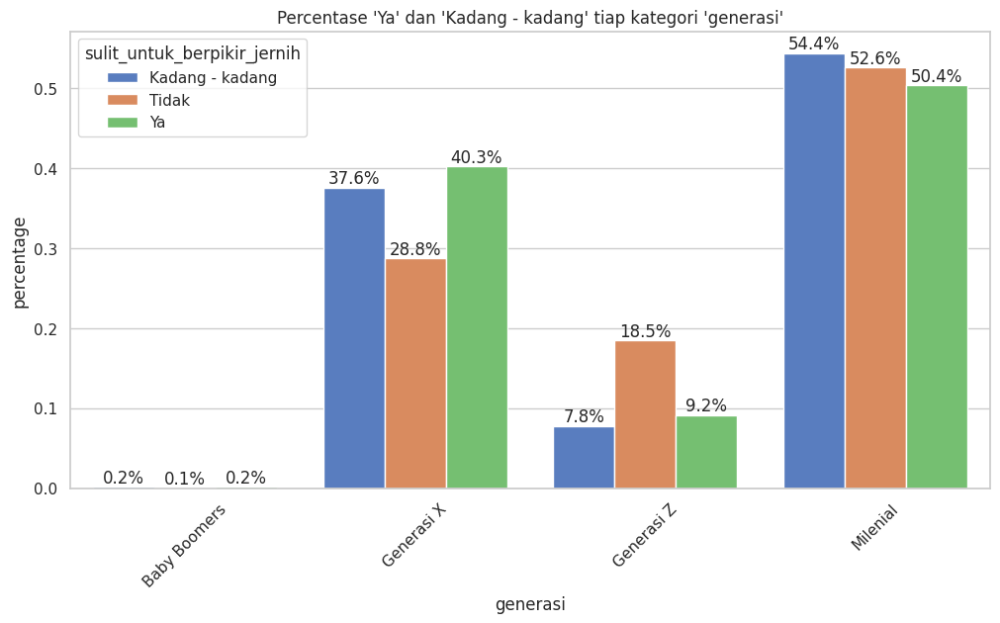

In [ ]:
#generasi dengan sulit berpikir jernih
barplot_prop_percent_hue(x="generasi",
                     hue="sulit_untuk_berpikir_jernih",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

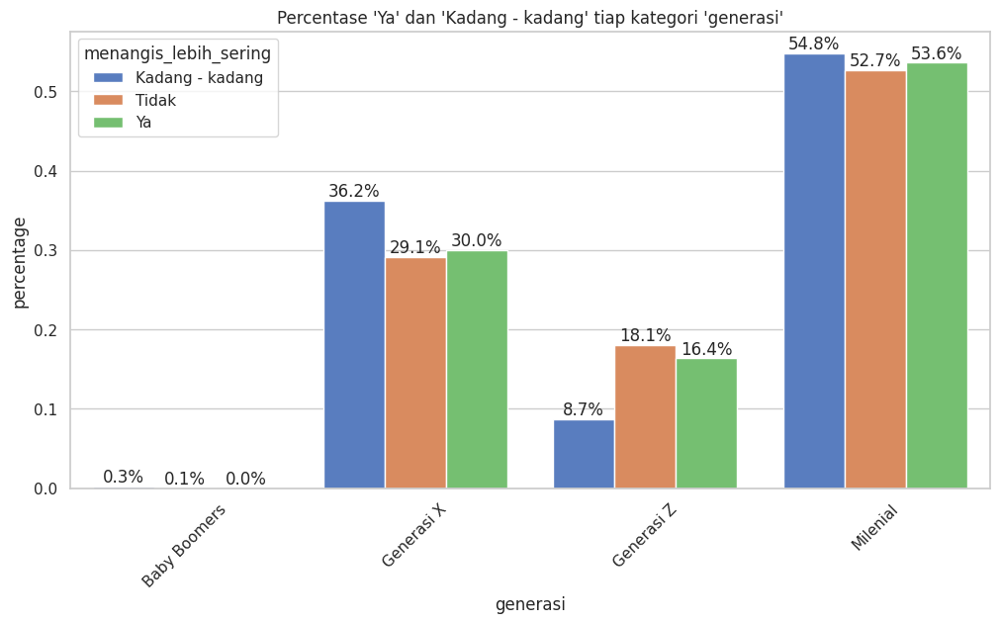

In [ ]:
#generasi dengan menangis lebih sering
barplot_prop_percent_hue(x="generasi",
                     hue="menangis_lebih_sering",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

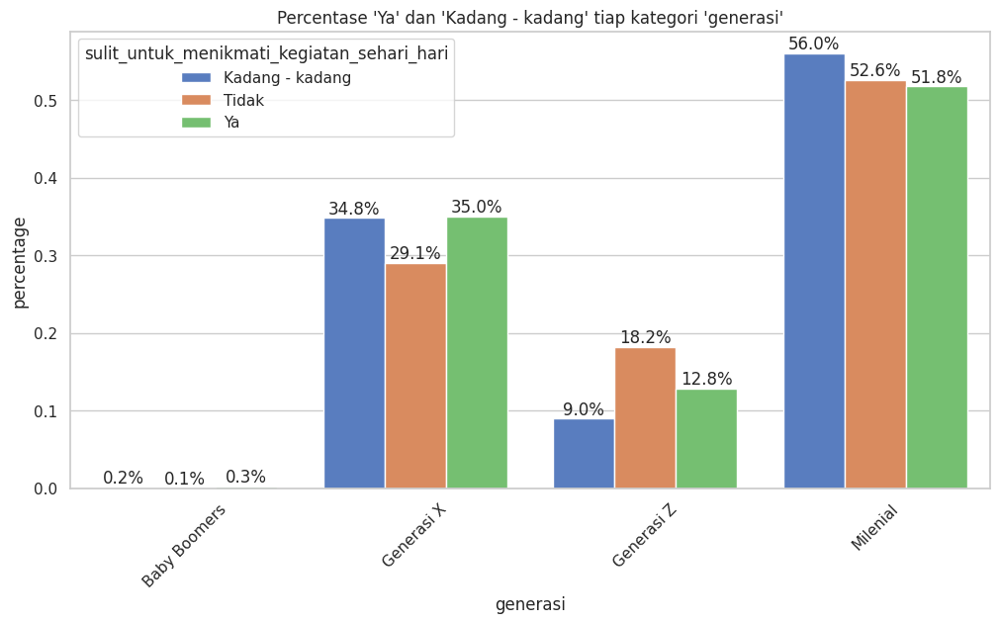

In [ ]:
#generasi dengan sulit untuk menikmati kegiatan sehari hari
barplot_prop_percent_hue(x="generasi",
                     hue="sulit_untuk_menikmati_kegiatan_sehari_hari",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

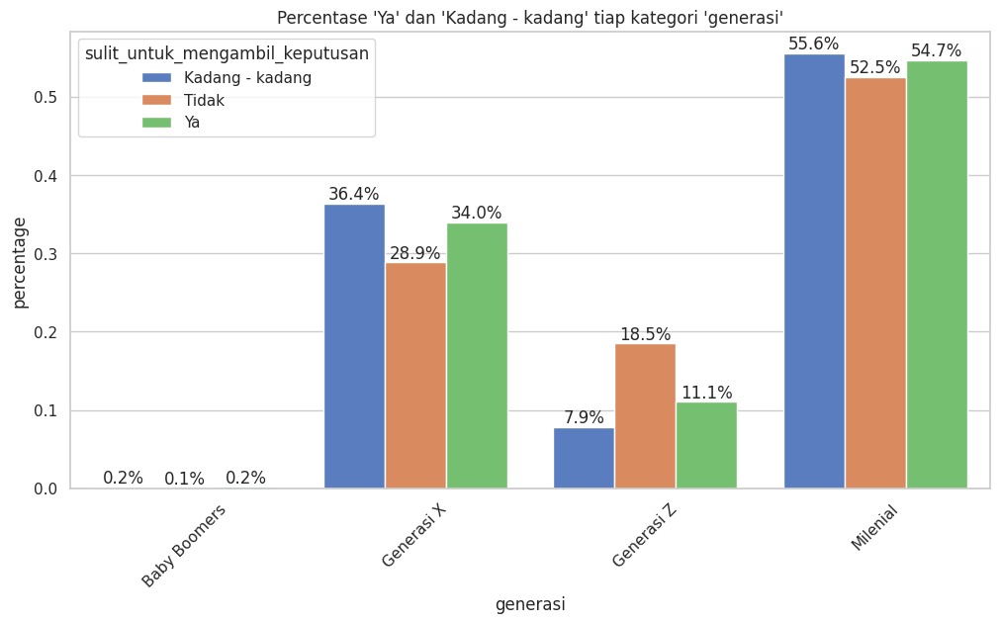

In [ ]:
#generasi dengan sulit untuk mengambil keputusan
barplot_prop_percent_hue(x="generasi",
                     hue="sulit_untuk_mengambil_keputusan",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

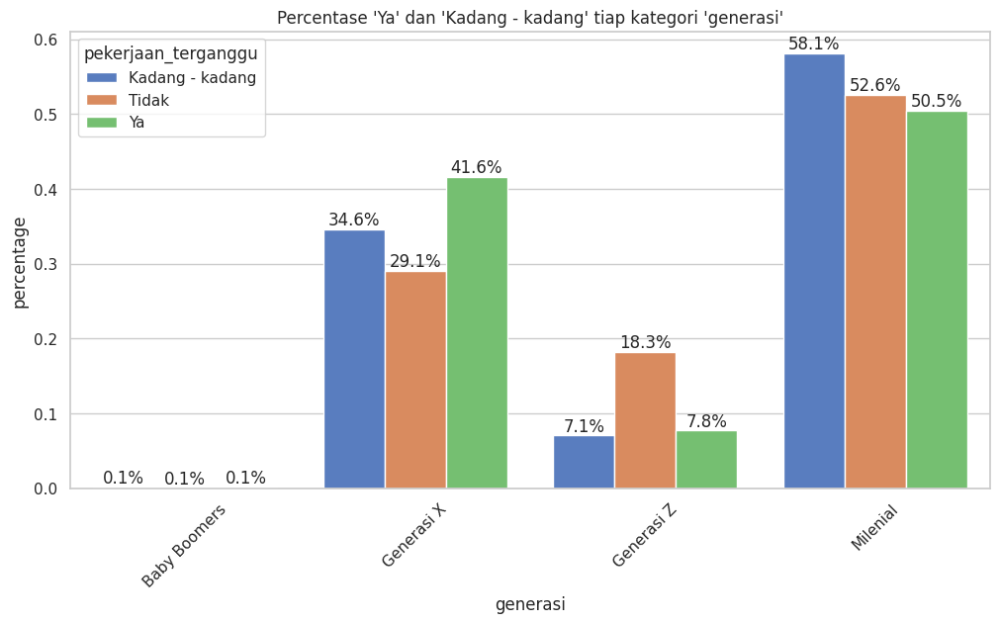

In [ ]:
#generasi dengan sulit untuk pekerjaan terganggu
barplot_prop_percent_hue(x="generasi",
                     hue="pekerjaan_terganggu",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

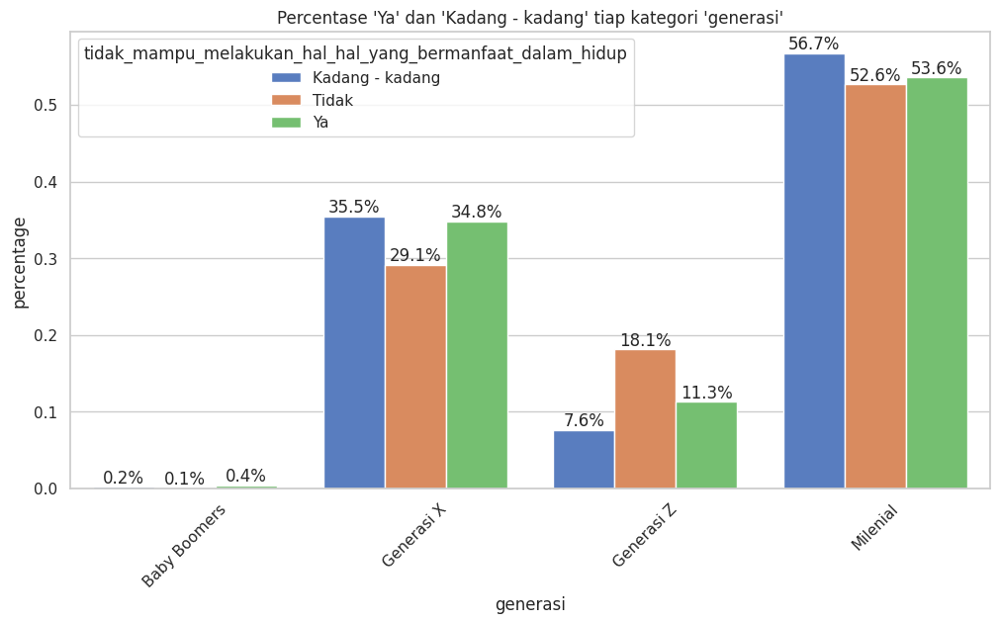

In [ ]:
#generasi dengan tidak mampu melakukan hal hal yang bermanfaat dalam hidup
barplot_prop_percent_hue(x="generasi",
                     hue="tidak_mampu_melakukan_hal_hal_yang_bermanfaat_dalam_hidup",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

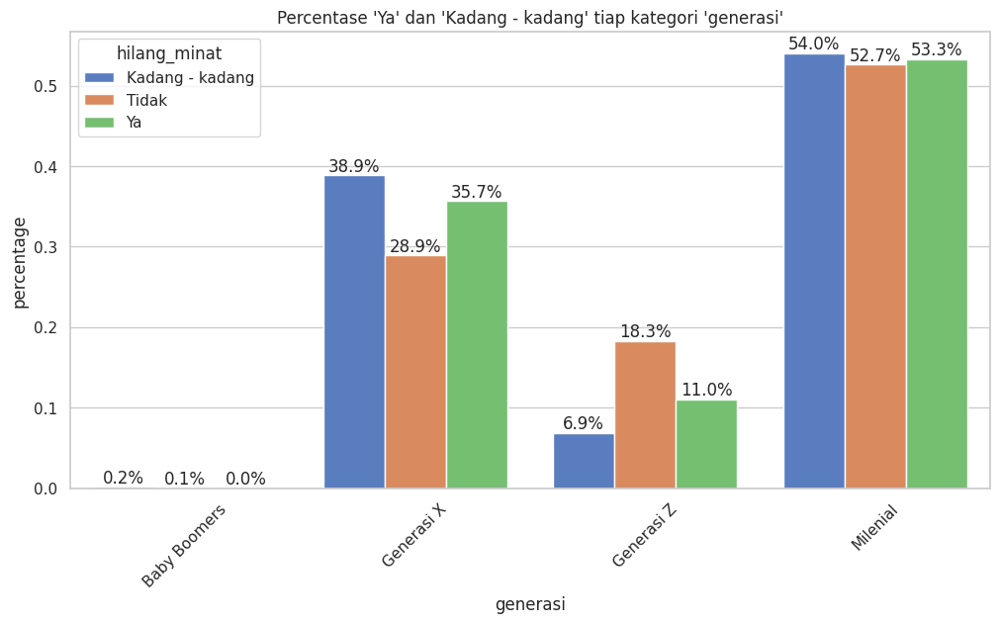

In [ ]:
#generasi dengan hilang minat
barplot_prop_percent_hue(x="generasi",
                     hue="hilang_minat",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

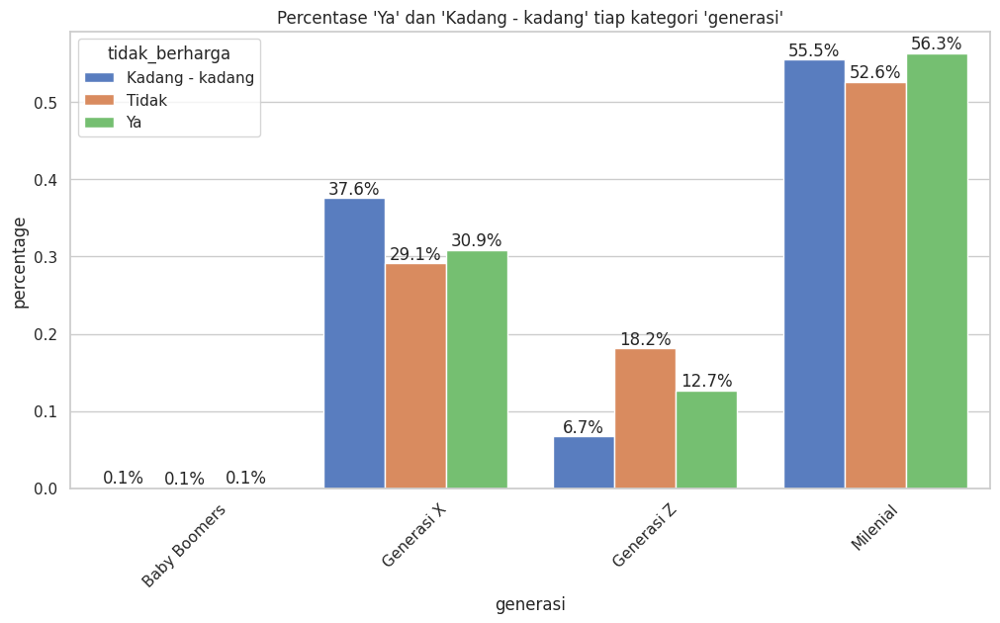

In [ ]:
#generasi dengan tidak berharga
barplot_prop_percent_hue(x="generasi",
                     hue="tidak_berharga",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

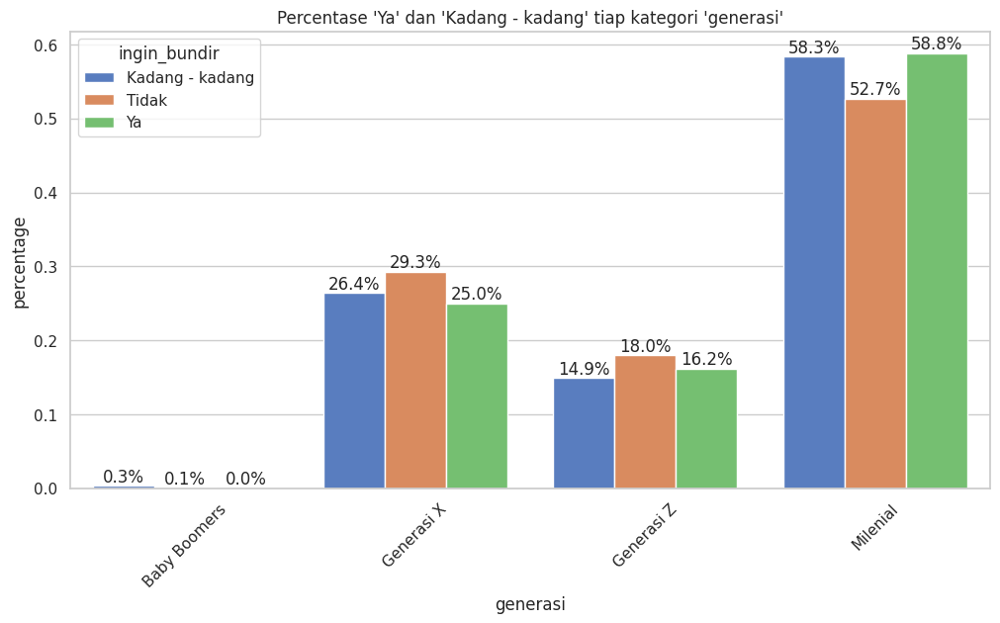

In [ ]:
#generasi dengan ingin bundir
barplot_prop_percent_hue(x="generasi",
                     hue="ingin_bundir",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

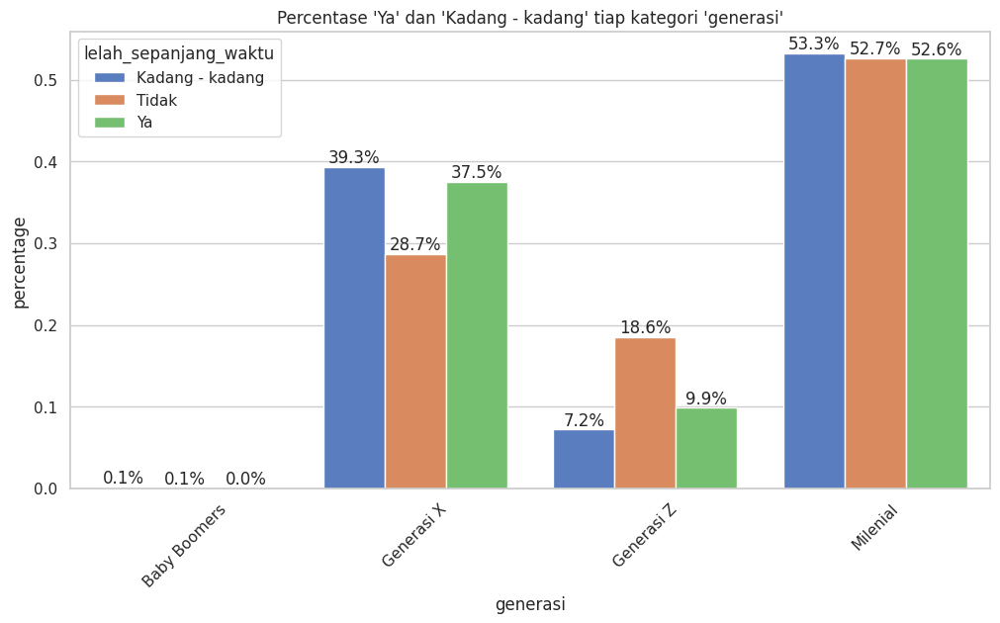

In [ ]:
#generasi dengan lelah sepanjang waktu
barplot_prop_percent_hue(x="generasi",
                     hue="lelah_sepanjang_waktu",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

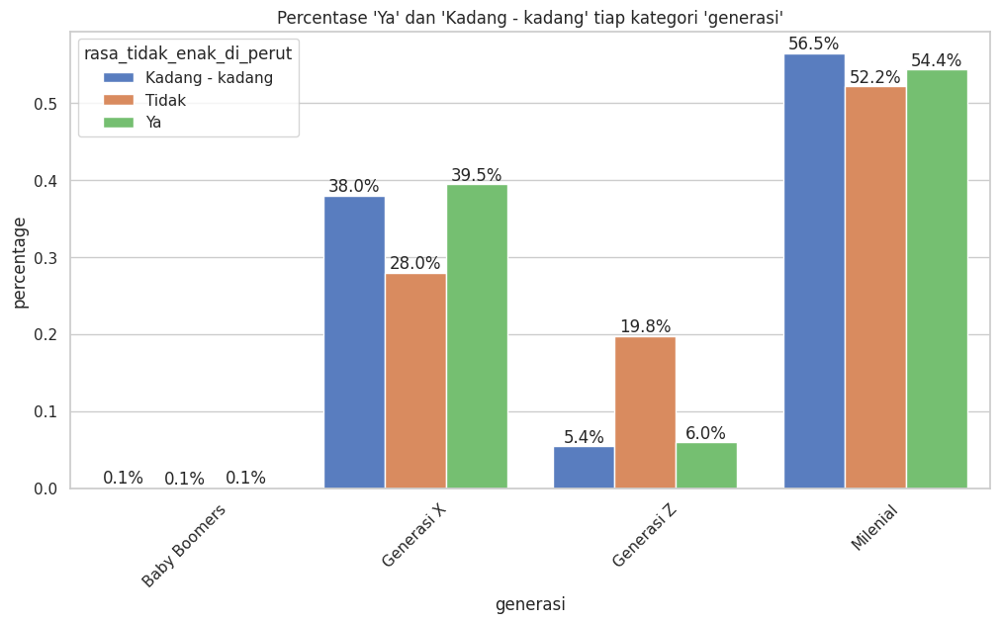

In [ ]:
#generasi dengan rasa tidak enak di perut
barplot_prop_percent_hue(x="generasi",
                     hue="rasa_tidak_enak_di_perut",
                     df=df,
                     size=(12, 6),
                     title="Percentase 'Ya' dan 'Kadang - kadang' tiap kategori 'generasi'",
                     hue_filter=['Ya', 'Kadang - kadang','Tidak'])

## <h2> Apa saja yang mempengaruhi Obesitas? </h2> ##
---
dari kolom bmi_category yang sudah dibuat sebelumnya, dibuat visualisasi yang dikira menarik untuk didapatkan wawasannya.

In [ ]:
df['bmi_category'].value_counts()

Normal weight        133702
Overweight           130023
Obesity Class I       21665
Obesity Class II       1698
Underweight            1102
Obesity Class III       243
Name: bmi_category, dtype: int64

In [ ]:
df_OC1 = df.loc[df.loc[:, 'bmi_category'] == 'Obesity Class I', :]
df_OC2 = df.loc[df.loc[:, 'bmi_category'] == 'Obesity Class II', :]
df_OC3 = df.loc[df.loc[:, 'bmi_category'] == 'Obesity Class III', :]
df_OW = df.loc[df.loc[:, 'bmi_category'] == 'Overweight', :]
df_UW = df.loc[df.loc[:, 'bmi_category'] == 'Underweight', :]

In [ ]:
list_df = [df_OC1, df_OC2, df_OC3, df_OW, df_UW]
list_names = ['Obesity Class I', 'Obesity Class II', 'Obesity Class III', 'Overweight', 'Underweight']

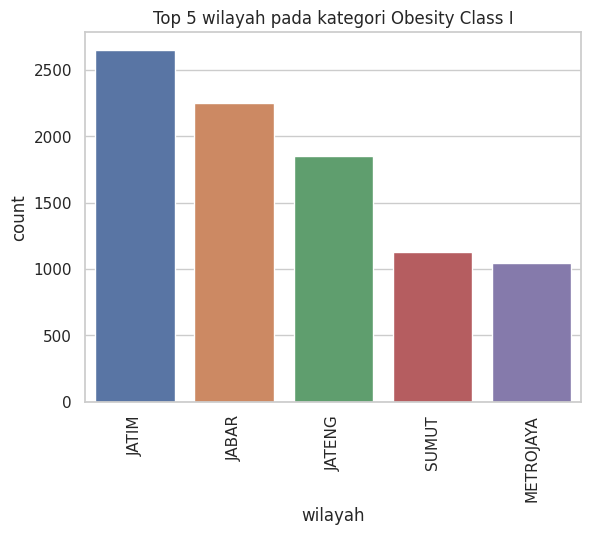

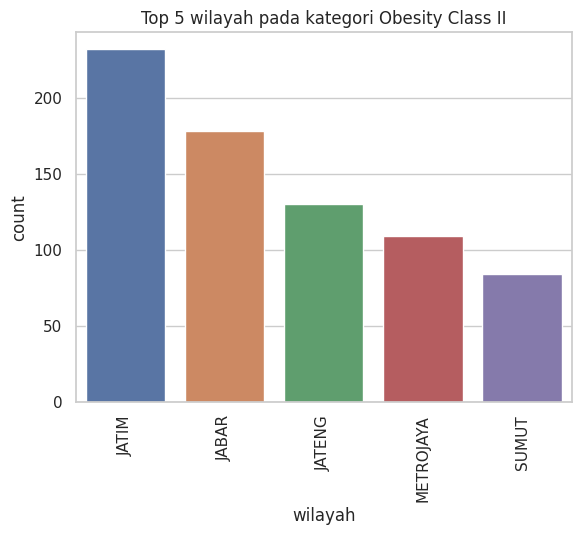

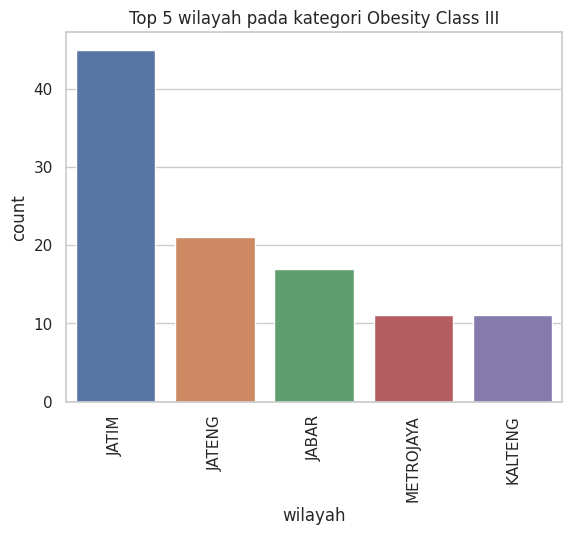

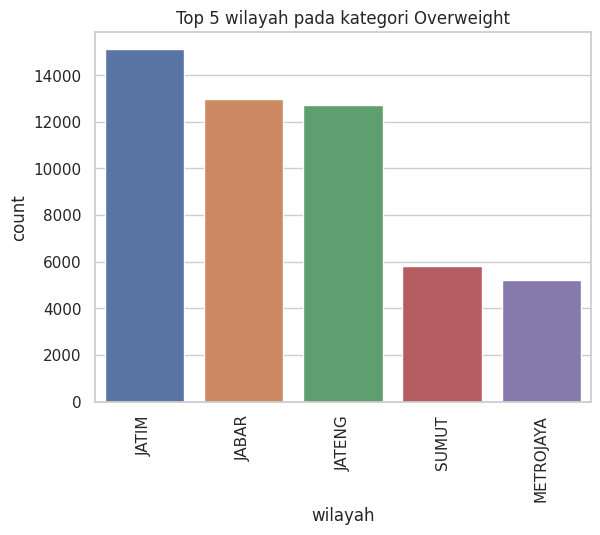

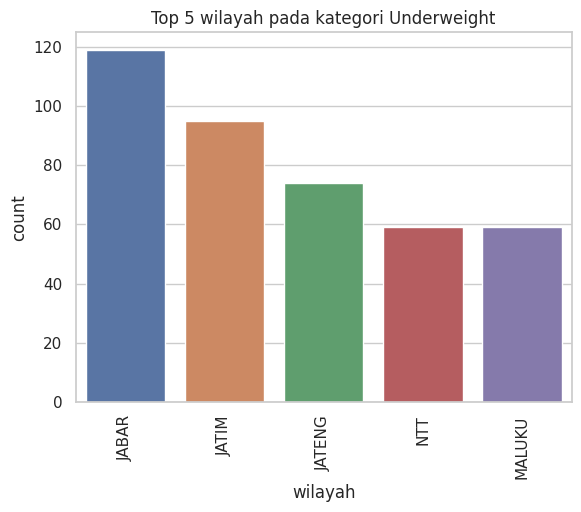

In [ ]:
for i, name in zip(list_df, list_names):

  # Calculate the frequency of each 'wilayah'
  wilayah_counts = i['wilayah'].value_counts()

  # Get the top 5 'wilayah'
  top_5_wilayah = wilayah_counts.nlargest(5).index

  # Filter the DataFrame to include only the top 5 'wilayah'
  df_top_5_wilayah = i[i['wilayah'].isin(top_5_wilayah)]

  # Plot the countplot
  sns.countplot(x='wilayah', data=df_top_5_wilayah, order=top_5_wilayah)
  plt.title(f"Top 5 wilayah pada kategori {name}")
  plt.xticks(rotation=90)
  plt.show()
  print("")



In [ ]:
df.columns.tolist

<bound method IndexOpsMixin.tolist of Index(['wilayah', 'jenis_kelamin', 'usia', 'lama_berdinas', 'pendidikan',
       'tinggi', 'berat', 'lingkar_pinggang', 'status_kawin', 'pengeluaran',
       'penyakit_jantung', 'penyakit_stroke', 'penyakit_diabetes_melitus',
       'penyakit_hipertensi', 'penyakit_kanker', 'penyakit_ginjal',
       'penyakit_tumor', 'penyakit_osteoartritis', 'penyakit_lambung',
       'penyakit_liver', 'penyakit_tbc', 'penyakit_dbd', 'penyakit_covid19',
       'penyakit_hiv_aids', 'penyakit_diare', 'penyakit_malaria',
       'penyakit_gonore_sipilis', 'penyakit_thypus', 'penyakit_dermatitis',
       'penyakit_mikosis', 'sakit_kepala', 'tidak_nafsu_makan', 'sulit_tidur',
       'mudah_takut', 'tegang,_cemas_atau_kuatir', 'tangan_anda_gemetar',
       'masalah_pencernaan', 'sulit_untuk_berpikir_jernih', 'tidak_bahagia',
       'menangis_lebih_sering', 'sulit_untuk_menikmati_kegiatan_sehari_hari',
       'sulit_untuk_mengambil_keputusan', 'pekerjaan_terganggu',
     

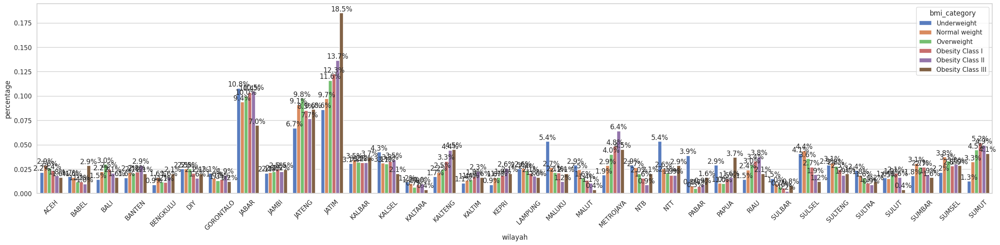

In [ ]:
barplot_prop_percent_hue(x="wilayah",
                     hue="bmi_category",
                     df=df,
                     size=(30, 6),
                     title="")

### <h2> Kebiasaan hidupkah? </h2>

In [ ]:
habit = ['olahraga/minggu', 'minum_air', 'buah_sayur', 'mandi', 'durasi_mandi', 'konsumsi_gula_harian',
        'konsumsi_alkohol_harian', 'konsumsi_junk_food_harian', 'frekuensi_menggosok_gigi_per_hari',
        'durasi_menggosok_gigi', 'frekuensi_ganti_pakaian_dalam_per_hari',
        'cuci_tangan_sebelum_makan']

for i in habit:
  print(df[i].value_counts())
  print("")

Kurang dari 4 kali dalam seminggu    171689
4 kali atau lebih dalam seminggu     105799
Tidak pernah                          11166
Name: olahraga/minggu, dtype: int64

Lebih dari 2 liter     177567
2 Liter                 83112
Kurang dari 2 Liter     27975
Name: minum_air, dtype: int64

400gr/lebih          146260
Kurang dari 400gr    139673
Tidak pernah           2721
Name: buah_sayur, dtype: int64

2 Kali          212765
> 2 Kali         72747
1 Kali            2859
Tidak pernah       283
Name: mandi, dtype: int64

2 - 5 menit            162116
> 5 menit              120447
Kurang dari 2 menit      6091
Name: durasi_mandi, dtype: int64

Kurang dari 6 sendok teh    246177
Tidak pernah                 31397
Lebih dari 6 sendok teh      11080
Name: konsumsi_gula_harian, dtype: int64

Tidak pernah        275295
Kurang dari 25ml     12450
lebih dari 25ml        909
Name: konsumsi_alkohol_harian, dtype: int64

1 - 2 kali/hari        187041
Tidak pernah            93335
Di atas 2 kali/har

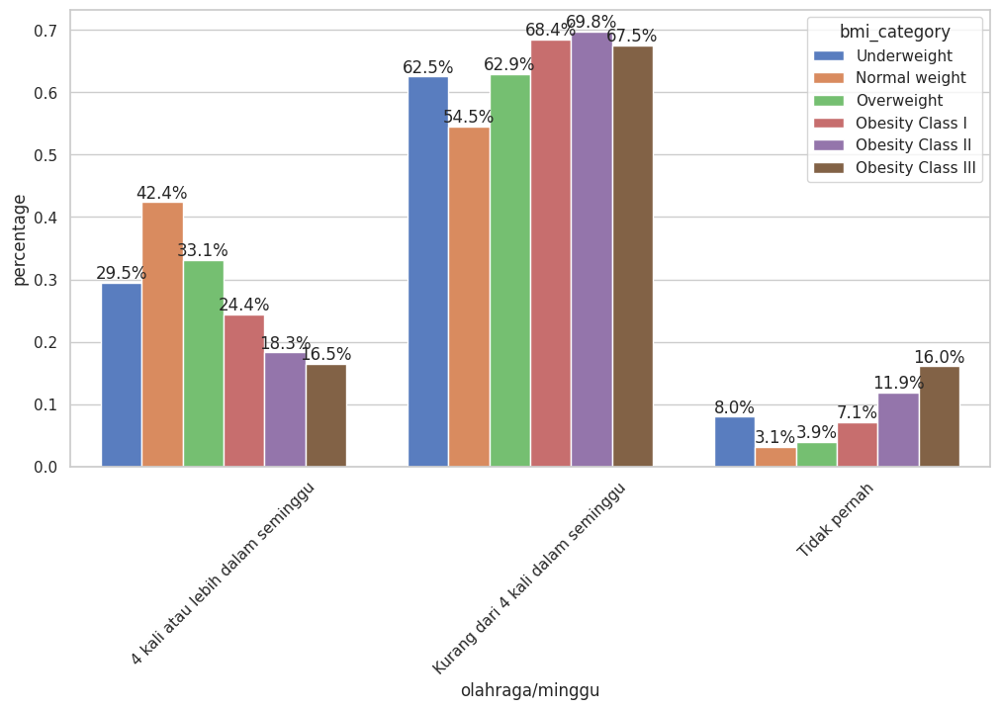

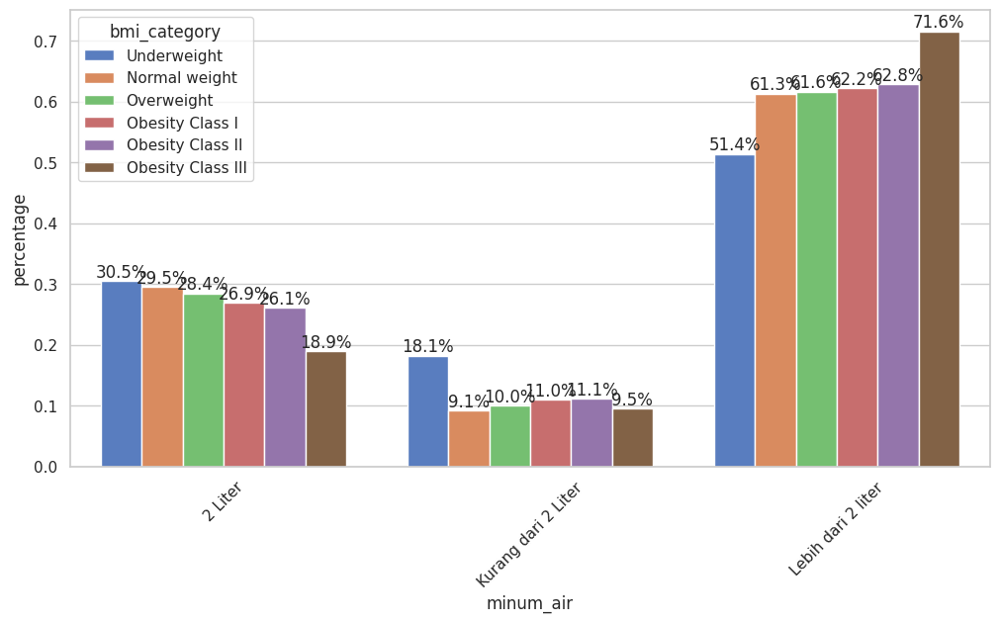

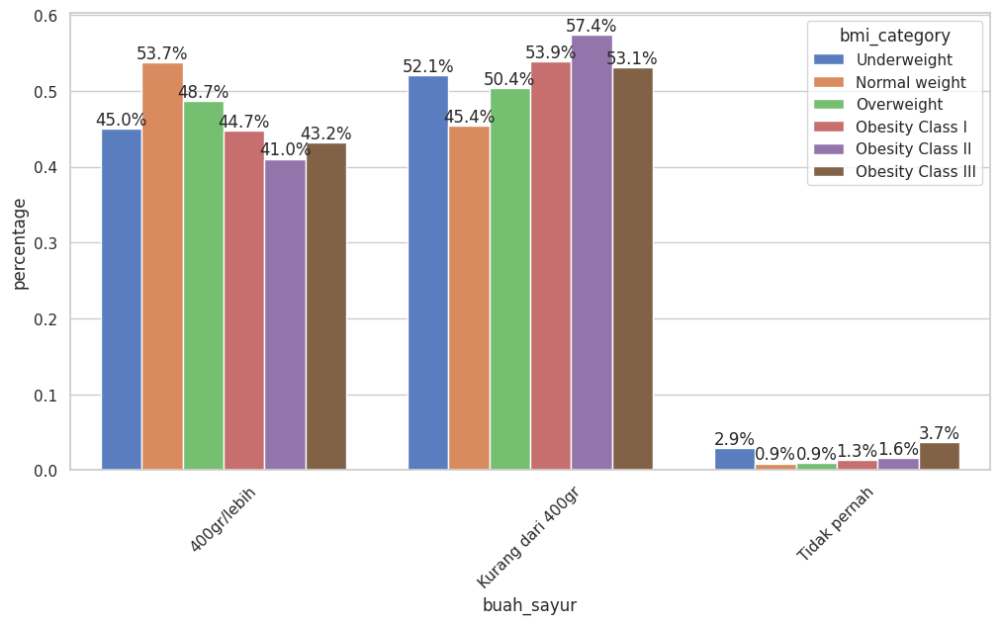

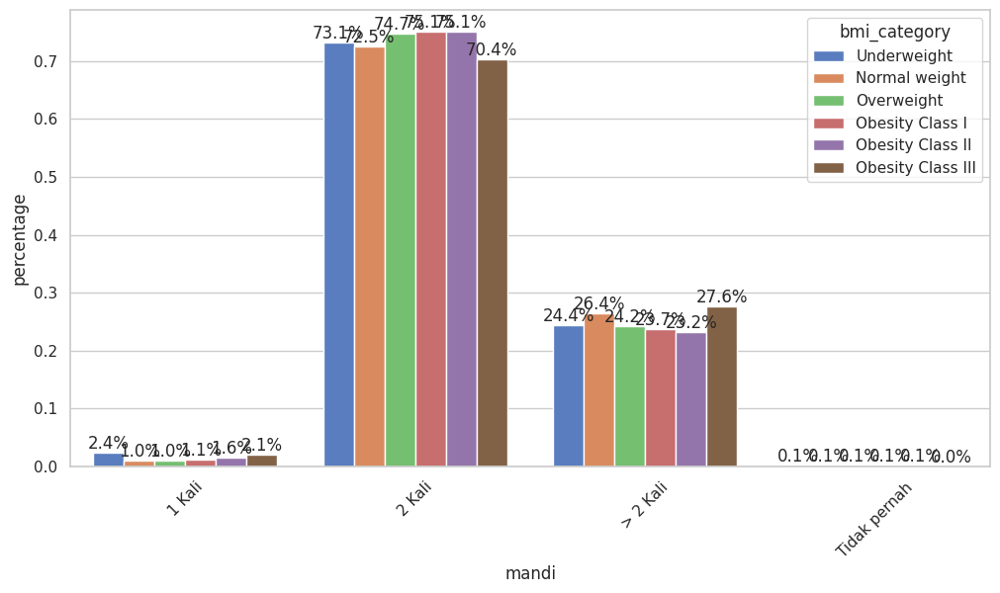

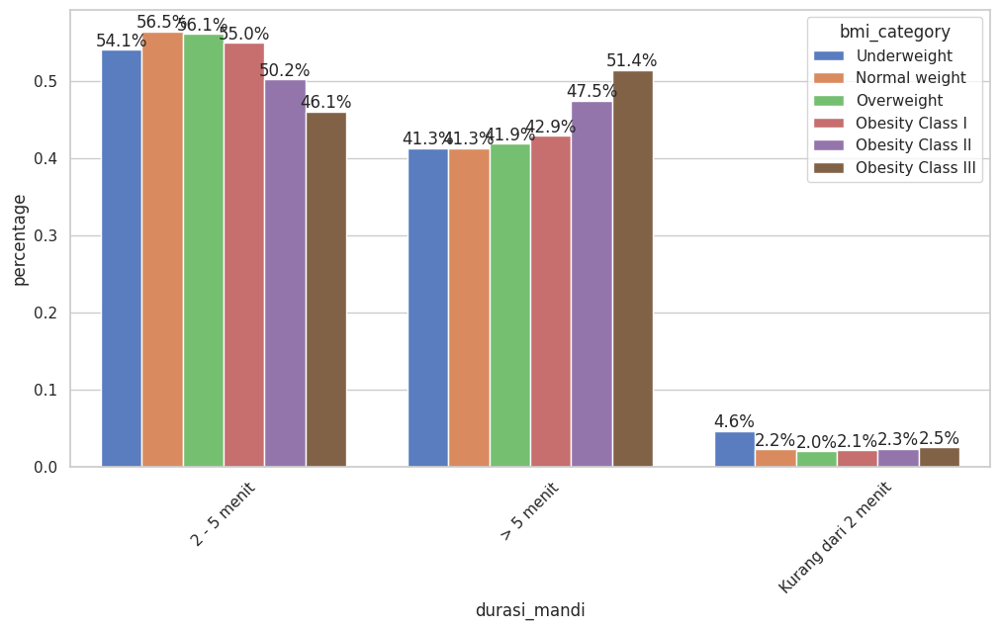

...

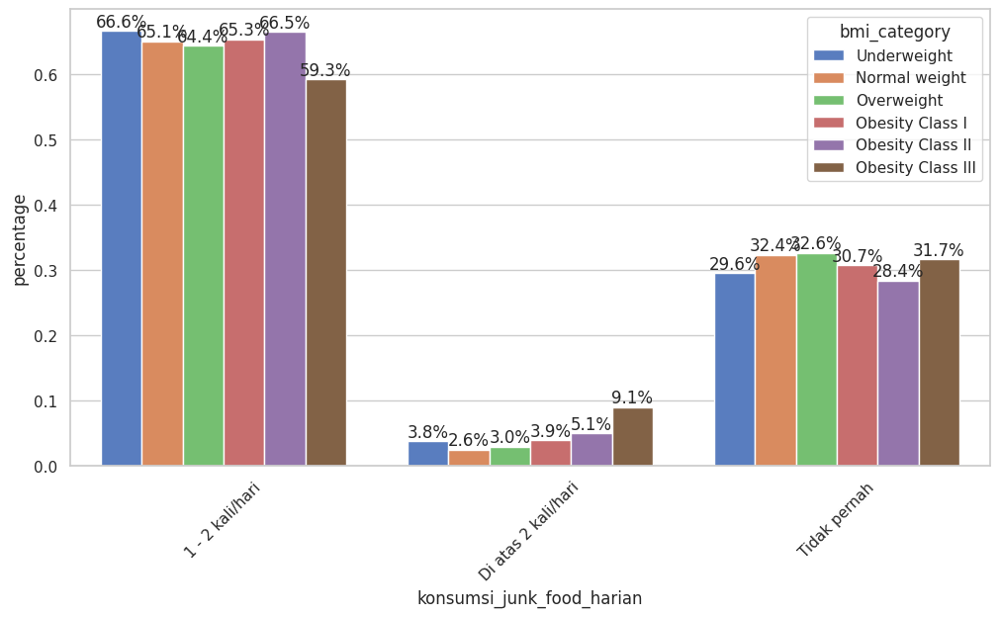

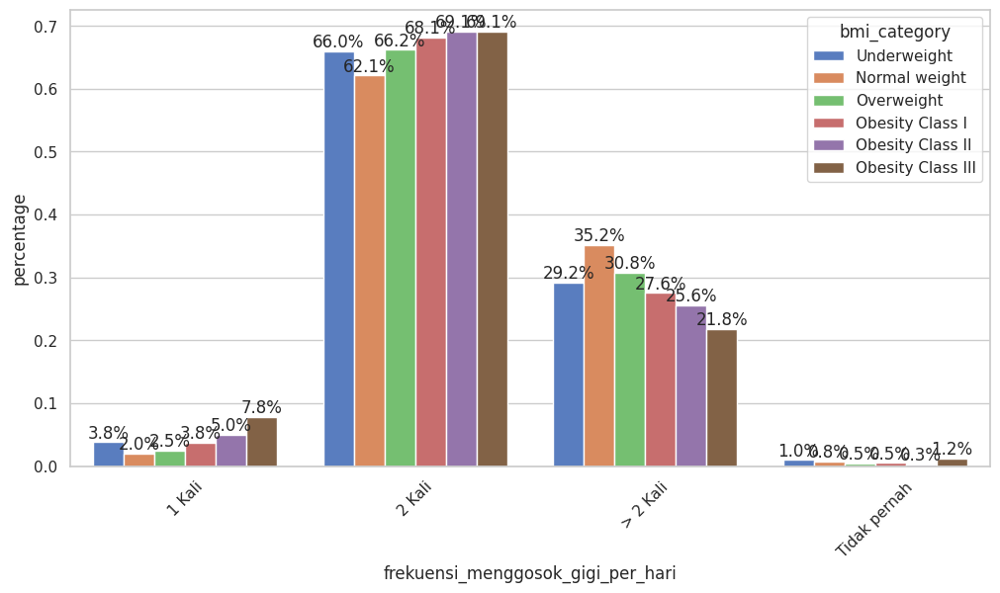

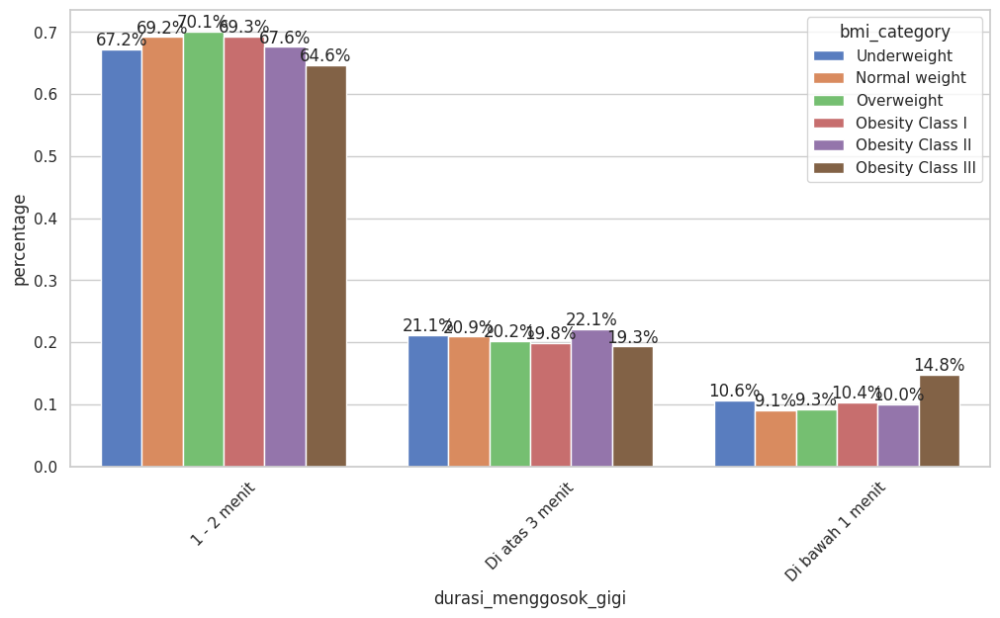

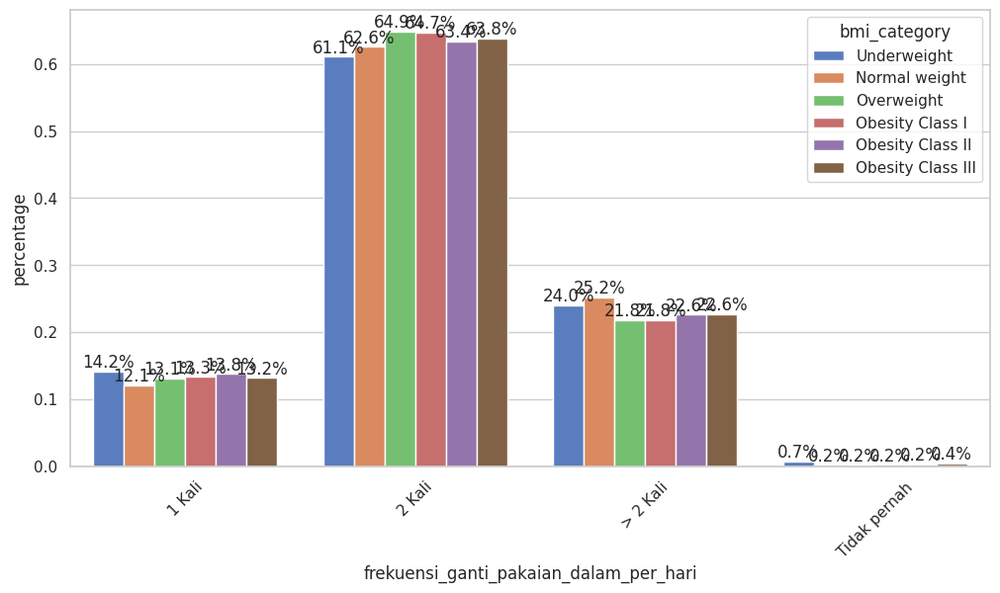

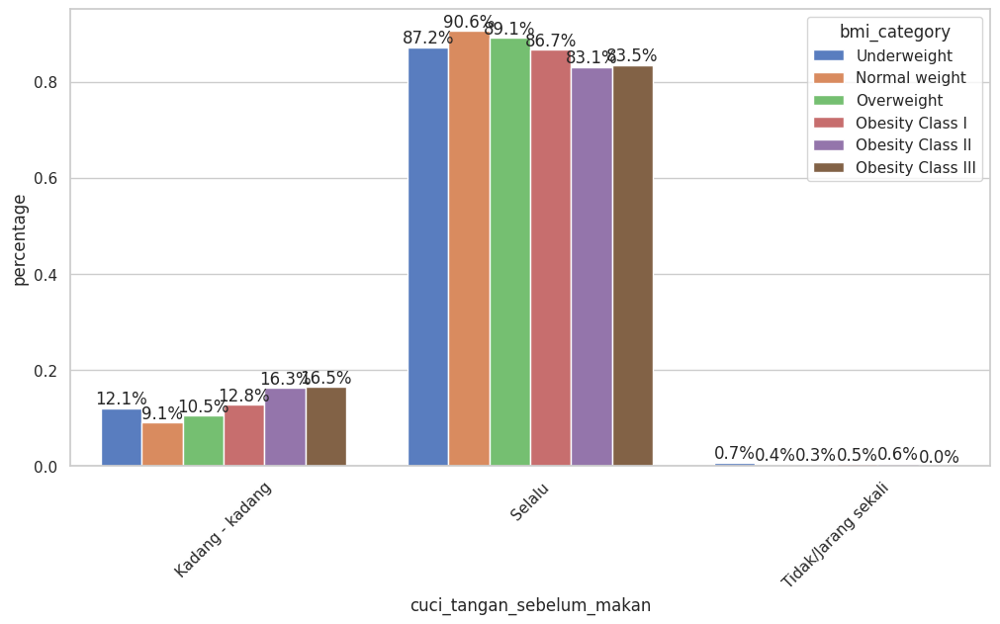

In [ ]:
for i in habit:
  barplot_prop_percent_hue(x=i,
                     hue="bmi_category",
                     df=df,
                     size=(12, 6),
                     title="")
  print("")

<Figure size 1200x600 with 0 Axes>

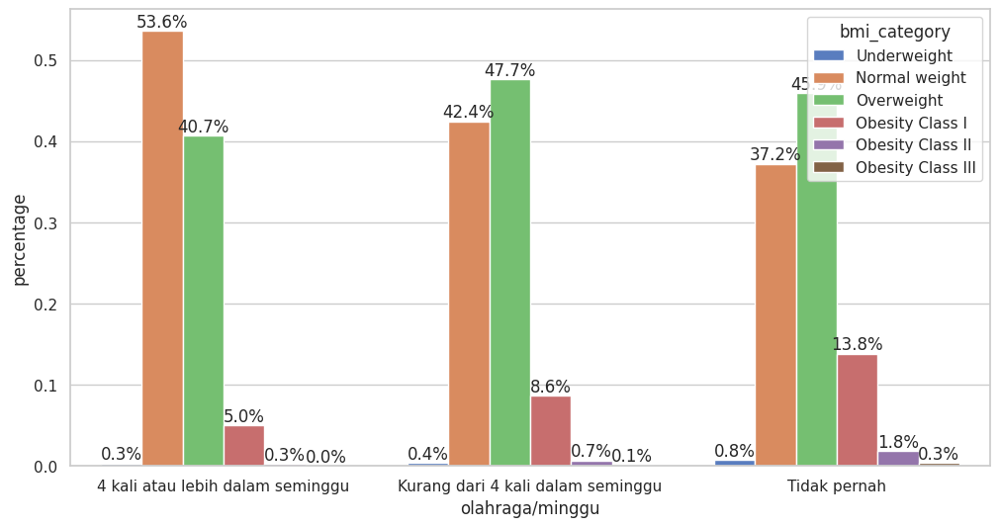

<Figure size 1200x600 with 0 Axes>

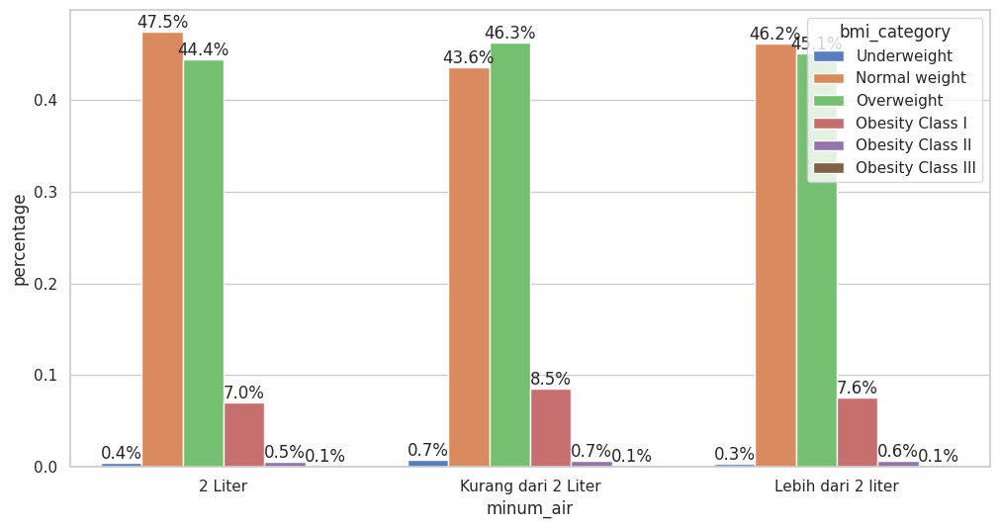

<Figure size 1200x600 with 0 Axes>

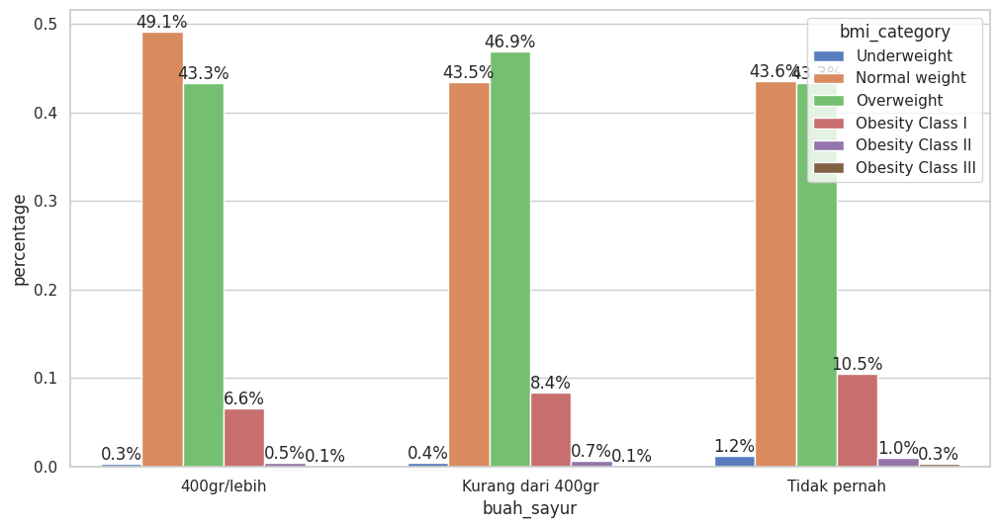

<Figure size 1200x600 with 0 Axes>

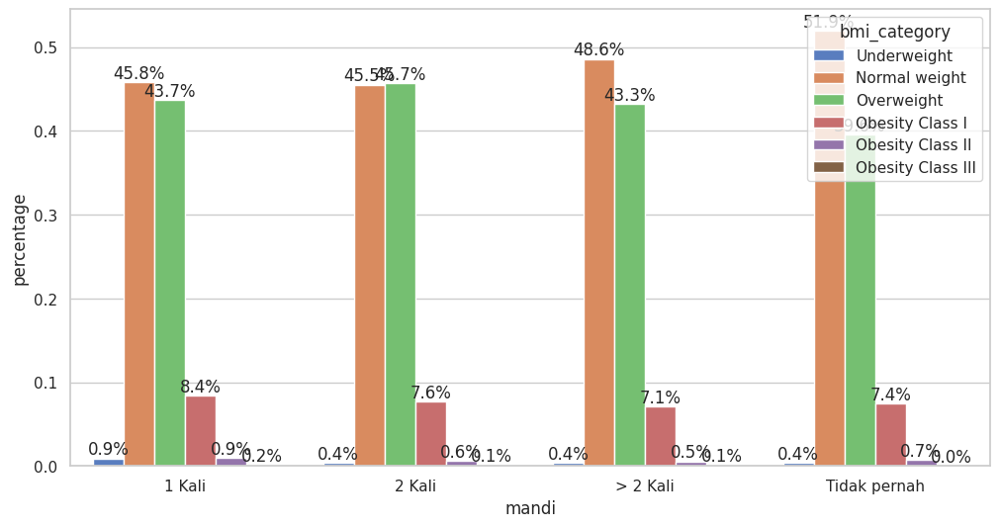

<Figure size 1200x600 with 0 Axes>

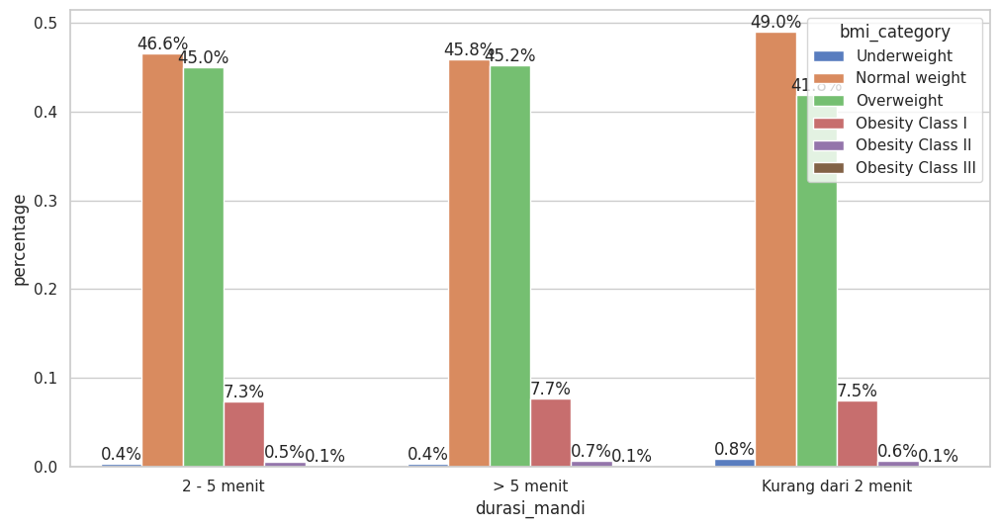

<Figure size 1200x600 with 0 Axes>

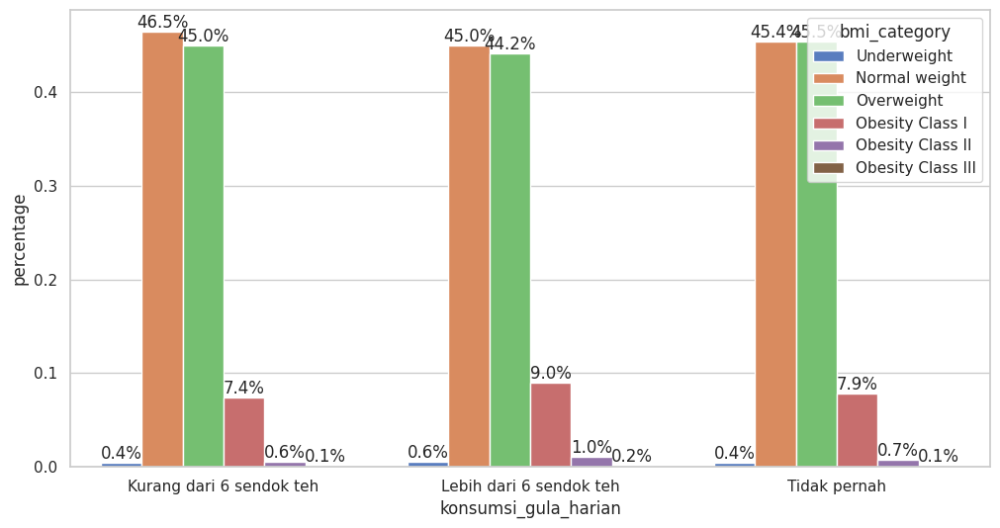

<Figure size 1200x600 with 0 Axes>

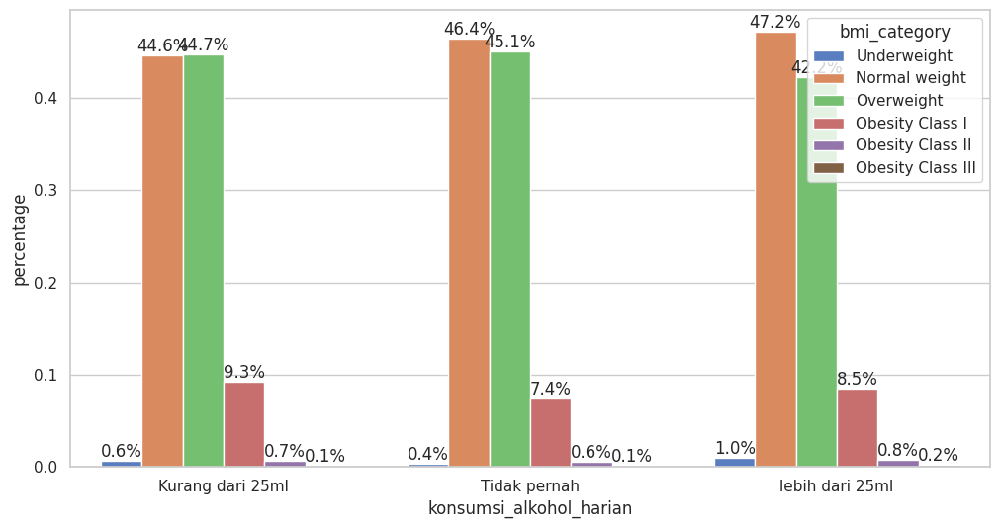

<Figure size 1200x600 with 0 Axes>

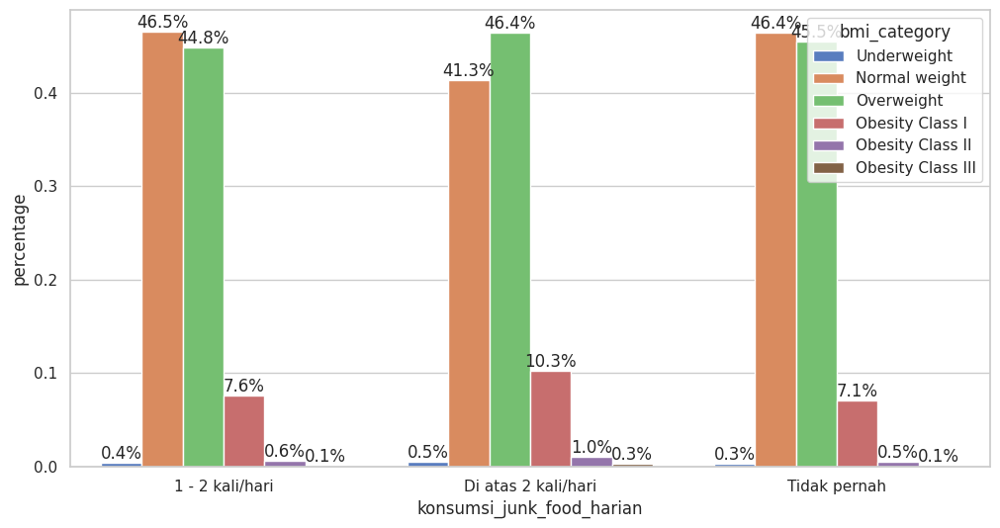

<Figure size 1200x600 with 0 Axes>

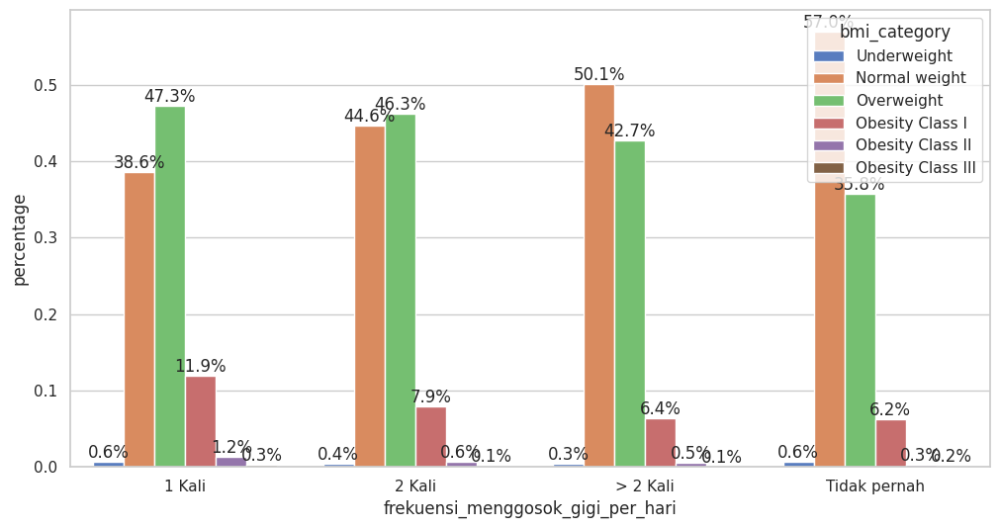

<Figure size 1200x600 with 0 Axes>

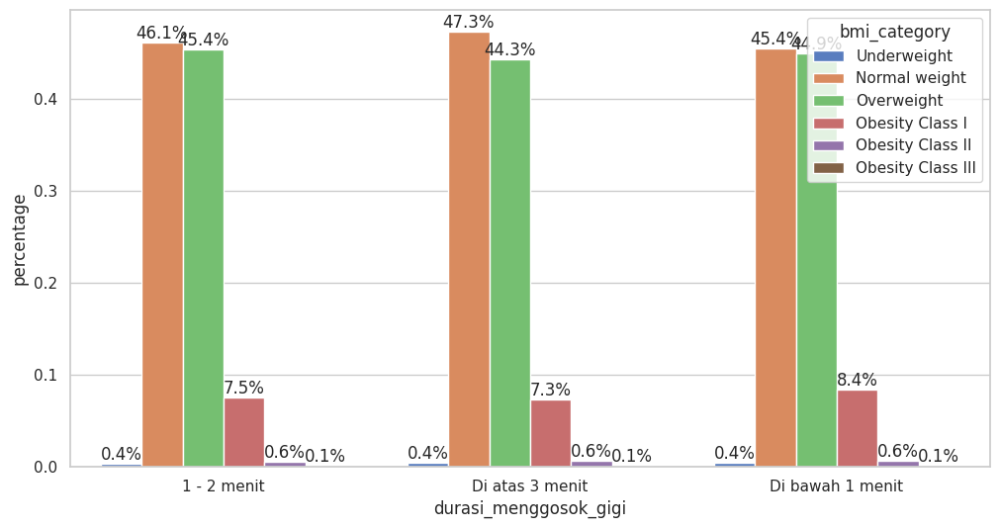

<Figure size 1200x600 with 0 Axes>

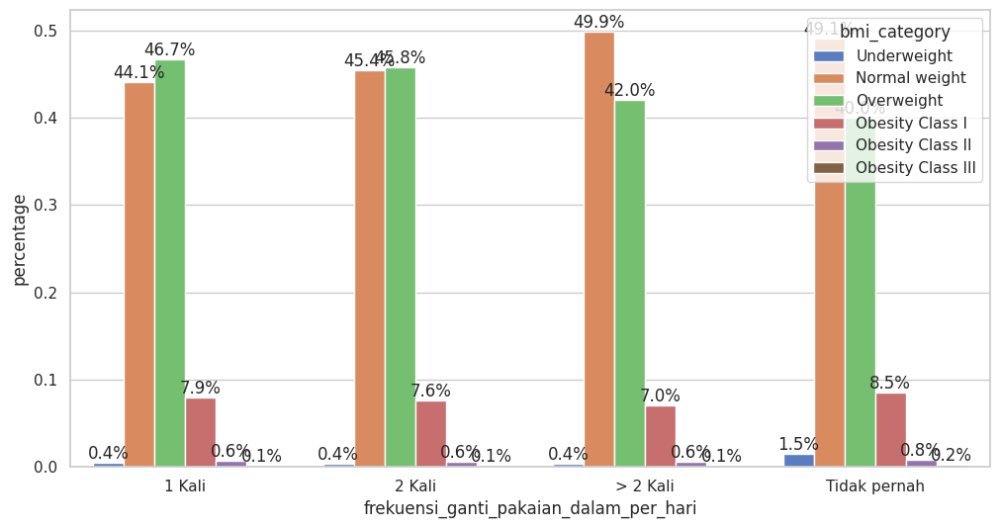

<Figure size 1200x600 with 0 Axes>

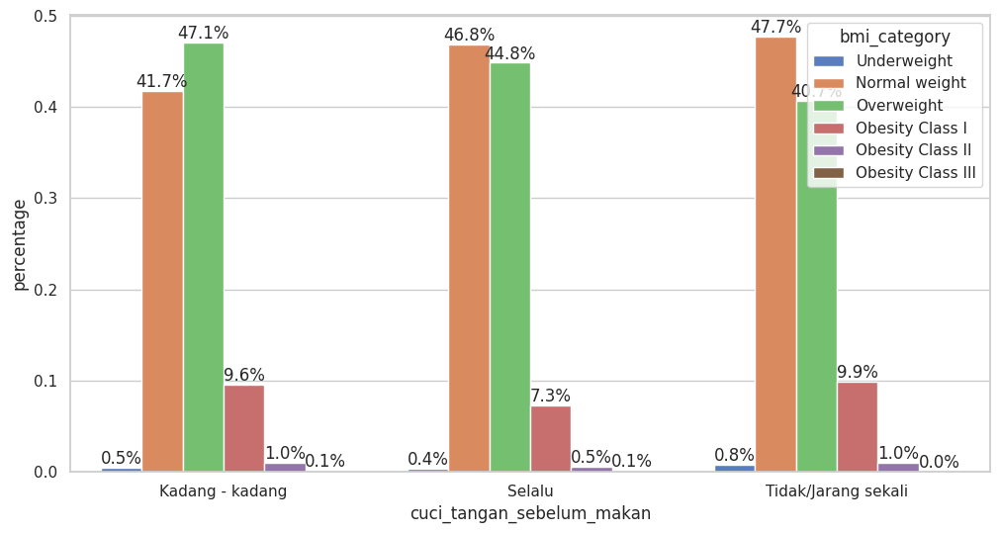

In [ ]:
for i in habit:
  barplot_prop_percent(x=i,
                     hue="bmi_category",
                     df=df,
                     size=(12, 6),
                     title="")
  print("")

### <h2> Penyakit yang dideritakah? </h2> ###

In [ ]:
disease = ['pendidikan', 'status_kawin', 'pengeluaran',
       'penyakit_jantung', 'penyakit_stroke', 'penyakit_diabetes_melitus',
       'penyakit_hipertensi', 'penyakit_kanker', 'penyakit_ginjal',
       'penyakit_tumor', 'penyakit_osteoartritis', 'penyakit_lambung',
       'penyakit_liver', 'penyakit_tbc', 'penyakit_dbd', 'penyakit_covid19',
       'penyakit_hiv_aids', 'penyakit_diare', 'penyakit_malaria',
       'penyakit_gonore_sipilis', 'penyakit_thypus', 'penyakit_dermatitis',
       'penyakit_mikosis', 'sakit_kepala']

for i in disease:
  print(df[i].value_counts())
  print("")

SMA    193105
S1      80161
S2       9858
D3       3842
SMP      1474
S3        214
Name: pendidikan, dtype: int64

Menikah          232505
Belum Menikah     49722
Janda/Duda         6427
Name: status_kawin, dtype: int64

Rp. 2 Juta s.d. 6 Juta      249321
Rp. 7 Juta s.d. 10 Juta      36076
Rp. 11 Juta s.d. 14 Juta      2475
Di atas Rp. 15 Juta            782
Name: pengeluaran, dtype: int64

Tidak    284617
Ya         4037
Name: penyakit_jantung, dtype: int64

Tidak    287207
Ya         1447
Name: penyakit_stroke, dtype: int64

Tidak    282447
Ya         6207
Name: penyakit_diabetes_melitus, dtype: int64

Tidak    273809
Ya        14845
Name: penyakit_hipertensi, dtype: int64

Tidak    288266
Ya          388
Name: penyakit_kanker, dtype: int64

Tidak    286603
Ya         2051
Name: penyakit_ginjal, dtype: int64

Tidak    287901
Ya          753
Name: penyakit_tumor, dtype: int64

Tidak    287649
Ya         1005
Name: penyakit_osteoartritis, dtype: int64

Tidak    257541
Ya        31113


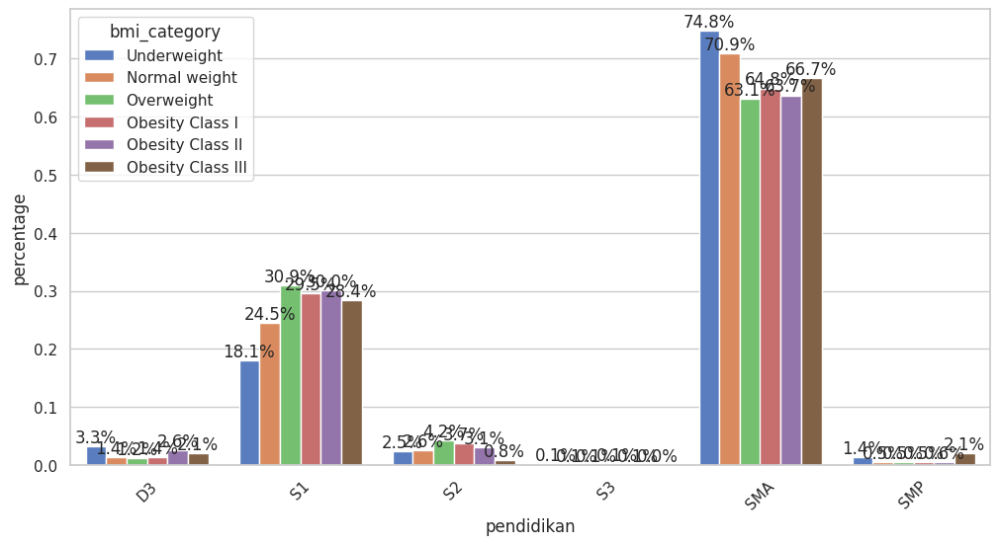

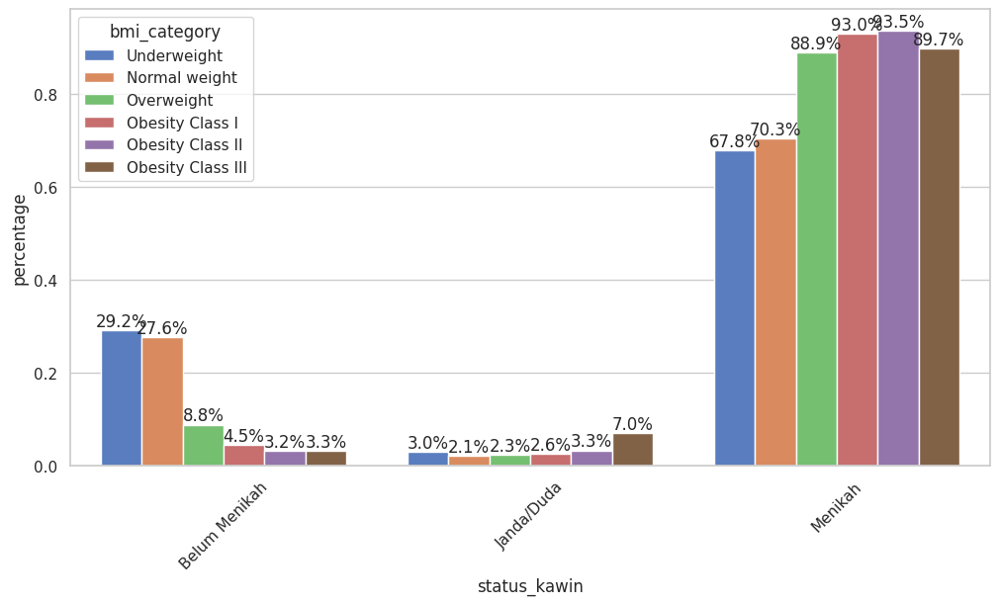

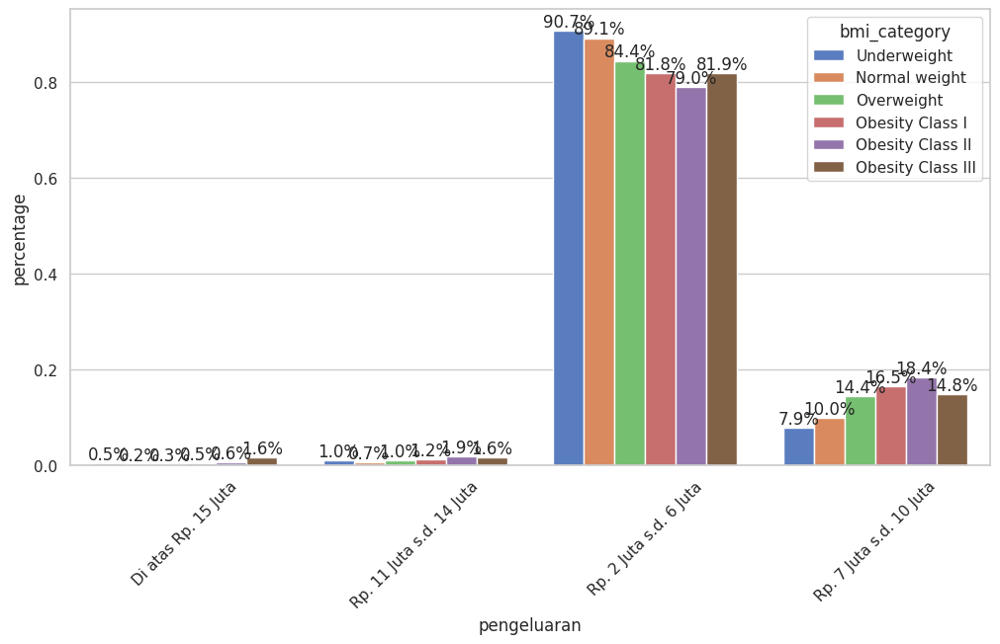

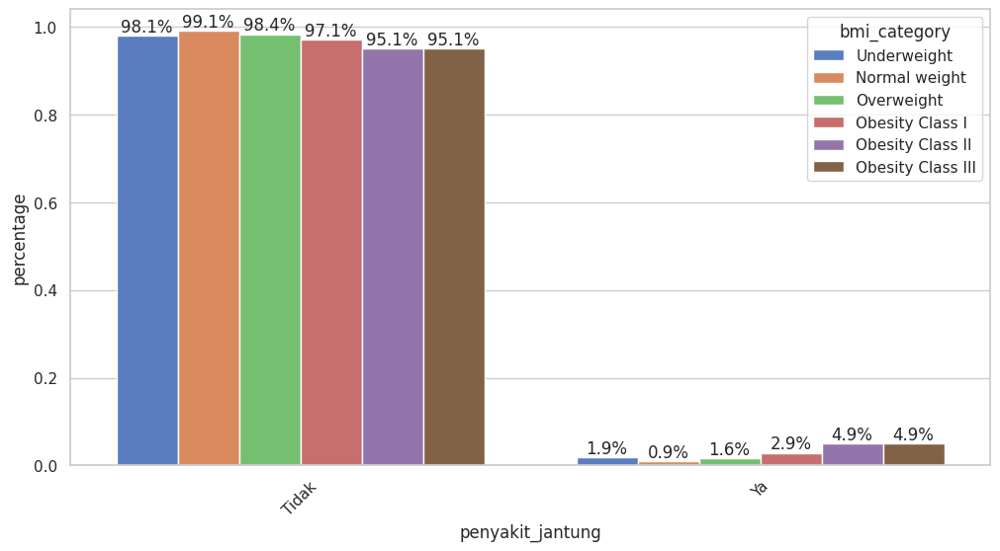

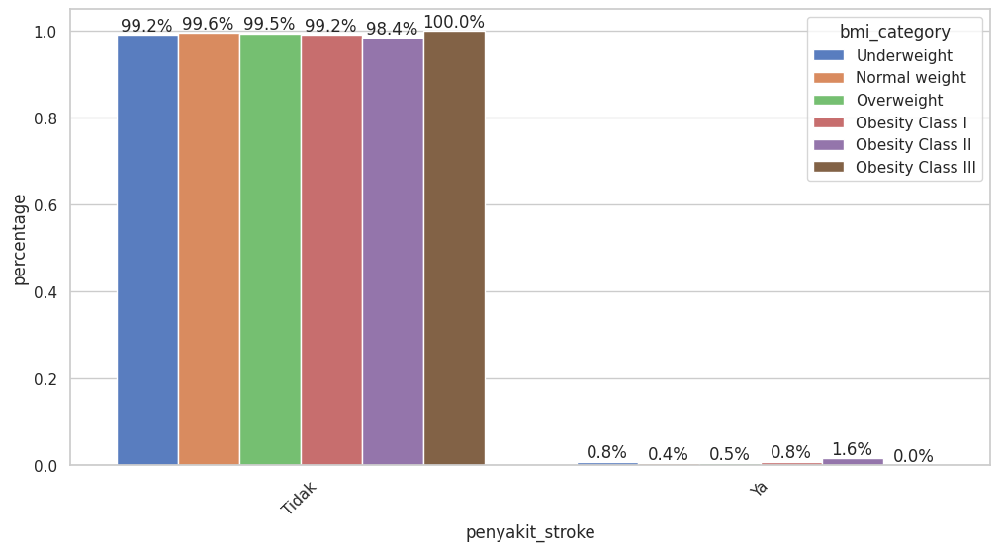

...

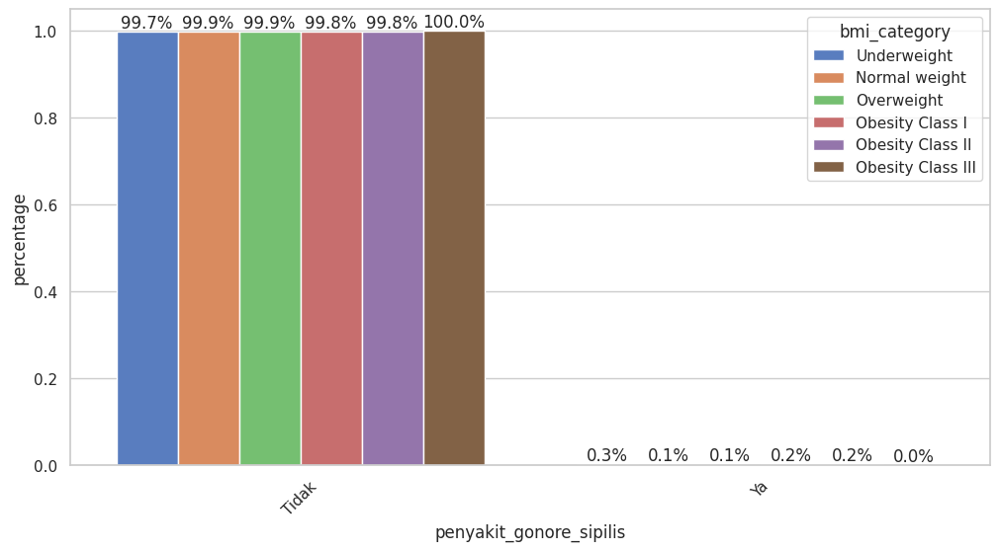

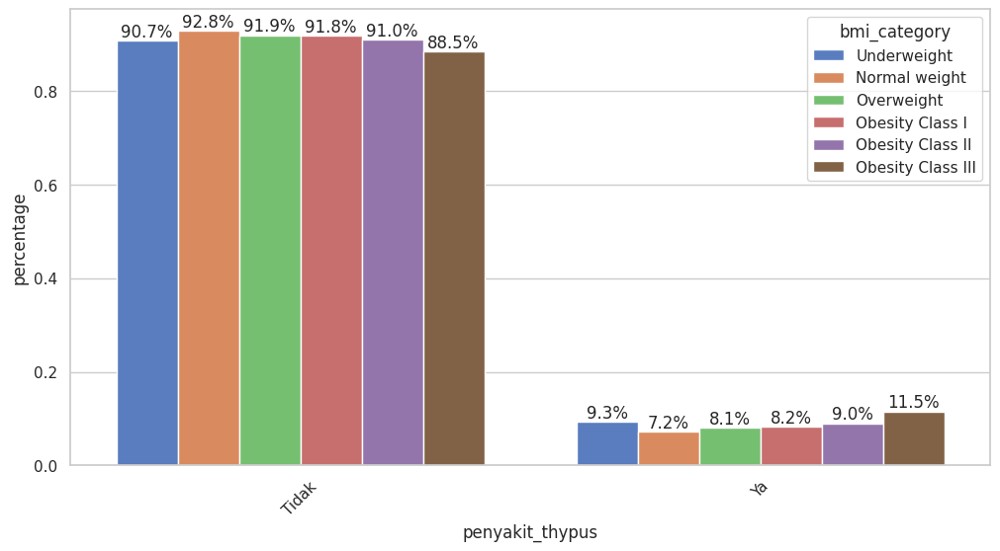

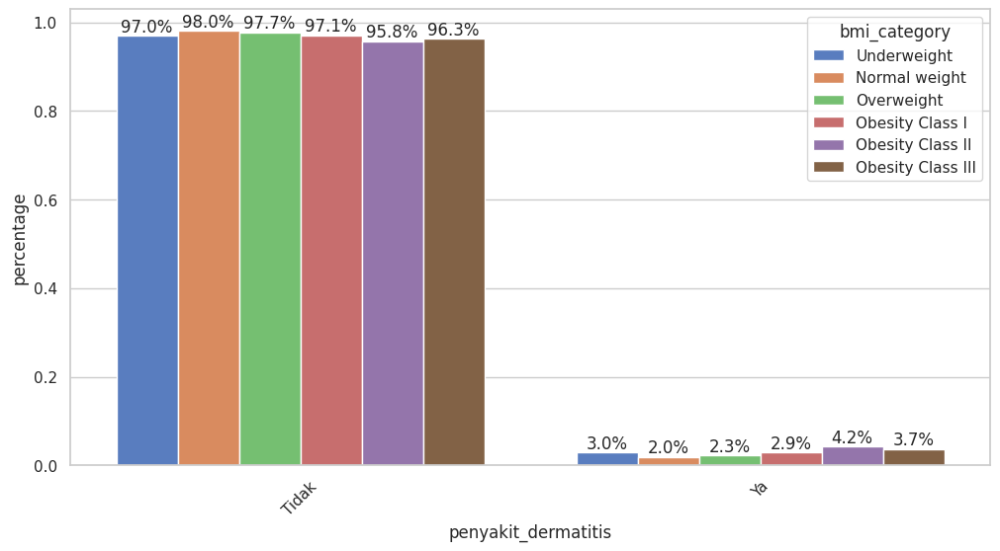

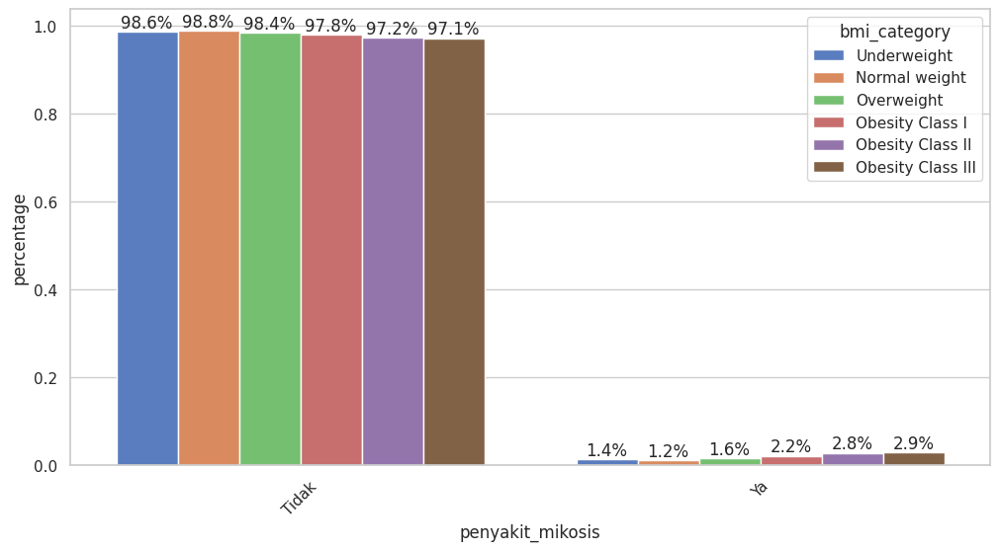

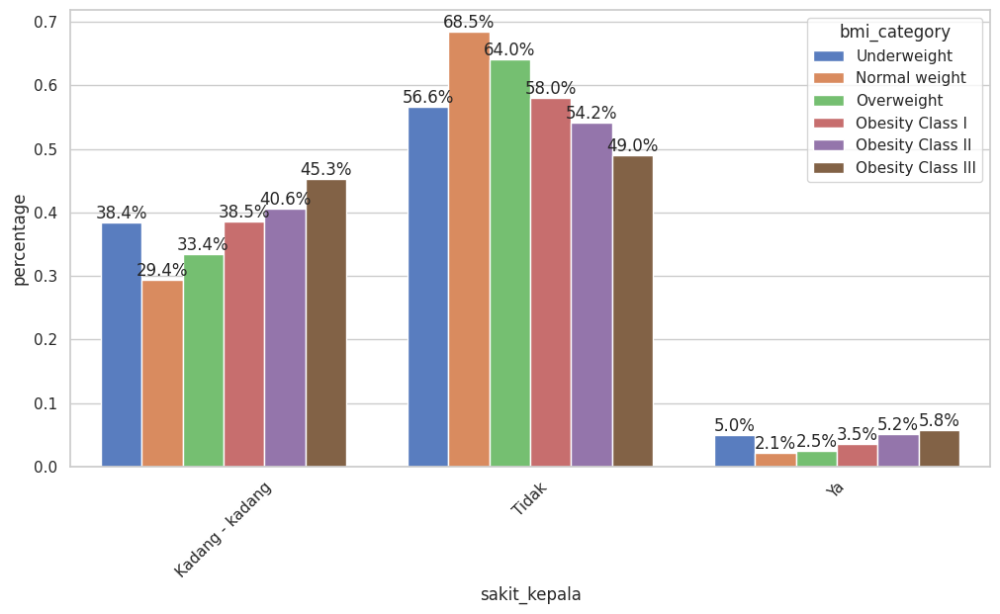

In [ ]:
for i in disease:
  barplot_prop_percent_hue(x=i,
                     hue="bmi_category",
                     df=df,
                     size=(12, 6),
                     title="")
  print("")

<Figure size 1200x600 with 0 Axes>

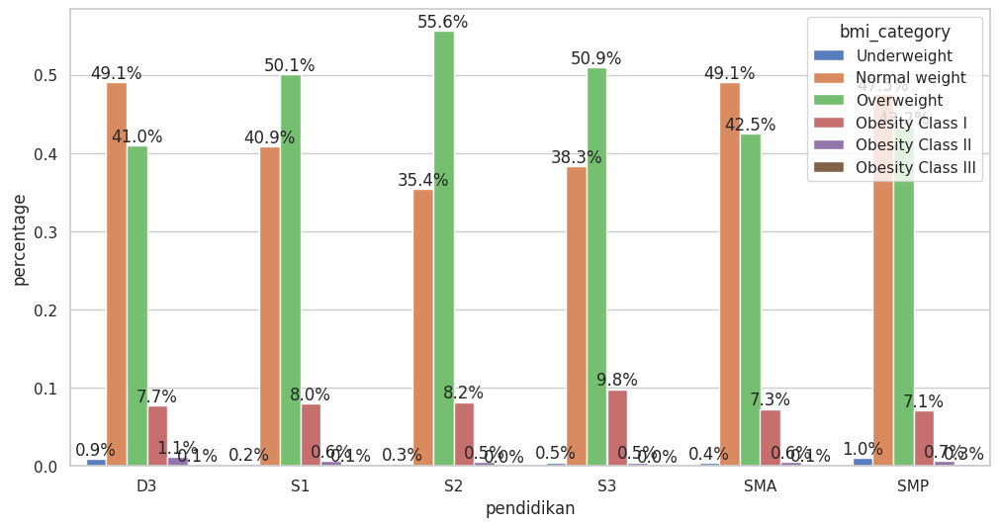

<Figure size 1200x600 with 0 Axes>

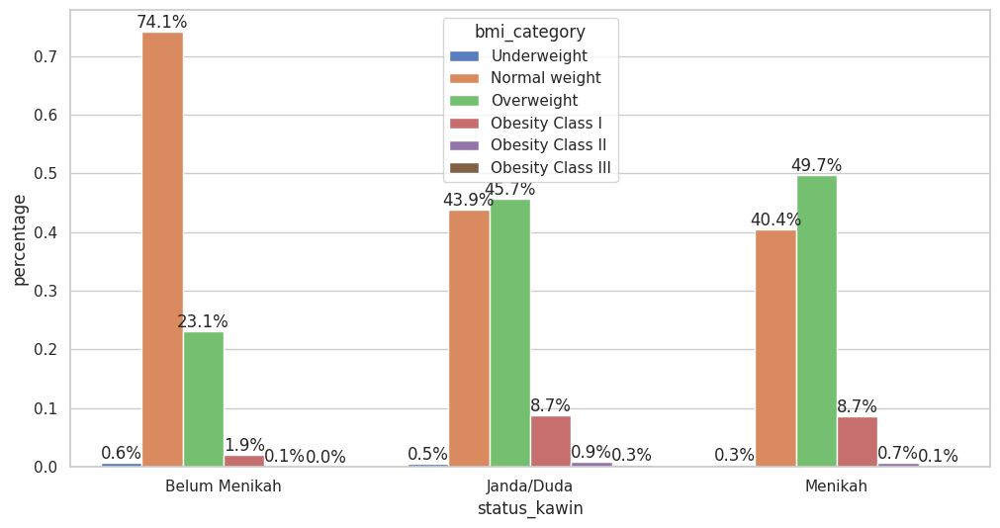

<Figure size 1200x600 with 0 Axes>

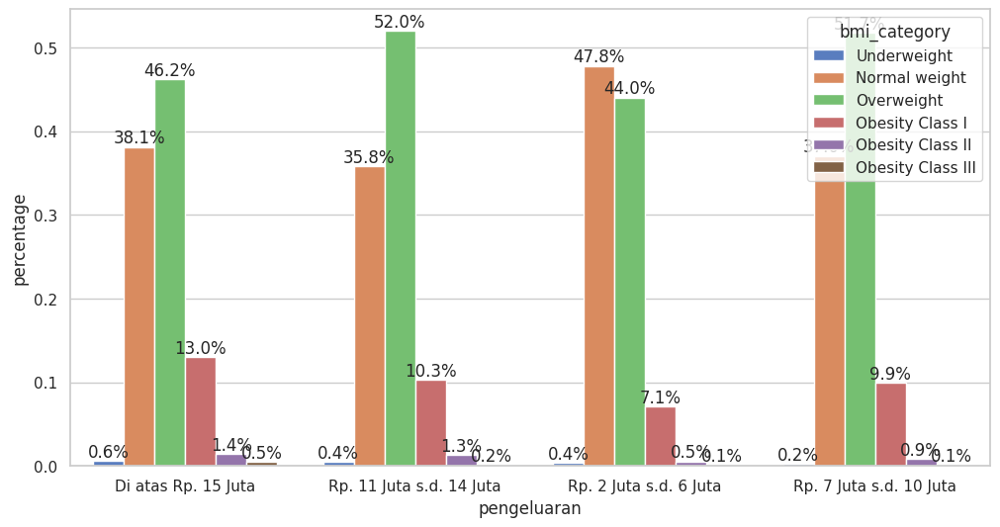

<Figure size 1200x600 with 0 Axes>

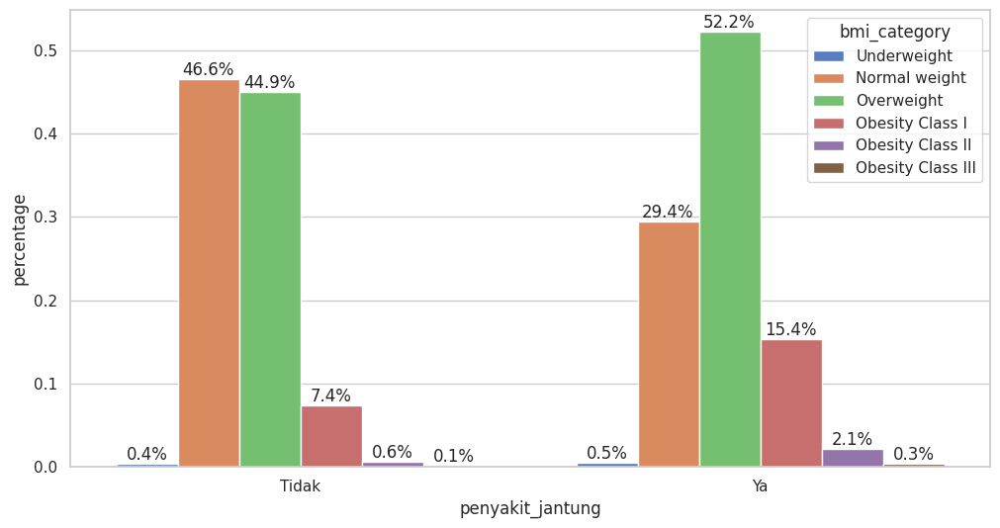

<Figure size 1200x600 with 0 Axes>

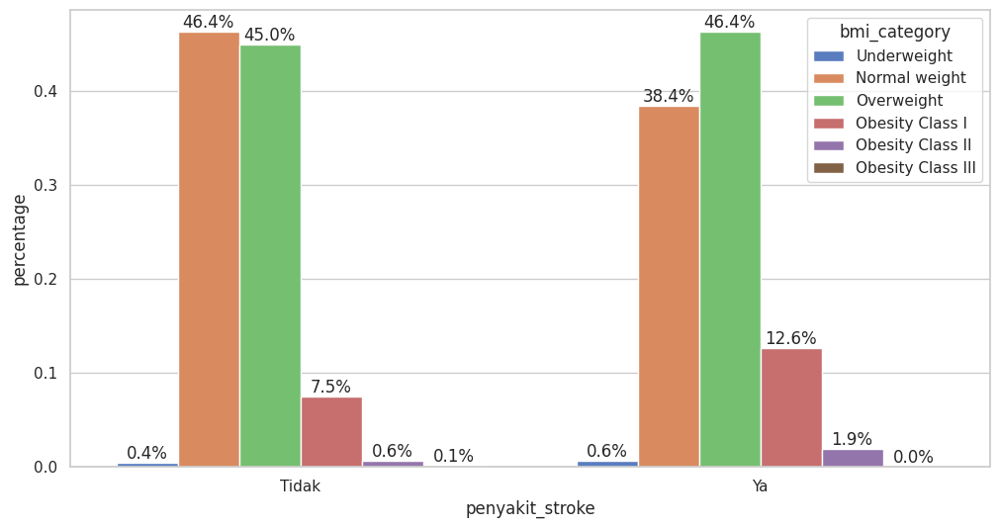

<Figure size 1200x600 with 0 Axes>

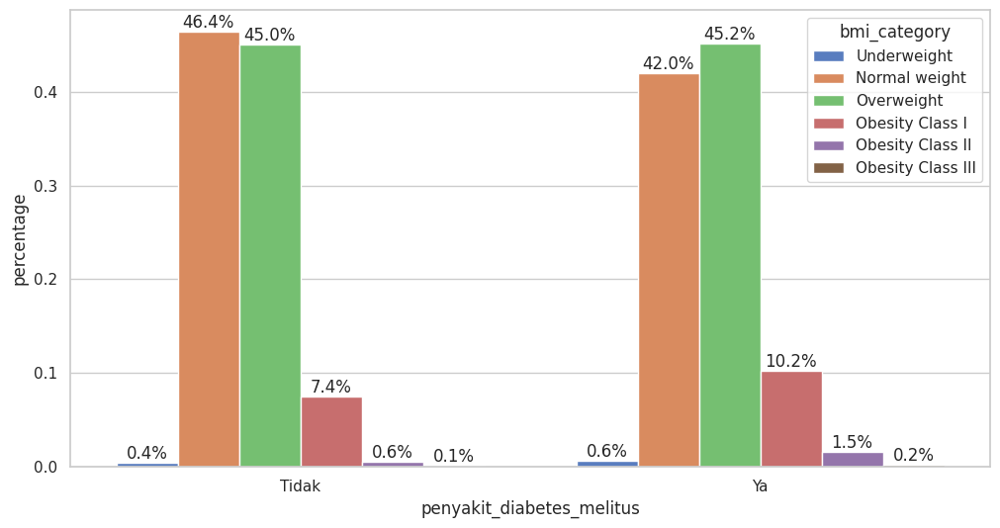

<Figure size 1200x600 with 0 Axes>

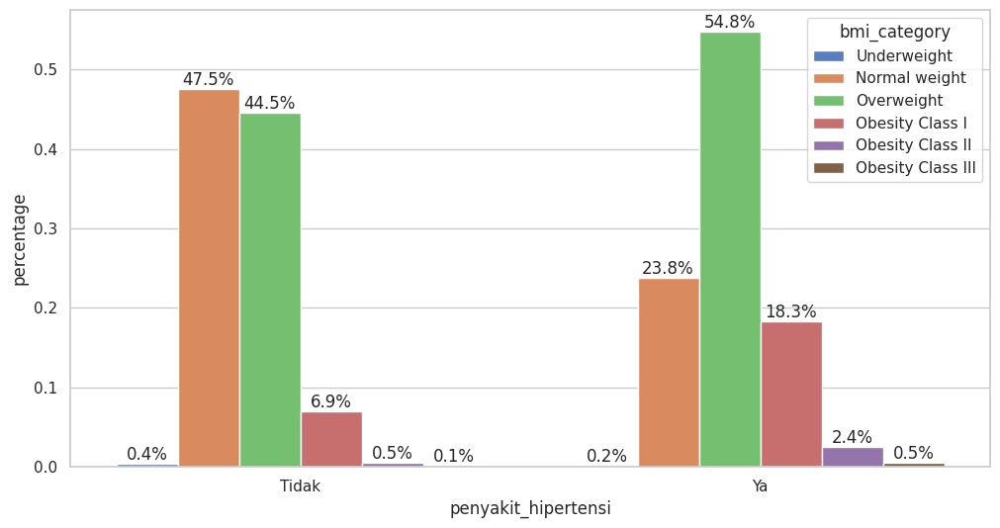

<Figure size 1200x600 with 0 Axes>

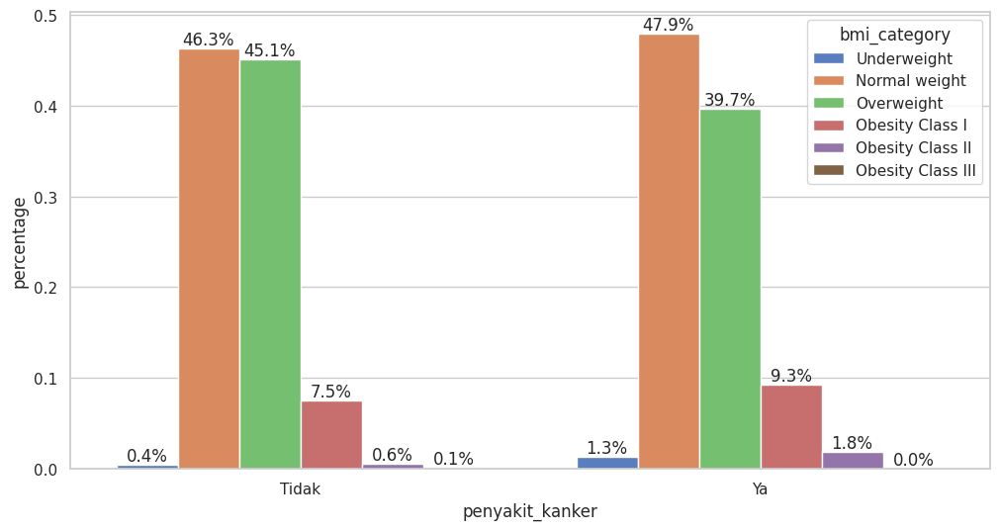

<Figure size 1200x600 with 0 Axes>

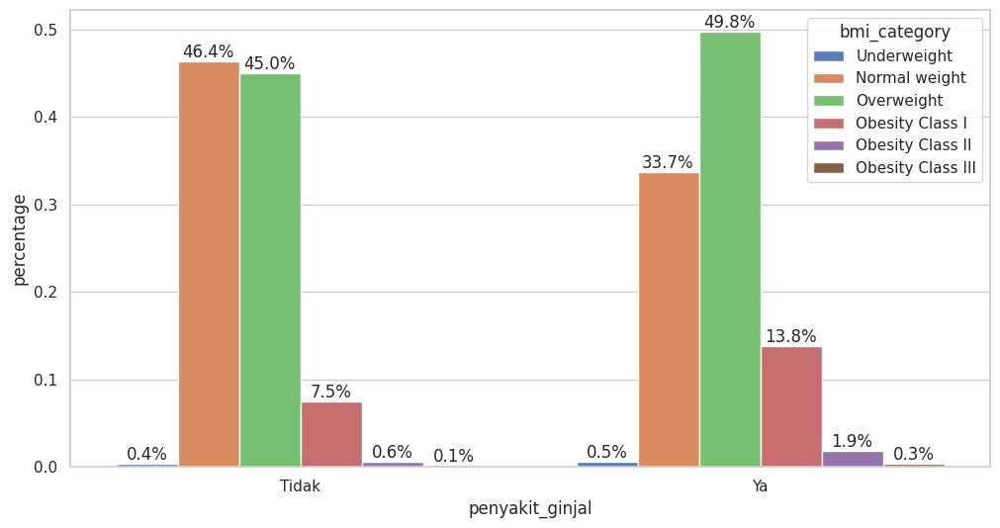

<Figure size 1200x600 with 0 Axes>

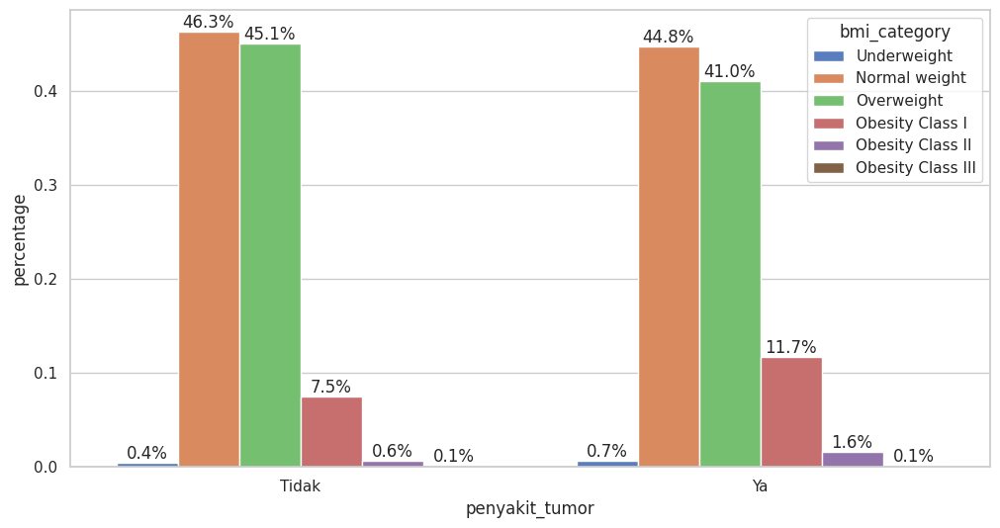

<Figure size 1200x600 with 0 Axes>

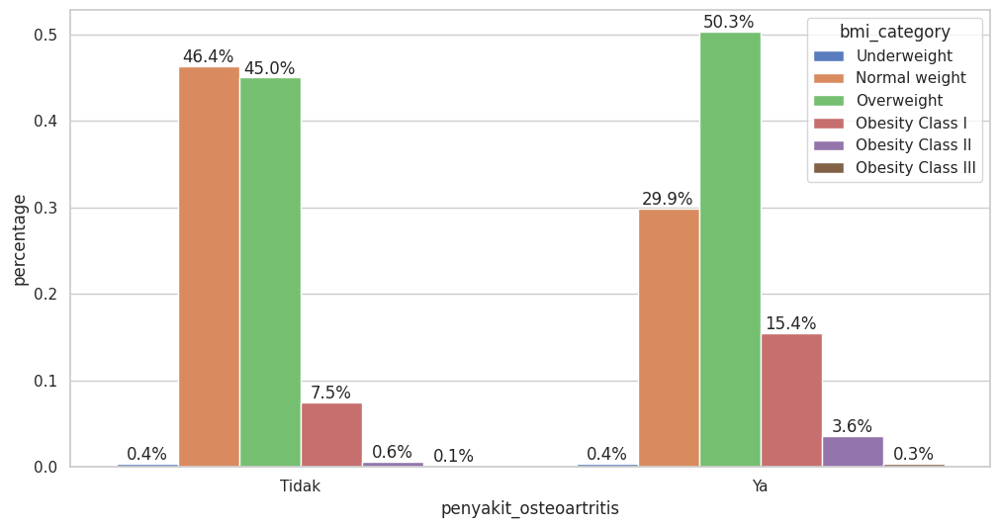

<Figure size 1200x600 with 0 Axes>

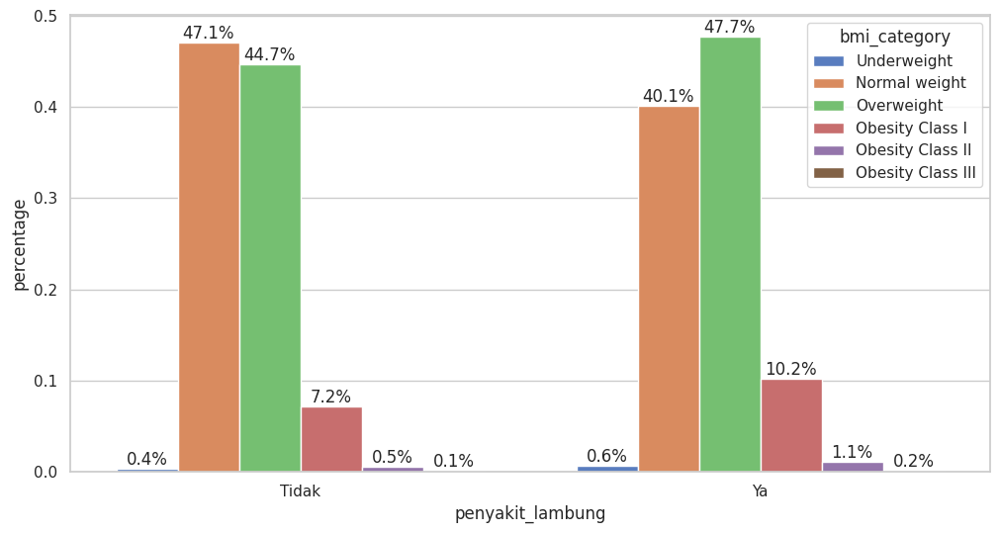

<Figure size 1200x600 with 0 Axes>

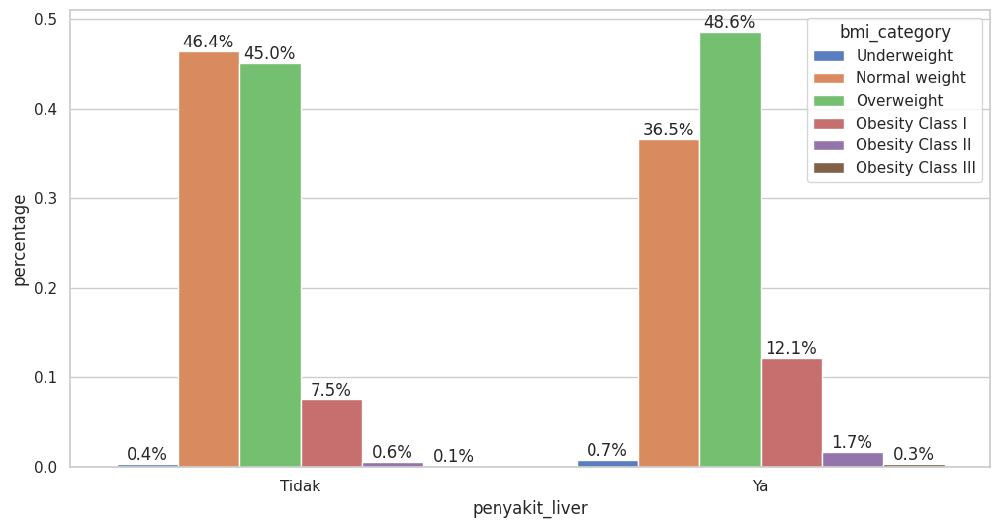

<Figure size 1200x600 with 0 Axes>

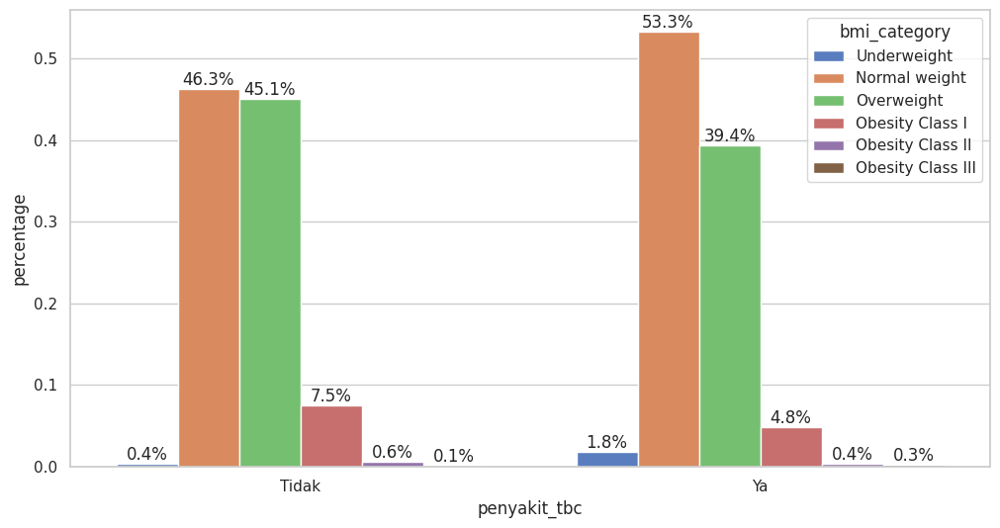

<Figure size 1200x600 with 0 Axes>

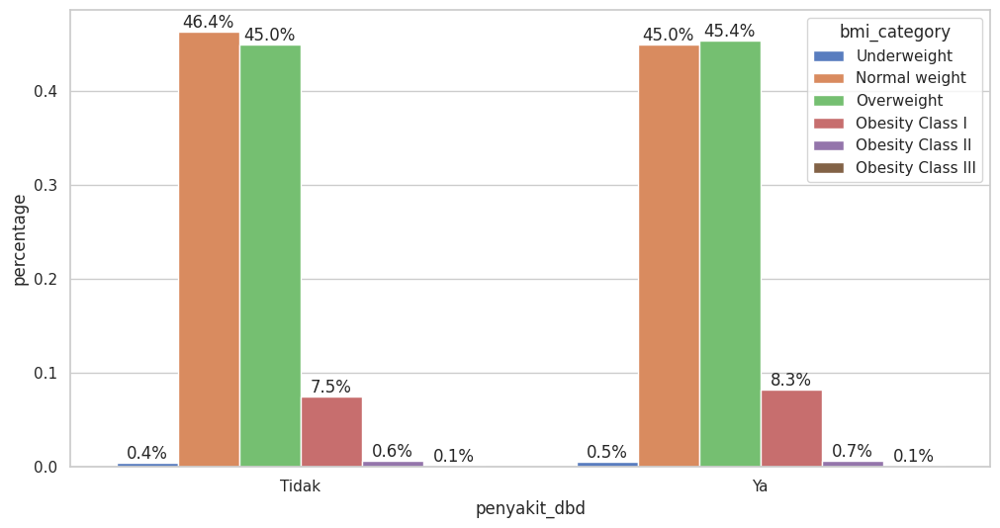

<Figure size 1200x600 with 0 Axes>

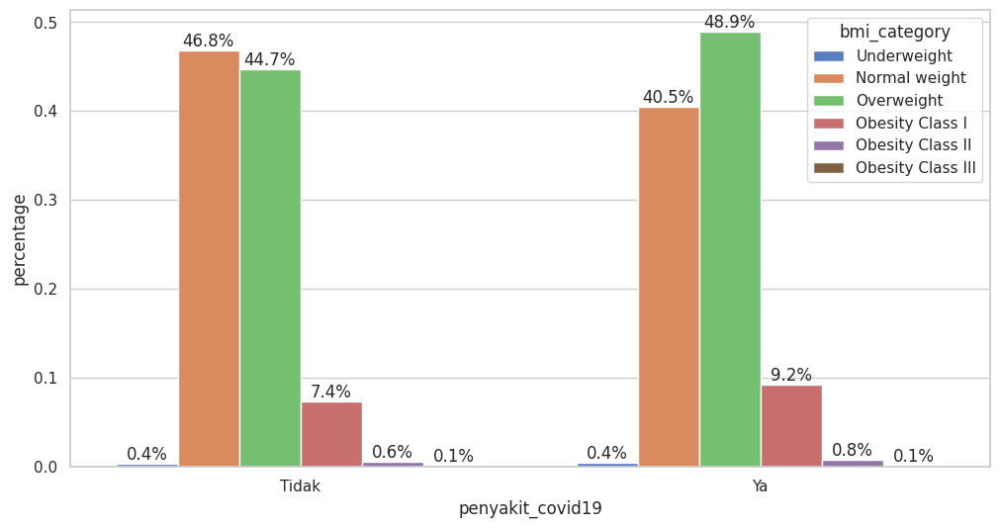

<Figure size 1200x600 with 0 Axes>

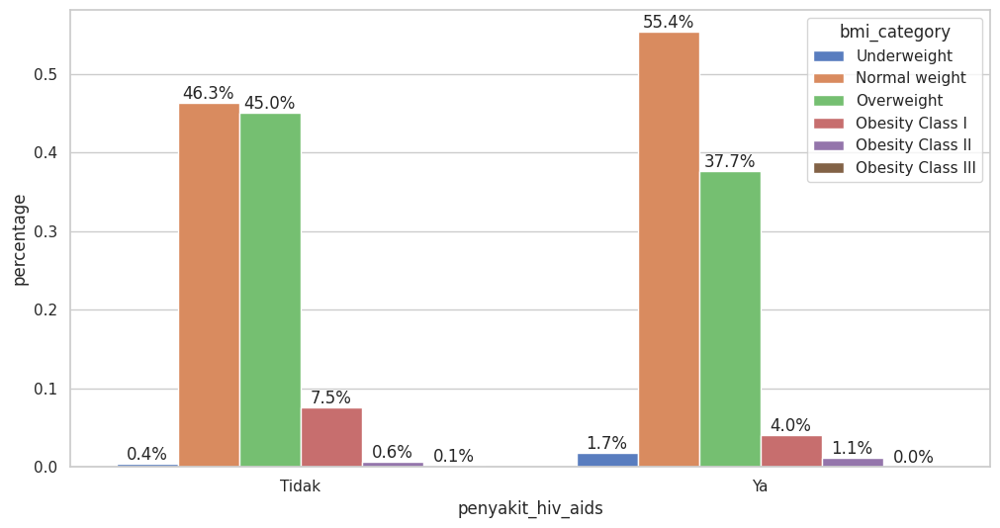

<Figure size 1200x600 with 0 Axes>

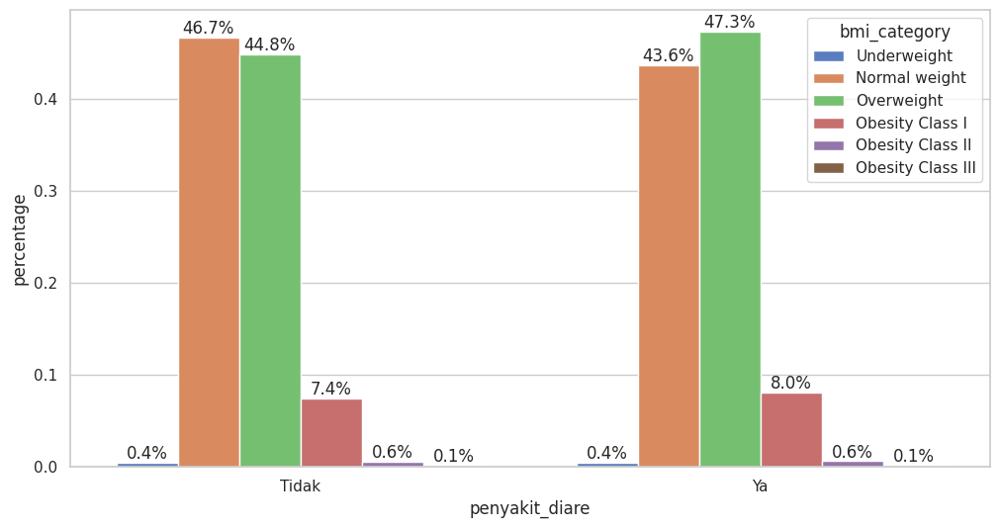

<Figure size 1200x600 with 0 Axes>

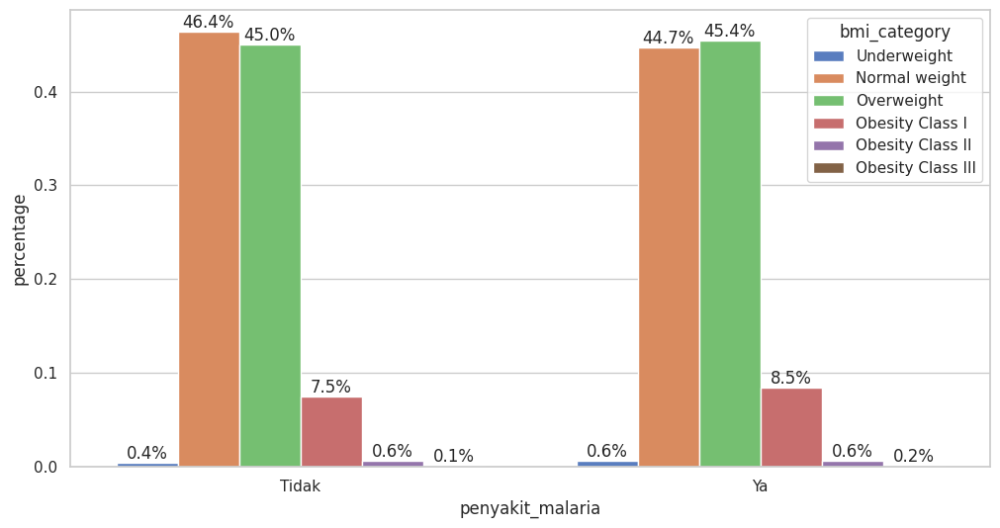

<Figure size 1200x600 with 0 Axes>

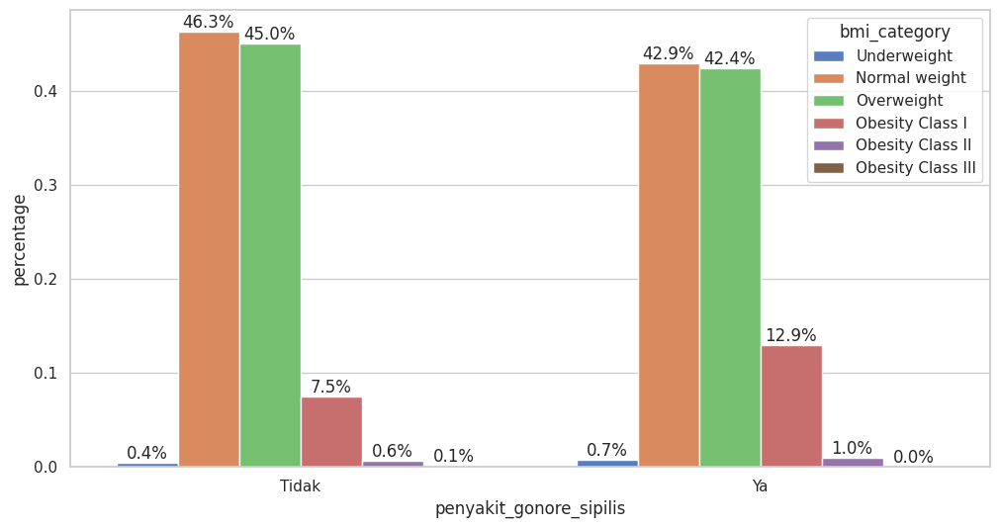

<Figure size 1200x600 with 0 Axes>

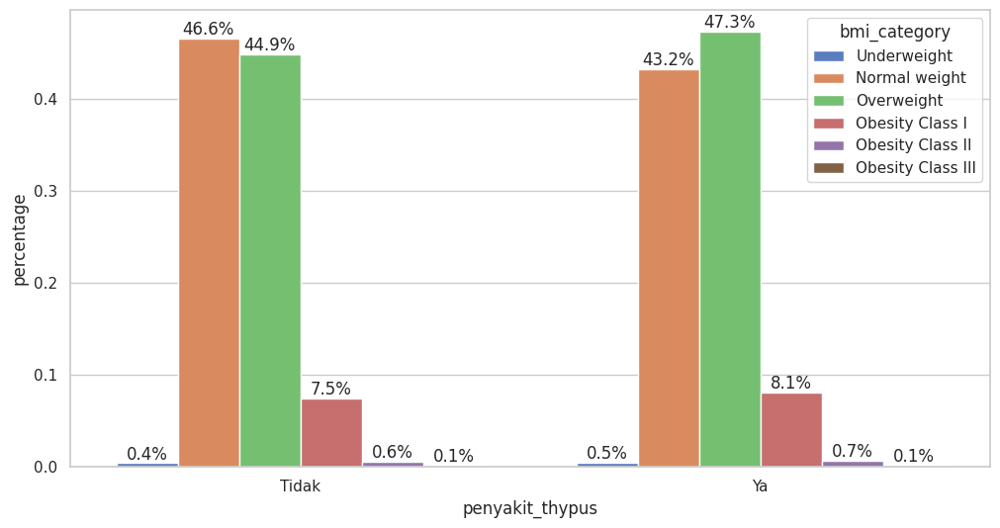

<Figure size 1200x600 with 0 Axes>

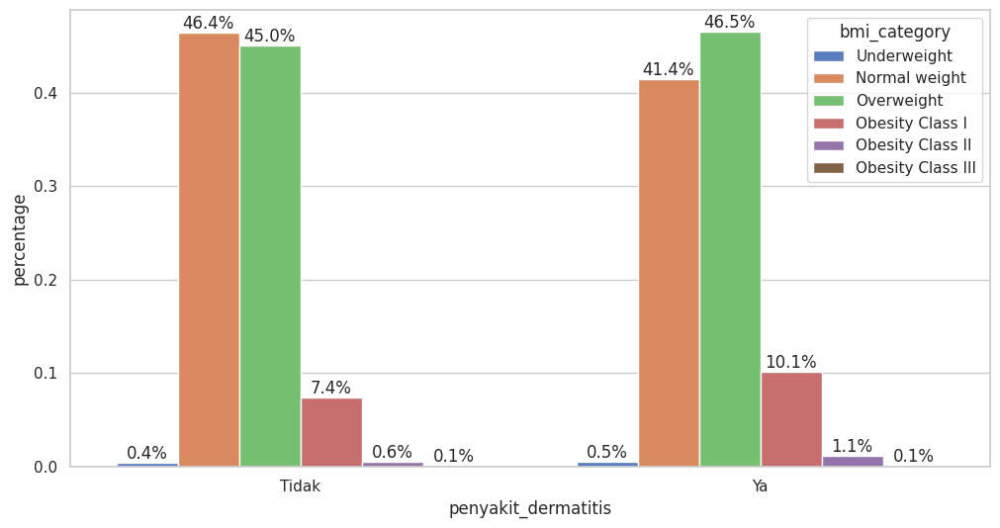

<Figure size 1200x600 with 0 Axes>

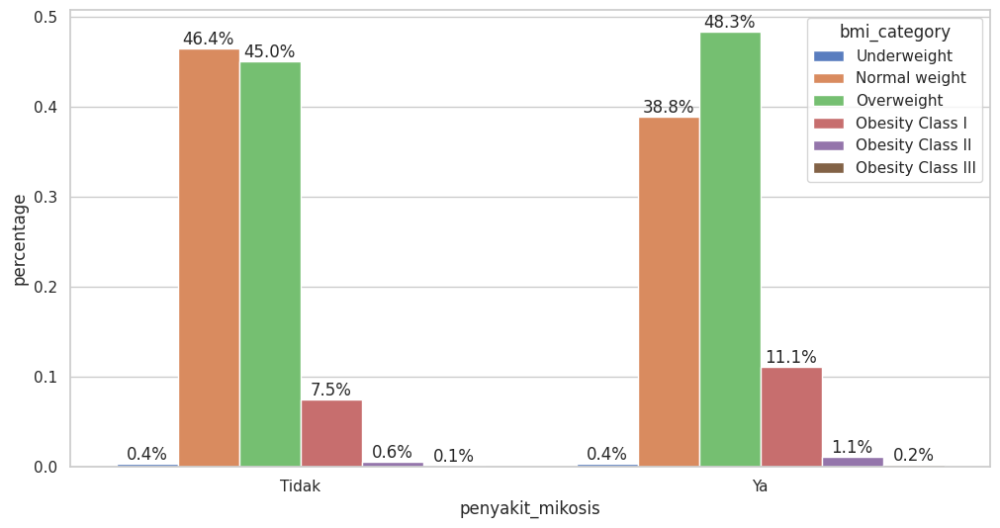

<Figure size 1200x600 with 0 Axes>

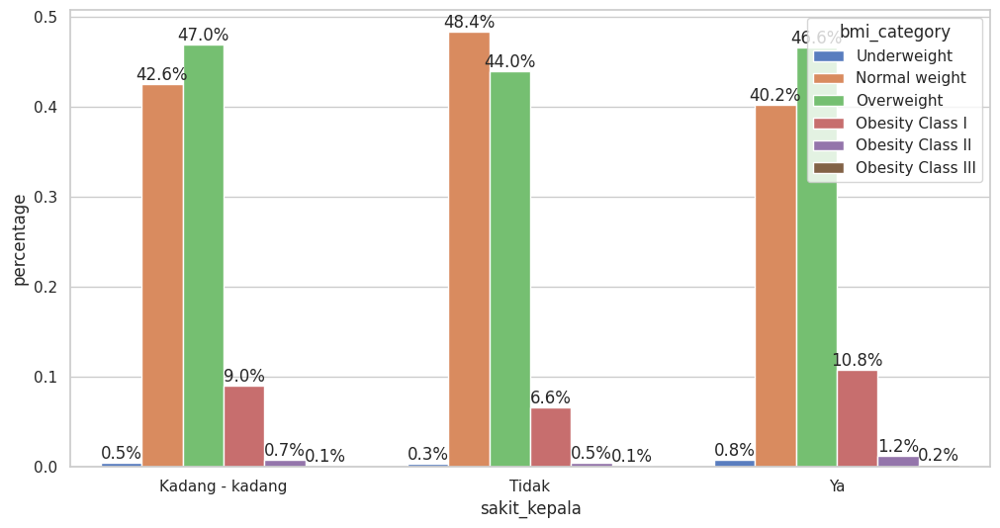

In [ ]:
for i in disease:
  barplot_prop_percent(x=i,
                     hue="bmi_category",
                     df=df,
                     size=(12, 6),
                     title="")
  print("")

### <h2> Fasilitas Umumkah? </h2> ###

In [ ]:
df.columns.tolist

<bound method IndexOpsMixin.tolist of Index(['wilayah', 'jenis_kelamin', 'usia', 'lama_berdinas', 'pendidikan',
       'tinggi', 'berat', 'lingkar_pinggang', 'status_kawin', 'pengeluaran',
       'penyakit_jantung', 'penyakit_stroke', 'penyakit_diabetes_melitus',
       'penyakit_hipertensi', 'penyakit_kanker', 'penyakit_ginjal',
       'penyakit_tumor', 'penyakit_osteoartritis', 'penyakit_lambung',
       'penyakit_liver', 'penyakit_tbc', 'penyakit_dbd', 'penyakit_covid19',
       'penyakit_hiv_aids', 'penyakit_diare', 'penyakit_malaria',
       'penyakit_gonore_sipilis', 'penyakit_thypus', 'penyakit_dermatitis',
       'penyakit_mikosis', 'sakit_kepala', 'tidak_nafsu_makan', 'sulit_tidur',
       'mudah_takut', 'tegang,_cemas_atau_kuatir', 'tangan_anda_gemetar',
       'masalah_pencernaan', 'sulit_untuk_berpikir_jernih', 'tidak_bahagia',
       'menangis_lebih_sering', 'sulit_untuk_menikmati_kegiatan_sehari_hari',
       'sulit_untuk_mengambil_keputusan', 'pekerjaan_terganggu',
     

In [ ]:
facility = ['penghawaan_cukup', 'kontaminasi_udara', 'sumber_air_bersih',
       'sumber_air_makan_minum', 'jarak_jamban_sumur',
       'saluran_pembuangan_air', 'ada_tempat_sampah', 'jarak_tempat_sampah',
       'fasilitas_olahraga']

for i in facility:
  print(df[i].value_counts())
  print("")

Lebih dari 1 sirkulasi udara     281638
Kurang dari 1 sirkulasi udara      5873
Tidak ada sirkulasi udara          1143
Name: penghawaan_cukup, dtype: int64

Tidak         260563
Tidak tahu     15788
Ya             12303
Name: kontaminasi_udara, dtype: int64

Air PAM        160459
Sumur/Kali     124908
Tadah hujan      2244
Tidak ada        1043
Name: sumber_air_bersih, dtype: int64

Air mineral isi ulang    92608
Air PAM                  73446
Air sumur                60715
Air mineral kemasan      58925
Tadah hujan               2960
Name: sumber_air_makan_minum, dtype: int64

Lebih dari 12 meter            152107
Kurang dari 12 meter            99822
Tidak memiliki jamban sehat     36725
Name: jarak_jamban_sumur, dtype: int64

Ada           274479
Tidak tahu      8693
Tidak ada       5482
Name: saluran_pembuangan_air, dtype: int64

Ada, tertutup    160857
Ada, terbuka      86342
Tidak ada         41455
Name: ada_tempat_sampah, dtype: int64

Lebih dari 10 meter     167562
Kurang dari

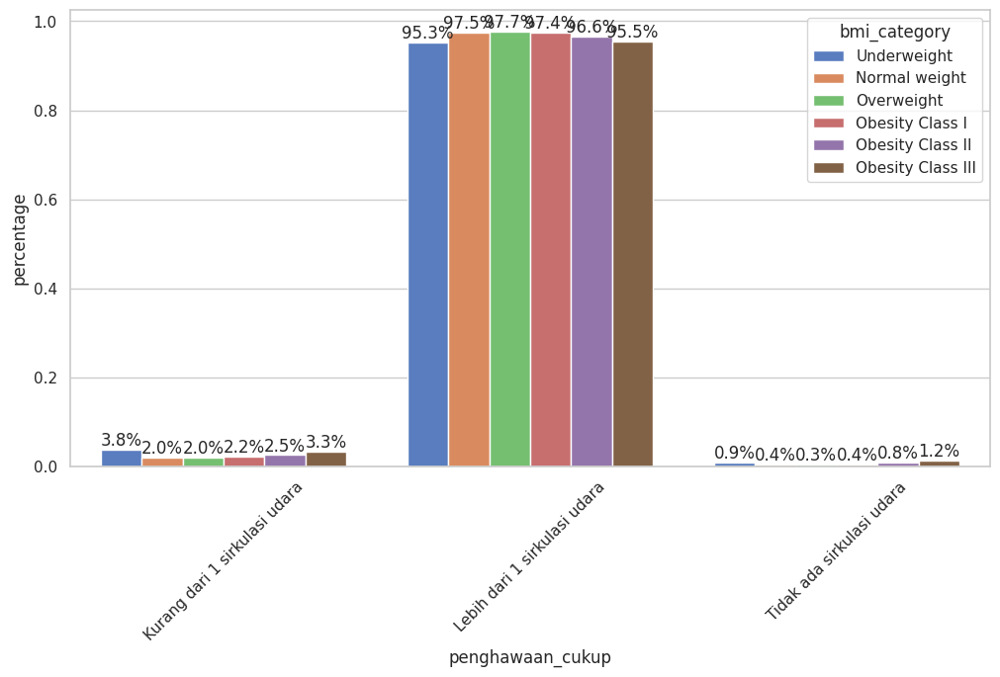

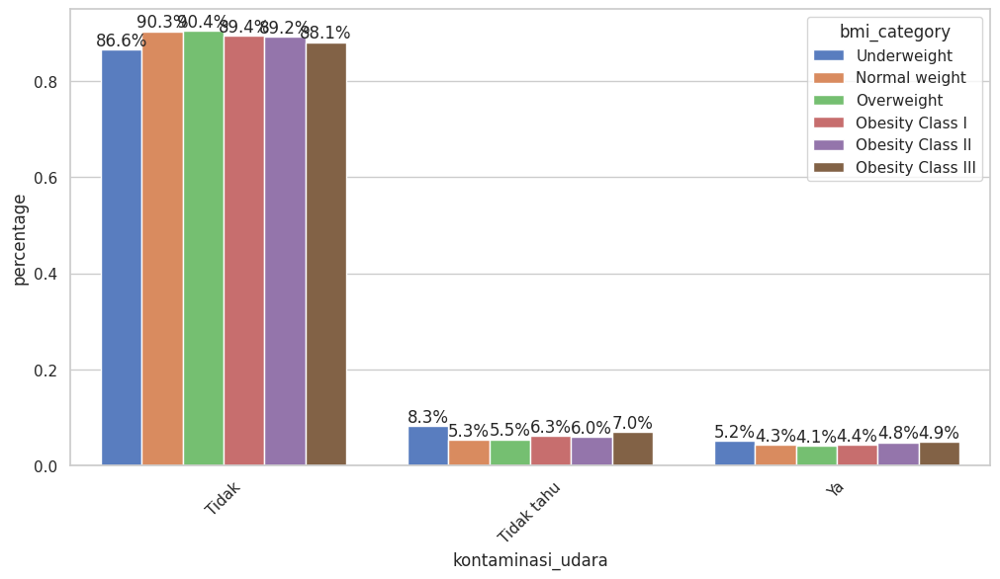

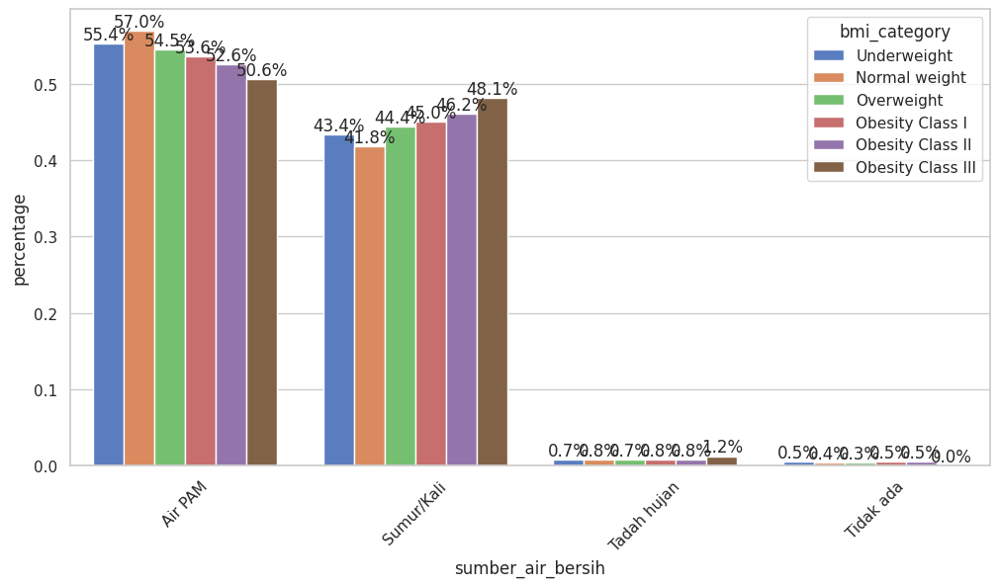

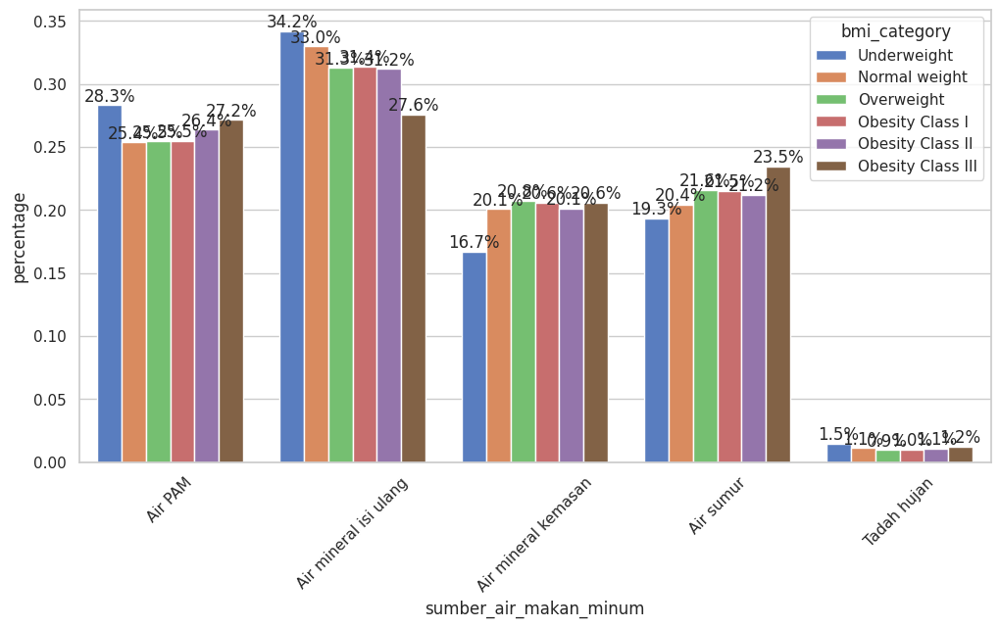

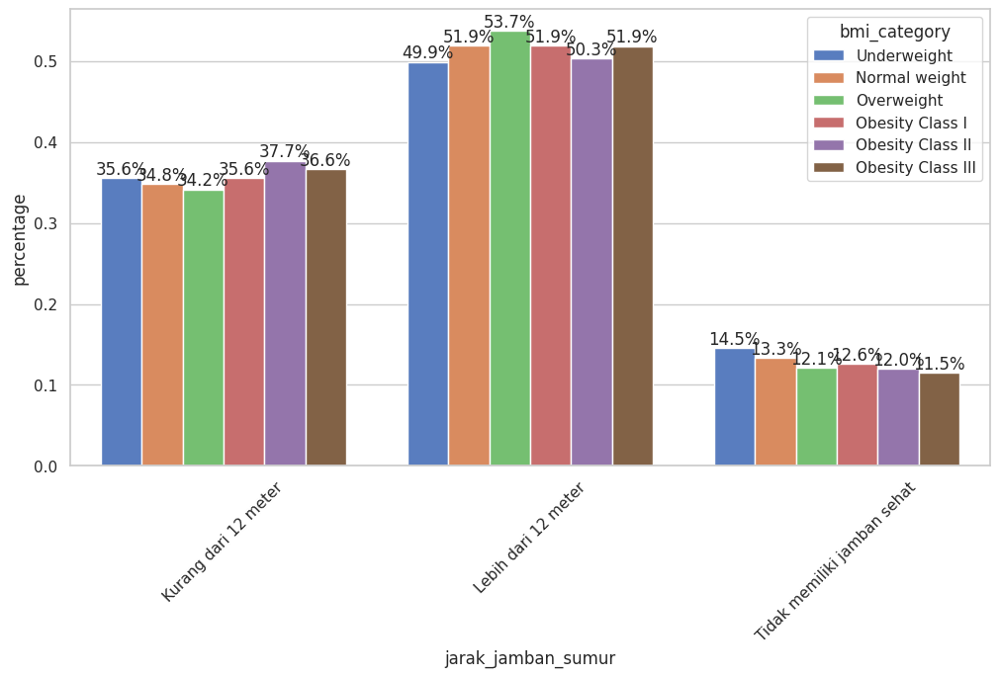

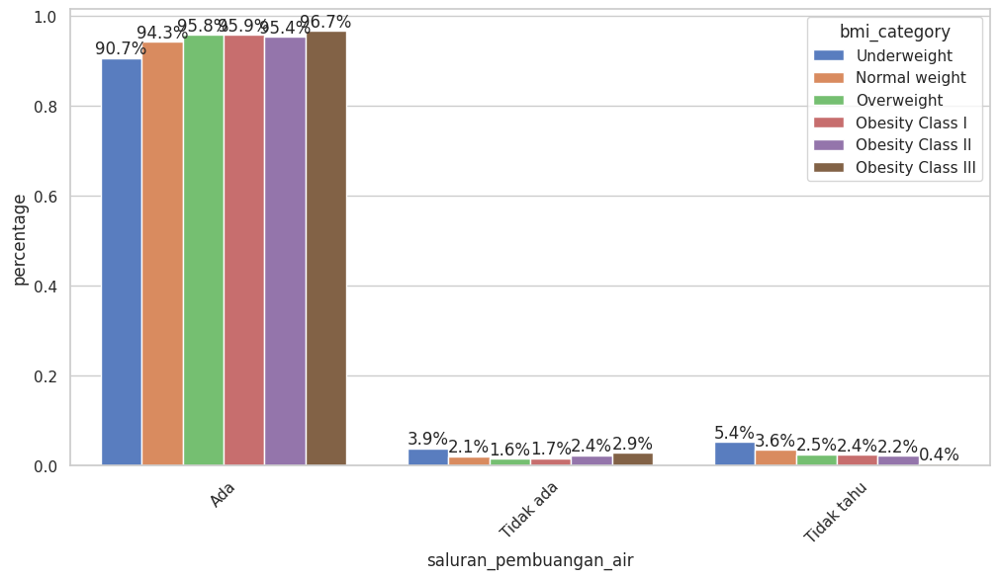

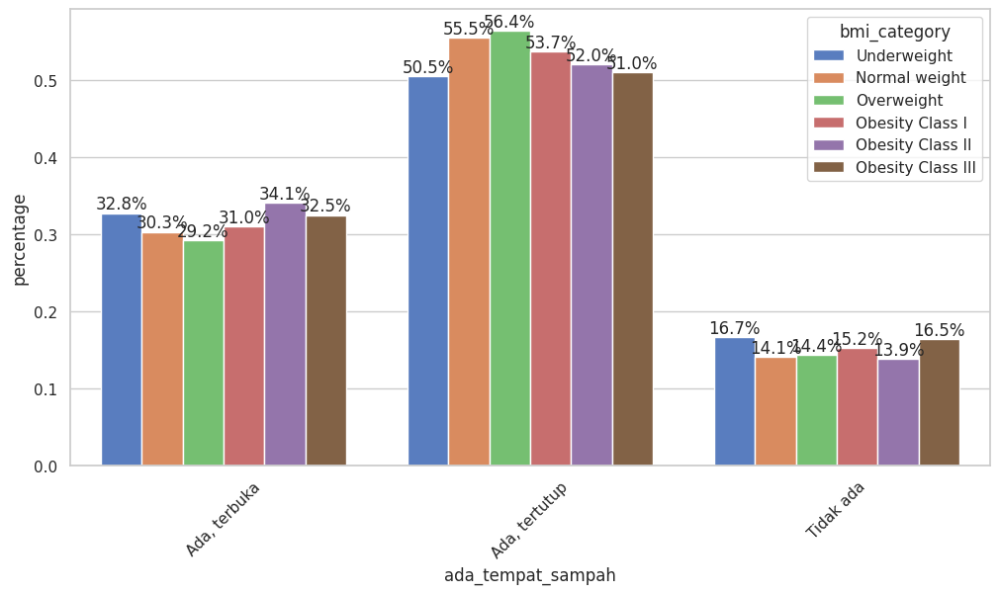

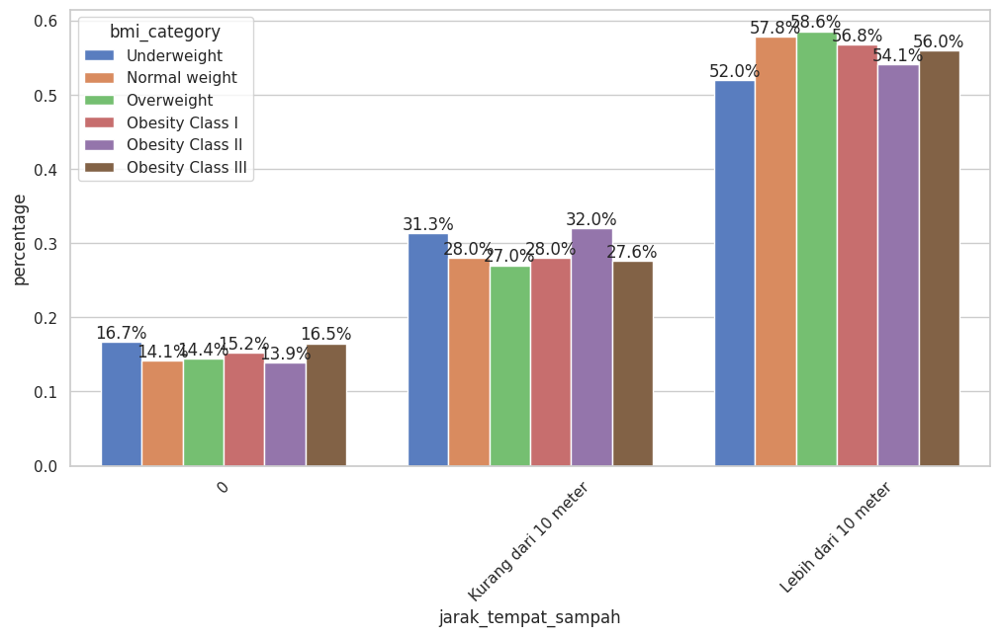

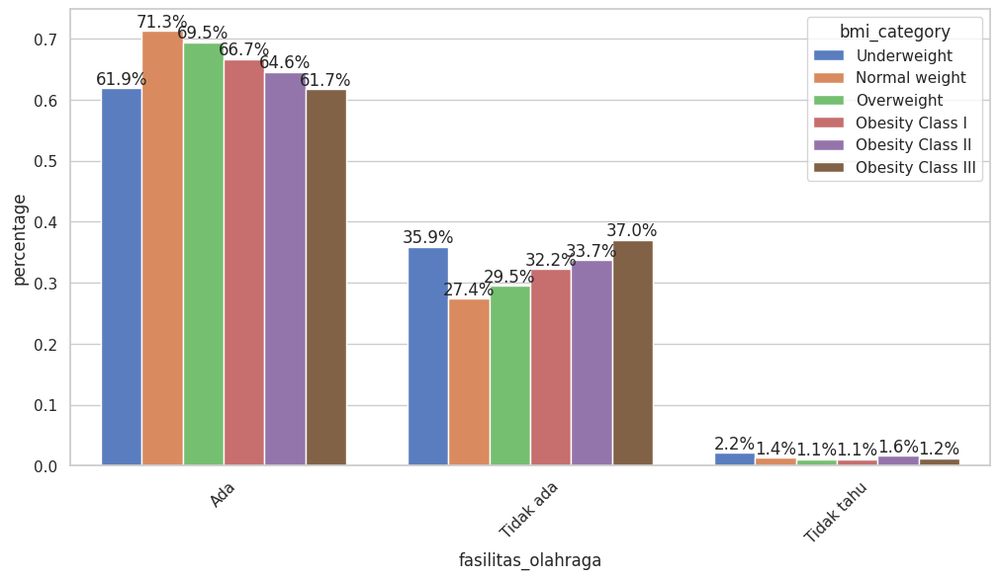

In [ ]:
for i in facility:
  barplot_prop_percent_hue(x=i,
                     hue="bmi_category",
                     df=df,
                     size=(12, 6),
                     title="")
  print("")

<Figure size 1200x600 with 0 Axes>

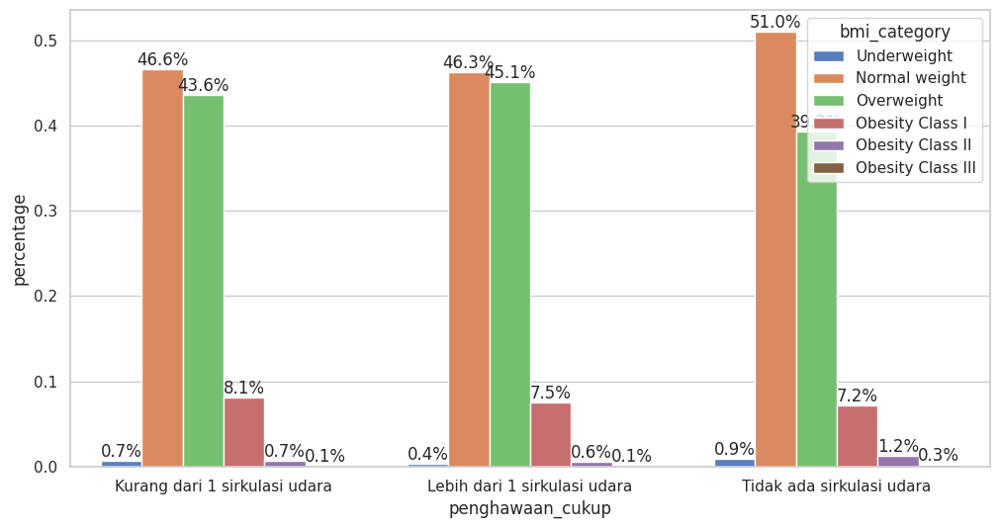

<Figure size 1200x600 with 0 Axes>

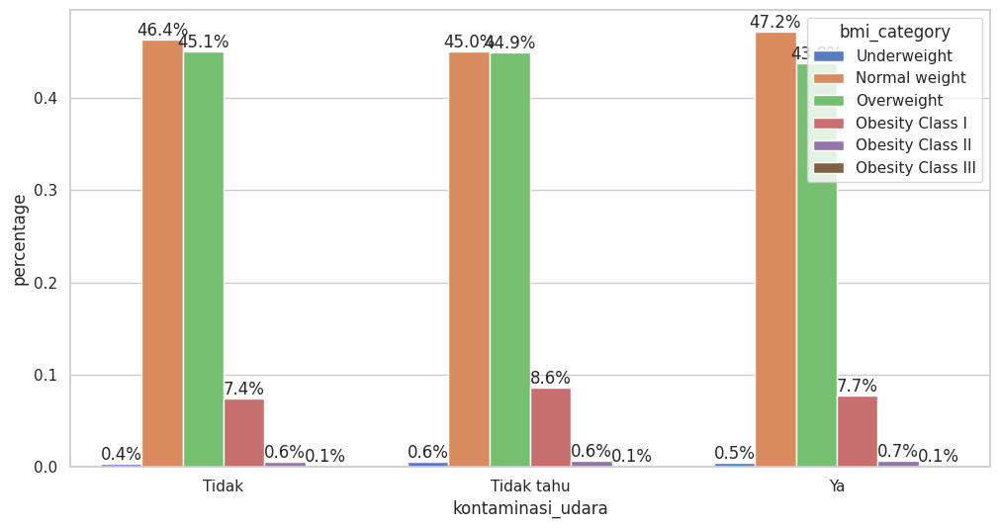

<Figure size 1200x600 with 0 Axes>

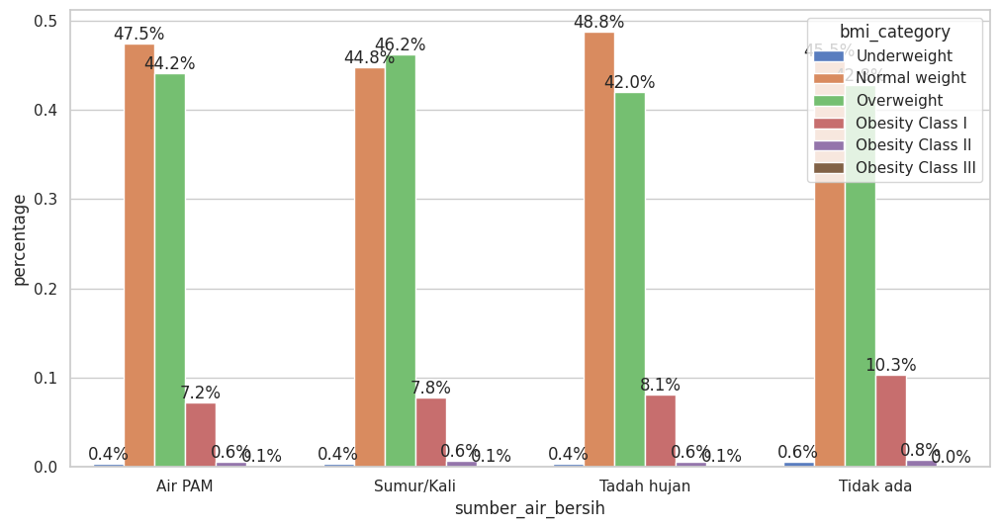

<Figure size 1200x600 with 0 Axes>

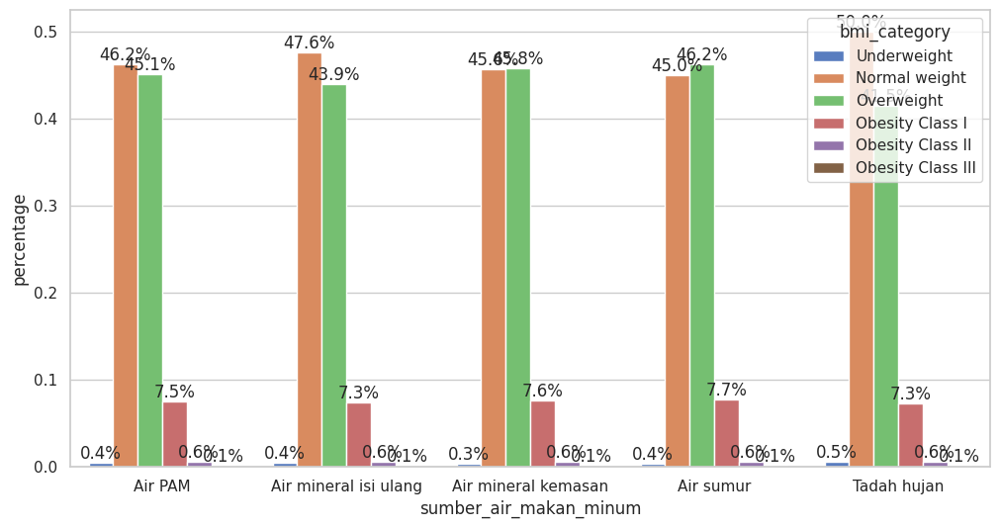

<Figure size 1200x600 with 0 Axes>

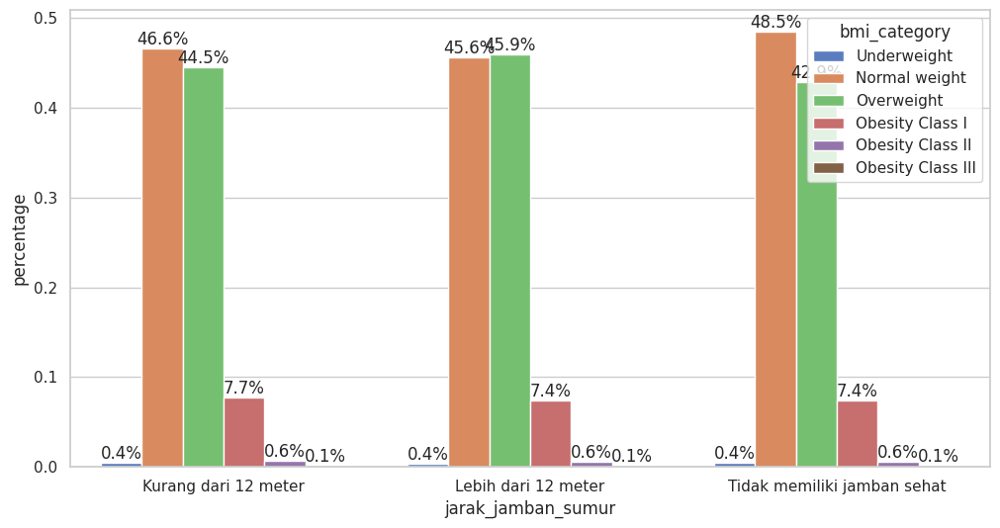

<Figure size 1200x600 with 0 Axes>

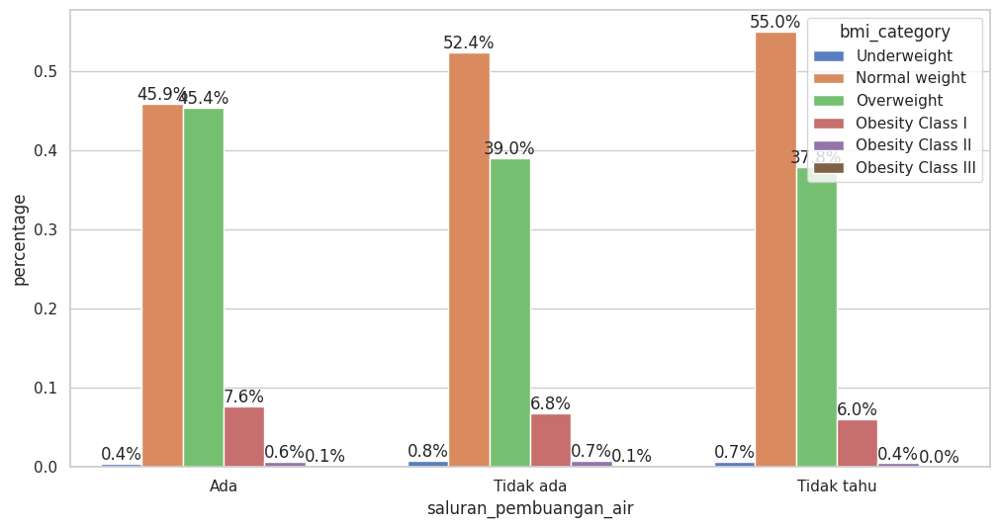

<Figure size 1200x600 with 0 Axes>

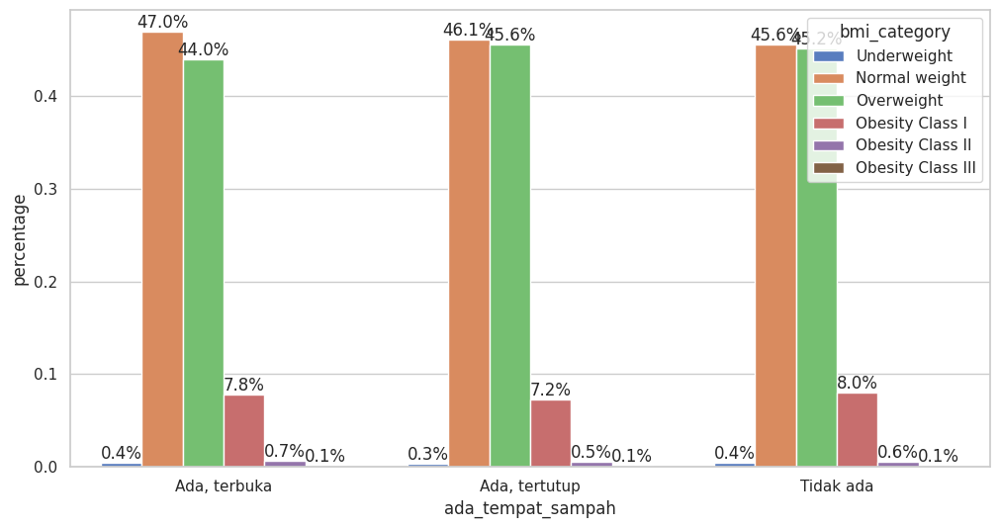

<Figure size 1200x600 with 0 Axes>

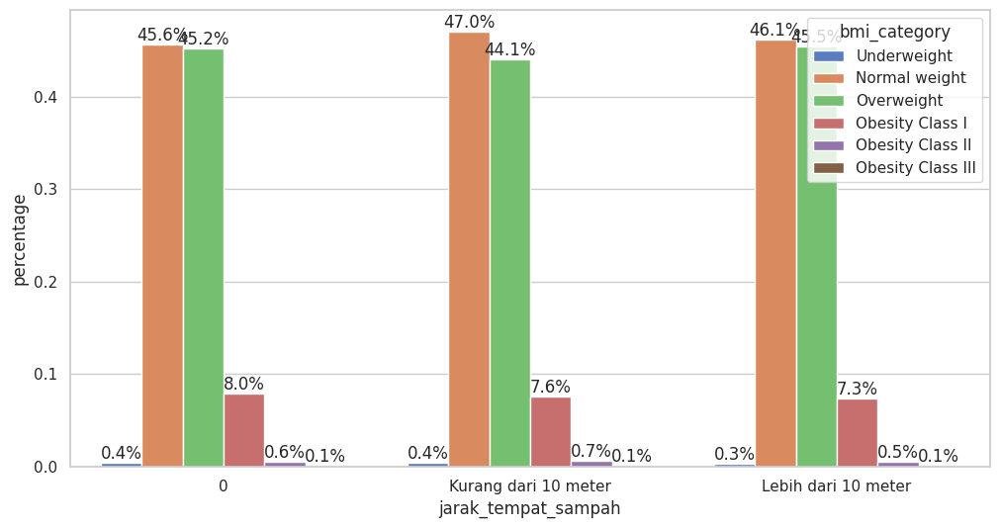

<Figure size 1200x600 with 0 Axes>

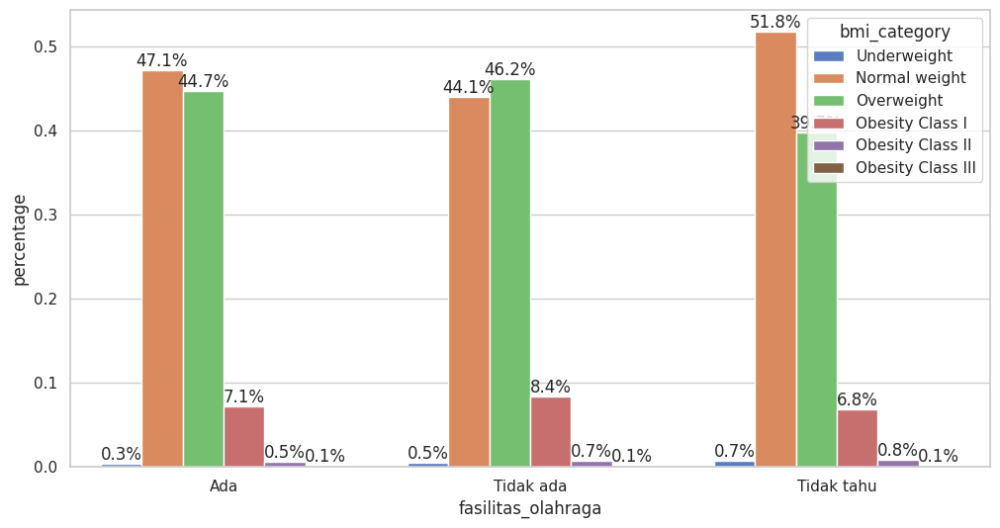

In [ ]:
for i in facility:
  barplot_prop_percent(x=i,
                     hue="bmi_category",
                     df=df,
                     size=(12, 6),
                     title="")
  print("")

### <h2> Genetikkah </h2> ###

In [ ]:
genetic = ['jenis_kelamin', 'kelompok_umur']

for i in genetic:
  print(df[i].value_counts())
  print("")

LAKI - LAKI    266593
PEREMPUAN       22061
Name: jenis_kelamin, dtype: int64

35 - 44    117667
25 - 34     67234
45 - 54     52142
15 - 24     38206
55 - 64     13128
≥ 65          277
Name: kelompok_umur, dtype: int64



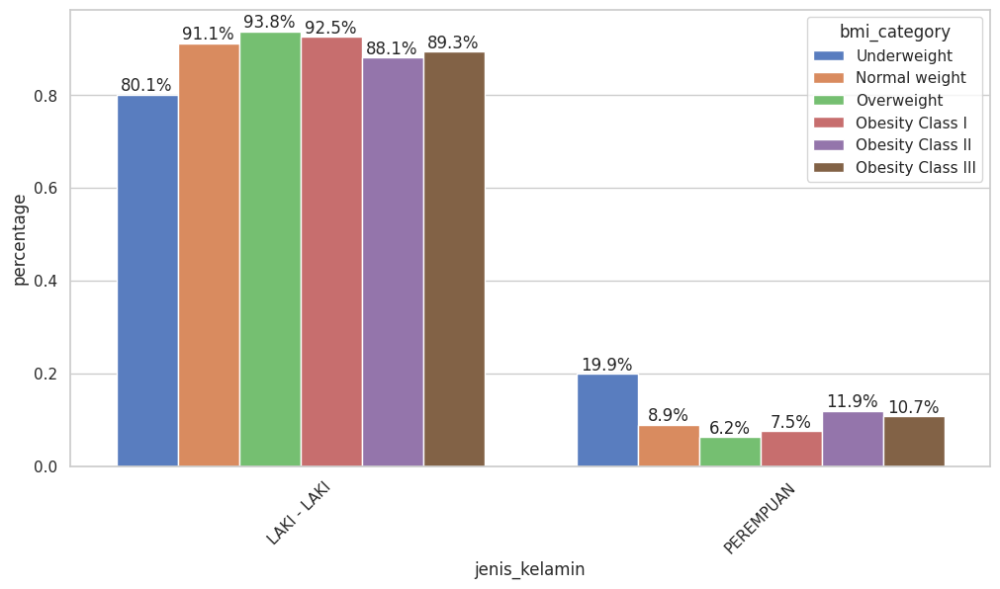

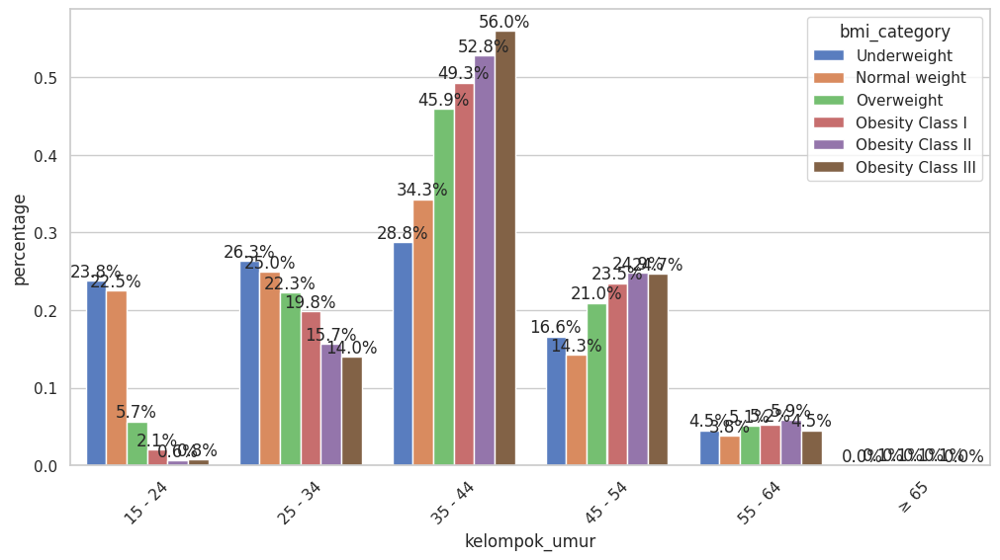

In [ ]:
for i in genetic:
  barplot_prop_percent_hue(x=i,
                     hue="bmi_category",
                     df=df,
                     size=(12, 6),
                     title="")
  print("")

<Figure size 1200x600 with 0 Axes>

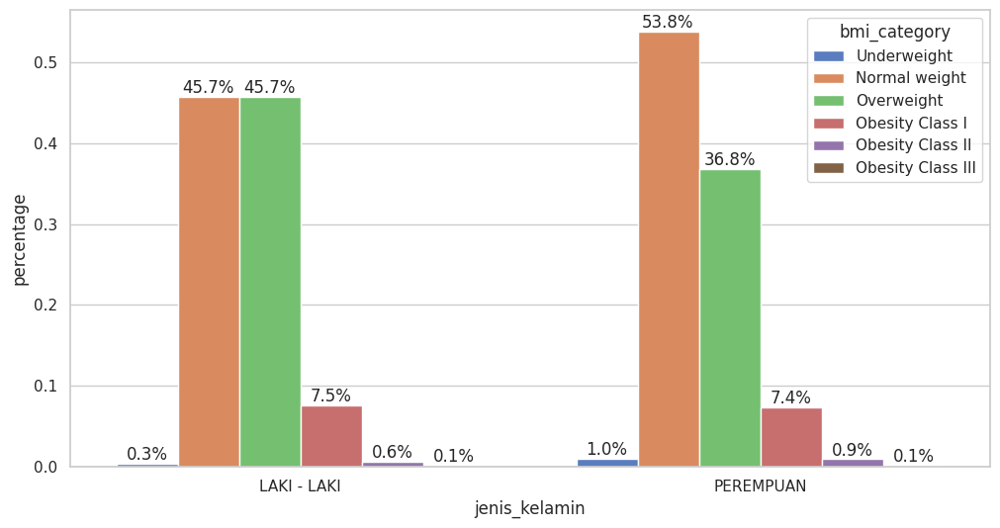

<Figure size 1200x600 with 0 Axes>

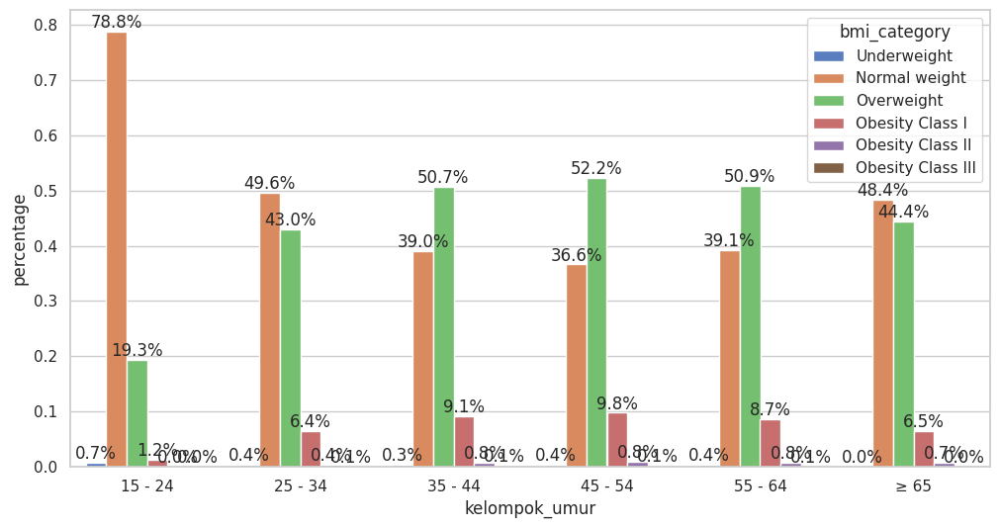

In [ ]:
for i in genetic:
  barplot_prop_percent(x=i,
                     hue="bmi_category",
                     df=df,
                     size=(12, 6),
                     title="")
  print("")

### <h2> Kesehatan mentalkah? </h2> ###

In [ ]:
df.columns.tolist

<bound method IndexOpsMixin.tolist of Index(['wilayah', 'jenis_kelamin', 'usia', 'lama_berdinas', 'pendidikan',
       'tinggi', 'berat', 'lingkar_pinggang', 'status_kawin', 'pengeluaran',
       'penyakit_jantung', 'penyakit_stroke', 'penyakit_diabetes_melitus',
       'penyakit_hipertensi', 'penyakit_kanker', 'penyakit_ginjal',
       'penyakit_tumor', 'penyakit_osteoartritis', 'penyakit_lambung',
       'penyakit_liver', 'penyakit_tbc', 'penyakit_dbd', 'penyakit_covid19',
       'penyakit_hiv_aids', 'penyakit_diare', 'penyakit_malaria',
       'penyakit_gonore_sipilis', 'penyakit_thypus', 'penyakit_dermatitis',
       'penyakit_mikosis', 'sakit_kepala', 'tidak_nafsu_makan', 'sulit_tidur',
       'mudah_takut', 'tegang,_cemas_atau_kuatir', 'tangan_anda_gemetar',
       'masalah_pencernaan', 'sulit_untuk_berpikir_jernih', 'tidak_bahagia',
       'menangis_lebih_sering', 'sulit_untuk_menikmati_kegiatan_sehari_hari',
       'sulit_untuk_mengambil_keputusan', 'pekerjaan_terganggu',
     

In [ ]:
mental_health = ['mudah_takut', 'tegang,_cemas_atau_kuatir', 'sulit_untuk_berpikir_jernih', 'tidak_bahagia',
                 'menangis_lebih_sering', 'sulit_untuk_menikmati_kegiatan_sehari_hari', 'sulit_untuk_mengambil_keputusan',
                 'tidak_mampu_melakukan_hal_hal_yang_bermanfaat_dalam_hidup', 'hilang_minat', 'tidak_berharga',
                 'ingin_bundir', 'lelah_sepanjang_waktu']

for i in mental_health:
  print(df[i].value_counts())
  print("")

Tidak              272669
Kadang - kadang     14340
Ya                   1645
Name: mudah_takut, dtype: int64

Tidak              256243
Kadang - kadang     29579
Ya                   2832
Name: tegang,_cemas_atau_kuatir, dtype: int64

Tidak              274148
Kadang - kadang     13317
Ya                   1189
Name: sulit_untuk_berpikir_jernih, dtype: int64

Tidak              277474
Kadang - kadang      9685
Ya                   1495
Name: tidak_bahagia, dtype: int64

Tidak              284444
Kadang - kadang      3850
Ya                    360
Name: menangis_lebih_sering, dtype: int64

Tidak              279732
Kadang - kadang      7723
Ya                   1199
Name: sulit_untuk_menikmati_kegiatan_sehari_hari, dtype: int64

Tidak              273501
Kadang - kadang     14221
Ya                    932
Name: sulit_untuk_mengambil_keputusan, dtype: int64

Tidak              283954
Kadang - kadang      3884
Ya                    816
Name: tidak_mampu_melakukan_hal_hal_yang_bermanfaat_

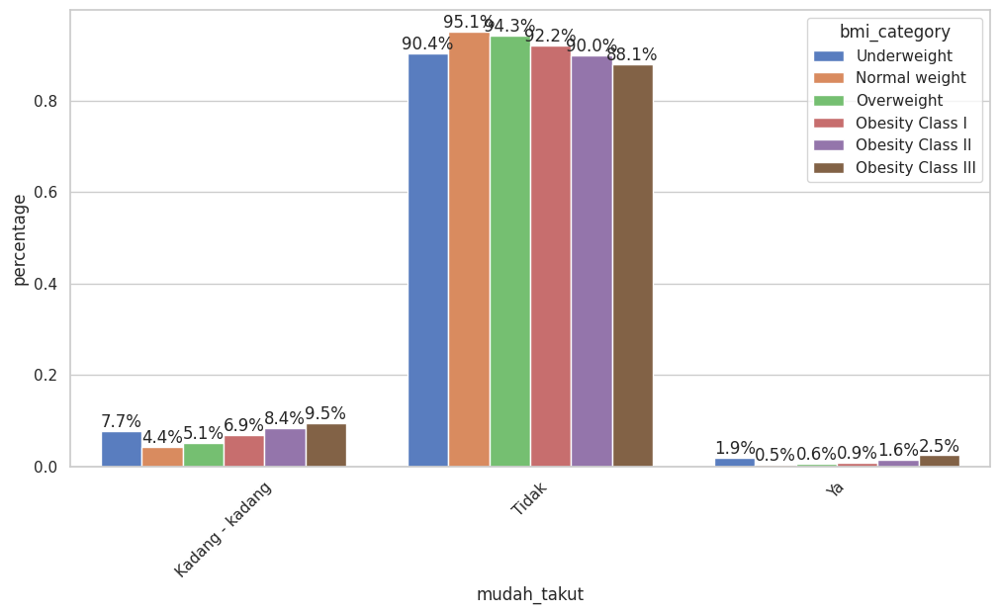

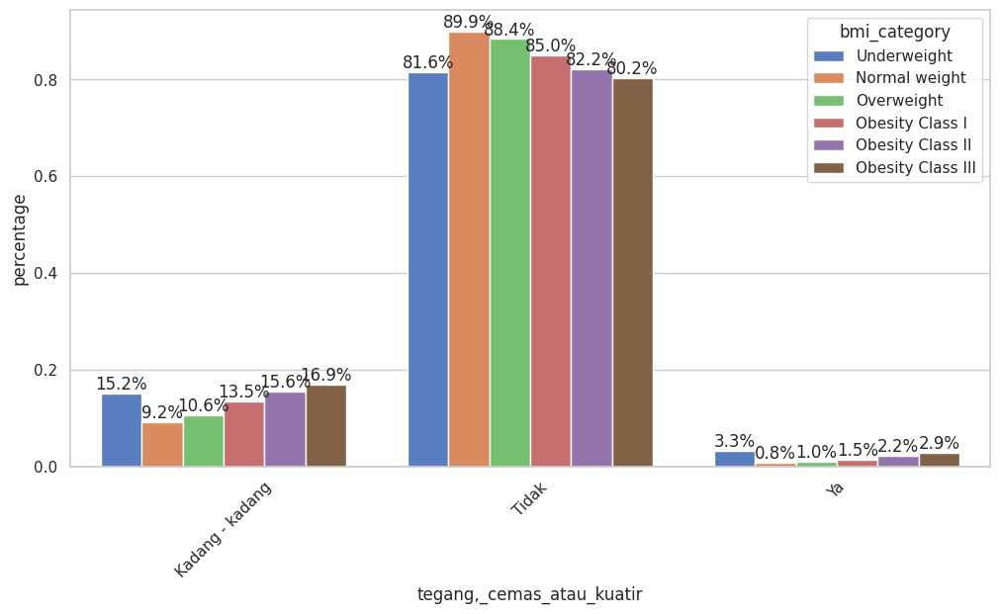

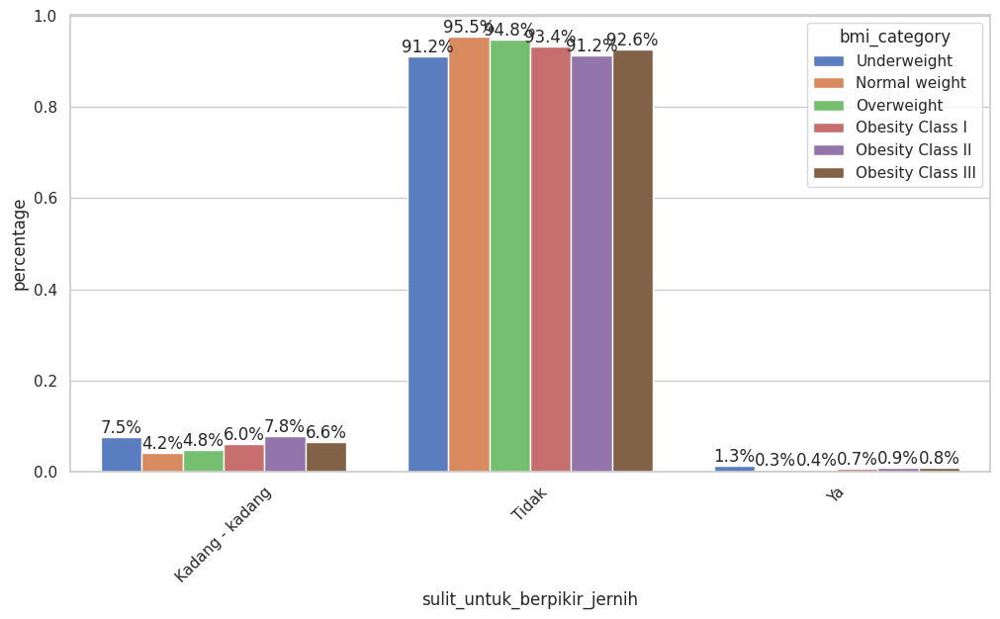

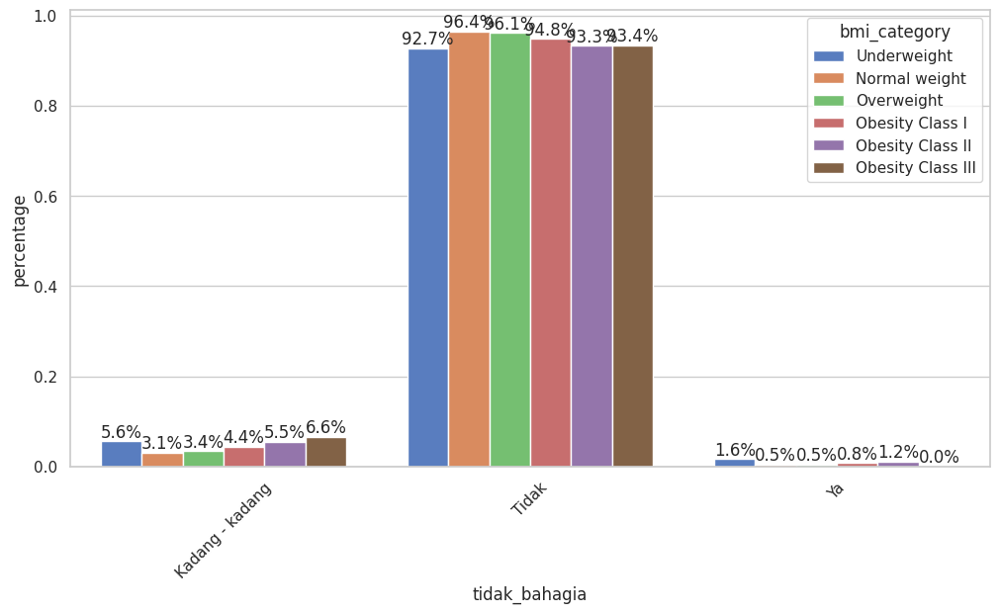

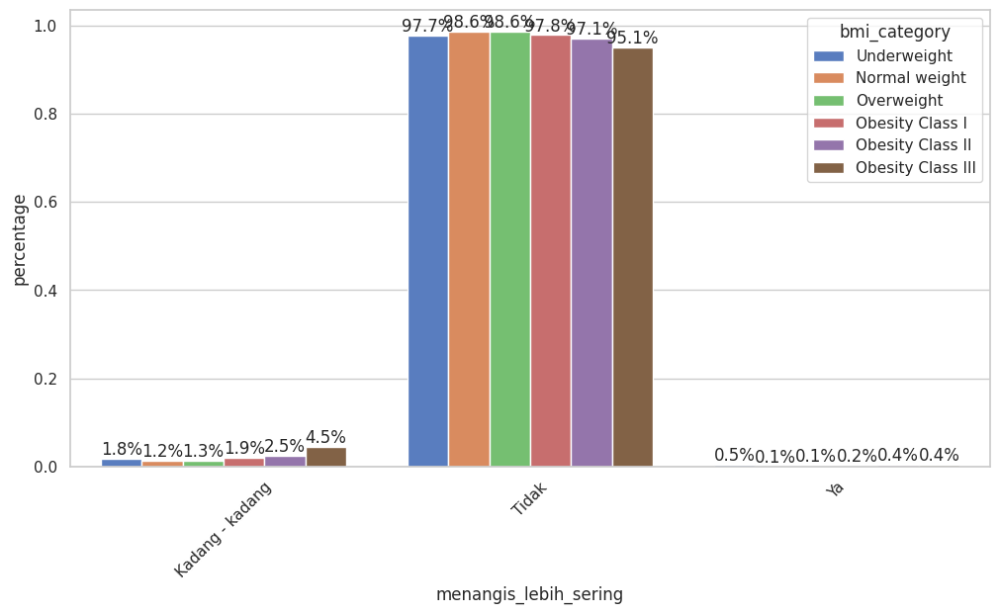

...

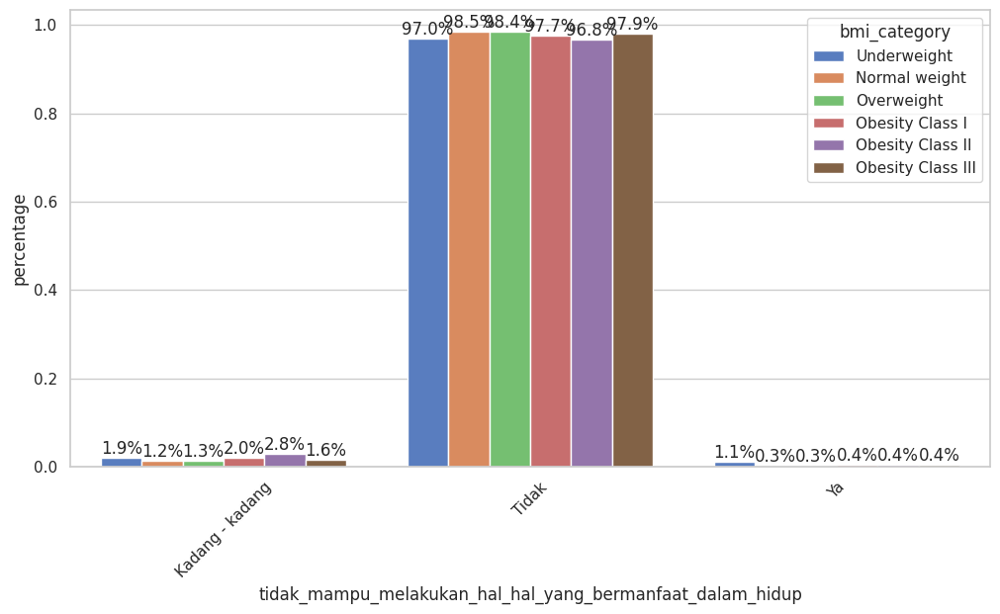

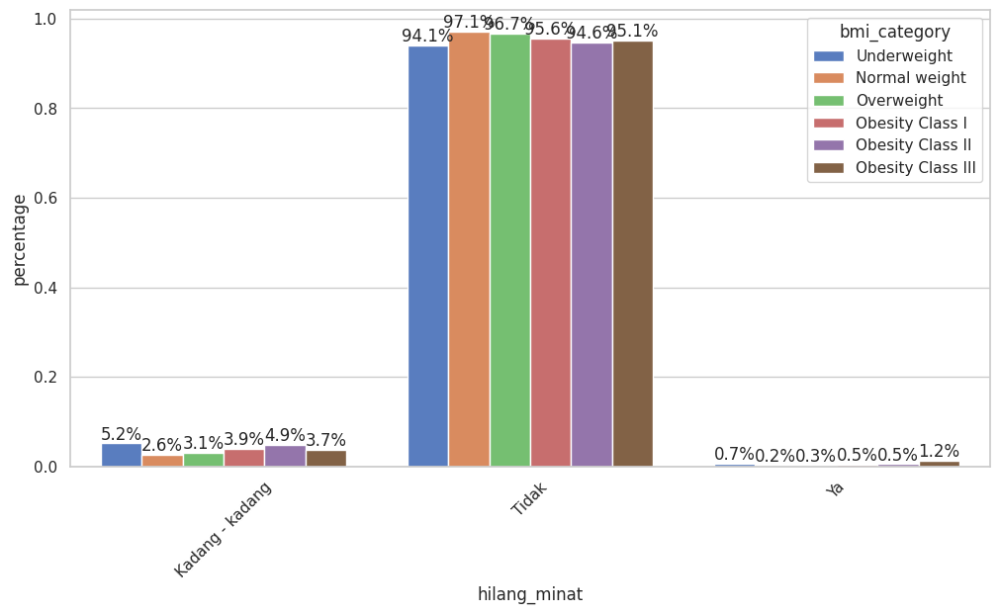

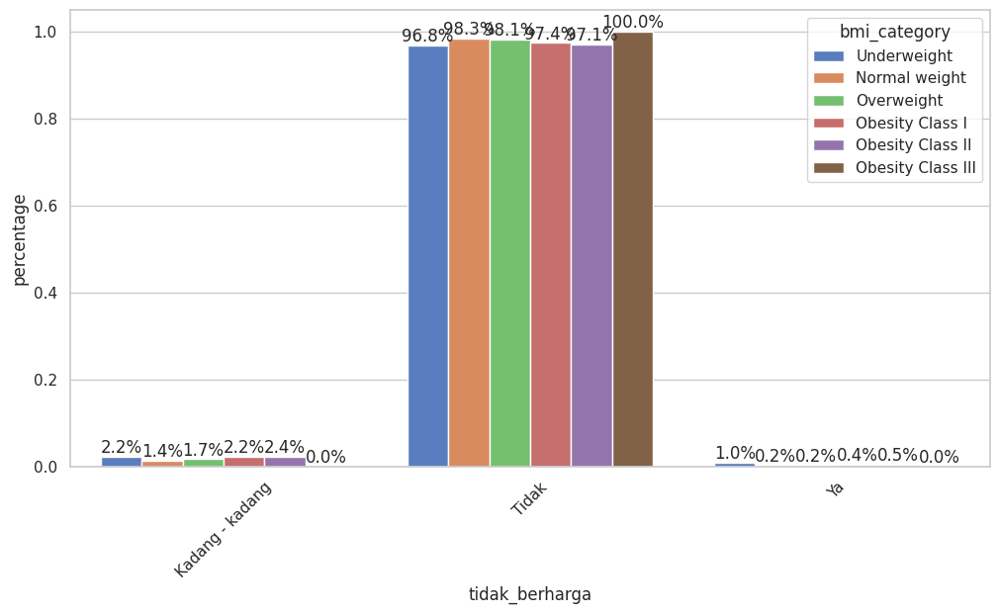

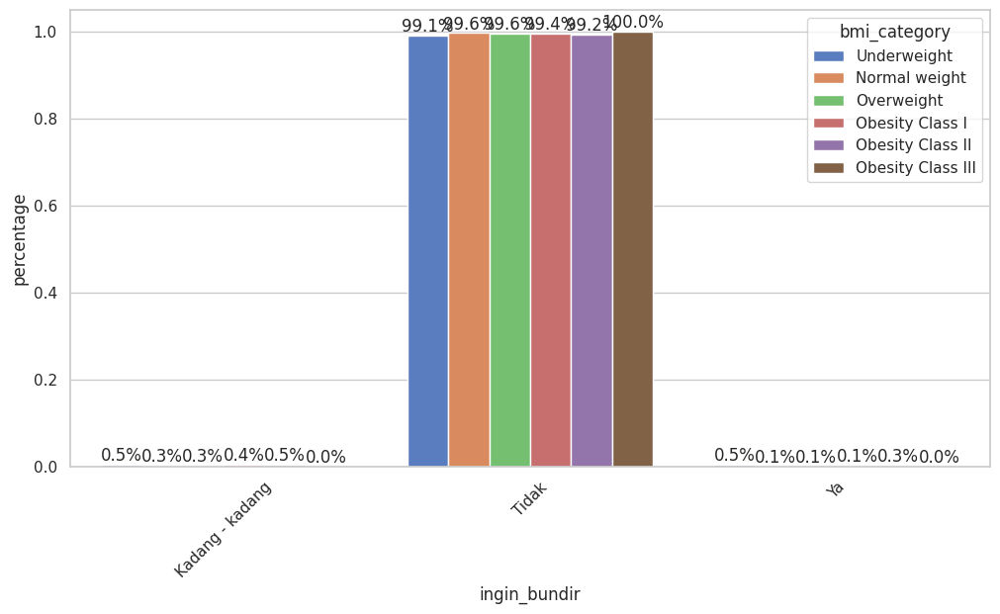

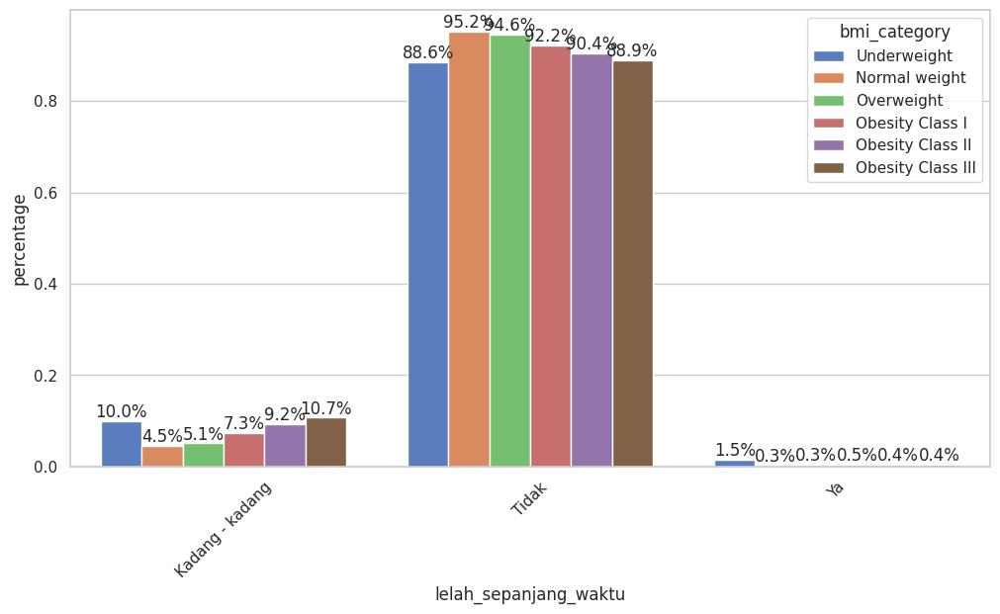

In [ ]:
for i in mental_health:
  barplot_prop_percent_hue(x=i,
                     hue="bmi_category",
                     df=df,
                     size=(12, 6),
                     title="")
  print("")

<Figure size 1200x600 with 0 Axes>

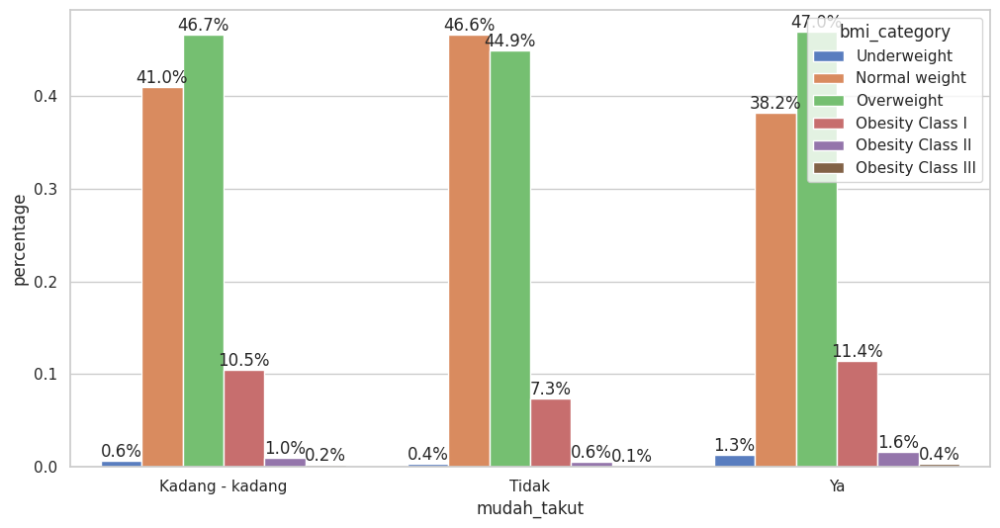

<Figure size 1200x600 with 0 Axes>

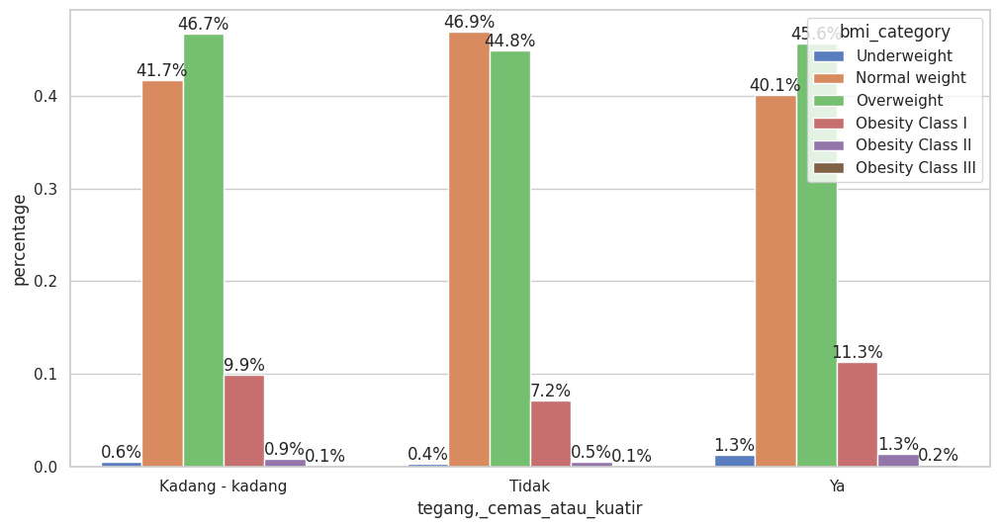

<Figure size 1200x600 with 0 Axes>

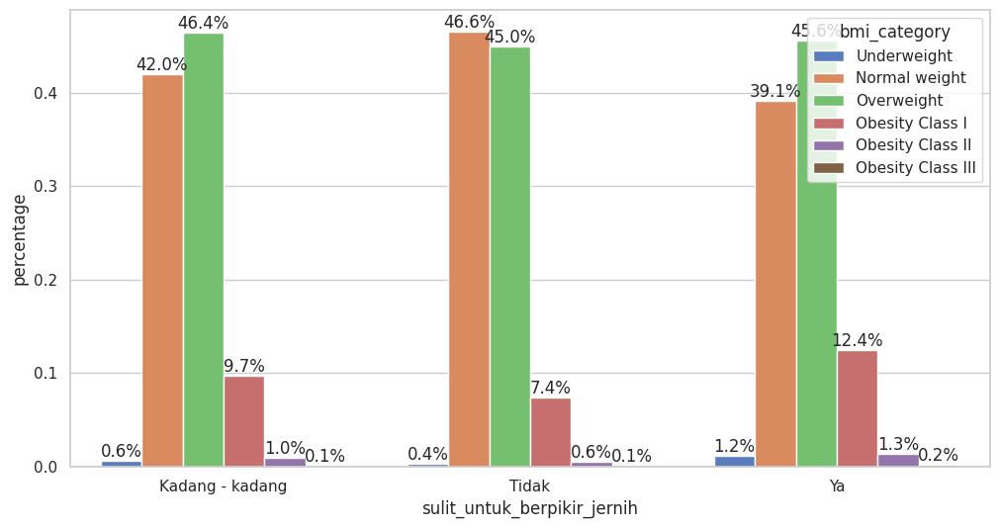

<Figure size 1200x600 with 0 Axes>

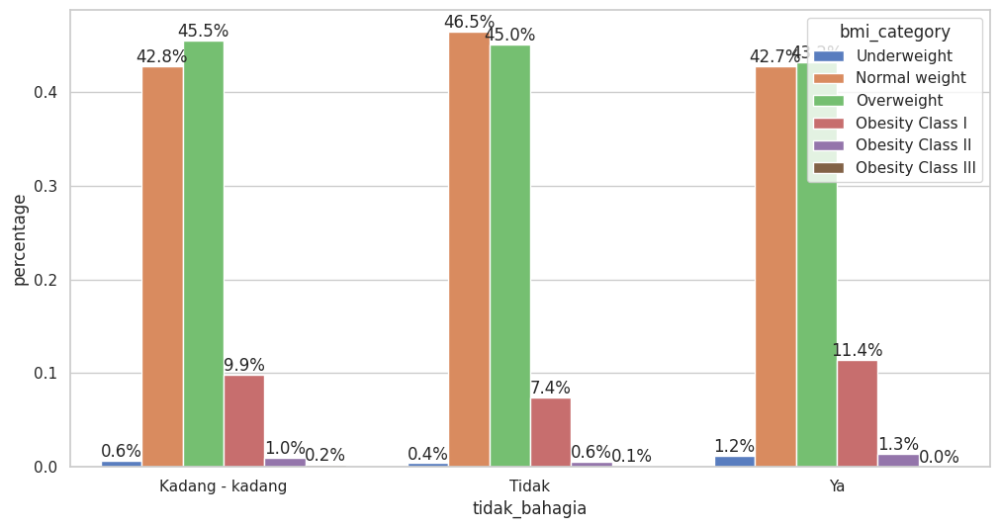

<Figure size 1200x600 with 0 Axes>

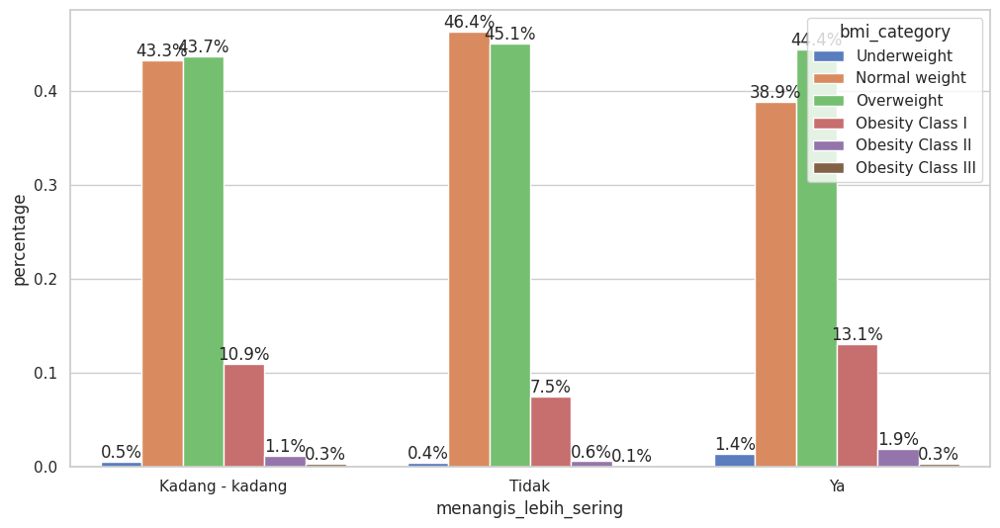

<Figure size 1200x600 with 0 Axes>

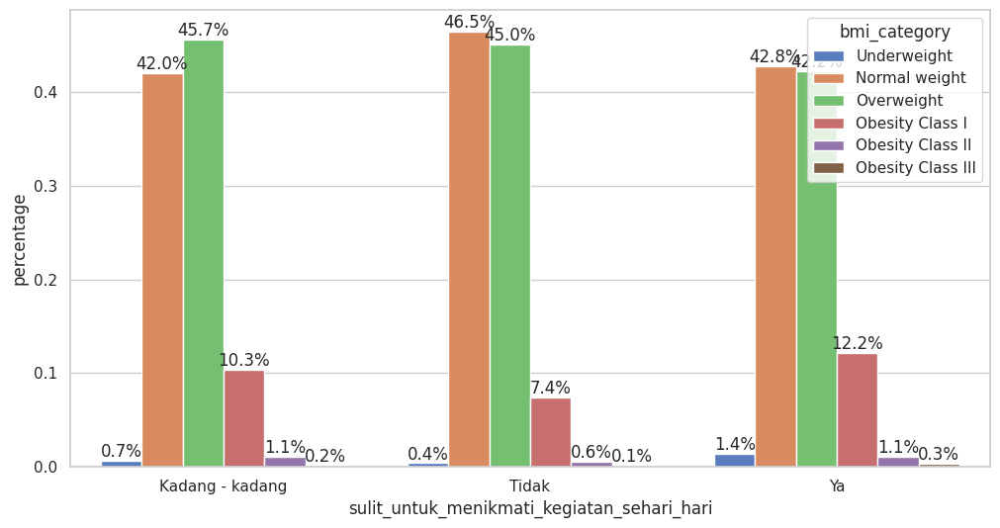

<Figure size 1200x600 with 0 Axes>

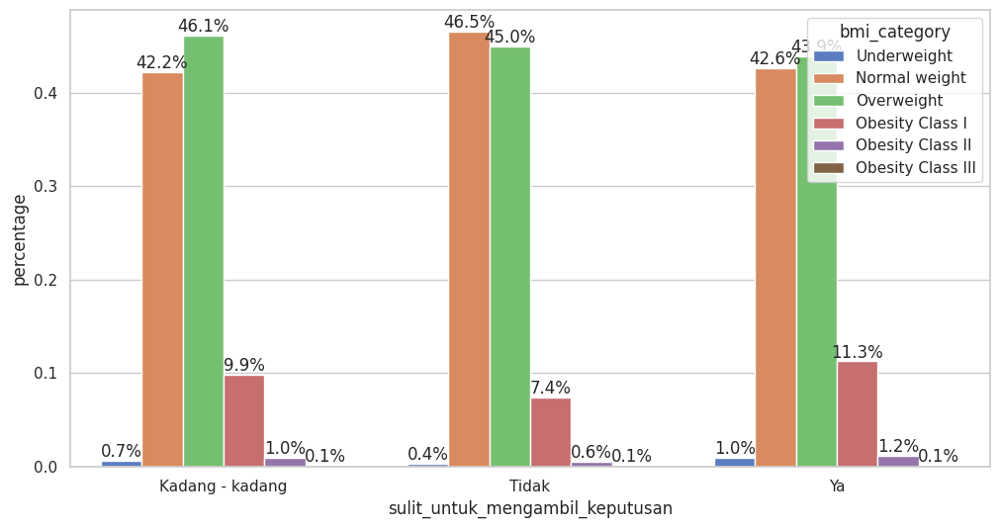

<Figure size 1200x600 with 0 Axes>

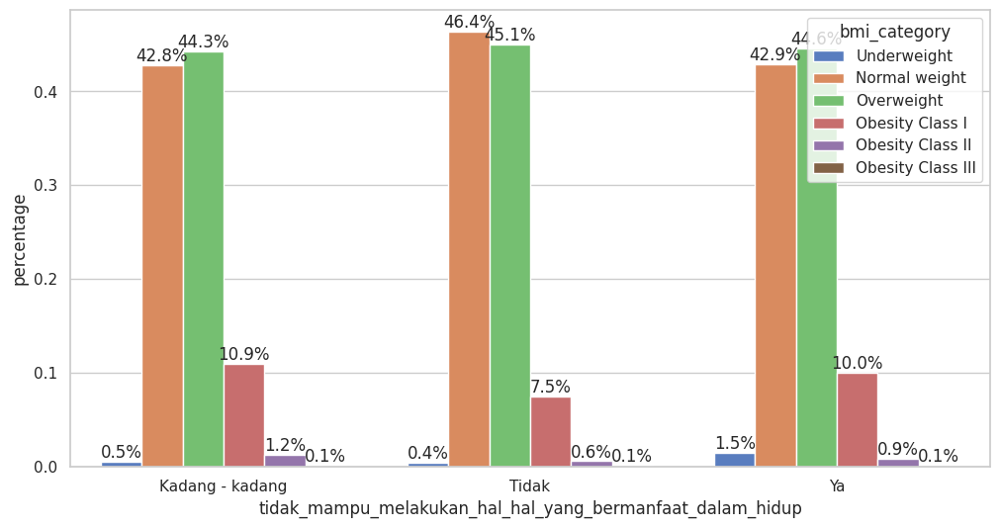

<Figure size 1200x600 with 0 Axes>

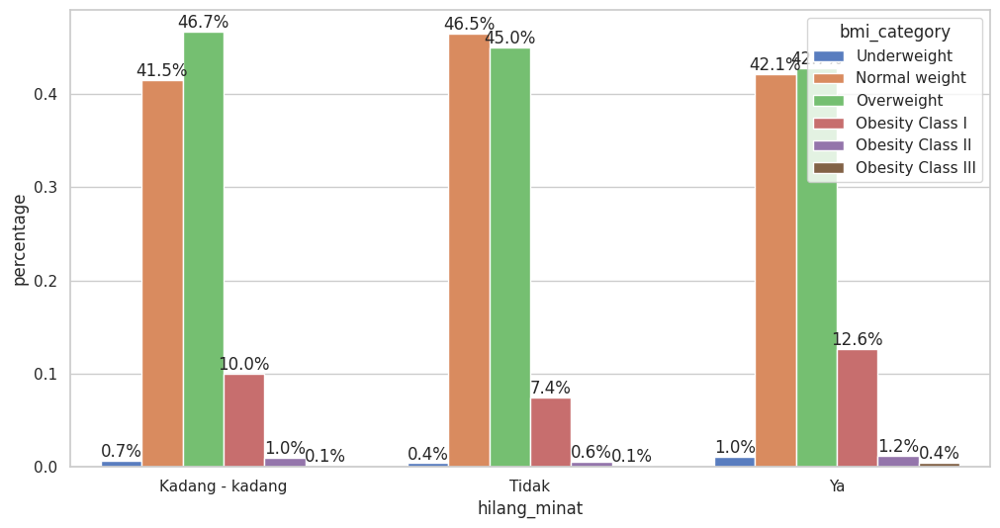

<Figure size 1200x600 with 0 Axes>

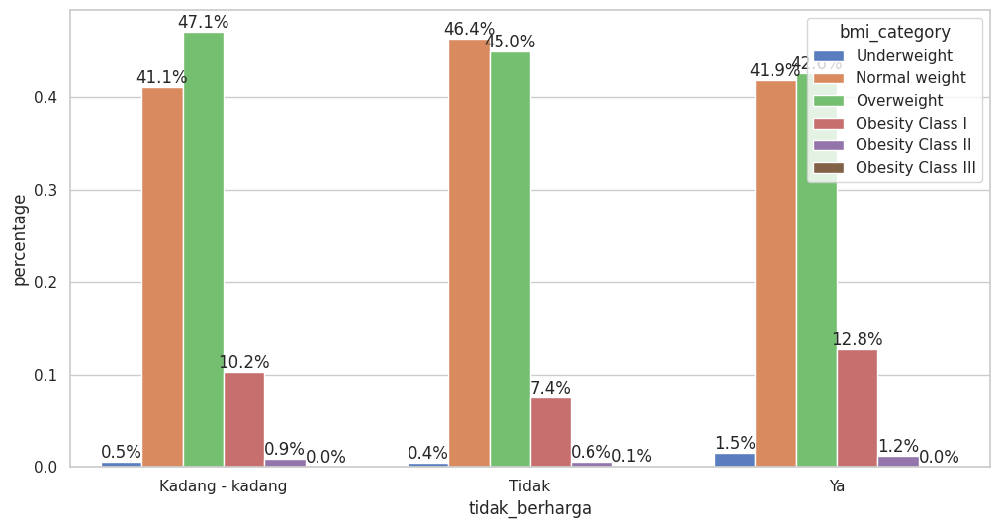

<Figure size 1200x600 with 0 Axes>

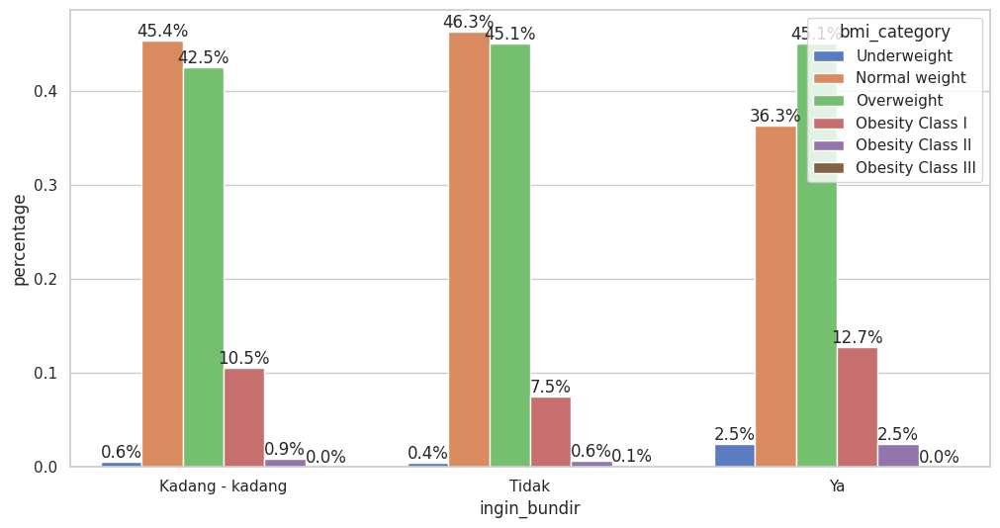

<Figure size 1200x600 with 0 Axes>

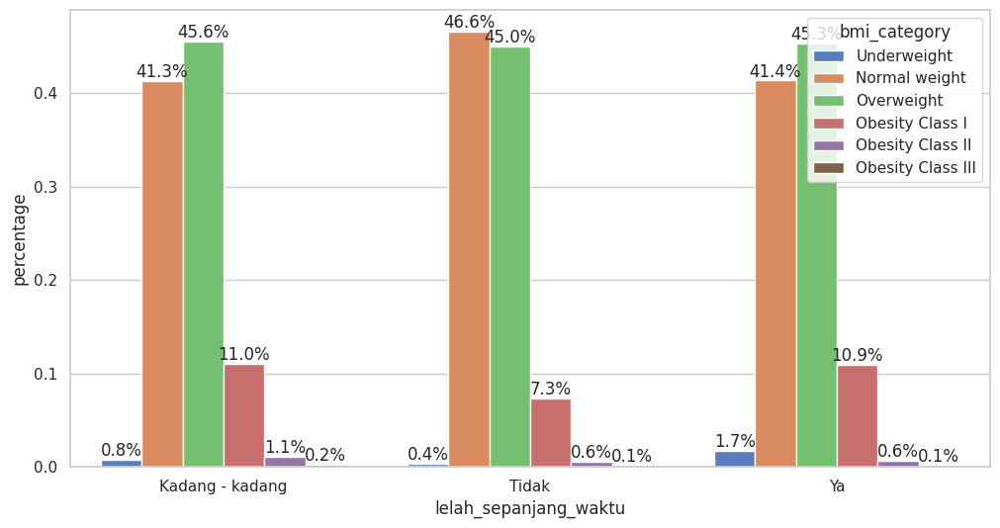

In [ ]:
for i in mental_health:
  barplot_prop_percent(x=i,
                     hue="bmi_category",
                     df=df,
                     size=(12, 6),
                     title="")
  print("")

### <h2> Variabel Numerikkah? </h2> ###

In [ ]:
num_col = ['usia', 'tinggi', 'berat', 'lama_berdinas']

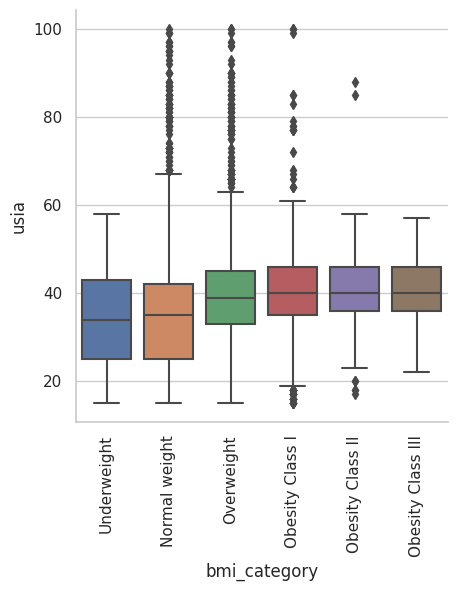

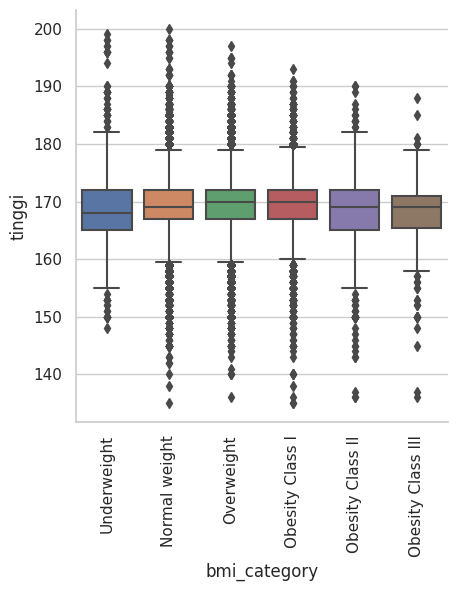

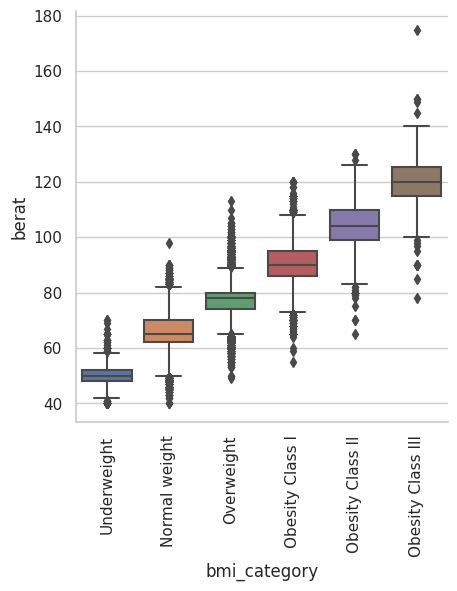

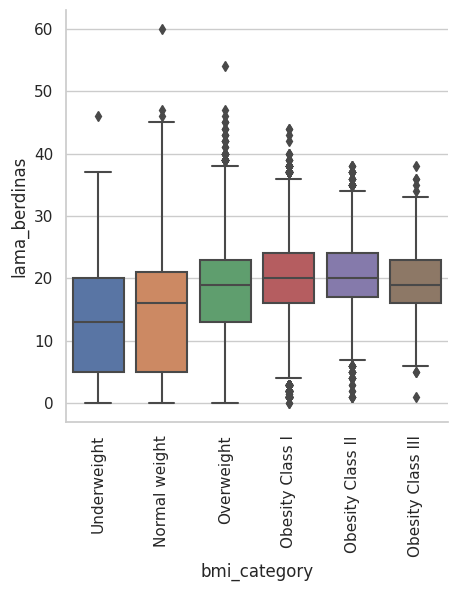

In [ ]:
for i in num_col:
  sns.catplot(x='bmi_category', y=i, data=df, kind="box")
  plt.xticks(rotation=90)
  plt.show()
  print("")

## <h2> Tips biar bisa nikah dong </h2> ##
---
Mencari dan menemukan karakteristik seseorang untuk di status kawin tertentu.

In [ ]:
df['jenis_kelamin'].value_counts()

LAKI - LAKI    266593
PEREMPUAN       22061
Name: jenis_kelamin, dtype: int64

In [ ]:
df_man = df.loc[df.loc[:, 'jenis_kelamin'] == 'LAKI - LAKI', :]
df_woman = df.loc[df.loc[:, 'jenis_kelamin'] == 'PEREMPUAN', :]

In [ ]:
df_man['status_kawin'].value_counts()

Menikah          214894
Belum Menikah     46714
Janda/Duda         4985
Name: status_kawin, dtype: int64

In [ ]:
df_woman['status_kawin'].value_counts()

Menikah          17611
Belum Menikah     3008
Janda/Duda        1442
Name: status_kawin, dtype: int64

### <h2> Variabel numerik </h2> ###

In [ ]:
num_col = ['usia', 'tinggi', 'berat', 'lama_berdinas']

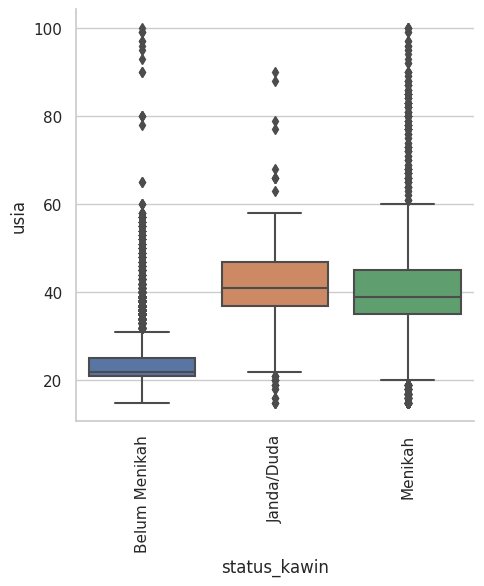

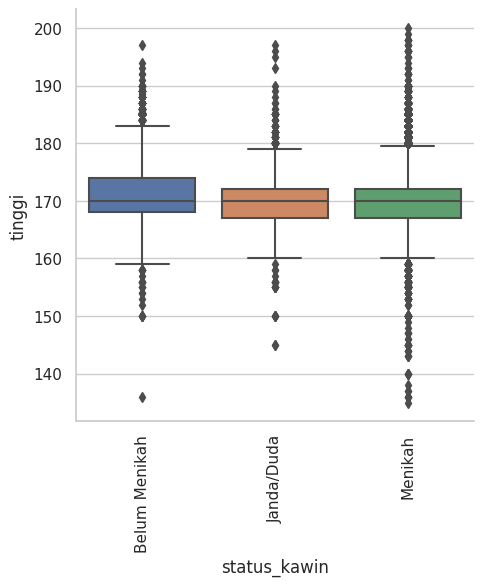

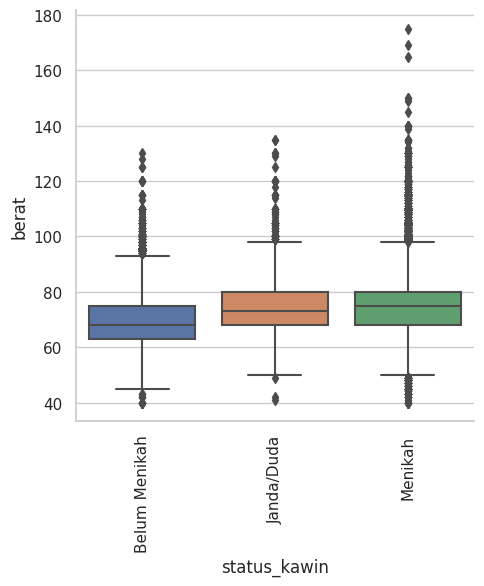

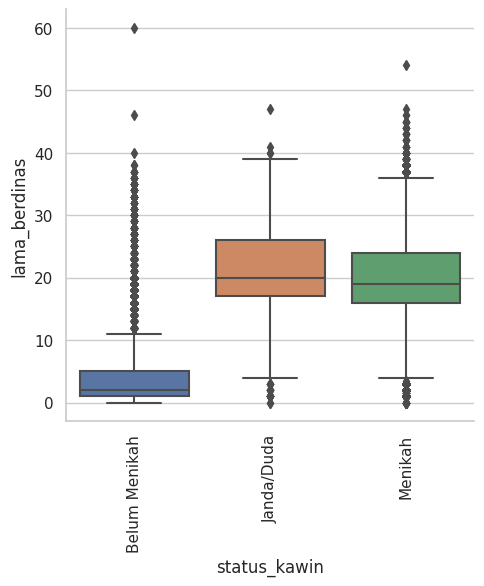

In [ ]:
for i in num_col:
  sns.catplot(x='status_kawin', y=i, data=df_man, kind="box")
  plt.xticks(rotation=90)
  plt.show()
  print("")

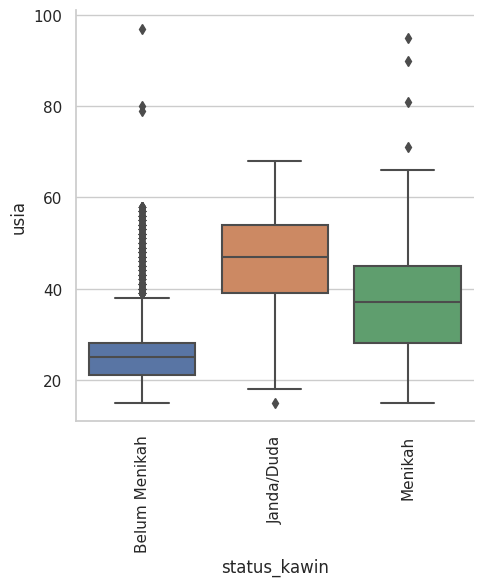

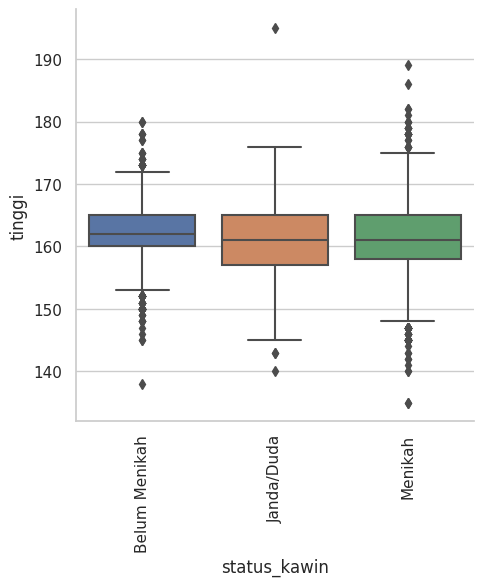

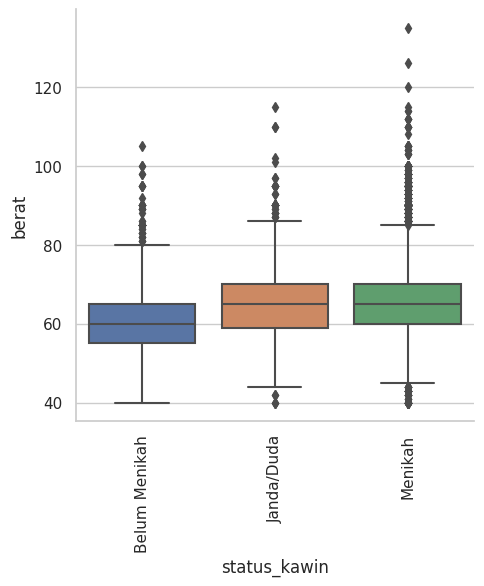

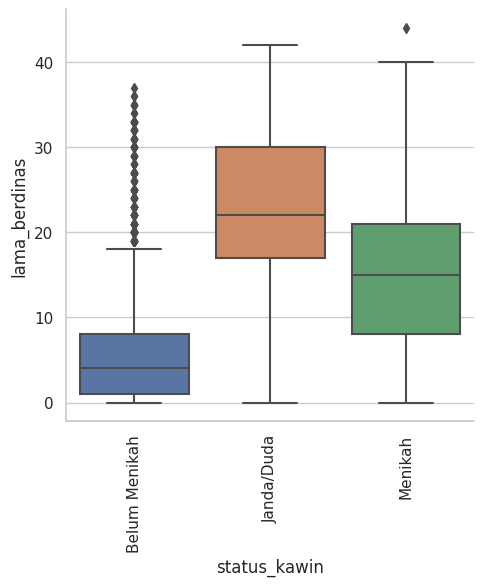

In [ ]:
for i in num_col:
  sns.catplot(x='status_kawin', y=i, data=df_woman, kind="box")
  plt.xticks(rotation=90)
  plt.show()
  print("")

In [ ]:
df_man.groupby('status_kawin')[num_col].agg(['mean', 'median'])

usia             tinggi             berat         \
                    mean median        mean median       mean median   
status_kawin                                                           
Belum Menikah  23.549592   22.0  171.272822  170.0  69.161005   68.0   
Janda/Duda     42.024880   41.0  169.872902  170.0  74.399402   73.0   
Menikah        39.861714   39.0  169.848441  170.0  74.790253   75.0   

              lama_berdinas         
                       mean median  
status_kawin                        
Belum Menikah      3.851839    2.0  
Janda/Duda        21.364950   20.0  
Menikah           19.367324   19.0

In [ ]:
df_woman.groupby('status_kawin')[num_col].agg(['mean', 'median'])

usia             tinggi             berat         \
                    mean median        mean median       mean median   
status_kawin                                                           
Belum Menikah  26.977394   25.0  162.253657  162.0  60.182580   60.0   
Janda/Duda     45.592926   47.0  160.495139  161.0  65.518763   65.0   
Menikah        37.370250   37.0  161.149770  161.0  65.521990   65.0   

              lama_berdinas         
                       mean median  
status_kawin                        
Belum Menikah      6.105409    4.0  
Janda/Duda        22.124118   22.0  
Menikah           15.601034   15.0

### <h2> Variabel kategorik </h2> ###

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 288654 entries, 1 to 289801
Data columns (total 81 columns):
 #   Column                                                     Non-Null Count   Dtype   
---  ------                                                     --------------   -----   
 0   wilayah                                                    288654 non-null  category
 1   jenis_kelamin                                              288654 non-null  category
 2   usia                                                       288611 non-null  float64 
 3   lama_berdinas                                              284243 non-null  float64 
 4   pendidikan                                                 288654 non-null  category
 5   tinggi                                                     288452 non-null  float64 
 6   berat                                                      288634 non-null  float64 
 7   lingkar_pinggang                                           288653 non-null

In [ ]:
more_habit = ['pendidikan', 'olahraga/minggu', 'minum_air', 'buah_sayur', 'mandi', 'durasi_mandi', 'konsumsi_gula_harian',
        'konsumsi_alkohol_harian', 'konsumsi_junk_food_harian', 'frekuensi_menggosok_gigi_per_hari',
        'durasi_menggosok_gigi', 'frekuensi_ganti_pakaian_dalam_per_hari',
        'cuci_tangan_sebelum_makan', 'merokok']

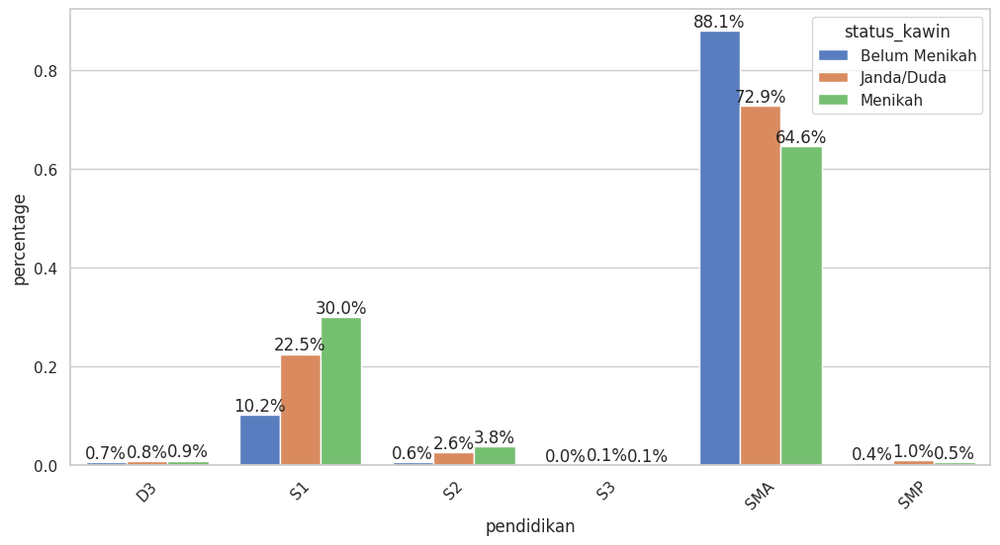

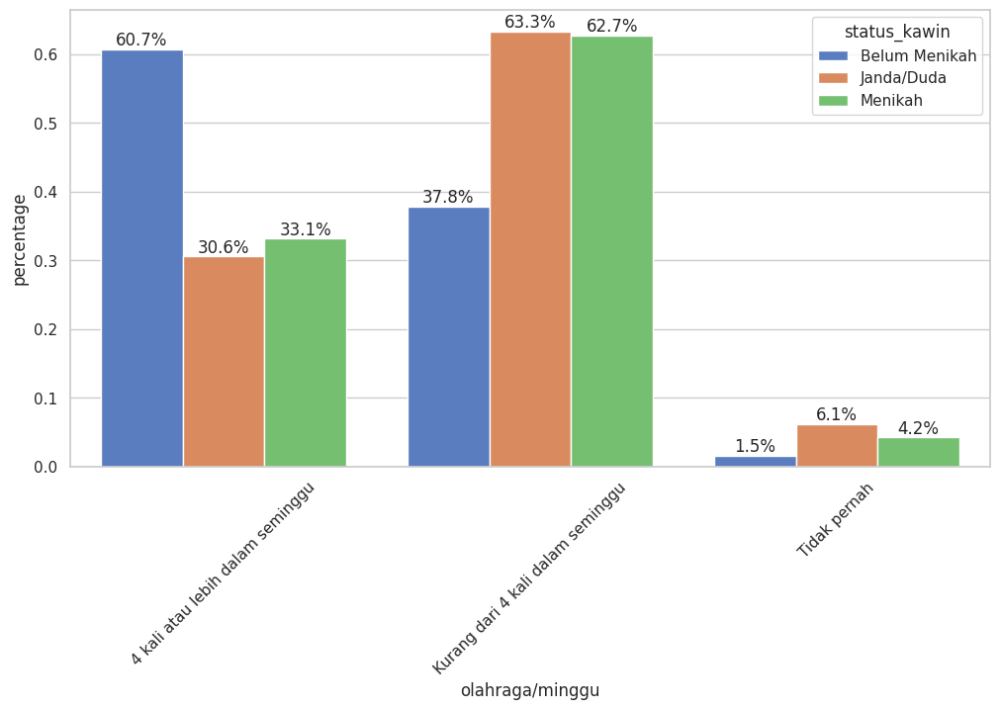

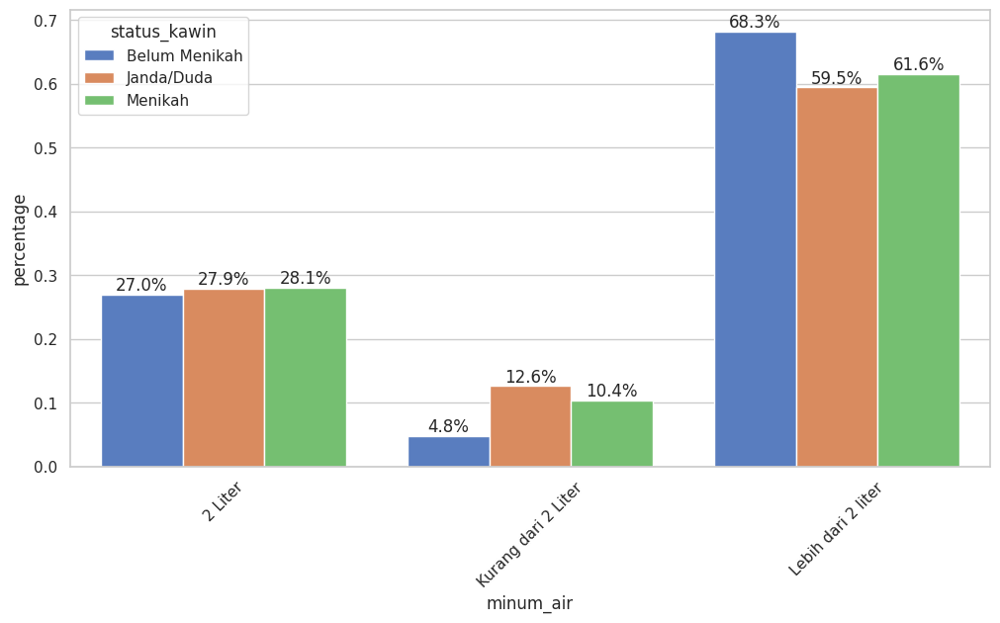

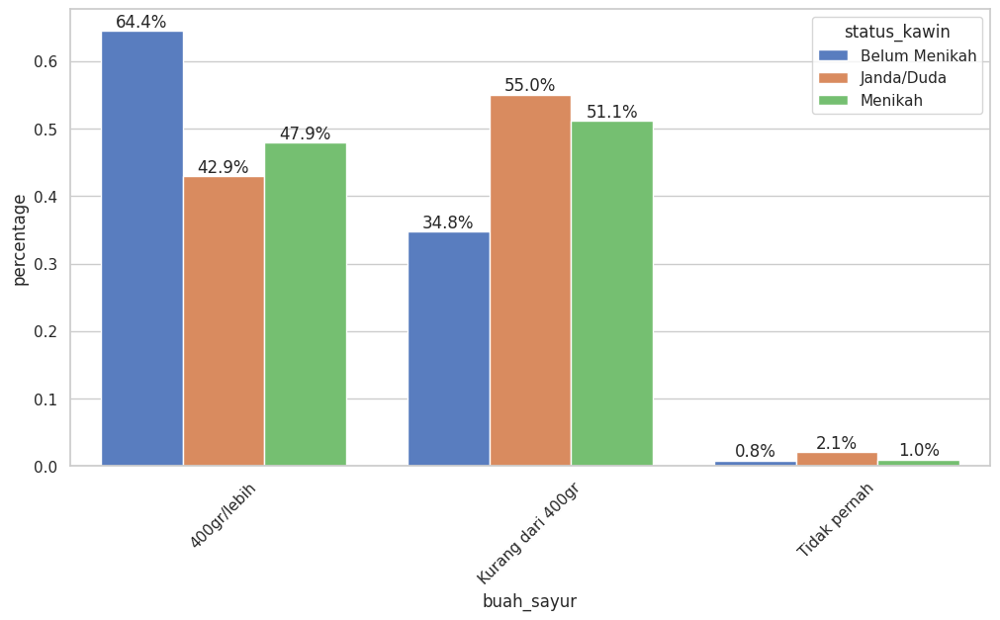

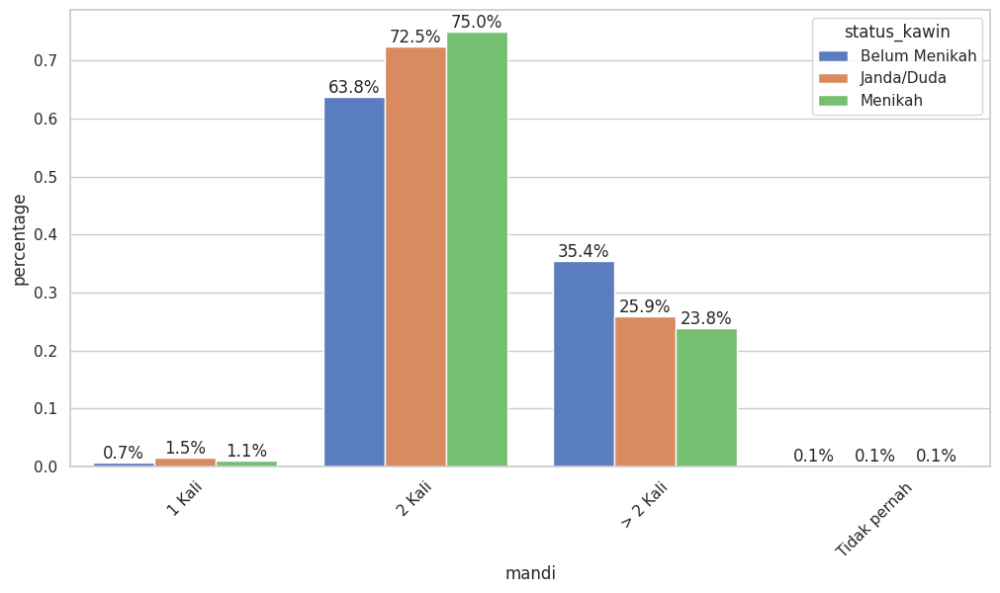

...

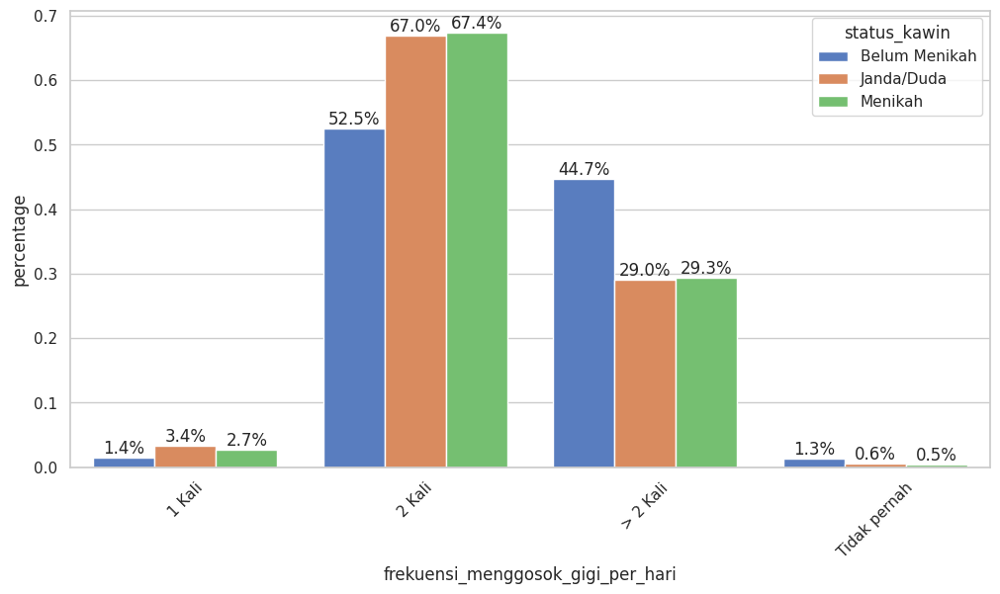

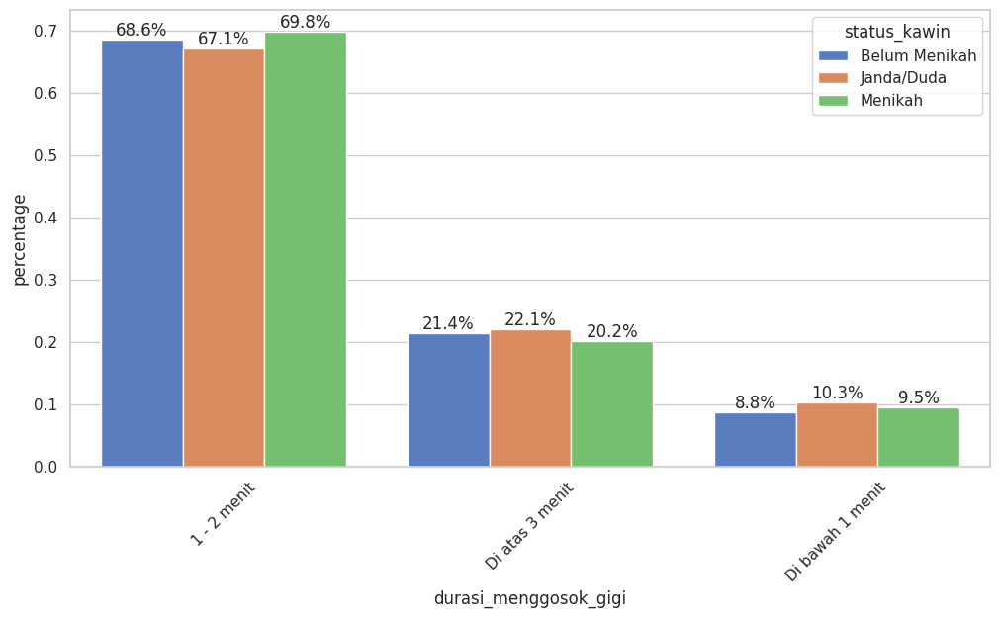

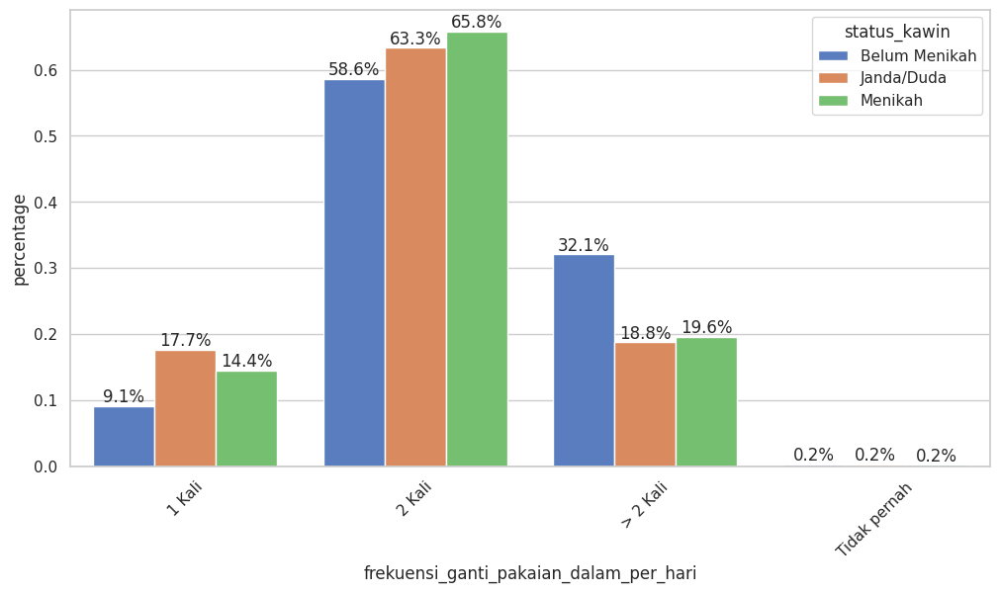

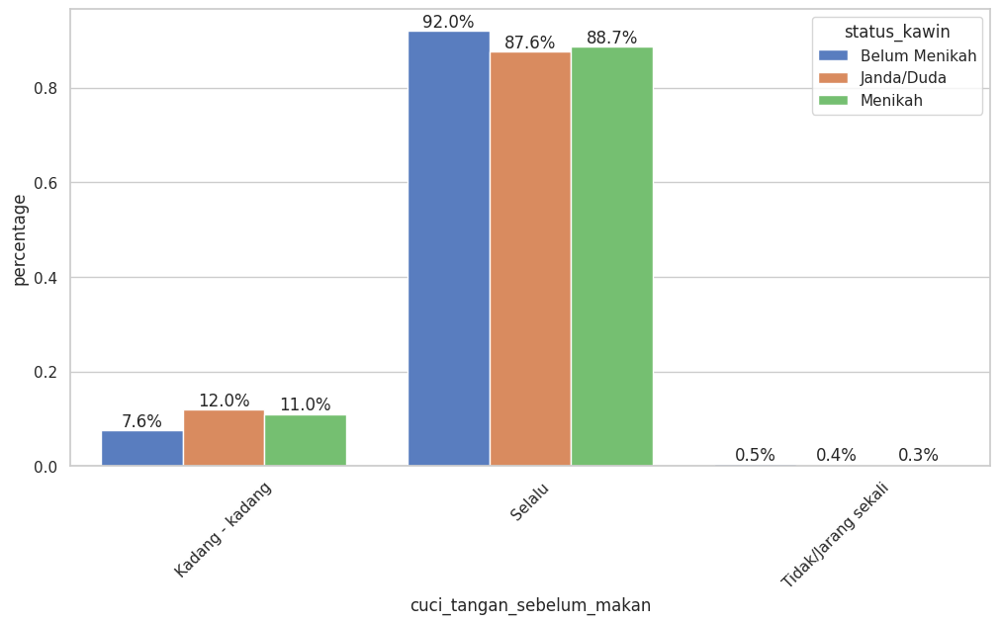

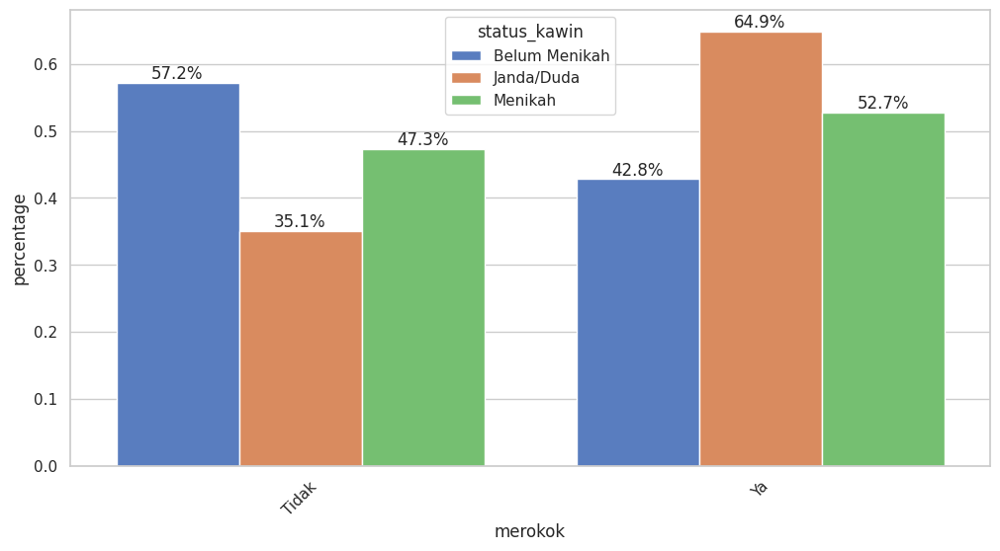

In [ ]:
for i in more_habit:
  barplot_prop_percent_hue(x=i,
                     hue="status_kawin",
                     df=df_man,
                     size=(12, 6),
                     title="")
  print("")

<Figure size 1200x600 with 0 Axes>

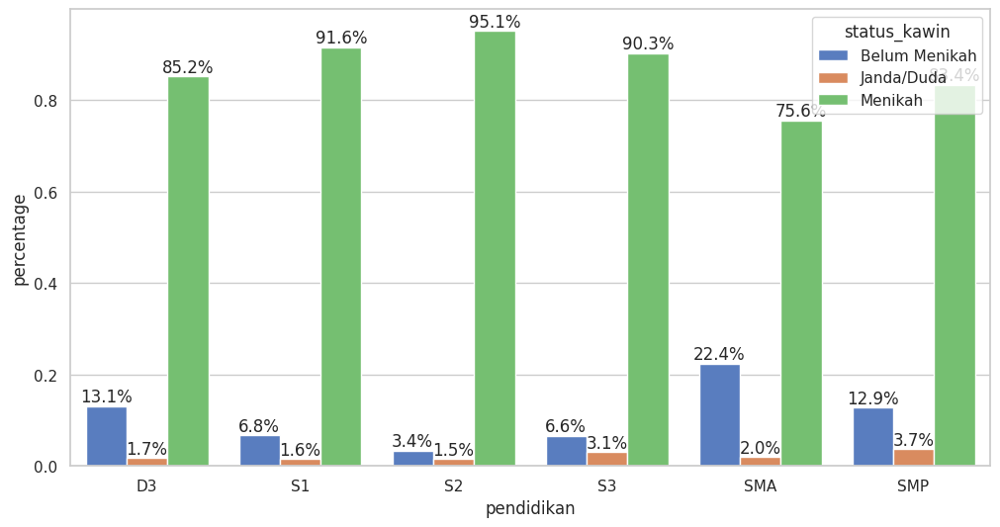

<Figure size 1200x600 with 0 Axes>

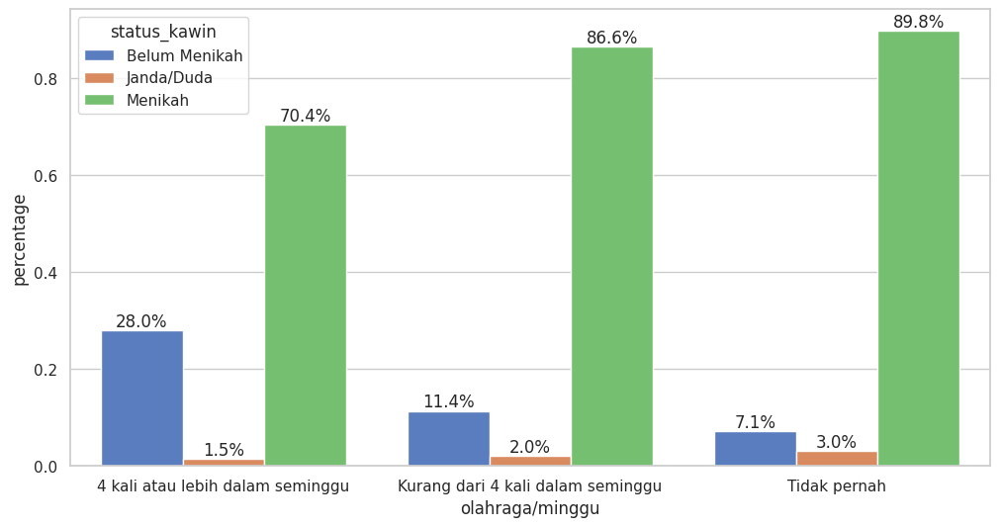

<Figure size 1200x600 with 0 Axes>

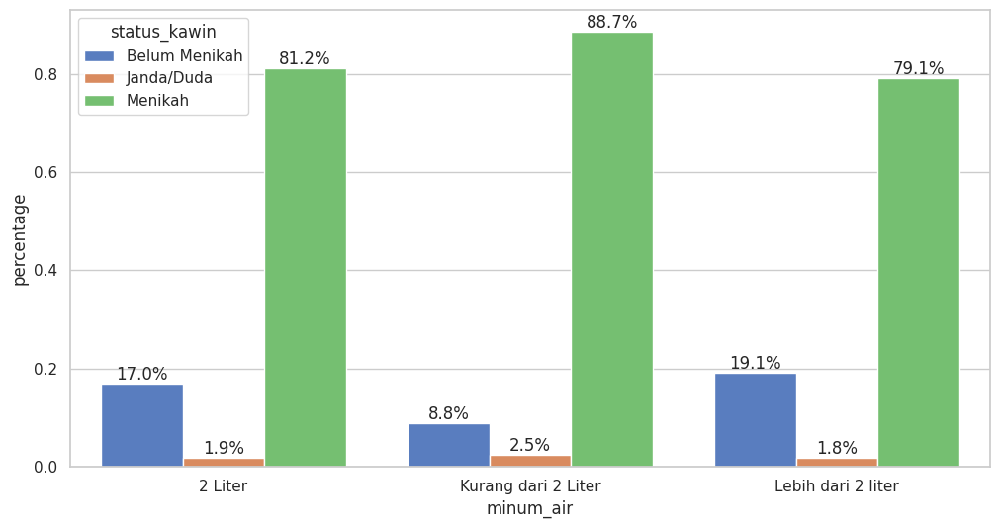

<Figure size 1200x600 with 0 Axes>

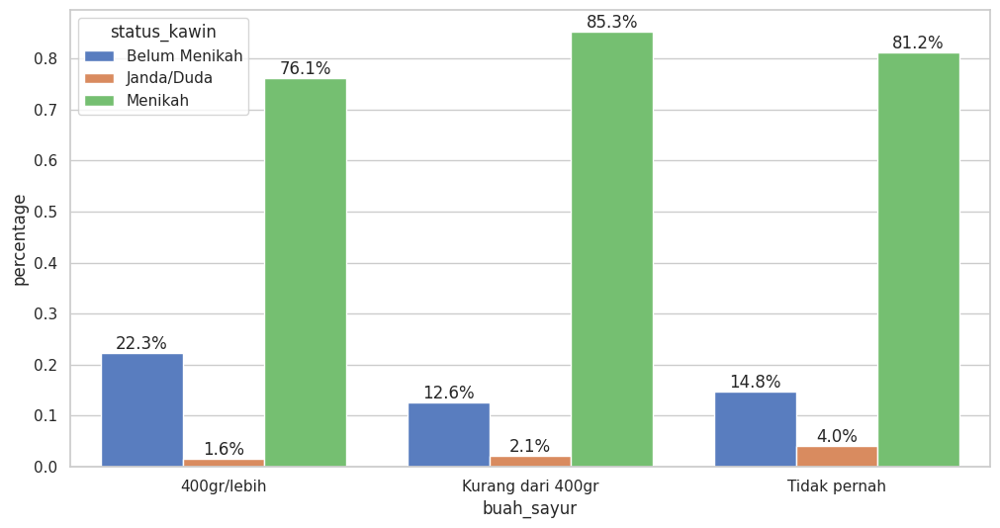

<Figure size 1200x600 with 0 Axes>

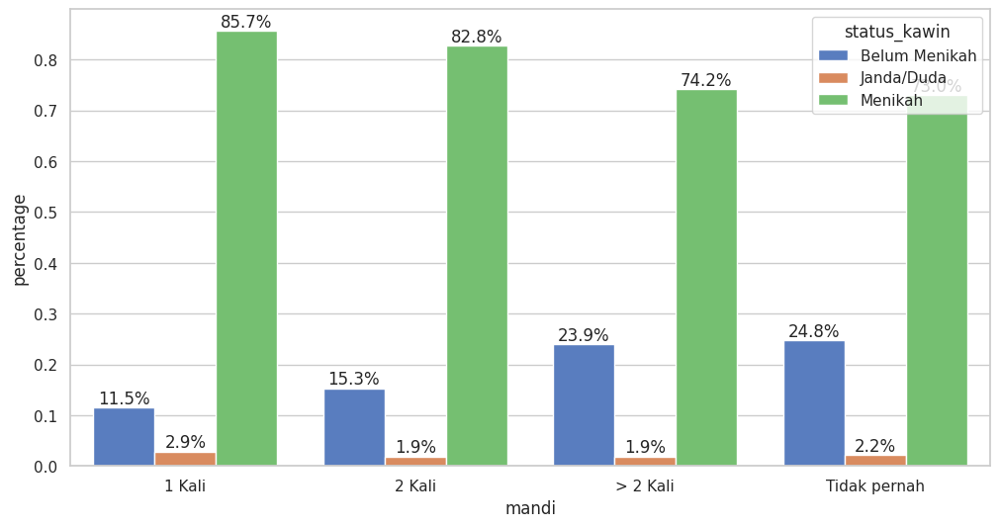

<Figure size 1200x600 with 0 Axes>

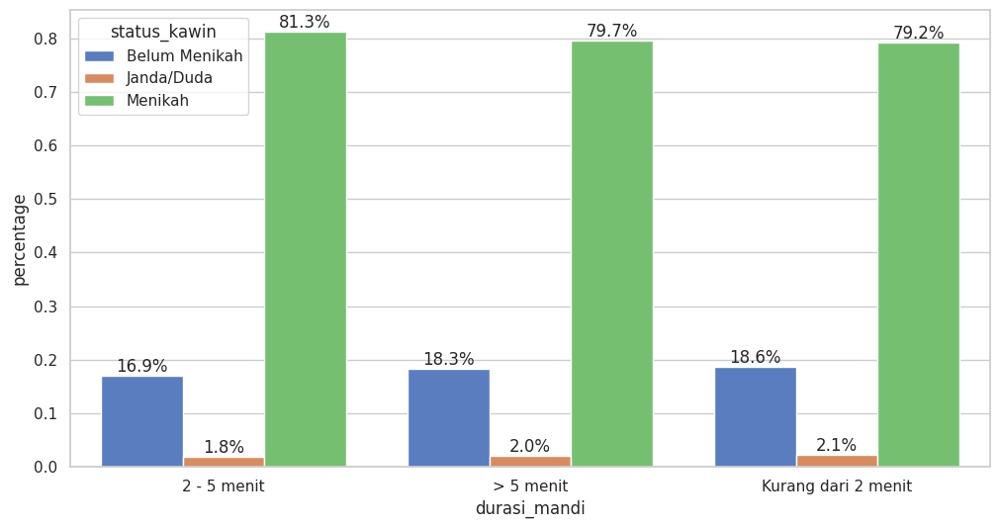

<Figure size 1200x600 with 0 Axes>

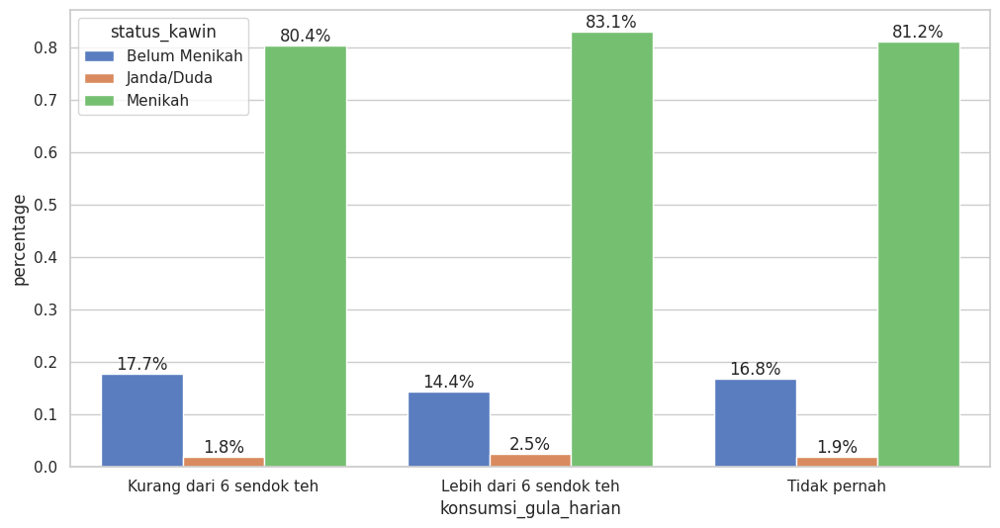

<Figure size 1200x600 with 0 Axes>

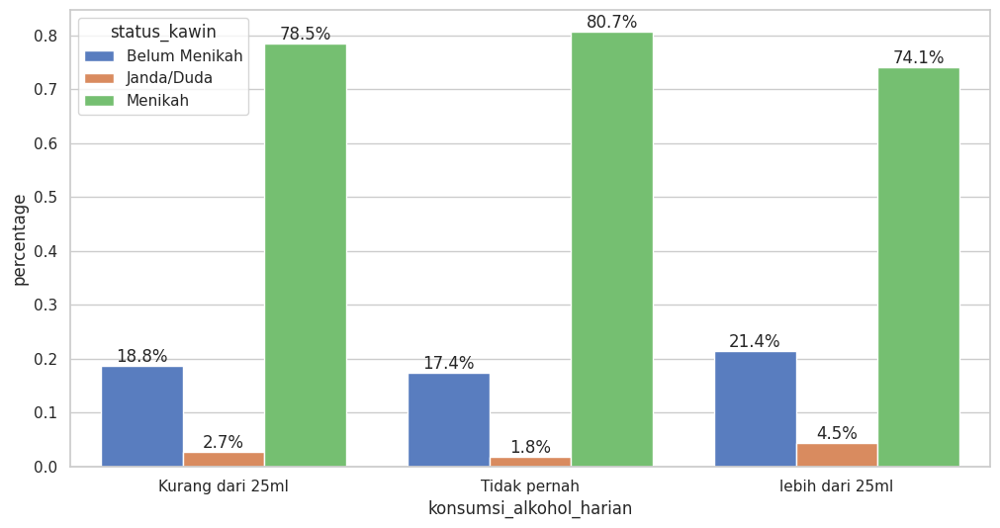

<Figure size 1200x600 with 0 Axes>

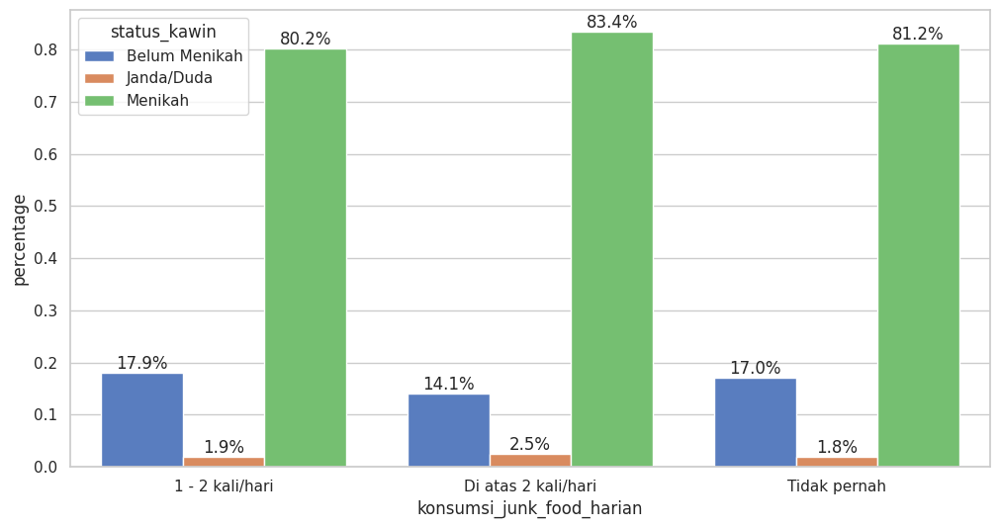

<Figure size 1200x600 with 0 Axes>

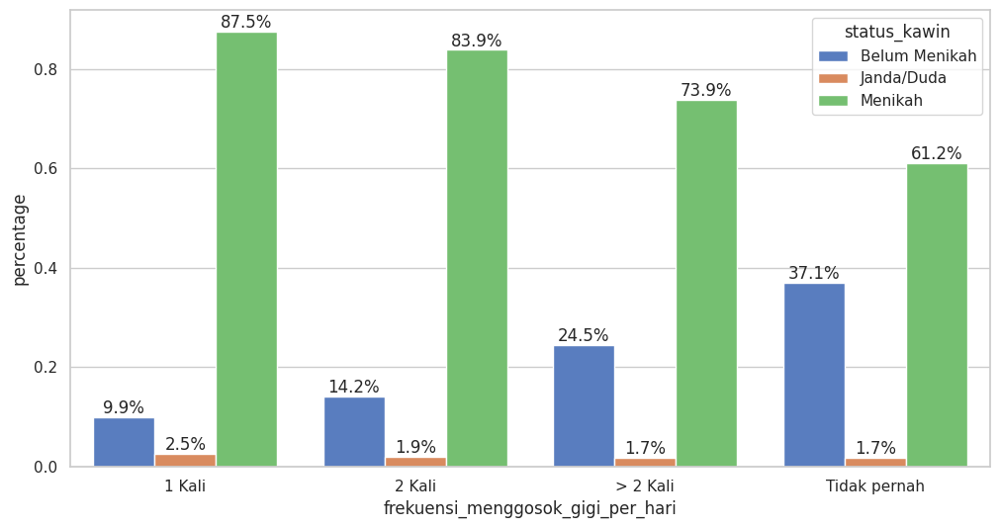

<Figure size 1200x600 with 0 Axes>

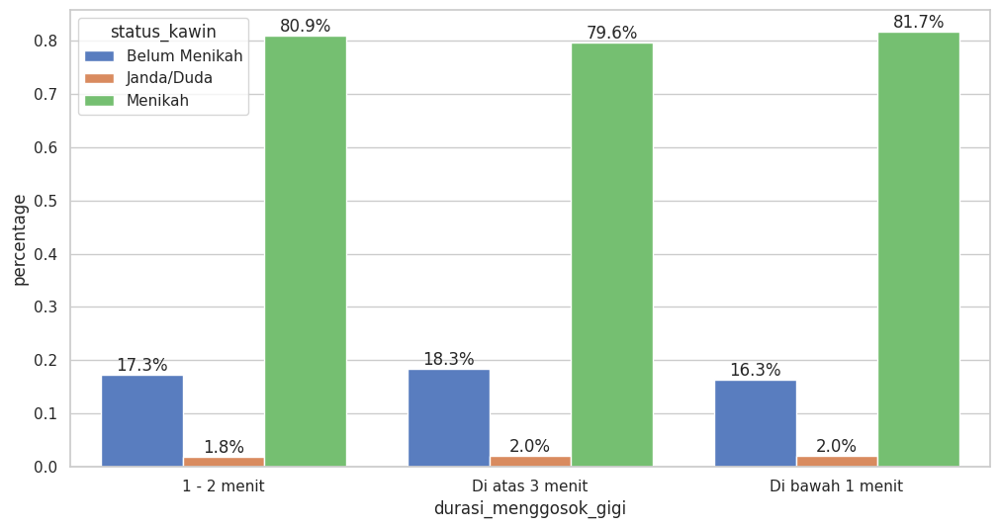

<Figure size 1200x600 with 0 Axes>

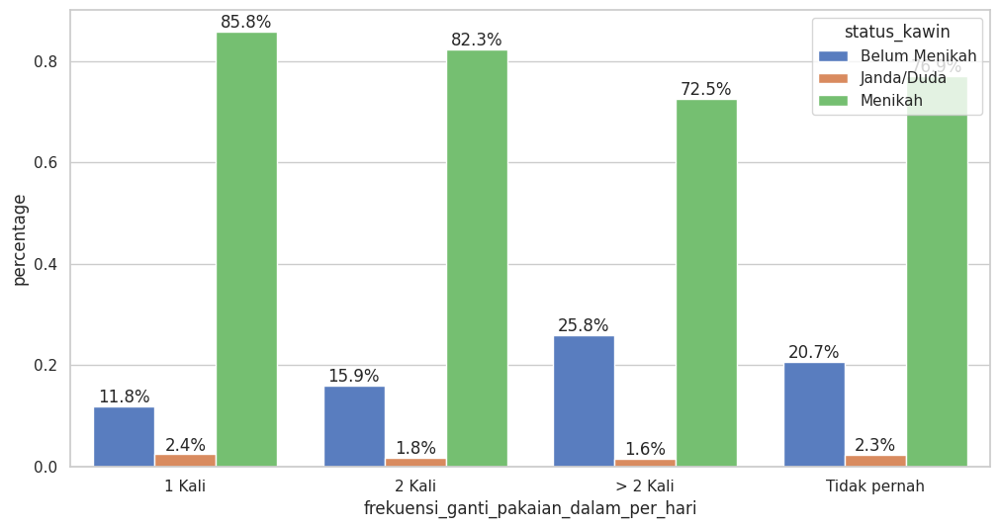

<Figure size 1200x600 with 0 Axes>

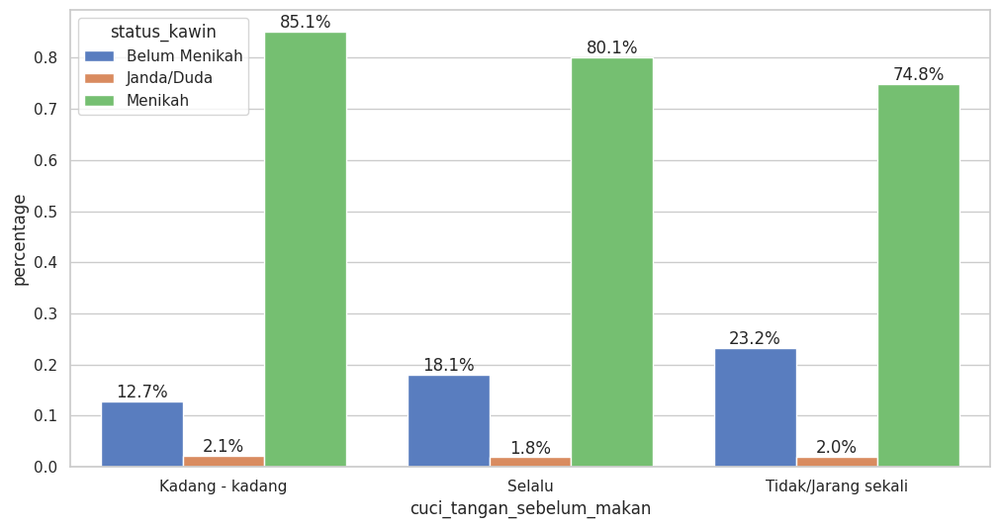

<Figure size 1200x600 with 0 Axes>

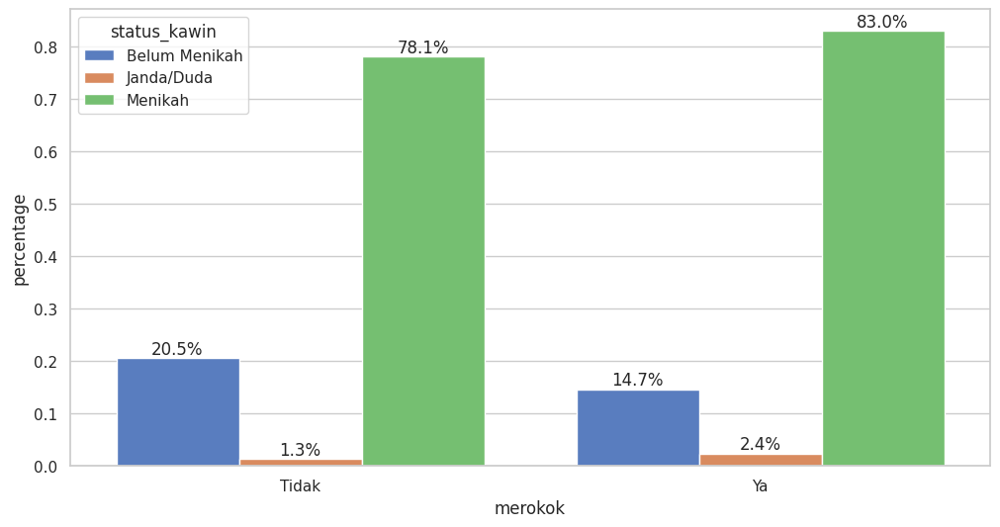

In [ ]:
for i in more_habit:
  barplot_prop_percent(x=i,
                     hue="status_kawin",
                     df=df_man,
                     size=(12, 6),
                     title="")
  print("")

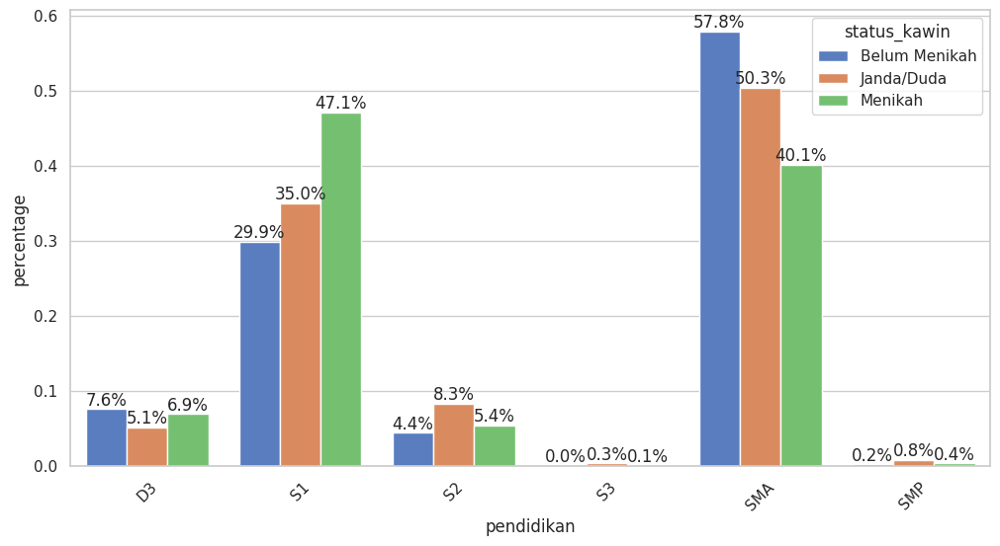

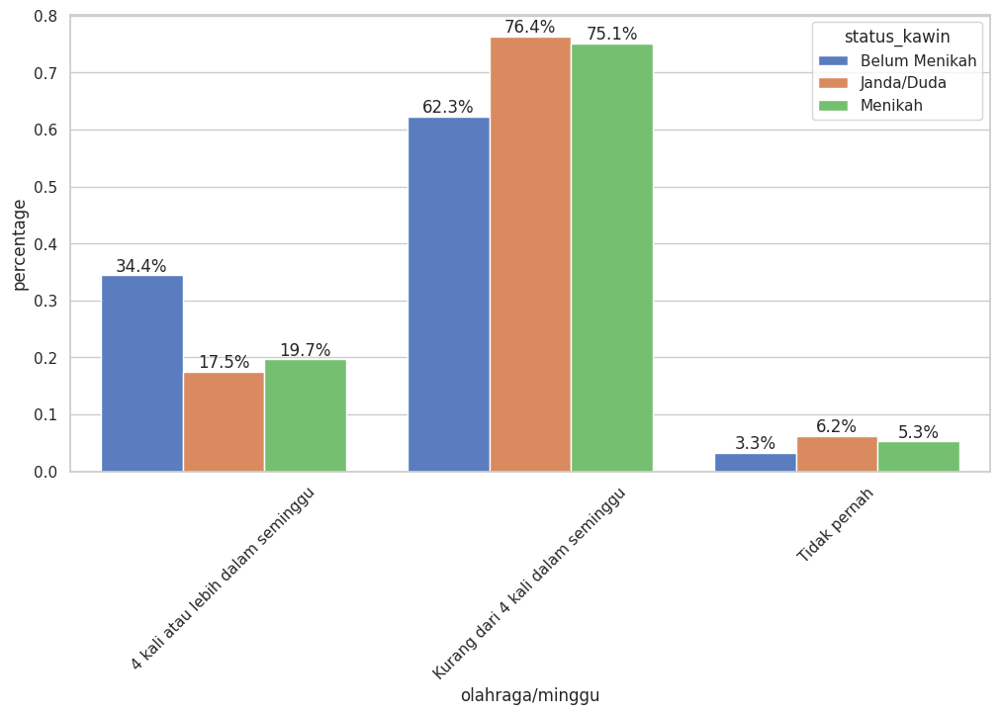

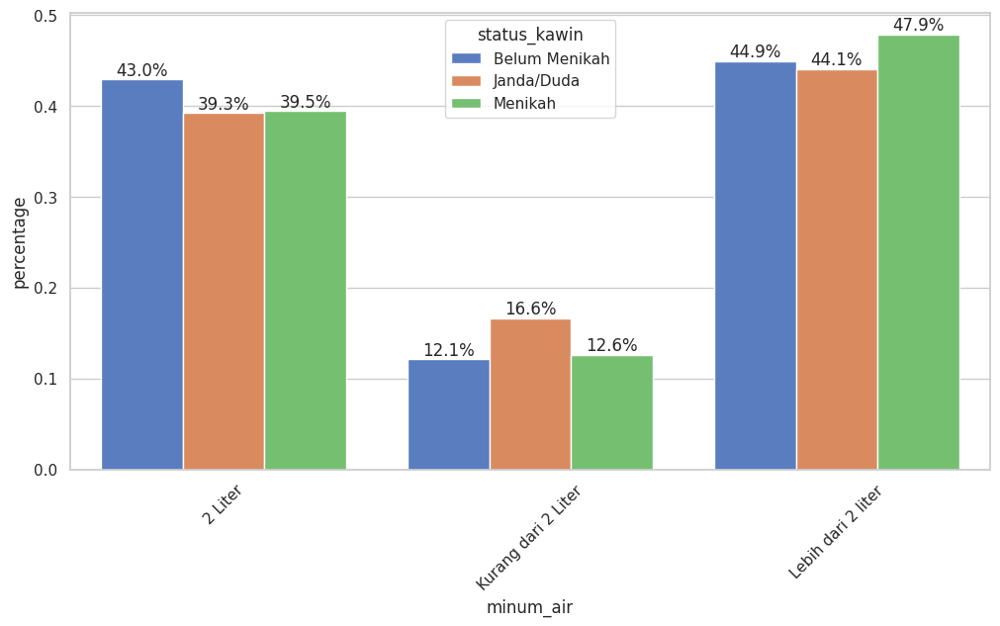

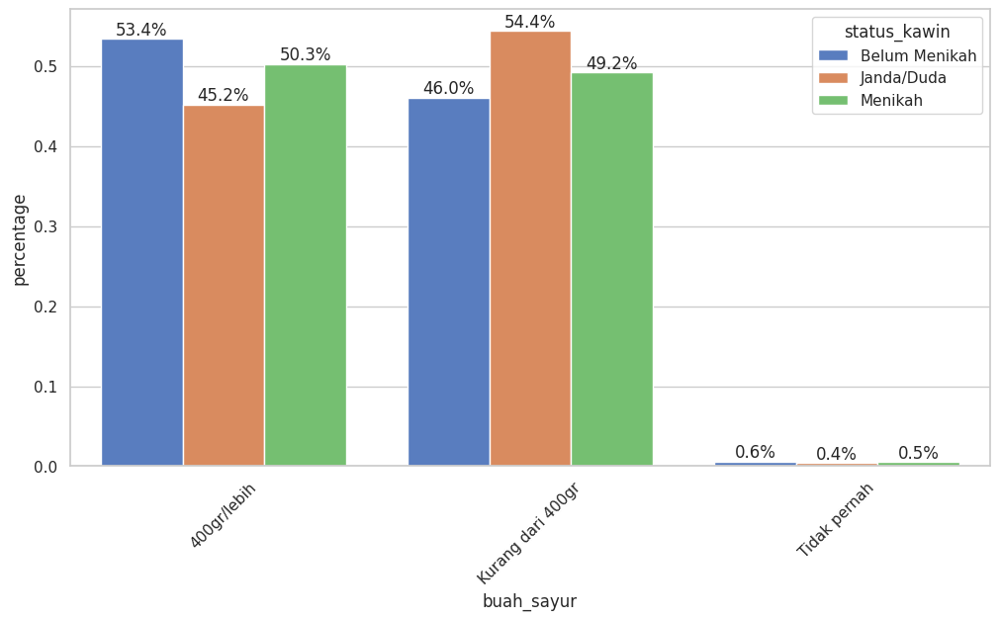

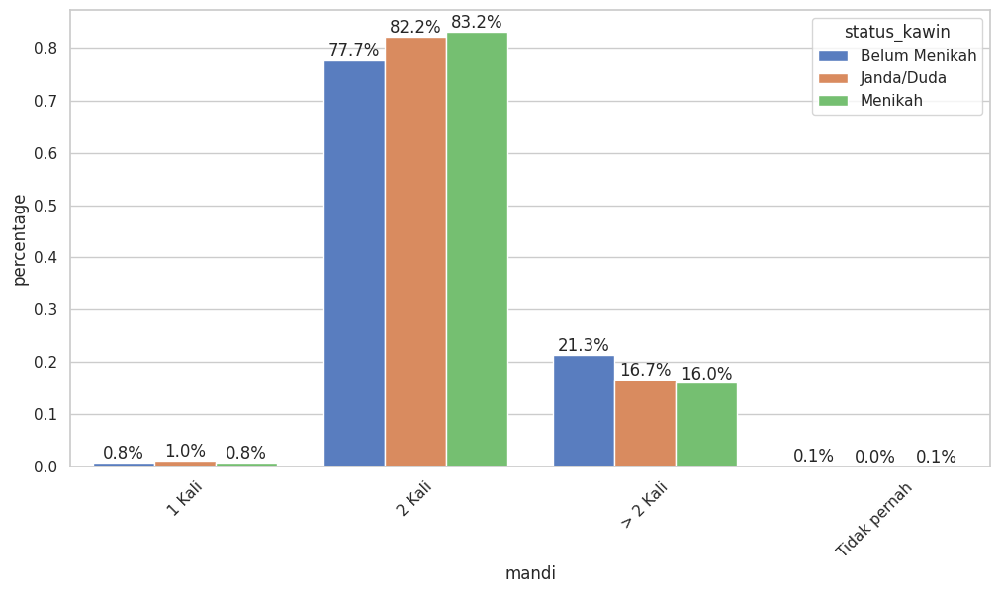

...

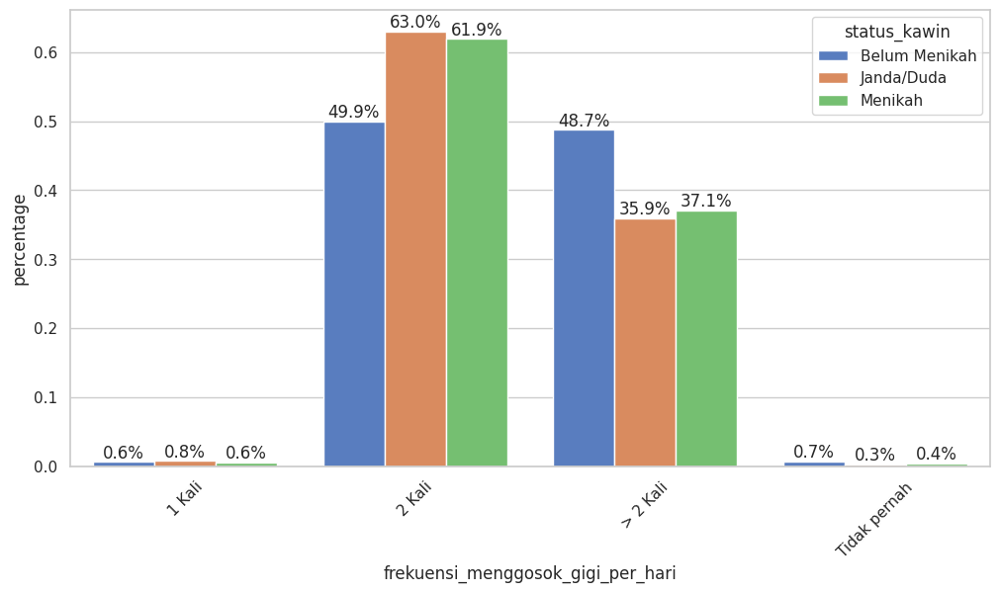

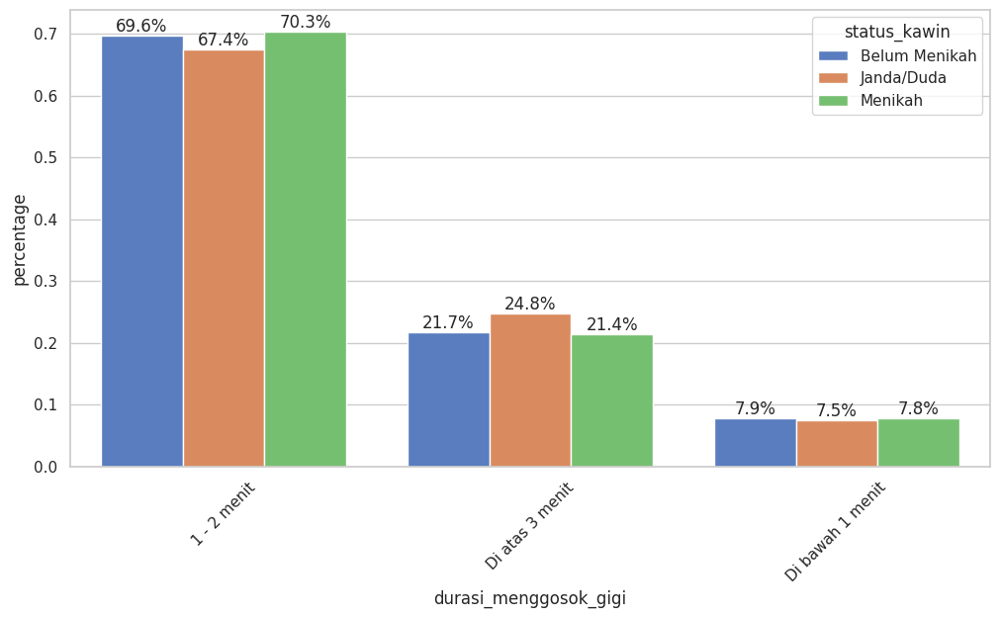

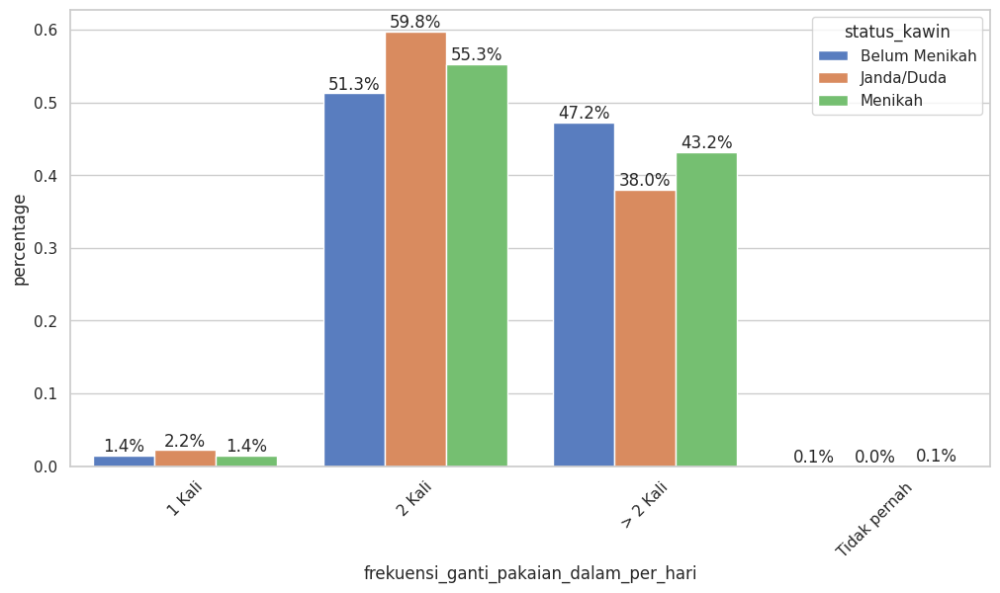

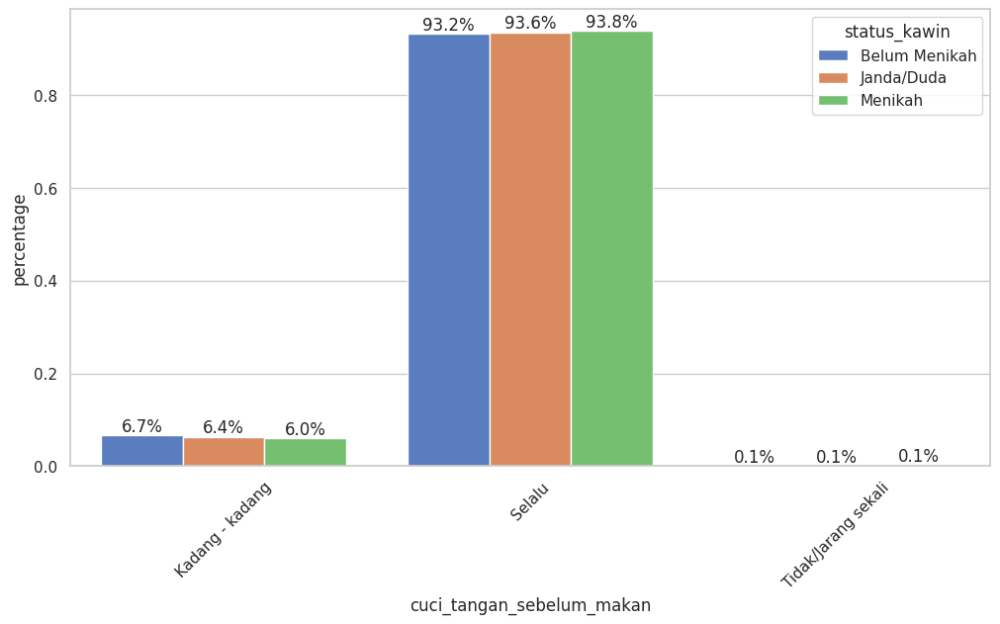

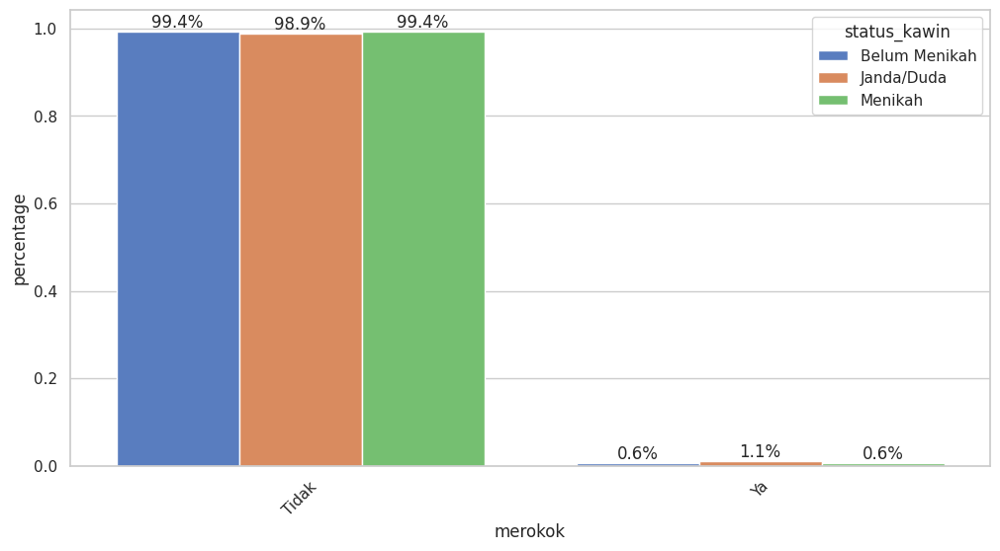

In [ ]:
for i in more_habit:
  barplot_prop_percent_hue(x=i,
                     hue="status_kawin",
                     df=df_woman,
                     size=(12, 6),
                     title="")
  print("")

<Figure size 1200x600 with 0 Axes>

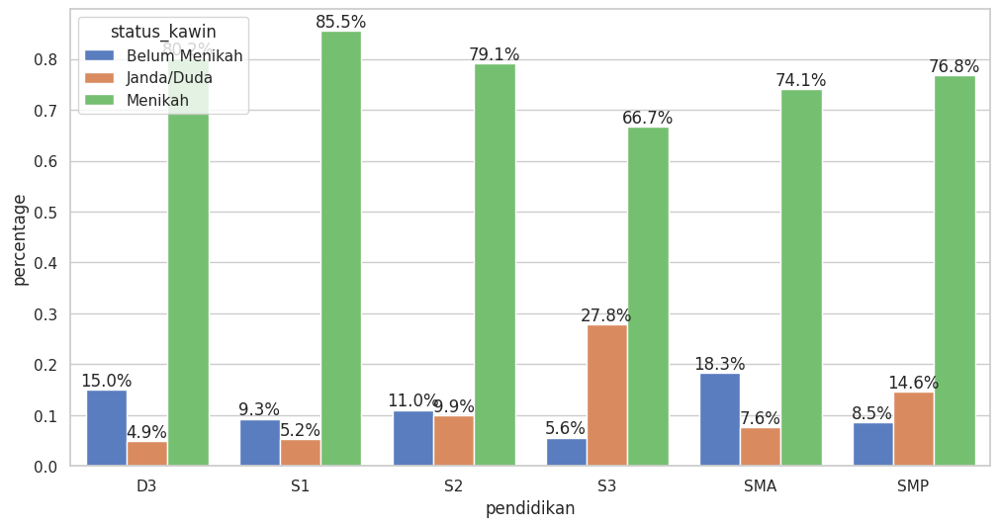

<Figure size 1200x600 with 0 Axes>

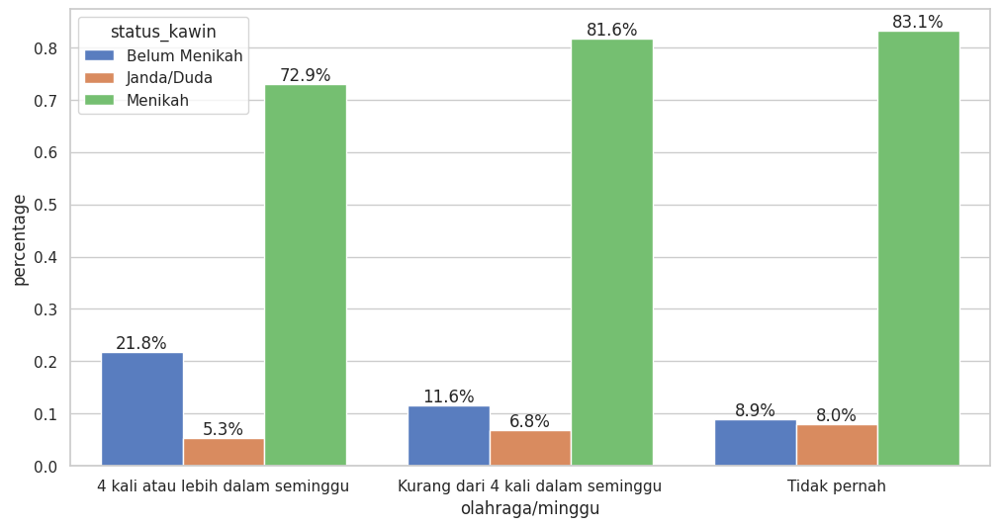

<Figure size 1200x600 with 0 Axes>

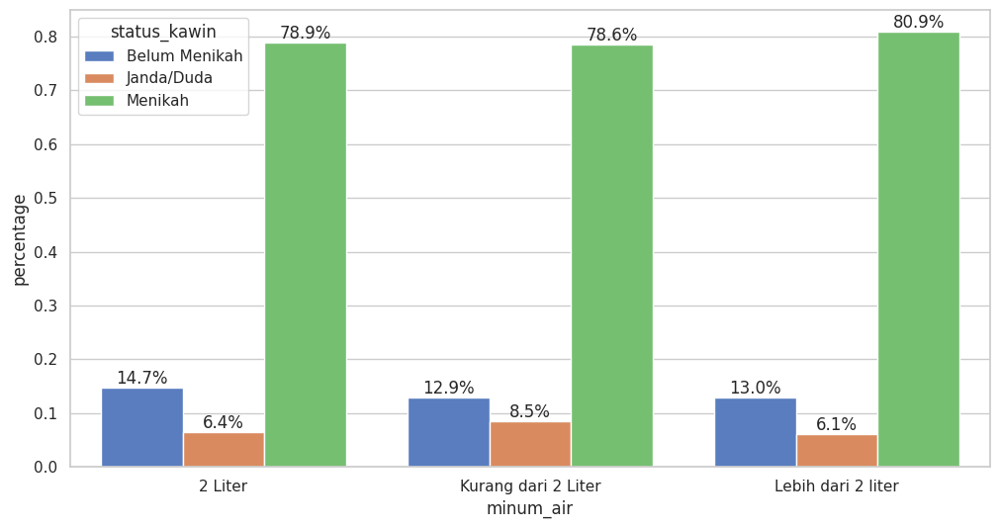

<Figure size 1200x600 with 0 Axes>

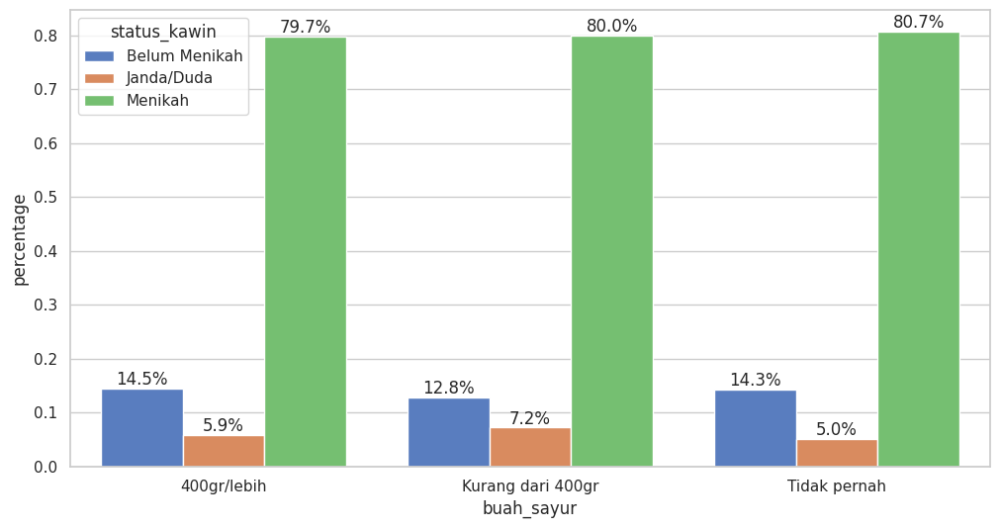

<Figure size 1200x600 with 0 Axes>

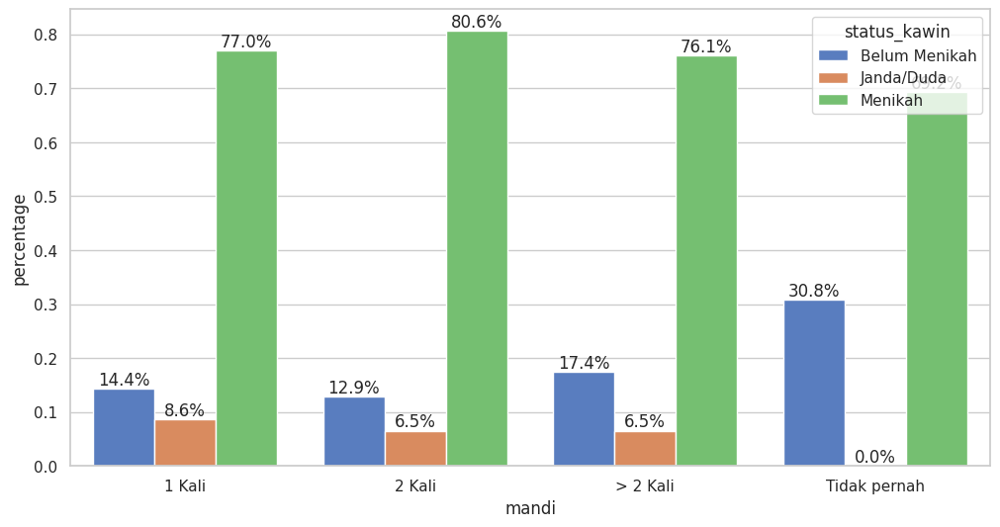

<Figure size 1200x600 with 0 Axes>

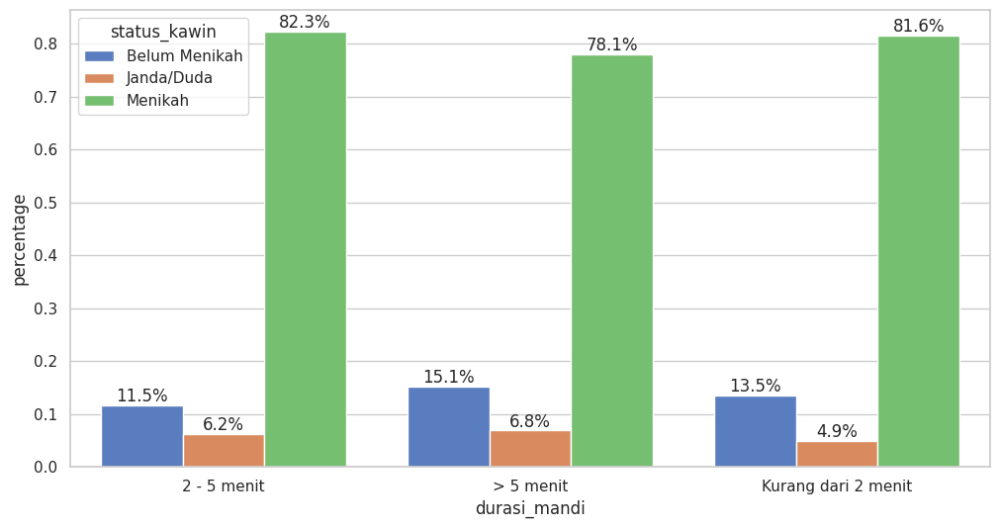

<Figure size 1200x600 with 0 Axes>

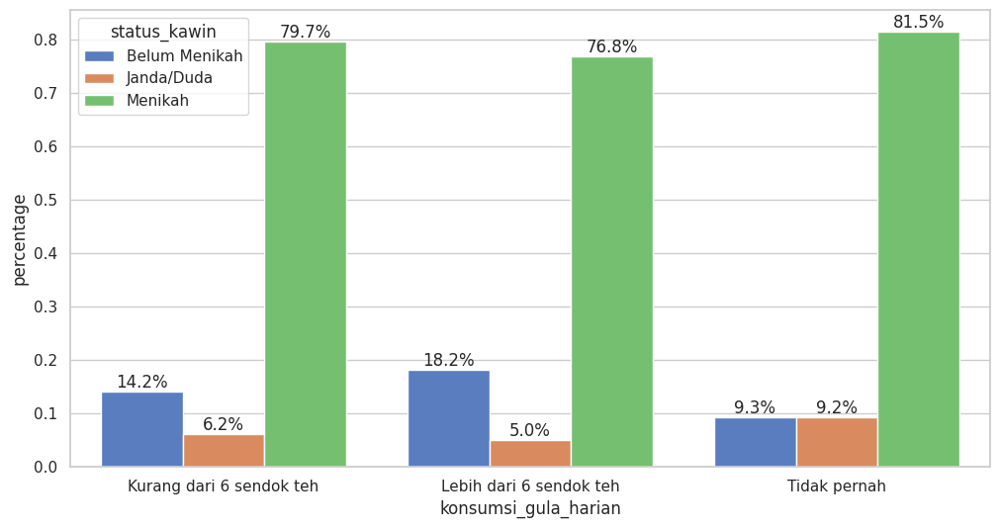

<Figure size 1200x600 with 0 Axes>

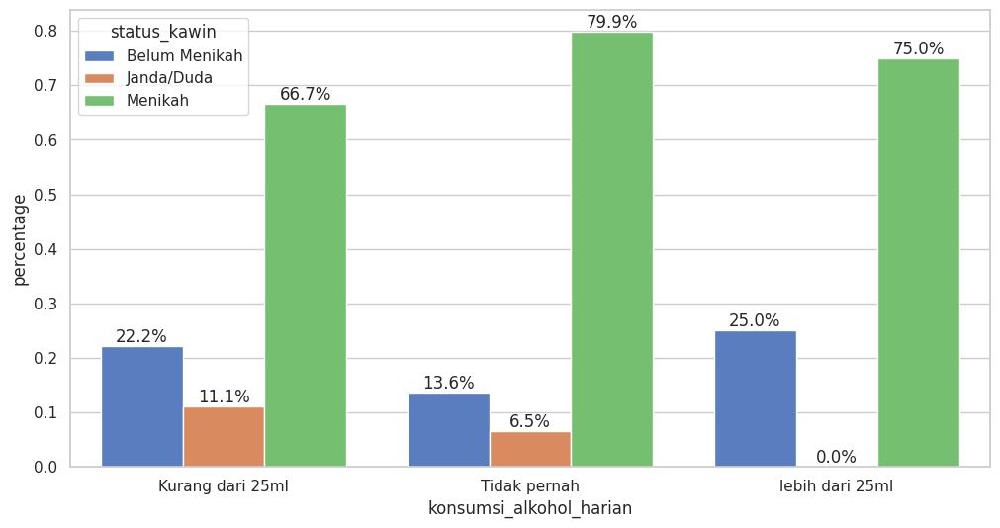

<Figure size 1200x600 with 0 Axes>

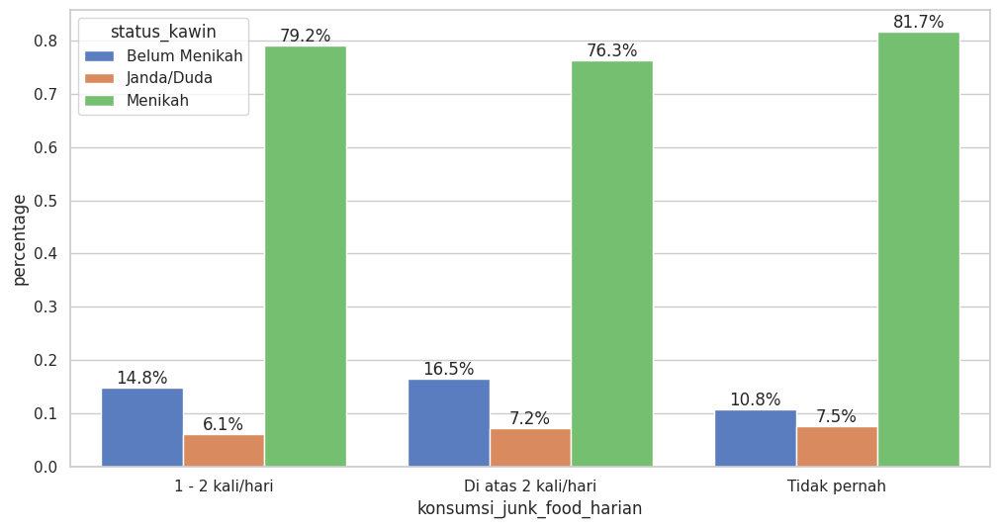

<Figure size 1200x600 with 0 Axes>

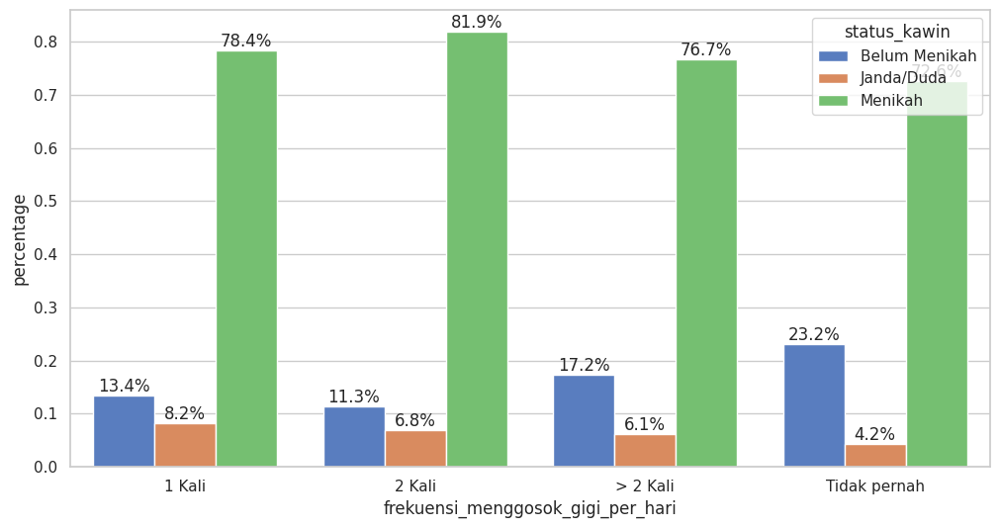

<Figure size 1200x600 with 0 Axes>

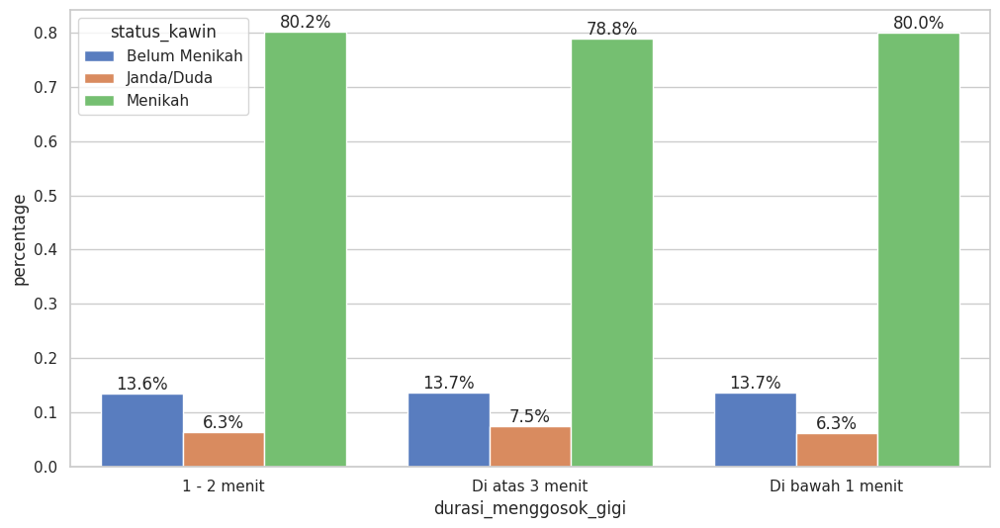

<Figure size 1200x600 with 0 Axes>

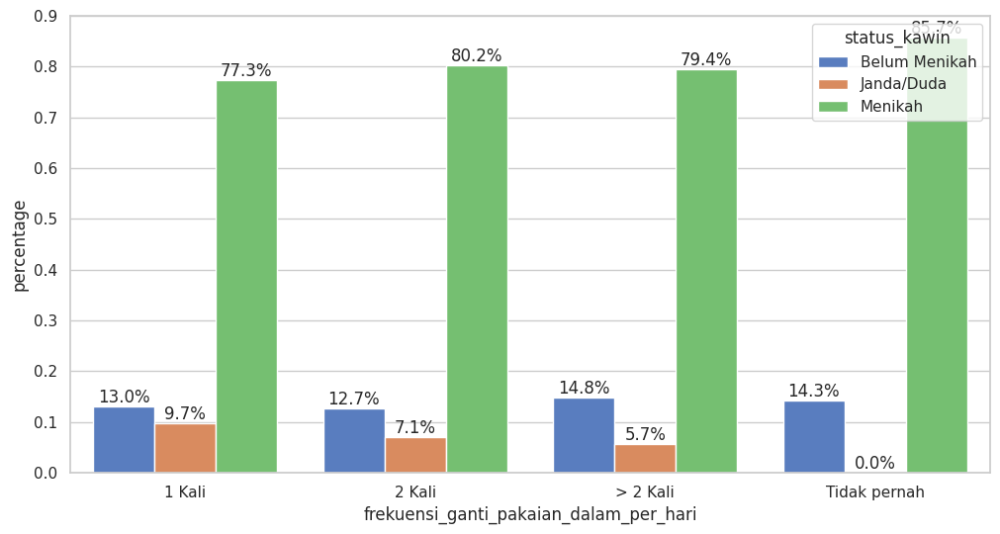

<Figure size 1200x600 with 0 Axes>

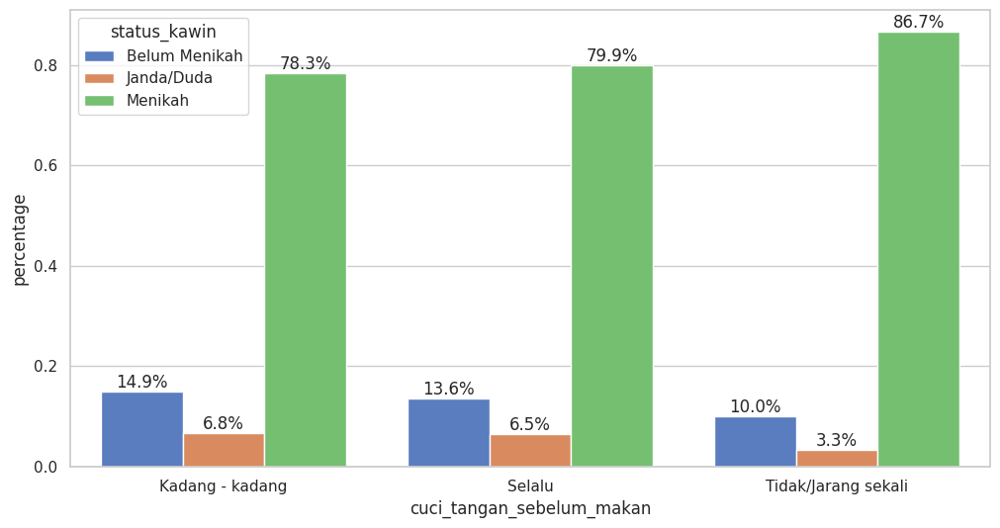

<Figure size 1200x600 with 0 Axes>

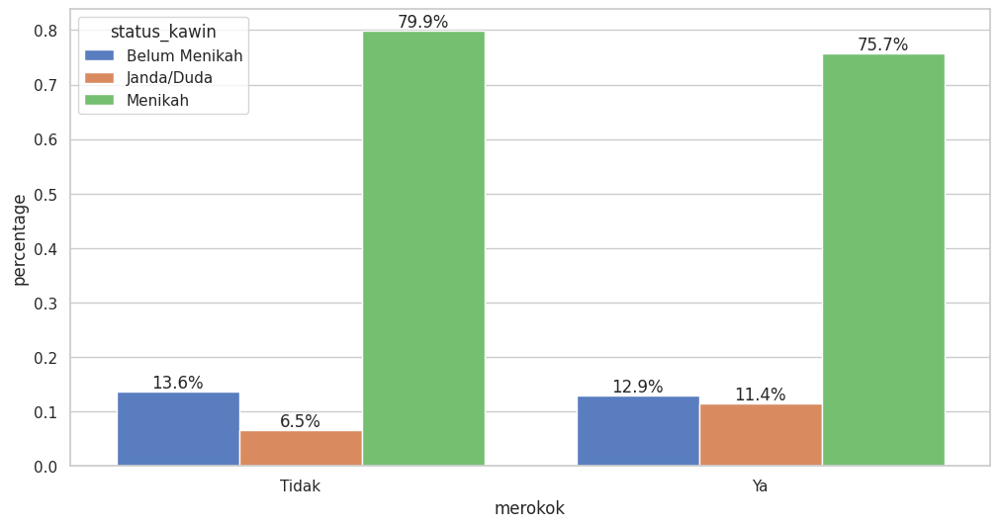

In [ ]:
for i in more_habit:
  barplot_prop_percent(x=i,
                     hue="status_kawin",
                     df=df_woman,
                     size=(12, 6),
                     title="")
  print("")

#### <h2> Di provinsi apasih yang cowo atau cewenya masih banyak belum menikah? </h2> ####

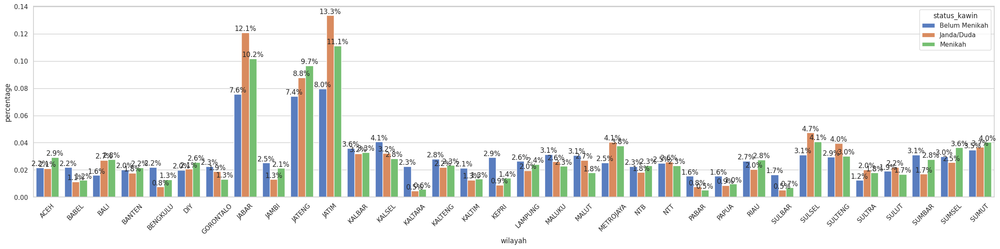

In [ ]:
barplot_prop_percent_hue(x="wilayah",
                     hue="status_kawin",
                     df=df_man,
                     size=(30, 6),
                     title="",
                         rot=30)

<Figure size 1200x600 with 0 Axes>

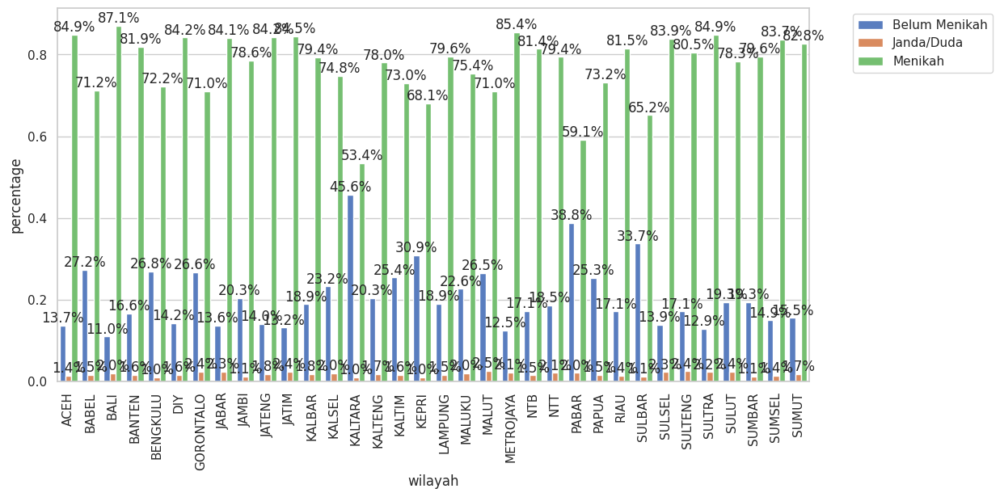

In [ ]:
barplot_prop_percent(x="wilayah",
                     hue="status_kawin",
                     df=df_man,
                     size=(30, 6),
                     title="",
                     out=True,
                     rot=90)

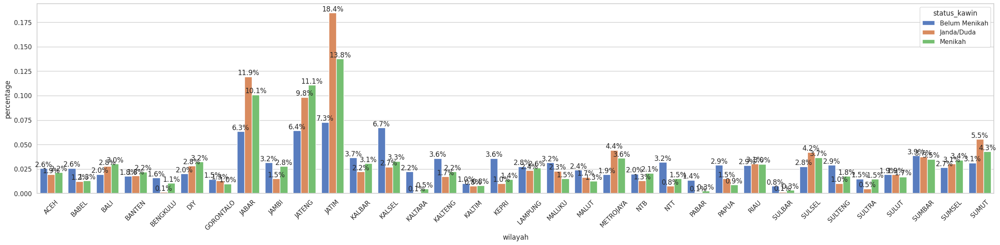

In [ ]:
barplot_prop_percent_hue(x="wilayah",
                     hue="status_kawin",
                     df=df_woman,
                     size=(30, 6),
                     title="")

<Figure size 1200x600 with 0 Axes>

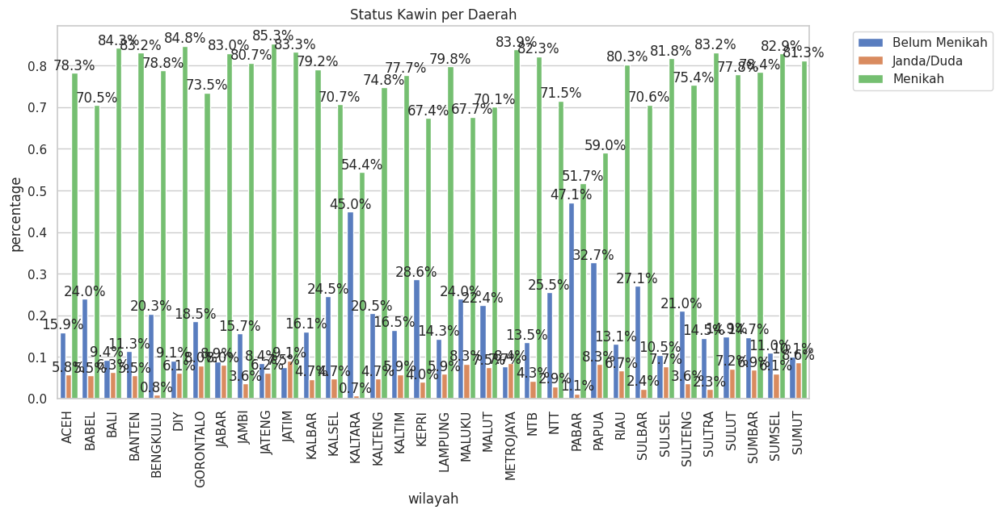

In [ ]:
barplot_prop_percent(x="wilayah",
                     hue="status_kawin",
                     df=df_woman,
                     size=(30, 6),
                     title="Status Kawin per Daerah",
                     out=True,
                     rot=90)

<Figure size 1200x600 with 0 Axes>

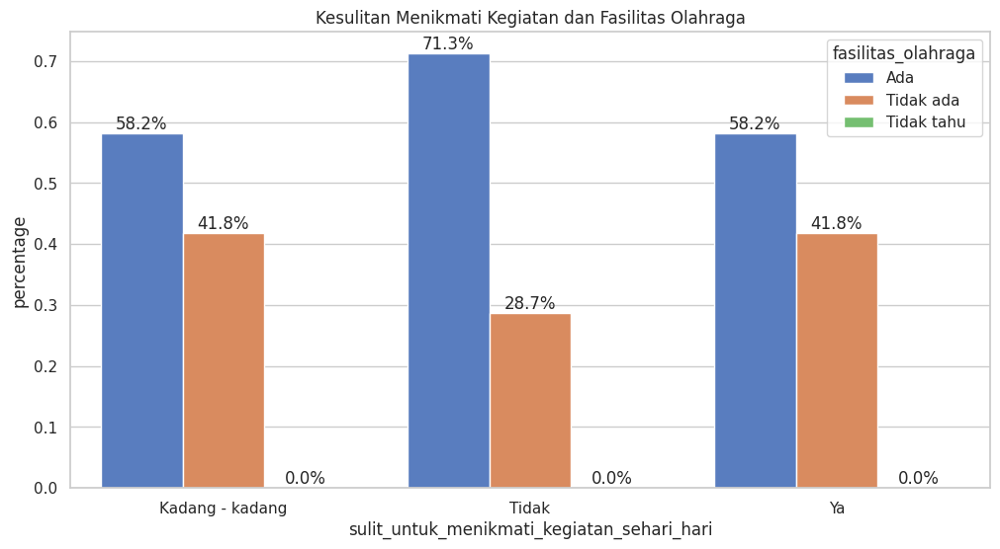

In [ ]:
barplot_prop_percent(x="sulit_untuk_menikmati_kegiatan_sehari_hari",
                     hue="fasilitas_olahraga",
                     df=df,
                     size=(12, 6),
                     title="Kesulitan Menikmati Kegiatan dan Fasilitas Olahraga",
                     hue_filter = ["Ada","Tidak ada"])

Dapat dilihat pada grafik diatas bahwa ada tendensi untuk mereka yang menjawab "ya" pada kesulitan menikmati kegiatan sehari-hari ketidakberadaan fasilitas olahraga lebih tinggi dibanding mereka yang menjawab "tidak"

<Figure size 1200x600 with 0 Axes>

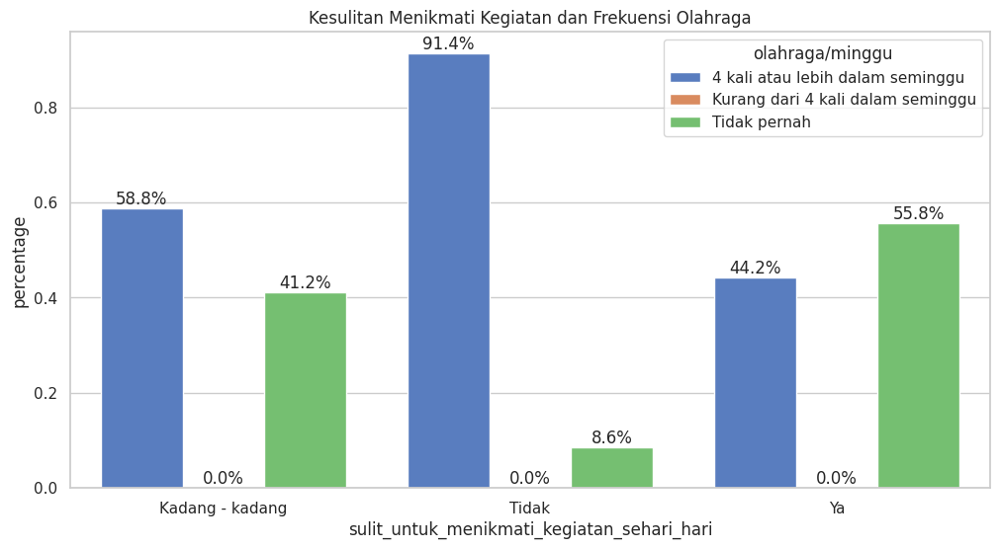

In [ ]:
barplot_prop_percent(x="sulit_untuk_menikmati_kegiatan_sehari_hari", hue="olahraga/minggu", df=df, size=(12, 6),
                         title='Kesulitan Menikmati Kegiatan dan Frekuensi Olahraga', hue_filter=["4 kali atau lebih dalam seminggu","Tidak pernah"],
                         out=False,
                         hue_palette="muted", rot=0)

Dapat dilihat pada grafik diatas bahwa mereka yang menjawab "ya" pada sulit menikmati kegiatan sehari-hari berolahraga lebih besar persentasenya yang tidak pernah olahraga dibanding mereka yang menjawab "tidak"

#Modelling (´。＿。｀)

##Import Modules and Functions
---
Dalam model decision-tree-based model (seperti model gradient boosting yang digunakan terus menerus karena sifatnya yang cukup robust dalam menghadapi multikolinearitas), beberapa wawasan yang bisa didapatkan, menggunakan syntax yang sama sehingga dibuat function untuk mempermudah pemakaian.

In [ ]:
from sklearn.model_selection import cross_val_score, KFold, train_test_split
from sklearn.model_selection import cross_validate, StratifiedKFold
from sklearn.metrics import make_scorer, mean_squared_error, f1_score, balanced_accuracy_score
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.linear_model import LogisticRegression
try:
  from catboost import CatBoostClassifier, CatBoostRegressor
except:
  !pip install catboost
  from catboost import CatBoostClassifier, CatBoostRegressor
from sklearn.ensemble import AdaBoostClassifier
from sklearn.svm import SVC
try:
  import optuna
except:
  !pip install optuna
  import optuna
import xgboost as xgb
import lightgbm as lgb
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import MultinomialNB
from sklearn.tree import DecisionTreeClassifier
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler

In [ ]:
def eval_func(y_test, y_pred):
  accuracy = accuracy_score(y_test, y_pred)
  classification_report_str = classification_report(y_test, y_pred)
  balanced_acc = balanced_accuracy_score(y_test, y_pred)

  cm = confusion_matrix(y_test, y_pred)
  plt.figure(figsize=(8, 6))
  sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
              xticklabels=np.unique(y),
              yticklabels=np.unique(y))
  plt.title("Confusion Matrix")
  plt.xlabel("Predicted Label")
  plt.ylabel("True Label")
  plt.show()
  print("")

  print(f"Accuracy: {accuracy}")
  print(f"Balanced accuracy: {balanced_acc}")
  print("\nClassification Report:\n", classification_report_str)

In [ ]:
def feature_importance_viz(df, model):

  # Assuming features is a list of column names in the order used for training
  features = df.columns.tolist()

  # Get feature importances from your model
  importances = list(model.feature_importances_)

  # Create a DataFrame to make sorting easier
  importance_df = pd.DataFrame({
      'feature': features,
      'importance': importances
  })

  # Sort the DataFrame by importance in descending order
  importance_df = importance_df.sort_values(by='importance', ascending=False)

  # Plot the feature importances
  plt.figure(figsize=(10, 6))
  plt.barh(importance_df['feature'], importance_df['importance'], color='skyblue')
  plt.xlabel('Importance')
  plt.ylabel('Feature')
  plt.title('Feature Importance')
  plt.gca().invert_yaxis()  # Invert the y-axis to show the feature with the highest importance at the top
  plt.show()

In [ ]:
def feature_importance_viz_top_20(df, model):

  # Assuming features is a list of column names in the order used for training
  features = df.columns.tolist()

  # Get feature importances from your model
  importances = list(model.feature_importances_)

  # Create a DataFrame to make sorting easier
  importance_df = pd.DataFrame({
      'feature': features,
      'importance': importances
  })

  # Sort the DataFrame by importance in descending order
  importance_df = importance_df.sort_values(by='importance', ascending=False).head(20)

  # Plot the feature importances
  plt.figure(figsize=(10, 6))
  plt.barh(importance_df['feature'], importance_df['importance'], color='skyblue')
  plt.xlabel('Importance')
  plt.ylabel('Feature')
  plt.title('Feature Importance')
  plt.gca().invert_yaxis()  # Invert the y-axis to show the feature with the highest importance at the top
  plt.show()

In [ ]:
def feature_importance_viz_tail_20(df, model):

  # Assuming features is a list of column names in the order used for training
  features = df.columns.tolist()

  # Get feature importances from your model
  importances = list(model.feature_importances_)

  # Create a DataFrame to make sorting easier
  importance_df = pd.DataFrame({
      'feature': features,
      'importance': importances
  })

  # Sort the DataFrame by importance in descending order
  importance_df = importance_df.sort_values(by='importance', ascending=False).tail(20)

  # Plot the feature importances
  plt.figure(figsize=(10, 6))
  plt.barh(importance_df['feature'], importance_df['importance'], color='skyblue')
  plt.xlabel('Importance')
  plt.ylabel('Feature')
  plt.title('Feature Importance')
  plt.gca().invert_yaxis()  # Invert the y-axis to show the feature with the highest importance at the top
  plt.show()

In [ ]:
def feature_importance_viz_tail_custom(df, model, tail):

  # Assuming features is a list of column names in the order used for training
  features = df.columns.tolist()

  # Get feature importances from your model
  importances = list(model.feature_importances_)

  # Create a DataFrame to make sorting easier
  importance_df = pd.DataFrame({
      'feature': features,
      'importance': importances
  })

  # Sort the DataFrame by importance in descending order
  importance_df = importance_df.sort_values(by='importance', ascending=False).tail(tail)

  # Plot the feature importances
  plt.figure(figsize=(10, 6))
  plt.barh(importance_df['feature'], importance_df['importance'], color='skyblue')
  plt.xlabel('Importance')
  plt.ylabel('Feature')
  plt.title('Feature Importance')
  plt.gca().invert_yaxis()  # Invert the y-axis to show the feature with the highest importance at the top
  plt.show()

def feature_importance_viz_top_custom(df, model, top):

  # Assuming features is a list of column names in the order used for training
  features = df.columns.tolist()

  # Get feature importances from your model
  importances = list(model.feature_importances_)

  # Create a DataFrame to make sorting easier
  importance_df = pd.DataFrame({
      'feature': features,
      'importance': importances
  })

  # Sort the DataFrame by importance in descending order
  importance_df = importance_df.sort_values(by='importance', ascending=False).head(top)

  # Plot the feature importances
  plt.figure(figsize=(10, 6))
  plt.barh(importance_df['feature'], importance_df['importance'], color='skyblue')
  plt.xlabel('Importance')
  plt.ylabel('Feature')
  plt.title('Feature Importance')
  plt.gca().invert_yaxis()  # Invert the y-axis to show the feature with the highest importance at the top
  plt.show()

##Model 1 ( ﾉ ﾟｰﾟ)ﾉ
---
Tegang, Cemas, Khawatir ~ X

In [ ]:
df.columns

Index(['wilayah', 'jenis_kelamin', 'usia', 'lama_berdinas', 'pendidikan',
       'tinggi', 'berat', 'lingkar_pinggang', 'status_kawin', 'pengeluaran',
       'penyakit_jantung', 'penyakit_stroke', 'penyakit_diabetes_melitus',
       'penyakit_hipertensi', 'penyakit_kanker', 'penyakit_ginjal',
       'penyakit_tumor', 'penyakit_osteoartritis', 'penyakit_lambung',
       'penyakit_liver', 'penyakit_tbc', 'penyakit_dbd', 'penyakit_covid19',
       'penyakit_hiv_aids', 'penyakit_diare', 'penyakit_malaria',
       'penyakit_gonore_sipilis', 'penyakit_thypus', 'penyakit_dermatitis',
       'penyakit_mikosis', 'sakit_kepala', 'tidak_nafsu_makan', 'sulit_tidur',
       'mudah_takut', 'tegang,_cemas_atau_kuatir', 'tangan_anda_gemetar',
       'masalah_pencernaan', 'sulit_untuk_berpikir_jernih', 'tidak_bahagia',
       'menangis_lebih_sering', 'sulit_untuk_menikmati_kegiatan_sehari_hari',
       'sulit_untuk_mengambil_keputusan', 'pekerjaan_terganggu',
       'tidak_mampu_melakukan_hal_hal_yang_

In [ ]:
df['tegang,_cemas_atau_kuatir'].value_counts()

Tidak              256243
Kadang - kadang     29579
Ya                   2832
Name: tegang,_cemas_atau_kuatir, dtype: int64

In [ ]:
X = df.copy()

X.dropna(inplace=True)
y = X['tegang,_cemas_atau_kuatir'].copy()
X.drop(['tegang,_cemas_atau_kuatir'], axis=1, inplace=True)

In [ ]:
X.columns

Index(['wilayah', 'jenis_kelamin', 'usia', 'lama_berdinas', 'pendidikan',
       'tinggi', 'berat', 'lingkar_pinggang', 'status_kawin', 'pengeluaran',
       'penyakit_jantung', 'penyakit_stroke', 'penyakit_diabetes_melitus',
       'penyakit_hipertensi', 'penyakit_kanker', 'penyakit_ginjal',
       'penyakit_tumor', 'penyakit_osteoartritis', 'penyakit_lambung',
       'penyakit_liver', 'penyakit_tbc', 'penyakit_dbd', 'penyakit_covid19',
       'penyakit_hiv_aids', 'penyakit_diare', 'penyakit_malaria',
       'penyakit_gonore_sipilis', 'penyakit_thypus', 'penyakit_dermatitis',
       'penyakit_mikosis', 'sakit_kepala', 'tidak_nafsu_makan', 'sulit_tidur',
       'mudah_takut', 'tangan_anda_gemetar', 'masalah_pencernaan',
       'sulit_untuk_berpikir_jernih', 'tidak_bahagia', 'menangis_lebih_sering',
       'sulit_untuk_menikmati_kegiatan_sehari_hari',
       'sulit_untuk_mengambil_keputusan', 'pekerjaan_terganggu',
       'tidak_mampu_melakukan_hal_hal_yang_bermanfaat_dalam_hidup',
    

In [ ]:
rus = RandomUnderSampler(sampling_strategy='auto', random_state=42
                        , replacement=True
                        )# fit predictor and target variable
X, y = rus.fit_resample(X, y)

In [ ]:
y.value_counts()

Kadang - kadang    2722
Tidak              2722
Ya                 2722
Name: tegang,_cemas_atau_kuatir, dtype: int64

In [ ]:
X = pd.get_dummies(X, drop_first=True)
class_mapping = {'Tidak': 0, 'Kadang - kadang': 1, 'Ya': 2}
y = np.array([class_mapping[label] for label in y])

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

In [ ]:
adaboost_model = AdaBoostClassifier()
adaboost_model.fit(X_train, y_train)

AdaBoostClassifier()

In [ ]:
y_pred = adaboost_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
classification_report_str = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print("\nClassification Report:\n", classification_report_str)

Accuracy: 0.7185892725936811

Classification Report:
               precision    recall  f1-score   support

           0       0.70      0.87      0.78      1369
           1       0.67      0.59      0.63      1385
           2       0.79      0.69      0.74      1329

    accuracy                           0.72      4083
   macro avg       0.72      0.72      0.72      4083
weighted avg       0.72      0.72      0.71      4083



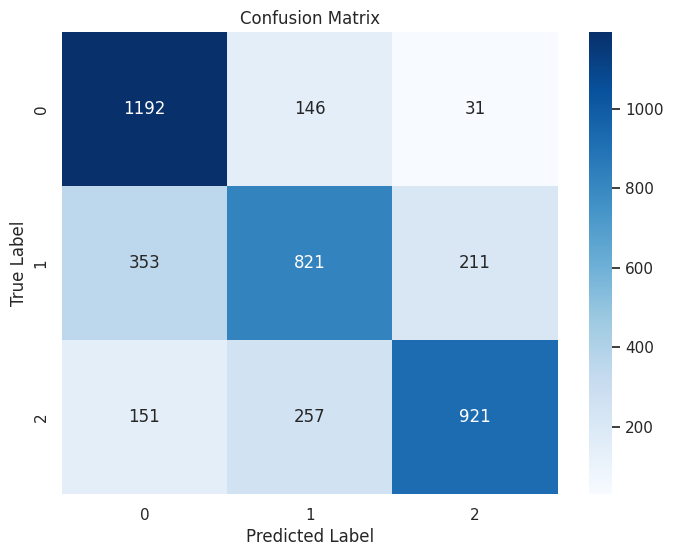

In [ ]:
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=np.unique(y),
            yticklabels=np.unique(y))
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

In [ ]:
from sklearn.utils import class_weight

classes_weights = class_weight.compute_sample_weight(
    class_weight='balanced',
    y=y_train
)

xgboost_model = xgb.XGBClassifier(xgb.XGBClassifier(objective='multi:softmax',
                                                    num_class=len(set(y_train)),
                                                    eval_metric='mlogloss',
                                                    sample_weight=classes_weights))

xgboost_model.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

In [ ]:
y_pred = xgboost_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
classification_report_str = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print("\nClassification Report:\n", classification_report_str)

Accuracy: 0.7271614009306883

Classification Report:
               precision    recall  f1-score   support

           0       0.76      0.82      0.79      1369
           1       0.65      0.65      0.65      1385
           2       0.78      0.71      0.74      1329

    accuracy                           0.73      4083
   macro avg       0.73      0.73      0.73      4083
weighted avg       0.73      0.73      0.73      4083



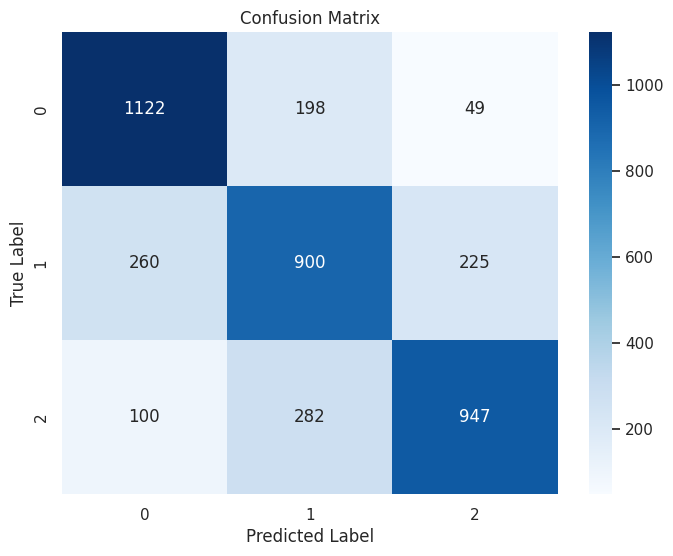

In [ ]:
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=np.unique(y),
            yticklabels=np.unique(y))
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

In [ ]:
# Create a CatBoost classifier
catboost_model = CatBoostClassifier(loss_function='MultiClass', custom_metric=['F1'])

# Train the CatBoost model
catboost_model.fit(X_train, y_train, verbose=0)

# Make predictions on the test set
y_pred = catboost_model.predict(X_test)

In [ ]:
print("\nClassification Report:\n", classification_report(y_test, y_pred))


Classification Report:
               precision    recall  f1-score   support

           0       0.76      0.85      0.80      1369
           1       0.65      0.64      0.65      1385
           2       0.79      0.70      0.74      1329

    accuracy                           0.73      4083
   macro avg       0.73      0.73      0.73      4083
weighted avg       0.73      0.73      0.73      4083



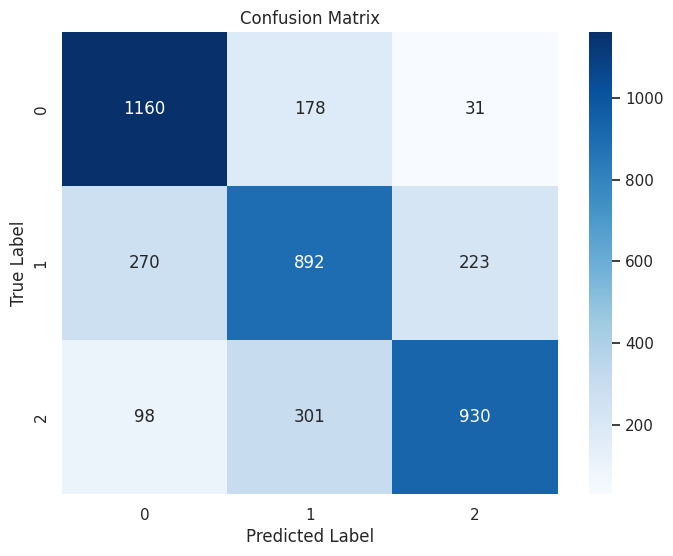

In [ ]:
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=np.unique(y),
            yticklabels=np.unique(y))
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

In [ ]:
# Calculate class weights to handle imbalance (if needed)
class_weights = len(y_train) / (len(set(y_train)) * np.bincount(y_train))

# Create a Logistic Regression classifier for multinomial (multiclass) classification
logreg_multinomial_model = LogisticRegression(
    multi_class='multinomial',
    solver='lbfgs',  # You can choose a different solver based on your requirements
    class_weight='balanced'  # Use 'balanced' to automatically adjust class weights
)

# Train the Logistic Regression model
logreg_multinomial_model.fit(X_train, y_train)

y_pred = logreg_multinomial_model.predict(X_test)

print("\nClassification Report:\n", classification_report(y_test, y_pred))


Classification Report:
               precision    recall  f1-score   support

           0       0.73      0.83      0.78      1369
           1       0.60      0.59      0.60      1385
           2       0.76      0.67      0.71      1329

    accuracy                           0.70      4083
   macro avg       0.70      0.70      0.70      4083
weighted avg       0.70      0.70      0.70      4083



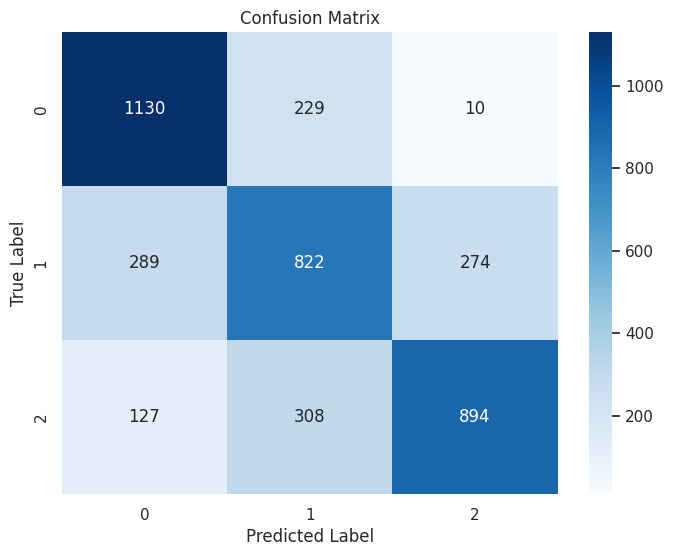

In [ ]:
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=np.unique(y),
            yticklabels=np.unique(y))
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

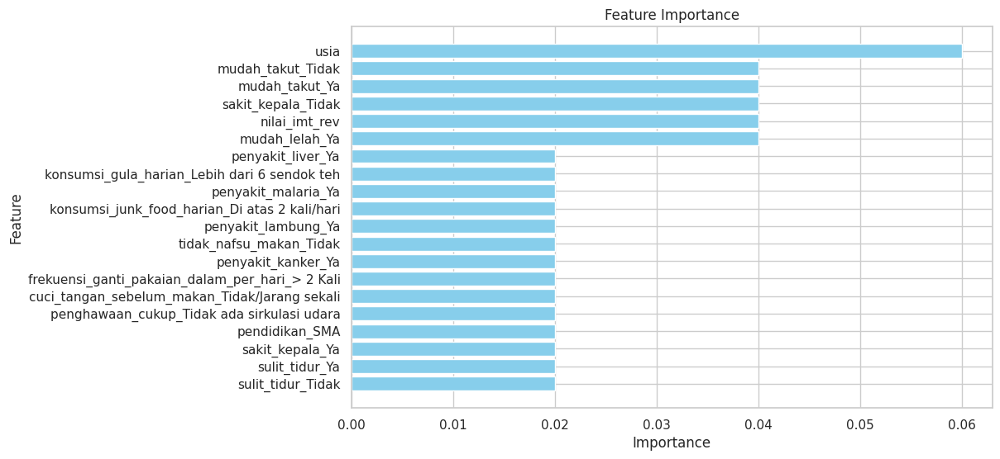

In [ ]:
feature_importance_viz_top_20(X, adaboost_model)

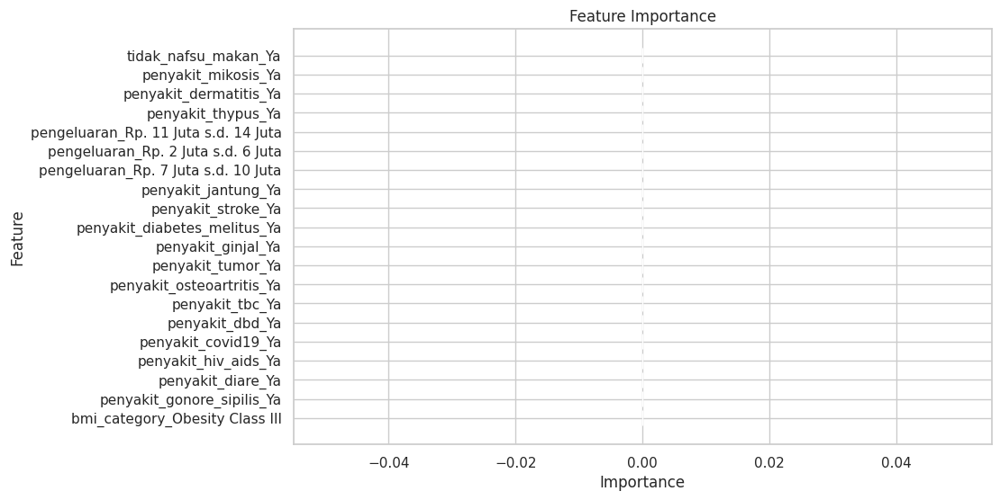

In [ ]:
feature_importance_viz_tail_20(X, adaboost_model)

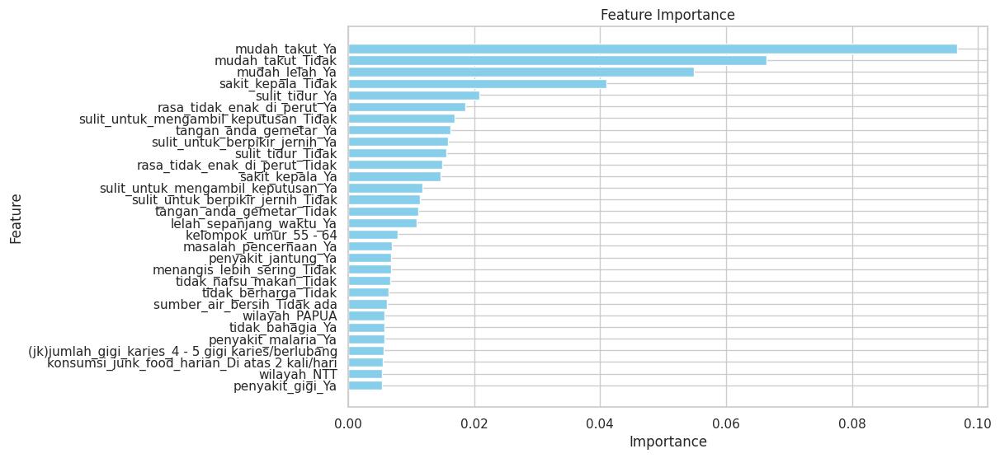

In [ ]:
feature_importance_viz_top_custom(X, xgboost_model, 30)

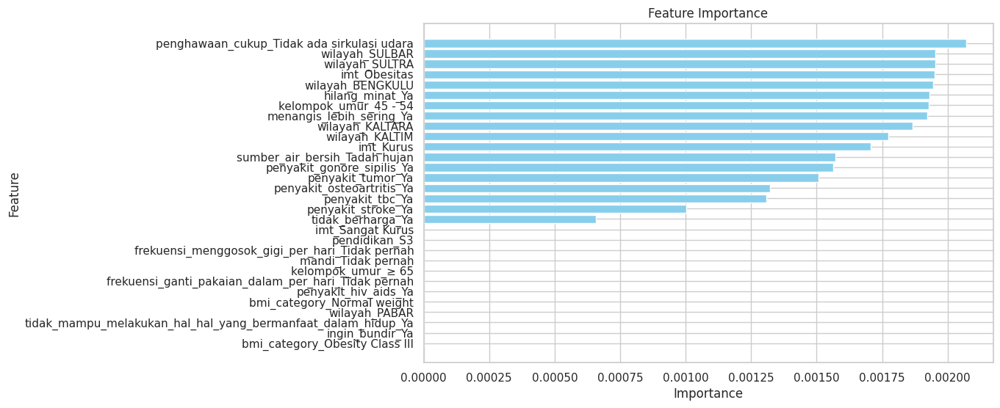

In [ ]:
feature_importance_viz_tail_custom(X, xgboost_model, 30)

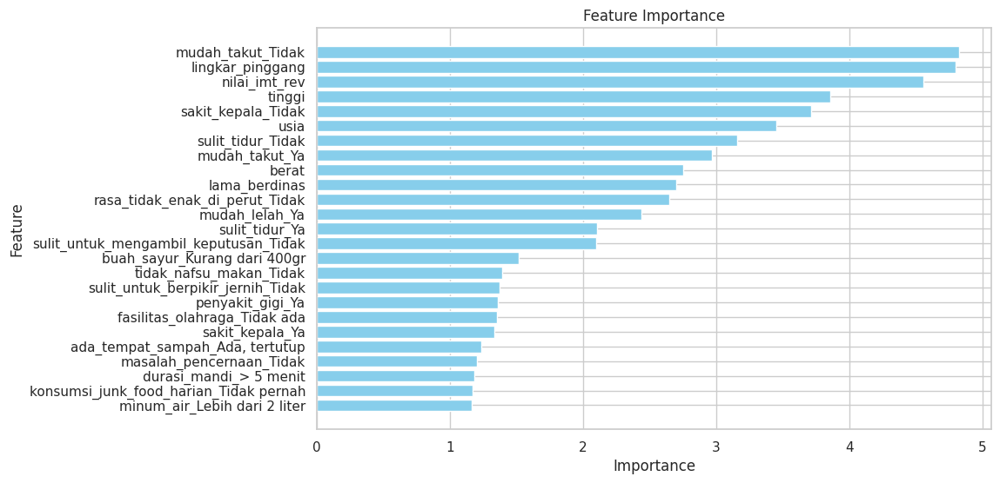

In [ ]:
feature_importance_viz_top_custom(X, catboost_model, 25)

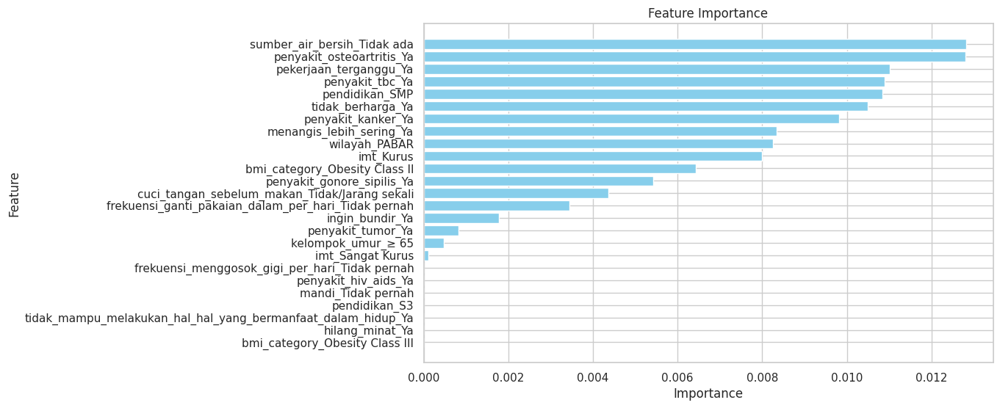

In [ ]:
feature_importance_viz_tail_custom(X, catboost_model, 25)

##Model 2 ヾ(≧▽≦*)o
---
Bundir~Fasilitas

In [ ]:
df.columns

Index(['wilayah', 'jenis_kelamin', 'usia', 'lama_berdinas', 'pendidikan',
       'tinggi', 'berat', 'lingkar_pinggang', 'status_kawin', 'pengeluaran',
       'penyakit_jantung', 'penyakit_stroke', 'penyakit_diabetes_melitus',
       'penyakit_hipertensi', 'penyakit_kanker', 'penyakit_ginjal',
       'penyakit_tumor', 'penyakit_osteoartritis', 'penyakit_lambung',
       'penyakit_liver', 'penyakit_tbc', 'penyakit_dbd', 'penyakit_covid19',
       'penyakit_hiv_aids', 'penyakit_diare', 'penyakit_malaria',
       'penyakit_gonore_sipilis', 'penyakit_thypus', 'penyakit_dermatitis',
       'penyakit_mikosis', 'sakit_kepala', 'tidak_nafsu_makan', 'sulit_tidur',
       'mudah_takut', 'tegang,_cemas_atau_kuatir', 'tangan_anda_gemetar',
       'masalah_pencernaan', 'sulit_untuk_berpikir_jernih', 'tidak_bahagia',
       'menangis_lebih_sering', 'sulit_untuk_menikmati_kegiatan_sehari_hari',
       'sulit_untuk_mengambil_keputusan', 'pekerjaan_terganggu',
       'tidak_mampu_melakukan_hal_hal_yang_

In [ ]:
df['ingin_bundir'].unique()

['Tidak', 'Kadang - kadang', 'Ya']
Categories (3, object): ['Kadang - kadang', 'Tidak', 'Ya']

In [ ]:
category_mapping = {'Tidak': 0, 'Kadang - kadang': 1, 'Ya': 1}
df['ingin_bundir'] = df['ingin_bundir'].map(category_mapping)

In [ ]:
df['ingin_bundir'].value_counts()

0    287545
1      1109
Name: ingin_bundir, dtype: int64

In [ ]:
y = df['ingin_bundir'].copy()
X = df[['penghawaan_cukup', 'kontaminasi_udara', 'sumber_air_bersih',
       'sumber_air_makan_minum', 'jarak_jamban_sumur',
       'saluran_pembuangan_air', 'ada_tempat_sampah', 'jarak_tempat_sampah',
       'fasilitas_olahraga', 'kelompok_umur']].copy()

X = pd.get_dummies(X, drop_first=True)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

In [ ]:
# Calculate class weights to handle imbalance
class_weights = {0: 287545*4, 1: 1109}

# Create a CatBoost classifier with class weights
catboost_model = CatBoostClassifier(loss_function='Logloss', custom_metric=['F1'],
                                    class_weights=class_weights)

# Train the CatBoost model
catboost_model.fit(X_train, y_train, verbose=0)

# Make predictions on the test set
y_pred = catboost_model.predict(X_test)

# Evaluate the model using F1 score
f1 = f1_score(y_test, y_pred)

# Print F1 score and classification report
print(f"F1 Score: {f1}")
print("\nClassification Report:\n", classification_report(y_test, y_pred))

F1 Score: 0.0

Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    143769
           1       0.00      0.00      0.00       558

    accuracy                           1.00    144327
   macro avg       0.50      0.50      0.50    144327
weighted avg       0.99      1.00      0.99    144327



In [ ]:
# Calculate class weights to handle imbalance
class_weights = len(y_train) / (2 * np.bincount(y_train))

# Create a Logistic Regression classifier with class weights
logreg_model = LogisticRegression(class_weight={0: class_weights[0], 1: class_weights[1]})

# Train the Logistic Regression model
logreg_model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = logreg_model.predict(X_test)

# Evaluate the model using F1 score
f1 = f1_score(y_test, y_pred)

# Print F1 score and classification report
print(f"F1 Score: {f1}")
print("\nClassification Report:\n", classification_report(y_test, y_pred))

F1 Score: 0.016505592355304594

Classification Report:
               precision    recall  f1-score   support

           0       1.00      0.75      0.86    143769
           1       0.01      0.54      0.02       558

    accuracy                           0.75    144327
   macro avg       0.50      0.65      0.44    144327
weighted avg       0.99      0.75      0.85    144327



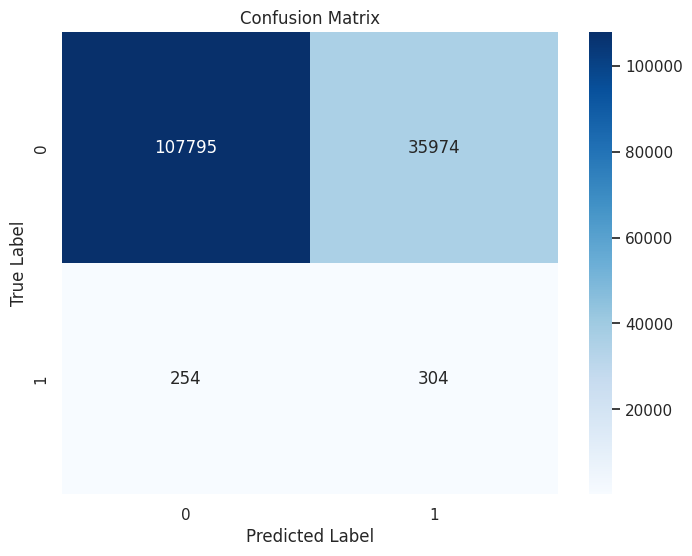

In [ ]:
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=np.unique(y),
            yticklabels=np.unique(y))
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

In [ ]:
logreg_model.coef_

array([[-1.49971792,  0.0504003 ,  0.8003358 ,  1.21413232, -0.03581034,
         0.91681536,  0.76157215, -0.32058038, -0.32939192, -0.18595421,
        -0.08042485, -0.15887788, -0.06031744,  1.25315639,  0.41481208,
        -0.49303375,  0.14847878,  0.50536939,  0.25781316,  0.54002487,
         1.08137501,  0.07808404,  0.27480816,  0.28423036, -0.52593995,
         0.94670248]])

In [ ]:
X.columns

Index(['penghawaan_cukup_Lebih dari 1 sirkulasi udara',
       'penghawaan_cukup_Tidak ada sirkulasi udara',
       'kontaminasi_udara_Tidak tahu', 'kontaminasi_udara_Ya',
       'sumber_air_bersih_Sumur/Kali', 'sumber_air_bersih_Tadah hujan',
       'sumber_air_bersih_Tidak ada',
       'sumber_air_makan_minum_Air mineral isi ulang',
       'sumber_air_makan_minum_Air mineral kemasan',
       'sumber_air_makan_minum_Air sumur',
       'sumber_air_makan_minum_Tadah hujan',
       'jarak_jamban_sumur_Lebih dari 12 meter',
       'jarak_jamban_sumur_Tidak memiliki jamban sehat',
       'saluran_pembuangan_air_Tidak ada', 'saluran_pembuangan_air_Tidak tahu',
       'ada_tempat_sampah_Ada, tertutup', 'ada_tempat_sampah_Tidak ada',
       'jarak_tempat_sampah_Kurang dari 10 meter',
       'jarak_tempat_sampah_Lebih dari 10 meter',
       'fasilitas_olahraga_Tidak ada', 'fasilitas_olahraga_Tidak tahu',
       'kelompok_umur_25 - 34', 'kelompok_umur_35 - 44',
       'kelompok_umur_45 - 54', '

In [ ]:
rus = RandomUnderSampler(sampling_strategy='auto', random_state=42, replacement=True)# fit predictor and target variable
X, y = rus.fit_resample(X, y)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

In [ ]:
# Create a CatBoost classifier with class weights
catboost_model = CatBoostClassifier(loss_function='Logloss', custom_metric=['F1'])

# Train the CatBoost model
catboost_model.fit(X_train, y_train, verbose=0)

# Make predictions on the test set
y_pred = catboost_model.predict(X_test)

# Evaluate the model using F1 score
f1 = f1_score(y_test, y_pred)

# Print F1 score and classification report
print(f"F1 Score: {f1}")
print("\nClassification Report:\n", classification_report(y_test, y_pred))

F1 Score: 0.6127167630057804

Classification Report:
               precision    recall  f1-score   support

           0       0.62      0.70      0.66       554
           1       0.66      0.57      0.61       555

    accuracy                           0.64      1109
   macro avg       0.64      0.64      0.64      1109
weighted avg       0.64      0.64      0.64      1109



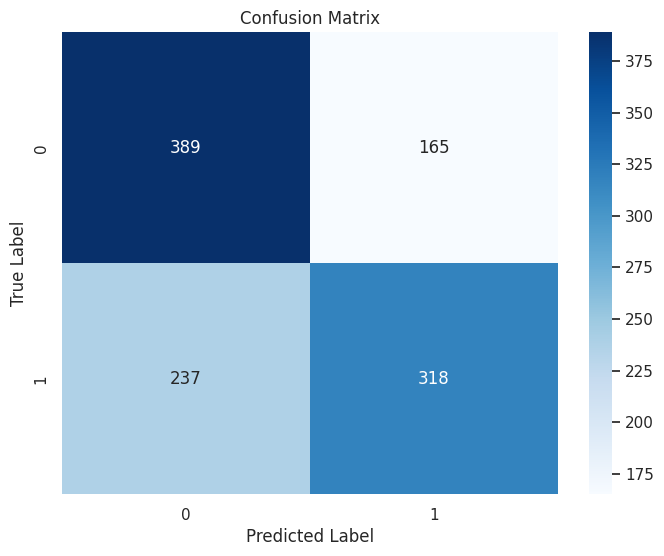

In [ ]:
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=np.unique(y),
            yticklabels=np.unique(y))
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

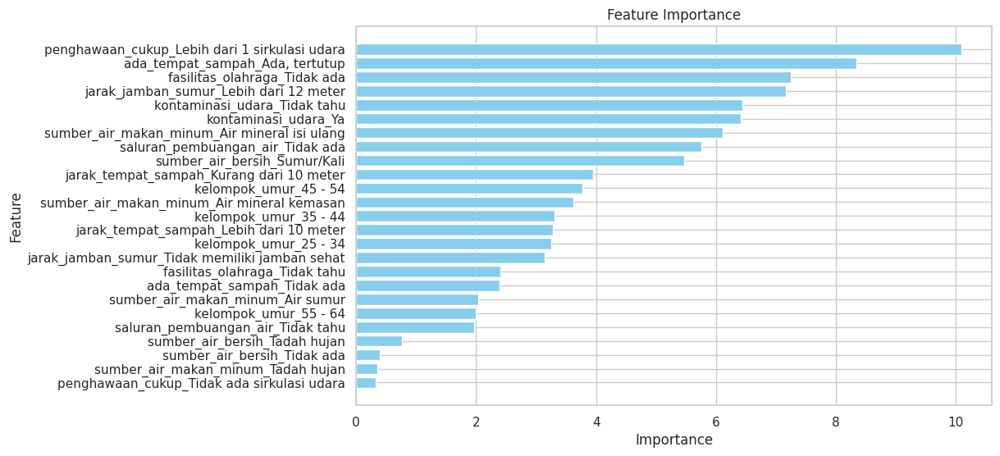

In [ ]:
feature_importance_viz_top_custom(X, catboost_model, 25)

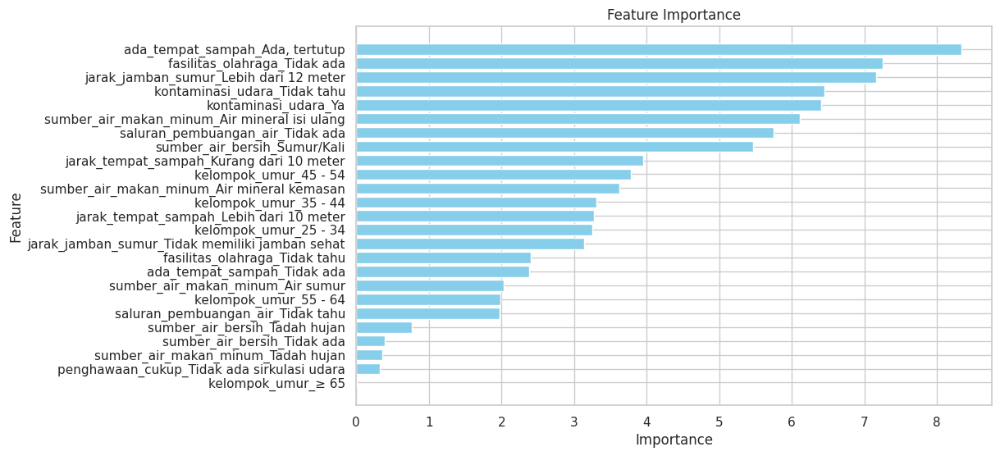

In [ ]:
feature_importance_viz_tail_custom(X, catboost_model, 25)

##Model 3 o(TヘTo)
---
Pulau ~ X

In [ ]:
df.columns

Index(['wilayah', 'jenis_kelamin', 'usia', 'lama_berdinas', 'pendidikan',
       'tinggi', 'berat', 'lingkar_pinggang', 'status_kawin', 'pengeluaran',
       'penyakit_jantung', 'penyakit_stroke', 'penyakit_diabetes_melitus',
       'penyakit_hipertensi', 'penyakit_kanker', 'penyakit_ginjal',
       'penyakit_tumor', 'penyakit_osteoartritis', 'penyakit_lambung',
       'penyakit_liver', 'penyakit_tbc', 'penyakit_dbd', 'penyakit_covid19',
       'penyakit_hiv_aids', 'penyakit_diare', 'penyakit_malaria',
       'penyakit_gonore_sipilis', 'penyakit_thypus', 'penyakit_dermatitis',
       'penyakit_mikosis', 'sakit_kepala', 'tidak_nafsu_makan', 'sulit_tidur',
       'mudah_takut', 'tegang,_cemas_atau_kuatir', 'tangan_anda_gemetar',
       'masalah_pencernaan', 'sulit_untuk_berpikir_jernih', 'tidak_bahagia',
       'menangis_lebih_sering', 'sulit_untuk_menikmati_kegiatan_sehari_hari',
       'sulit_untuk_mengambil_keputusan', 'pekerjaan_terganggu',
       'tidak_mampu_melakukan_hal_hal_yang_

In [ ]:
for i in df['wilayah'].unique():
  print(i)

KALBAR
BENGKULU
SULSEL
SULUT
KEPRI
NTT
JATIM
SULTENG
JAMBI
SUMUT
JABAR
ACEH
BALI
BANTEN
DIY
GORONTALO
JATENG
KALSEL
KALTENG
KALTIM
KALTARA
BABEL
LAMPUNG
MALUKU
MALUT
METROJAYA
NTB
PAPUA
PABAR
RIAU
SULBAR
SULTRA
SUMBAR
SUMSEL


In [ ]:
X = df.copy()
X.drop(['lingkar_pinggang'], axis=1, inplace=True)

X.dropna(inplace=True)
y = X['pulau'].copy()
X.drop(['pulau', 'wilayah', 'tinggi', 'berat'], axis=1, inplace=True)

X = pd.get_dummies(X)

In [ ]:
y.unique()

array(['Kalimantan', 'Sumatra', 'Sulawesi', 'Nusa Tenggara', 'Java',
       'Bali', 'Maluku', 'Papua'], dtype=object)

In [ ]:
more_mapping = {
  'Kalimantan': "Kalimantan",
  'Sumatra': "Sumatra",
  'Sulawesi': "Sulawesi",
  'Nusa Tenggara': 'Jawa_Bali',
  'Java': 'Jawa_Bali',
  'Bali': 'Jawa_Bali',
  'Maluku': 'Papua_Maluku',
  'Papua': 'Papua_Maluku'
}

y = y.map(more_mapping)

In [ ]:
more_mapping2 = {
  'Kalimantan': 0,
  'Sumatra': 1,
  'Sulawesi': 2,
  'Jawa_Bali': 3,
  'Papua_Maluku': 4
}

y = y.map(more_mapping2)

In [ ]:
y.value_counts()

3    127681
1     70516
2     35419
0     31460
4     17209
Name: pulau, dtype: int64

In [ ]:
rus = RandomUnderSampler(sampling_strategy='auto', random_state=42, replacement=True)# fit predictor and target variable
X, y = rus.fit_resample(X, y)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

In [ ]:
adaboost_model = AdaBoostClassifier()
adaboost_model.fit(X_train, y_train)

AdaBoostClassifier()

In [ ]:
y_pred = adaboost_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
classification_report_str = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print("\nClassification Report:\n", classification_report_str)

Accuracy: 0.39560235223020246

Classification Report:
               precision    recall  f1-score   support

           0       0.40      0.41      0.41      8468
           1       0.35      0.28      0.31      8663
           2       0.35      0.26      0.30      8684
           3       0.41      0.48      0.45      8630
           4       0.43      0.54      0.48      8578

    accuracy                           0.40     43023
   macro avg       0.39      0.40      0.39     43023
weighted avg       0.39      0.40      0.39     43023



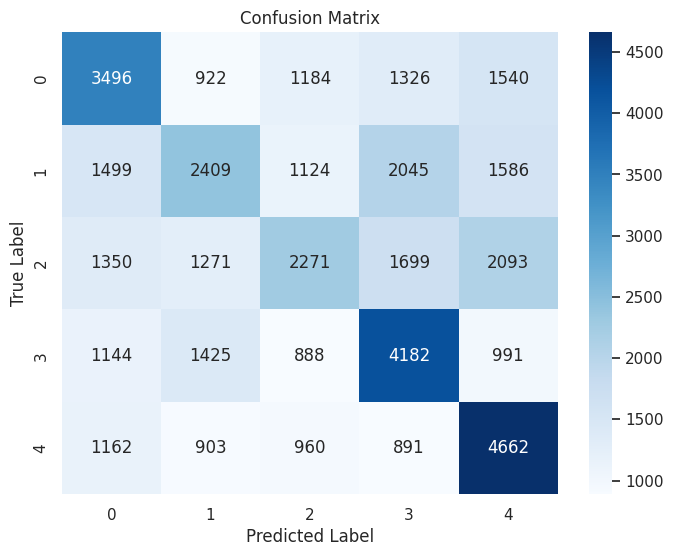

In [ ]:
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=np.unique(y),
            yticklabels=np.unique(y))
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

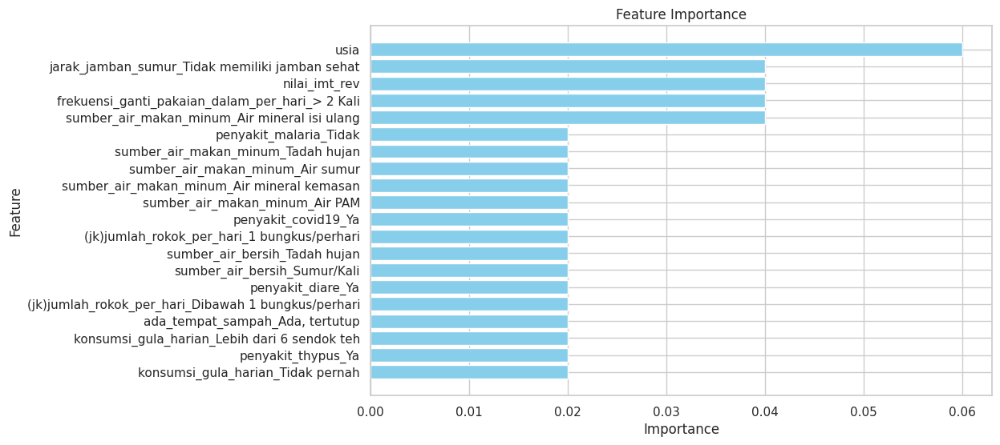

In [ ]:
feature_importance_viz_top_20(X, adaboost_model)

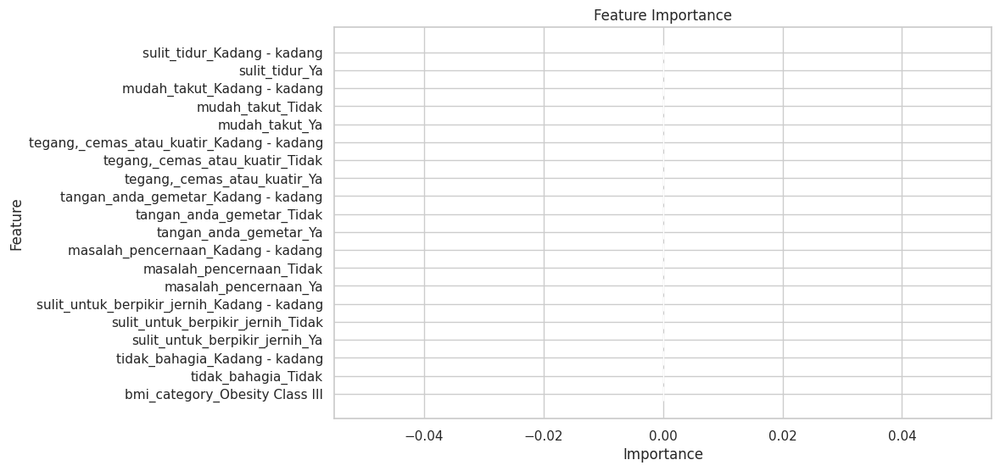

In [ ]:
feature_importance_viz_tail_20(X, adaboost_model)

In [ ]:
from sklearn.utils import class_weight

classes_weights = class_weight.compute_sample_weight(
    class_weight='balanced',
    y=y_train
)

xgboost_model = xgb.XGBClassifier(xgb.XGBClassifier(objective='multi:softmax',
                                                    num_class=len(set(y_train)),
                                                    eval_metric='mlogloss',
                                                    sample_weight=classes_weights))

xgboost_model.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

In [ ]:
y_pred = xgboost_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
classification_report_str = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print("\nClassification Report:\n", classification_report_str)

Accuracy: 0.43097877879273877

Classification Report:
               precision    recall  f1-score   support

           0       0.45      0.45      0.45      8468
           1       0.38      0.33      0.35      8663
           2       0.40      0.34      0.37      8684
           3       0.44      0.49      0.46      8630
           4       0.47      0.54      0.51      8578

    accuracy                           0.43     43023
   macro avg       0.43      0.43      0.43     43023
weighted avg       0.43      0.43      0.43     43023



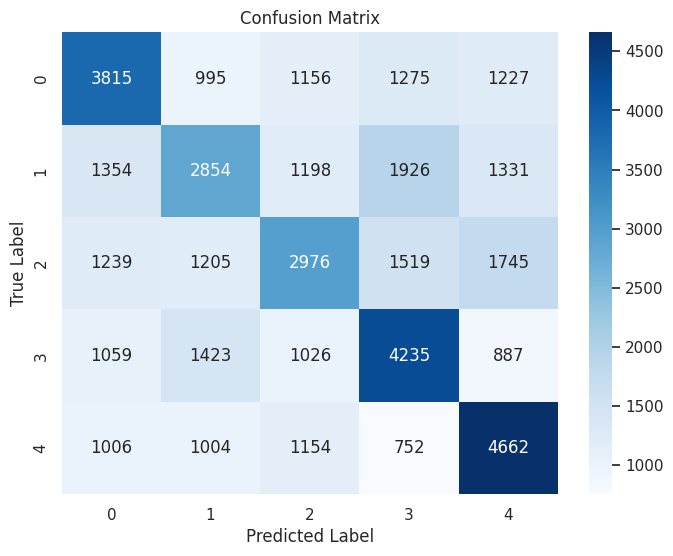

In [ ]:
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=np.unique(y),
            yticklabels=np.unique(y))
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

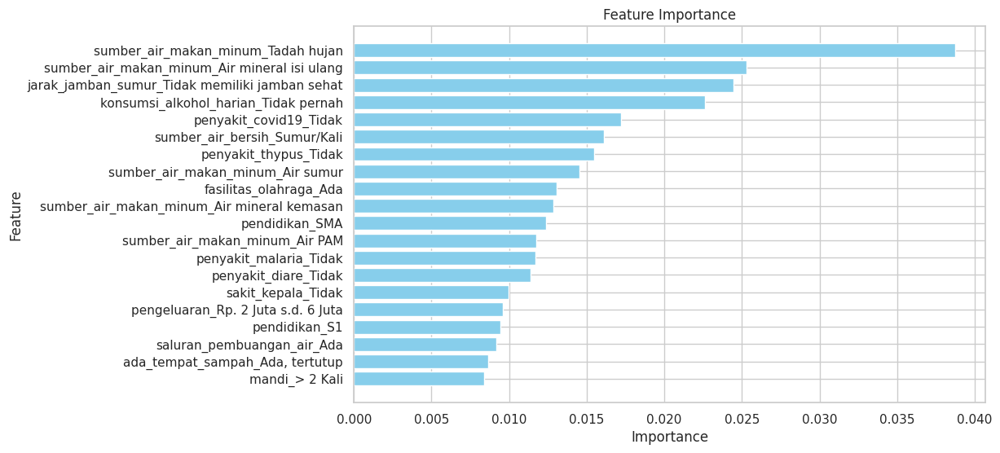

In [ ]:
feature_importance_viz_top_20(X, xgboost_model)

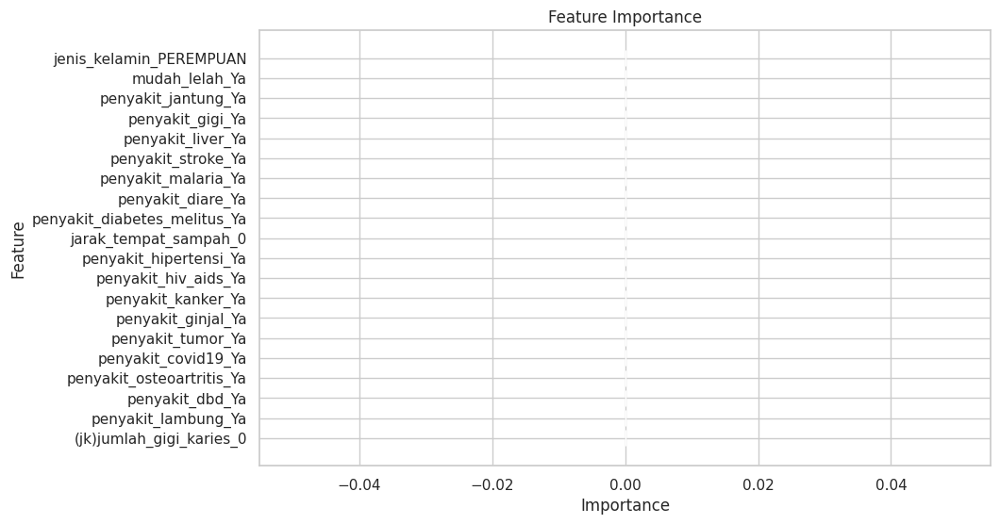

In [ ]:
feature_importance_viz_tail_20(X, xgboost_model)

In [ ]:
# Create a CatBoost classifier
catboost_model = CatBoostClassifier(loss_function='MultiClass', custom_metric=['F1'])

# Train the CatBoost model
catboost_model.fit(X_train, y_train, verbose=0)

# Make predictions on the test set
y_pred = catboost_model.predict(X_test)

In [ ]:
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")
print("\nClassification Report:\n", classification_report(y_test, y_pred))

Accuracy: 0.43639448666992076

Classification Report:
               precision    recall  f1-score   support

           0       0.46      0.45      0.45      8468
           1       0.39      0.34      0.36      8663
           2       0.40      0.35      0.38      8684
           3       0.44      0.49      0.47      8630
           4       0.48      0.55      0.51      8578

    accuracy                           0.44     43023
   macro avg       0.43      0.44      0.43     43023
weighted avg       0.43      0.44      0.43     43023



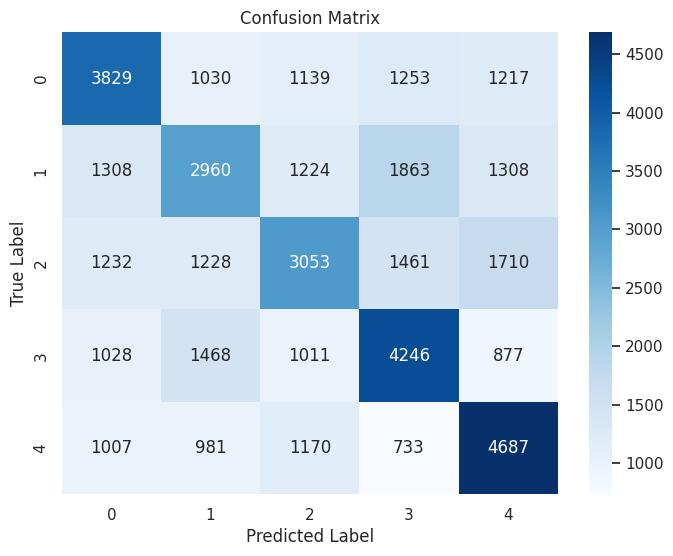

In [ ]:
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=np.unique(y),
            yticklabels=np.unique(y))
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

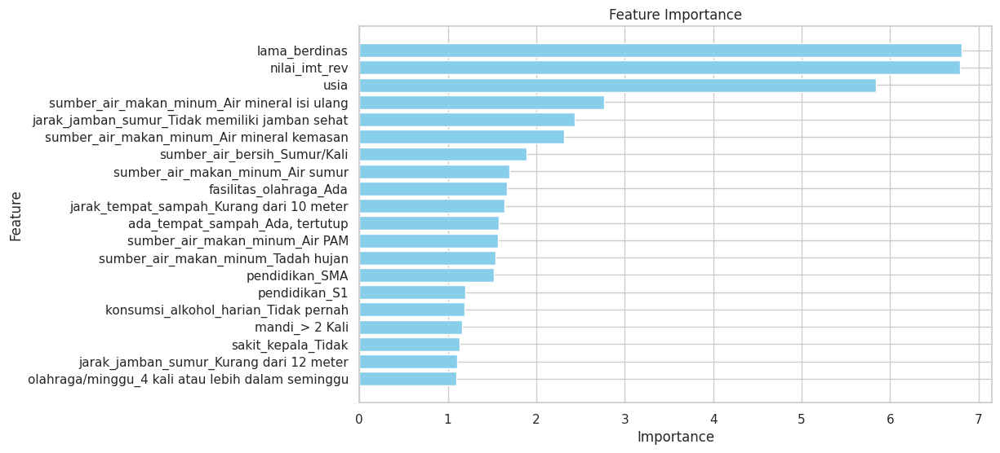

In [ ]:
feature_importance_viz_top_20(X, catboost_model)

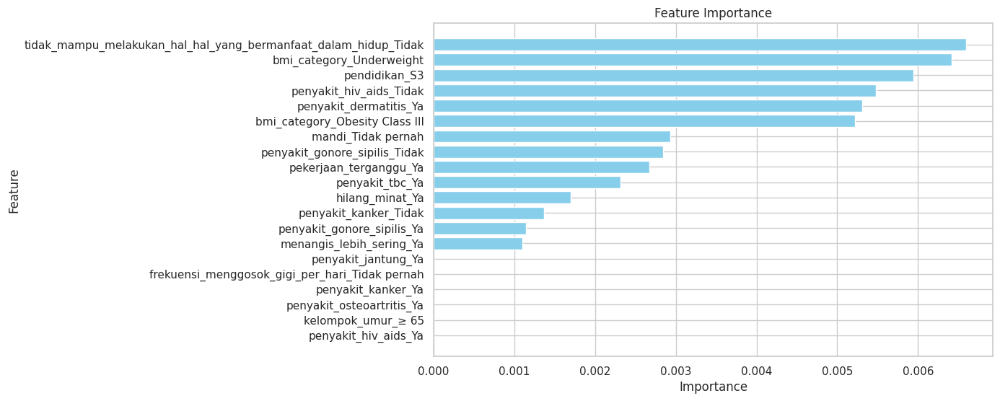

In [ ]:
feature_importance_viz_tail_20(X, catboost_model)

##Model 4 (～￣▽￣)～
---
Hilang Minat ~ X

In [ ]:
df.columns

Index(['wilayah', 'jenis_kelamin', 'usia', 'lama_berdinas', 'pendidikan',
       'tinggi', 'berat', 'lingkar_pinggang', 'status_kawin', 'pengeluaran',
       'penyakit_jantung', 'penyakit_stroke', 'penyakit_diabetes_melitus',
       'penyakit_hipertensi', 'penyakit_kanker', 'penyakit_ginjal',
       'penyakit_tumor', 'penyakit_osteoartritis', 'penyakit_lambung',
       'penyakit_liver', 'penyakit_tbc', 'penyakit_dbd', 'penyakit_covid19',
       'penyakit_hiv_aids', 'penyakit_diare', 'penyakit_malaria',
       'penyakit_gonore_sipilis', 'penyakit_thypus', 'penyakit_dermatitis',
       'penyakit_mikosis', 'sakit_kepala', 'tidak_nafsu_makan', 'sulit_tidur',
       'mudah_takut', 'tegang,_cemas_atau_kuatir', 'tangan_anda_gemetar',
       'masalah_pencernaan', 'sulit_untuk_berpikir_jernih', 'tidak_bahagia',
       'menangis_lebih_sering', 'sulit_untuk_menikmati_kegiatan_sehari_hari',
       'sulit_untuk_mengambil_keputusan', 'pekerjaan_terganggu',
       'tidak_mampu_melakukan_hal_hal_yang_

In [ ]:
X = df.copy()
X.drop(['lingkar_pinggang'], axis=1, inplace=True)

X.dropna(inplace=True)
y = X['hilang_minat'].copy()
X.drop(['hilang_minat', 'tinggi', 'berat'], axis=1, inplace=True)

X = pd.get_dummies(X)

In [ ]:
y.unique()

['Tidak', 'Kadang - kadang', 'Ya']
Categories (3, object): ['Kadang - kadang', 'Tidak', 'Ya']

In [ ]:
y.value_counts()

Tidak              273303
Kadang - kadang      8246
Ya                    736
Name: hilang_minat, dtype: int64

In [ ]:
rus = RandomUnderSampler(sampling_strategy='auto', random_state=42, replacement=True)# fit predictor and target variable
X, y = rus.fit_resample(X, y)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

In [ ]:
adaboost_model = AdaBoostClassifier()
adaboost_model.fit(X_train, y_train)

AdaBoostClassifier()

In [ ]:
y_pred = adaboost_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
classification_report_str = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print("\nClassification Report:\n", classification_report_str)

Accuracy: 0.6875

Classification Report:
                  precision    recall  f1-score   support

Kadang - kadang       0.64      0.61      0.62       370
          Tidak       0.70      0.85      0.76       364
             Ya       0.73      0.61      0.67       370

       accuracy                           0.69      1104
      macro avg       0.69      0.69      0.68      1104
   weighted avg       0.69      0.69      0.68      1104



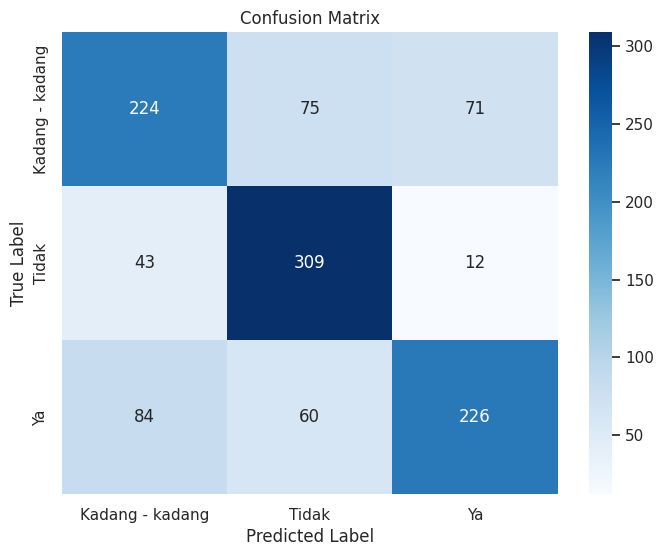

In [ ]:
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=np.unique(y),
            yticklabels=np.unique(y))
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

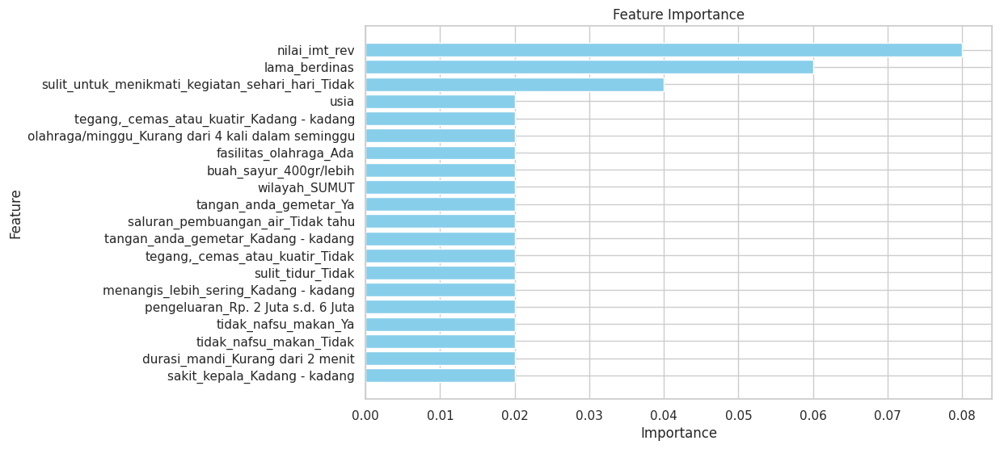

In [ ]:
feature_importance_viz_top_20(X, adaboost_model)

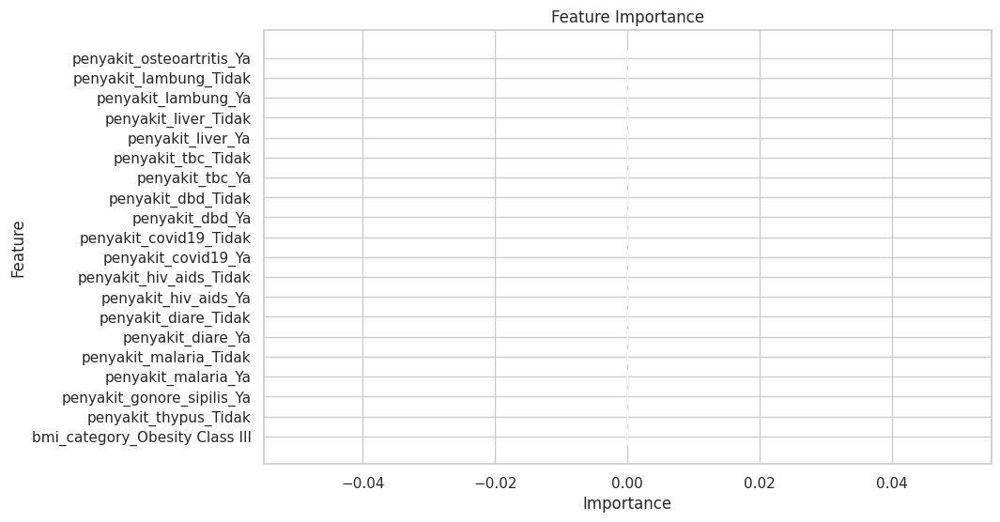

In [ ]:
feature_importance_viz_tail_20(X, adaboost_model)

In [ ]:
X = pd.get_dummies(X, drop_first=True)
class_mapping = {'Tidak': 0, 'Kadang - kadang': 1, 'Ya': 2}
y = np.array([class_mapping[label] for label in y])

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

In [ ]:
from sklearn.utils import class_weight

classes_weights = class_weight.compute_sample_weight(
    class_weight='balanced',
    y=y_train
)

xgboost_model = xgb.XGBClassifier(xgb.XGBClassifier(objective='multi:softmax',
                                                    num_class=len(set(y_train)),
                                                    eval_metric='mlogloss',
                                                    sample_weight=classes_weights))

xgboost_model.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

In [ ]:
y_pred = xgboost_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
classification_report_str = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print("\nClassification Report:\n", classification_report_str)

Accuracy: 0.7110507246376812

Classification Report:
               precision    recall  f1-score   support

           0       0.72      0.82      0.77       364
           1       0.66      0.70      0.68       370
           2       0.77      0.61      0.68       370

    accuracy                           0.71      1104
   macro avg       0.72      0.71      0.71      1104
weighted avg       0.72      0.71      0.71      1104



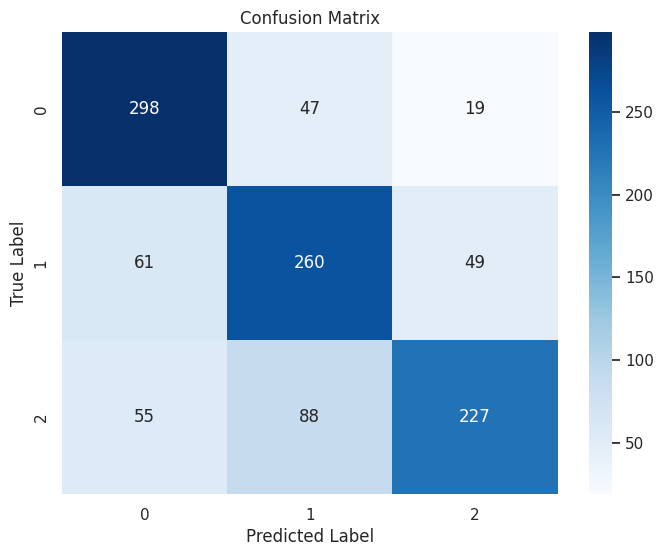

In [ ]:
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=np.unique(y),
            yticklabels=np.unique(y))
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

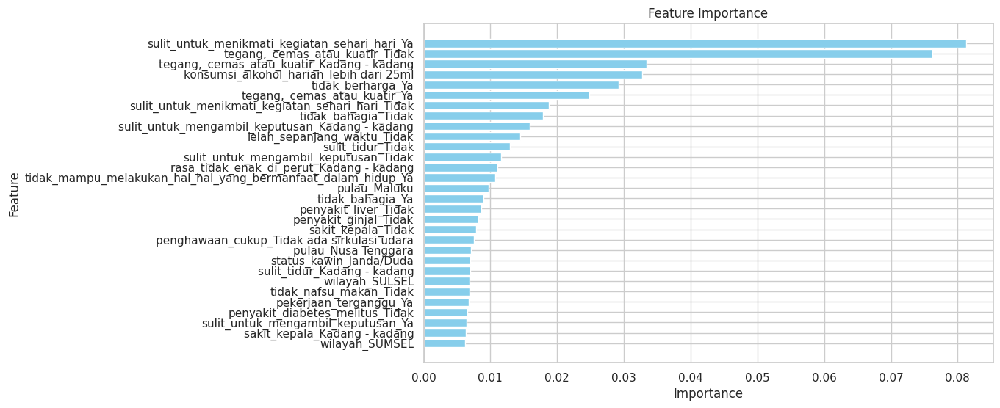

In [ ]:
feature_importance_viz_top_custom(X, xgboost_model, 30)

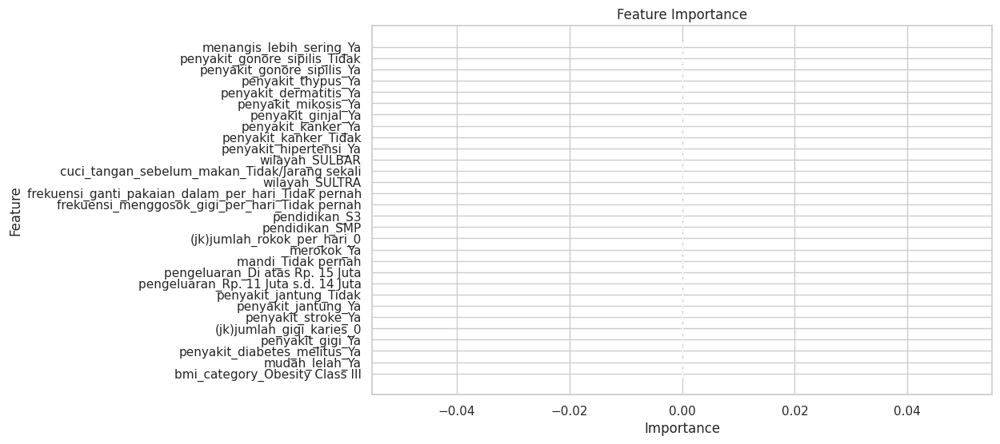

In [ ]:
feature_importance_viz_tail_custom(X, xgboost_model, 30)

In [ ]:
# Create a CatBoost classifier
catboost_model = CatBoostClassifier(loss_function='MultiClass', custom_metric=['F1'])

# Train the CatBoost model
catboost_model.fit(X_train, y_train, verbose=0)

# Make predictions on the test set
y_pred = catboost_model.predict(X_test)

In [ ]:
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")
print("\nClassification Report:\n", classification_report(y_test, y_pred))

Accuracy: 0.7047101449275363

Classification Report:
               precision    recall  f1-score   support

           0       0.70      0.83      0.76       364
           1       0.66      0.69      0.68       370
           2       0.76      0.60      0.67       370

    accuracy                           0.70      1104
   macro avg       0.71      0.71      0.70      1104
weighted avg       0.71      0.70      0.70      1104



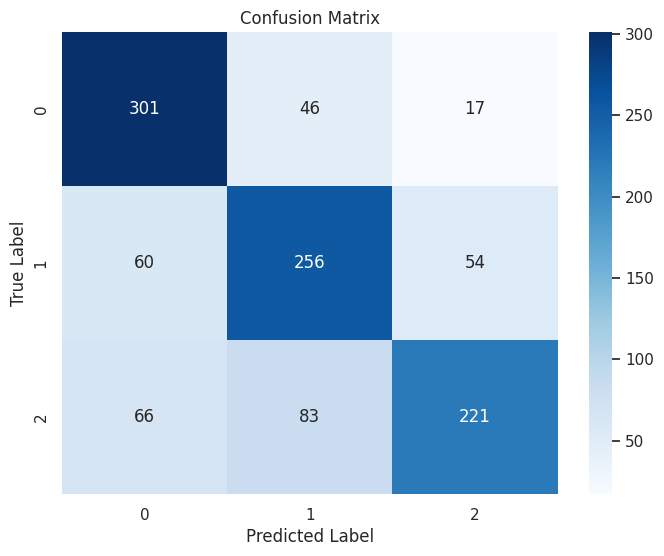

In [ ]:
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=np.unique(y),
            yticklabels=np.unique(y))
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

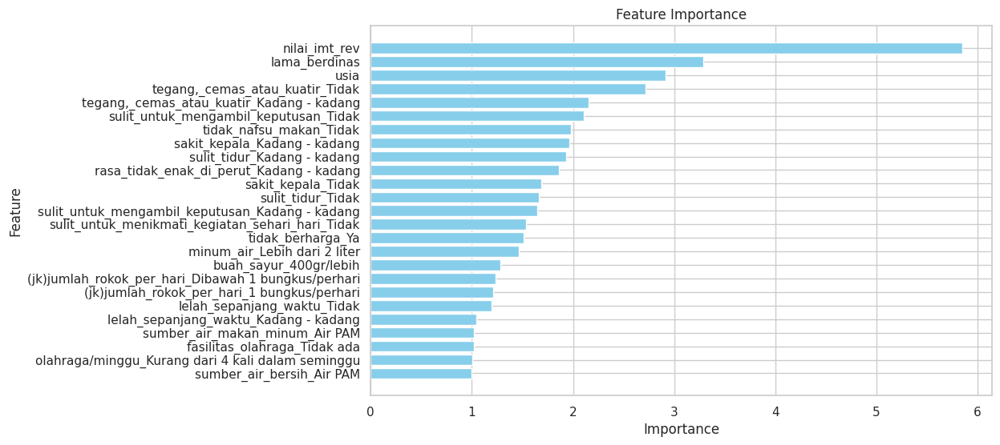

In [ ]:
feature_importance_viz_top_custom(X, catboost_model, 25)

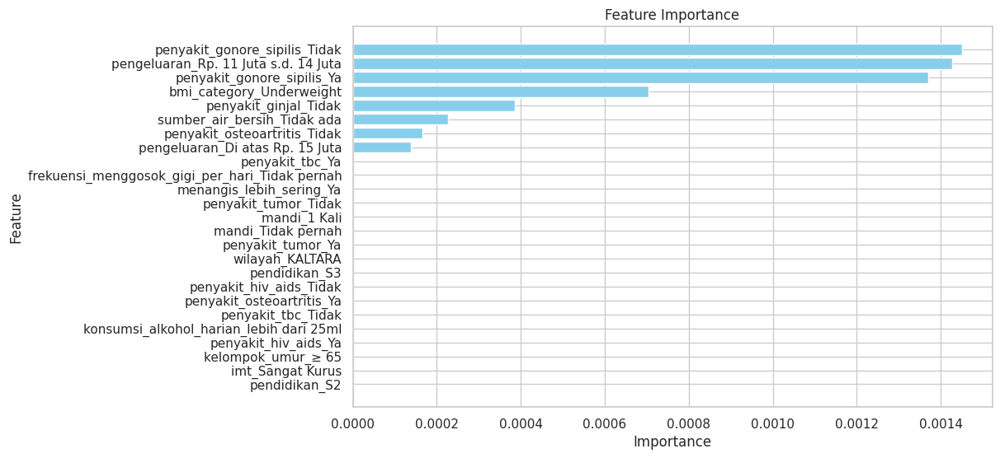

In [ ]:
feature_importance_viz_tail_custom(X, catboost_model, 25)

In [ ]:
from sklearn.base import BaseEstimator, ClassifierMixin

# Create a wrapper class for CatBoostClassifier
class CatBoostWrapper(BaseEstimator, ClassifierMixin):
    def __init__(self):
        self.catboost_model = CatBoostClassifier(loss_function='MultiClass', custom_metric=['F1'])

    def fit(self, X, y):
        self.catboost_model.fit(X, y, verbose=0)
        return self

    def predict(self, X):
        return self.catboost_model.predict(X)

# Create an instance of the wrapper class
catboost_wrapper = CatBoostWrapper()

# Define scoring metrics
scoring = {'accuracy': make_scorer(accuracy_score),
           'f1_macro': make_scorer(f1_score, average='macro')}

# Perform cross-validated training and evaluation
cv_results = cross_validate(catboost_wrapper, X, y, cv=10, scoring=scoring, return_train_score=False)

In [ ]:
print("Cross-Validation Results:")
print("Accuracy: {:.4f} (+/- {:.4f})".format(cv_results['test_accuracy'].mean(), cv_results['test_accuracy'].std() * 2))
print("F1 (macro): {:.4f} (+/- {:.4f})".format(cv_results['test_f1_macro'].mean(), cv_results['test_f1_macro'].std() * 2))

Cross-Validation Results:
Accuracy: 0.6897 (+/- 0.0584)
F1 (macro): 0.6829 (+/- 0.0619)


## <h2> Model 1 (tegang cemas kuatir dengan variabel kebiasaan hidup) </h2> ##

In [ ]:
df.columns

Index(['wilayah', 'jenis_kelamin', 'usia', 'lama_berdinas', 'pendidikan',
       'tinggi', 'berat', 'lingkar_pinggang', 'status_kawin', 'pengeluaran',
       'penyakit_jantung', 'penyakit_stroke', 'penyakit_diabetes_melitus',
       'penyakit_hipertensi', 'penyakit_kanker', 'penyakit_ginjal',
       'penyakit_tumor', 'penyakit_osteoartritis', 'penyakit_lambung',
       'penyakit_liver', 'penyakit_tbc', 'penyakit_dbd', 'penyakit_covid19',
       'penyakit_hiv_aids', 'penyakit_diare', 'penyakit_malaria',
       'penyakit_gonore_sipilis', 'penyakit_thypus', 'penyakit_dermatitis',
       'penyakit_mikosis', 'sakit_kepala', 'tidak_nafsu_makan', 'sulit_tidur',
       'mudah_takut', 'tegang,_cemas_atau_kuatir', 'tangan_anda_gemetar',
       'masalah_pencernaan', 'sulit_untuk_berpikir_jernih', 'tidak_bahagia',
       'menangis_lebih_sering', 'sulit_untuk_menikmati_kegiatan_sehari_hari',
       'sulit_untuk_mengambil_keputusan', 'pekerjaan_terganggu',
       'tidak_mampu_melakukan_hal_hal_yang_

In [ ]:
df['tegang,_cemas_atau_kuatir'].unique()

['Tidak', 'Kadang - kadang', 'Ya']
Categories (3, object): ['Kadang - kadang', 'Tidak', 'Ya']

In [ ]:
category_mapping = {'Tidak': 0, 'Kadang - kadang': 1, 'Ya': 1}
df['tegang,_cemas_atau_kuatir'] = df['tegang,_cemas_atau_kuatir'].map(category_mapping)

In [ ]:
df['tegang,_cemas_atau_kuatir'].value_counts()

0    256243
1     32411
Name: tegang,_cemas_atau_kuatir, dtype: int64

In [ ]:
X = df[['olahraga/minggu', 'minum_air', 'buah_sayur', 'mandi', 'durasi_mandi', 'konsumsi_gula_harian',
        'konsumsi_alkohol_harian', 'konsumsi_junk_food_harian', 'frekuensi_menggosok_gigi_per_hari',
        'durasi_menggosok_gigi', 'frekuensi_ganti_pakaian_dalam_per_hari',
        'cuci_tangan_sebelum_makan', 'tegang,_cemas_atau_kuatir']].copy()

X.dropna(inplace=True)
y = X['tegang,_cemas_atau_kuatir']
X.drop(['tegang,_cemas_atau_kuatir'], axis=1, inplace=True)

X = pd.get_dummies(X, drop_first=True)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

In [ ]:
y_train.value_counts()

0    127260
1     16184
Name: tegang,_cemas_atau_kuatir, dtype: int64

### <h2> AdaBoost </h2> ###

In [ ]:
adaboost_model = AdaBoostClassifier()
adaboost_model.fit(X_train, y_train)
y_pred = adaboost_model.predict(X_test)

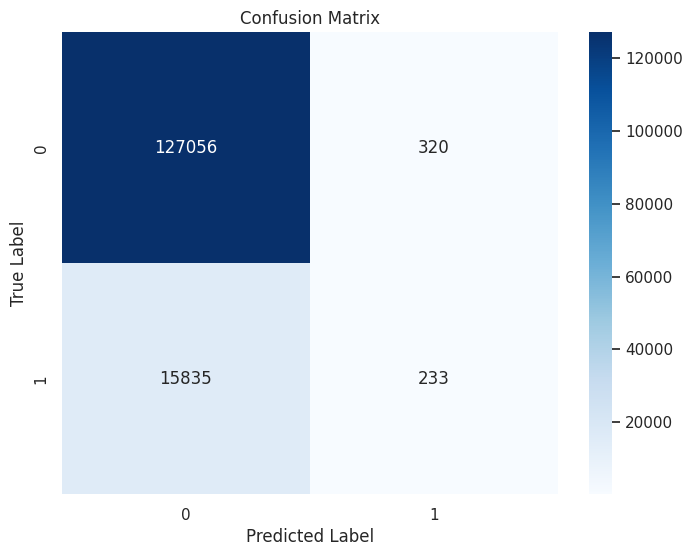


Accuracy: 0.8873776526031064
Balanced accuracy: 0.5059943120459314

Classification Report:
               precision    recall  f1-score   support

           0       0.89      1.00      0.94    127376
           1       0.42      0.01      0.03     16068

    accuracy                           0.89    143444
   macro avg       0.66      0.51      0.48    143444
weighted avg       0.84      0.89      0.84    143444



In [ ]:
eval_func(y_test, y_pred)

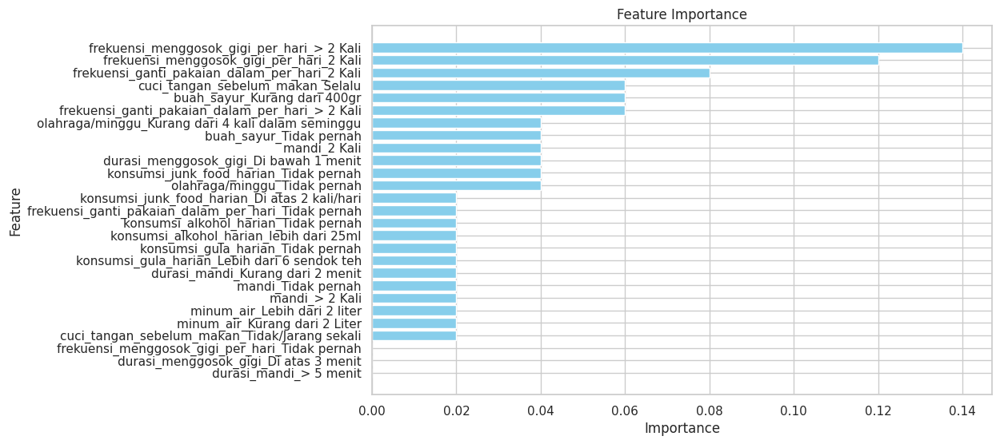

In [ ]:
feature_importance_viz(X, adaboost_model)

### <h2> BalancedRandomForestClassifier </h2> ###

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier

model = BalancedRandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

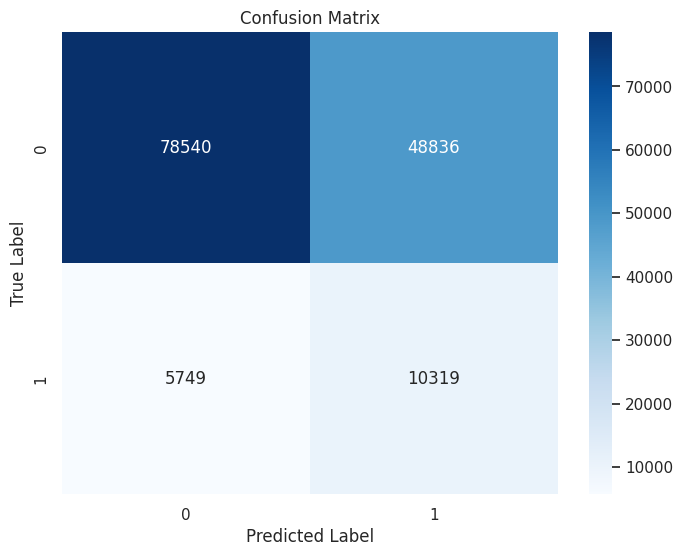


Accuracy: 0.6194682245336159
Balanced accuracy: 0.6294038944584749

Classification Report:
               precision    recall  f1-score   support

           0       0.93      0.62      0.74    127376
           1       0.17      0.64      0.27     16068

    accuracy                           0.62    143444
   macro avg       0.55      0.63      0.51    143444
weighted avg       0.85      0.62      0.69    143444



In [ ]:
eval_func(y_test, y_pred)

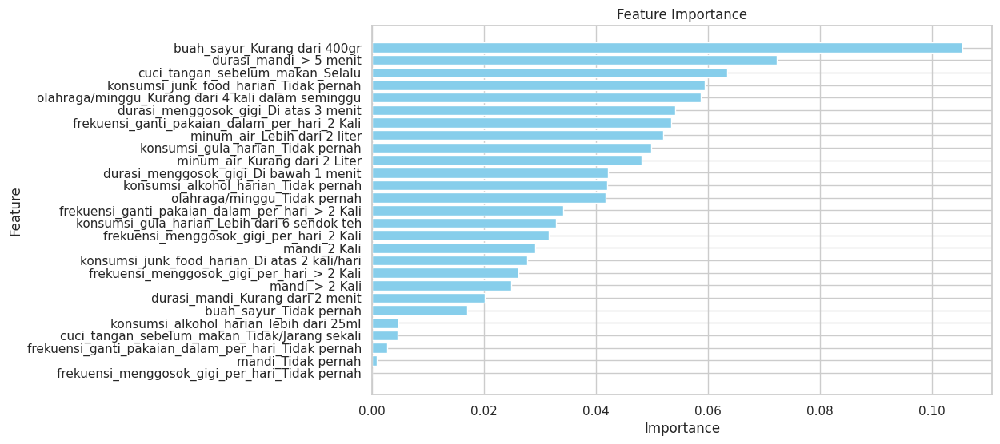

In [ ]:
feature_importance_viz(X, model)

### <h2> Logistic Regression </h2> ###

In [ ]:
from sklearn.utils.class_weight import compute_class_weight

class_weights = compute_class_weight(class_weight = "balanced", classes = np.unique(y_train), y = y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))

# Train a logistic regression model with class weighting
log_reg = LogisticRegression(class_weight=class_weights)
log_reg.fit(X_train, y_train)

# Make predictions on the test set
y_pred = log_reg.predict(X_test)

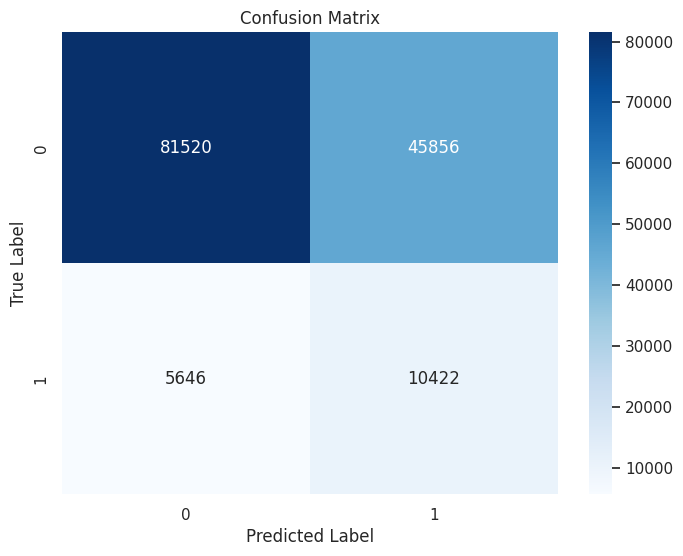


Accuracy: 0.6409609324893338
Balanced accuracy: 0.6443066737124663

Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.64      0.76    127376
           1       0.19      0.65      0.29     16068

    accuracy                           0.64    143444
   macro avg       0.56      0.64      0.52    143444
weighted avg       0.85      0.64      0.71    143444



In [ ]:
eval_func(y_test, y_pred)

In [ ]:
log_reg.coef_

array([[ 3.92971928e-01,  9.59355558e-01,  4.13634963e-01,
        -3.86420268e-02,  6.03795500e-01,  9.87227062e-01,
        -3.31391814e-01, -2.37736797e-01, -1.24546474e+00,
         2.97671607e-05,  1.97998449e-01,  3.06080423e-01,
         1.22861033e-01, -7.42588692e-01, -7.69997798e-02,
         4.36477615e-01, -4.94572802e-01, -2.36214786e-01,
        -4.03578342e-01,  0.00000000e+00,  1.85128760e-02,
         1.91238381e-01, -1.82533719e-01, -2.11753757e-01,
         4.92571738e-01, -5.58135300e-01, -3.39534796e-01]])

### <h2> CatBoost </h2> ###

In [ ]:
class_weights = compute_class_weight(class_weight = "balanced", classes = np.unique(y_train), y = y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))

# Create a CatBoost classifier with class weights
catboost_model = CatBoostClassifier(loss_function='Logloss', custom_metric=['F1'], class_weights=class_weights)

# Train the CatBoost model
catboost_model.fit(X_train, y_train, silent=True)

# Make predictions on the test set
y_pred = catboost_model.predict(X_test)

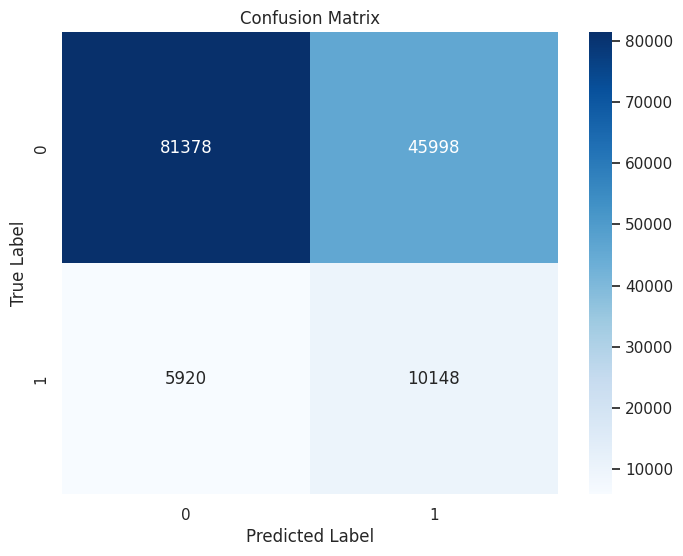


Accuracy: 0.6380608460444493
Balanced accuracy: 0.6352230054831969

Classification Report:
               precision    recall  f1-score   support

           0       0.93      0.64      0.76    127376
           1       0.18      0.63      0.28     16068

    accuracy                           0.64    143444
   macro avg       0.56      0.64      0.52    143444
weighted avg       0.85      0.64      0.70    143444



In [ ]:
eval_func(y_test, y_pred)

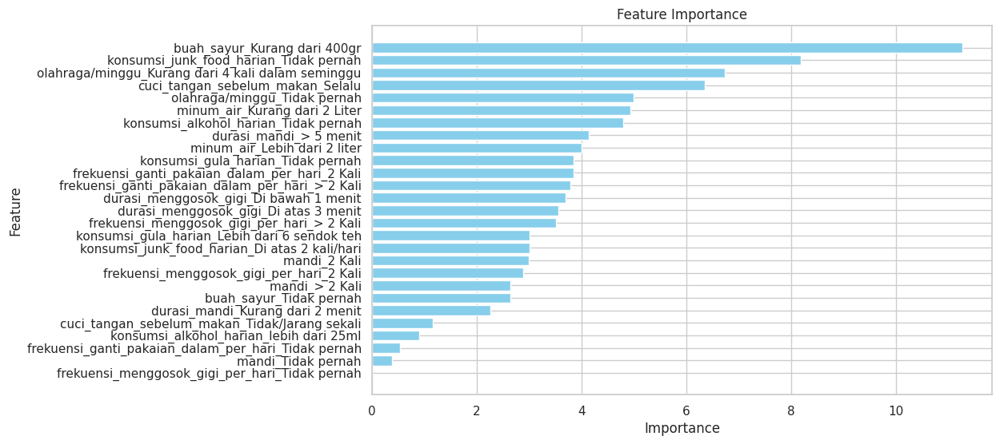

In [ ]:
feature_importance_viz(X, catboost_model)

## <h2> Model 2 (ingin bundir dengan variabel kebiasaan hidup) </h2> ##

In [ ]:
df['ingin_bundir'].unique()

array([0, 1])

In [ ]:
df['ingin_bundir'].value_counts()

0    287545
1      1109
Name: ingin_bundir, dtype: int64

In [ ]:
X = df[['olahraga/minggu', 'minum_air', 'buah_sayur', 'mandi', 'durasi_mandi', 'konsumsi_gula_harian',
        'konsumsi_alkohol_harian', 'konsumsi_junk_food_harian', 'frekuensi_menggosok_gigi_per_hari',
        'durasi_menggosok_gigi', 'frekuensi_ganti_pakaian_dalam_per_hari',
        'cuci_tangan_sebelum_makan', 'ingin_bundir']].copy()

X.dropna(inplace=True)
y = X['ingin_bundir']
X.drop(['ingin_bundir'], axis=1, inplace=True)

X = pd.get_dummies(X, drop_first=True)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

### <h2> AdaBoost </h2> ###

In [ ]:
adaboost_model = AdaBoostClassifier()
adaboost_model.fit(X_train, y_train)
y_pred = adaboost_model.predict(X_test)

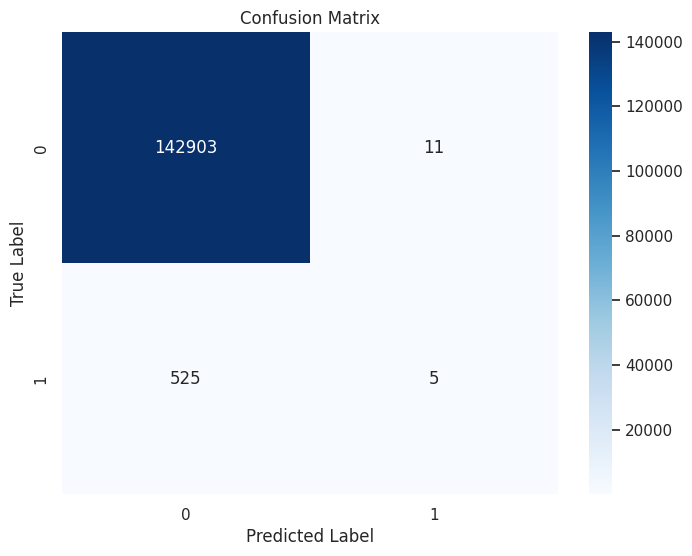


Accuracy: 0.9962633501575527
Balanced accuracy: 0.5046784964489793

Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    142914
           1       0.31      0.01      0.02       530

    accuracy                           1.00    143444
   macro avg       0.65      0.50      0.51    143444
weighted avg       0.99      1.00      0.99    143444



In [ ]:
eval_func(y_test, y_pred)

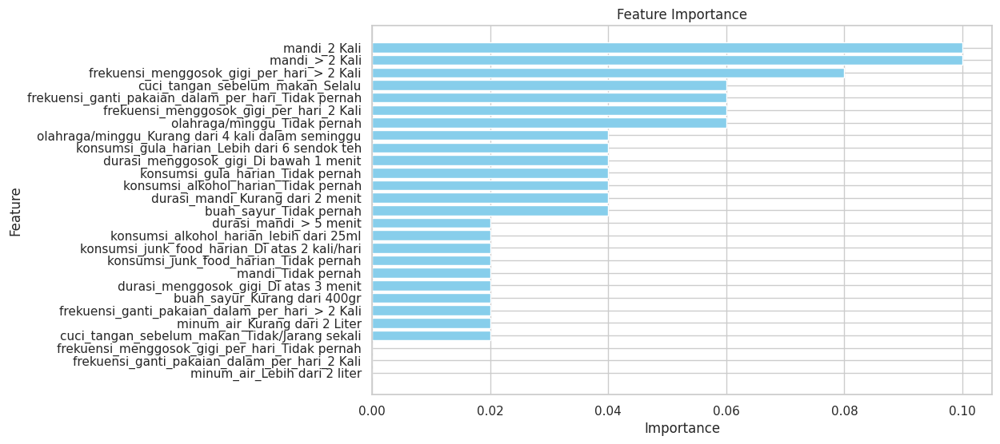

In [ ]:
feature_importance_viz(X, adaboost_model)

### <h2> BalancedRandomForestClassifier </h2> ###

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier

model = BalancedRandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

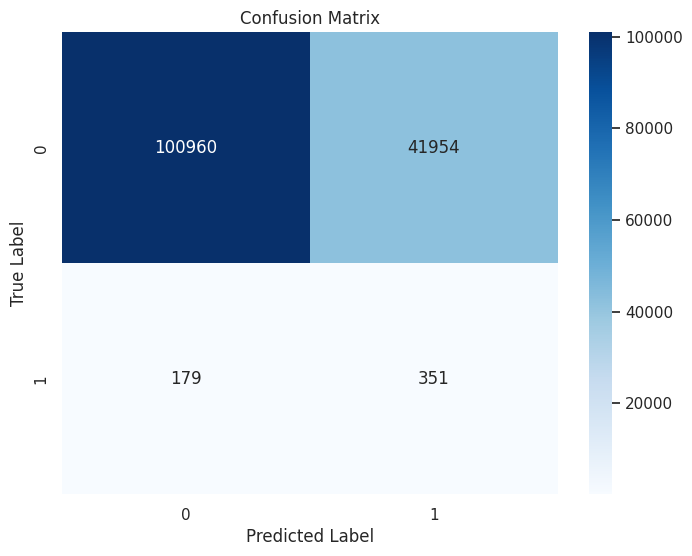


Accuracy: 0.7062756197540504
Balanced accuracy: 0.6843514941430668

Classification Report:
               precision    recall  f1-score   support

           0       1.00      0.71      0.83    142914
           1       0.01      0.66      0.02       530

    accuracy                           0.71    143444
   macro avg       0.50      0.68      0.42    143444
weighted avg       0.99      0.71      0.82    143444



In [ ]:
eval_func(y_test, y_pred)

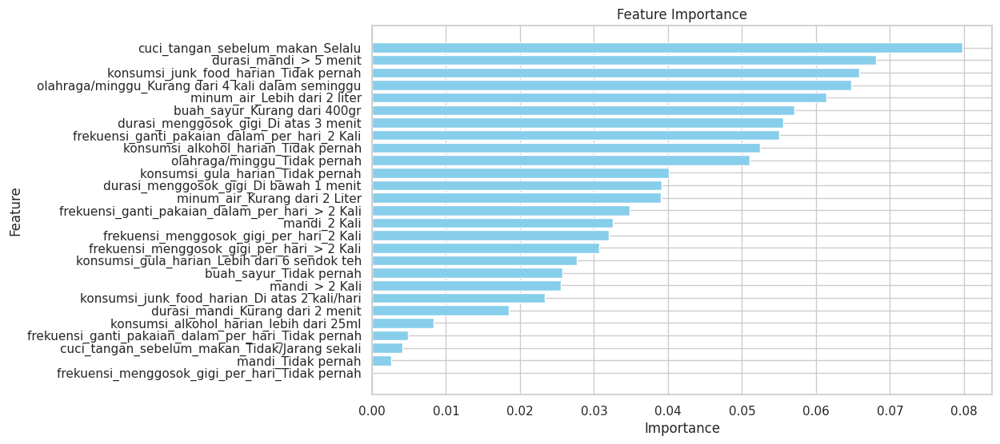

In [ ]:
feature_importance_viz(X, model)

### <h2> Logistic Regression </h2> ###

In [ ]:
from sklearn.utils.class_weight import compute_class_weight

class_weights = compute_class_weight(class_weight = "balanced", classes = np.unique(y_train), y = y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))

# Train a logistic regression model with class weighting
log_reg = LogisticRegression(class_weight=class_weights)
log_reg.fit(X_train, y_train)

# Make predictions on the test set
y_pred = log_reg.predict(X_test)

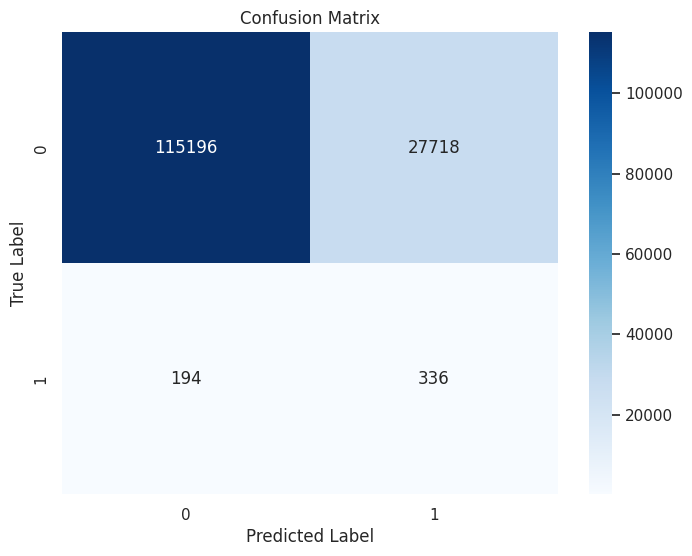


Accuracy: 0.8054153537268899
Balanced accuracy: 0.7200067278883382

Classification Report:
               precision    recall  f1-score   support

           0       1.00      0.81      0.89    142914
           1       0.01      0.63      0.02       530

    accuracy                           0.81    143444
   macro avg       0.51      0.72      0.46    143444
weighted avg       0.99      0.81      0.89    143444



In [ ]:
eval_func(y_test, y_pred)

In [ ]:
log_reg.coef_

array([[ 0.13270269,  1.12882903,  0.35588953,  0.02262801,  0.50844614,
         1.86395826, -1.20509569, -0.95643961,  1.0576954 ,  0.06319828,
         0.67351687,  0.56822981,  0.14966268, -1.16320677,  1.18598062,
         0.50523619,  0.06759626, -0.4007056 , -0.80481443,  0.        ,
         0.06607724,  0.29521232,  0.04106614,  0.14047946,  1.18931672,
        -0.88488636,  0.28332331]])

### <h2> CatBoost </h2> ###

In [ ]:
class_weights = compute_class_weight(class_weight = "balanced", classes = np.unique(y_train), y = y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))

# Create a CatBoost classifier with class weights
catboost_model = CatBoostClassifier(loss_function='Logloss', custom_metric=['F1'], class_weights=class_weights)

# Train the CatBoost model
catboost_model.fit(X_train, y_train, silent=True)

# Make predictions on the test set
y_pred = catboost_model.predict(X_test)

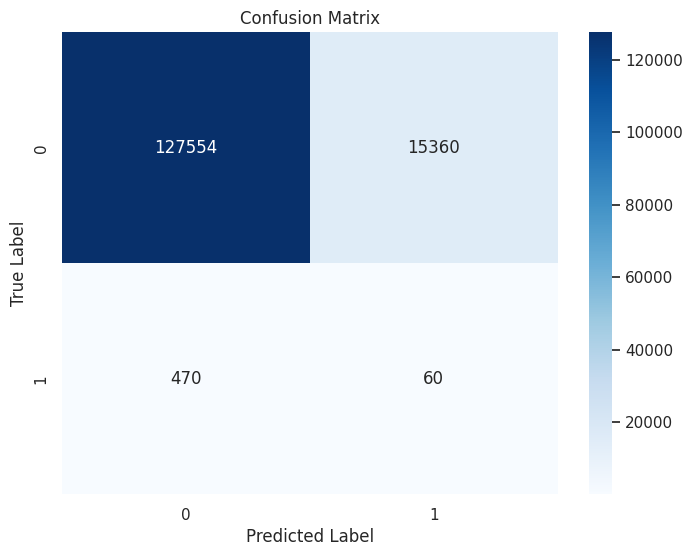


Accuracy: 0.8896433451381723
Balanced accuracy: 0.5028651615524946

Classification Report:
               precision    recall  f1-score   support

           0       1.00      0.89      0.94    142914
           1       0.00      0.11      0.01       530

    accuracy                           0.89    143444
   macro avg       0.50      0.50      0.47    143444
weighted avg       0.99      0.89      0.94    143444



In [ ]:
eval_func(y_test, y_pred)

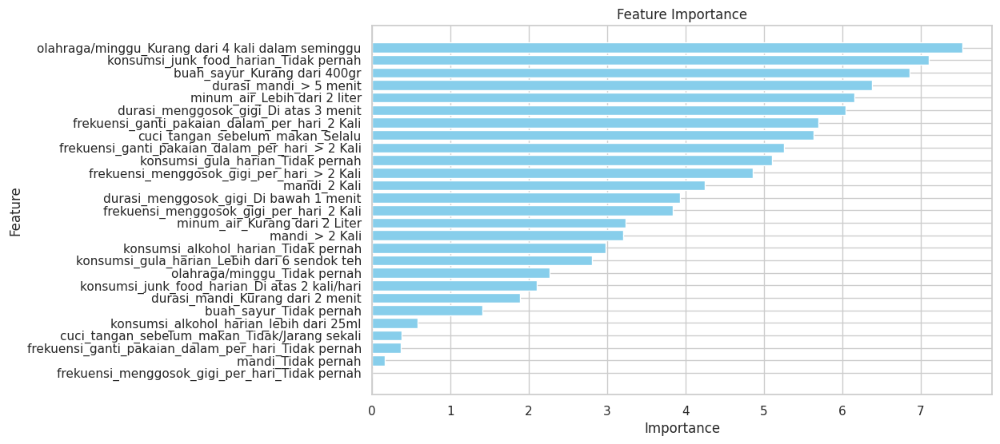

In [ ]:
feature_importance_viz(X, catboost_model)

## <h2> Model 3 (tidak bahagia dengan variabel kebiasaan hidup) </h2> ##

In [ ]:
df['tidak_bahagia'].unique()

In [ ]:
category_mapping = {'Tidak': 0, 'Kadang - kadang': 1, 'Ya': 1}
df['tidak_bahagia'] = df['tidak_bahagia'].map(category_mapping)

In [ ]:
df['tidak_bahagia'].value_counts()

In [ ]:
X = df[['olahraga/minggu', 'minum_air', 'buah_sayur', 'mandi', 'durasi_mandi', 'konsumsi_gula_harian',
        'konsumsi_alkohol_harian', 'konsumsi_junk_food_harian', 'frekuensi_menggosok_gigi_per_hari',
        'durasi_menggosok_gigi', 'frekuensi_ganti_pakaian_dalam_per_hari',
        'cuci_tangan_sebelum_makan', 'tidak_bahagia']].copy()

X.dropna(inplace=True)
y = X['tidak_bahagia']
X.drop(['tidak_bahagia'], axis=1, inplace=True)

X = pd.get_dummies(X, drop_first=True)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

### <h2> AdaBoost </h2> ###

In [ ]:
adaboost_model = AdaBoostClassifier()
adaboost_model.fit(X_train, y_train)
y_pred = adaboost_model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, adaboost_model)

### <h2> BalancedRandomForestClassifier </h2> ###

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier

model = BalancedRandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, model)

### <h2> Logistic Regression </h2> ###

In [ ]:
from sklearn.utils.class_weight import compute_class_weight

class_weights = compute_class_weight(class_weight = "balanced", classes = np.unique(y_train), y = y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))

# Train a logistic regression model with class weighting
log_reg = LogisticRegression(class_weight=class_weights)
log_reg.fit(X_train, y_train)

# Make predictions on the test set
y_pred = log_reg.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
log_reg.coef_

### <h2> CatBoost </h2> ###

In [ ]:
class_weights = compute_class_weight(class_weight = "balanced", classes = np.unique(y_train), y = y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))

# Create a CatBoost classifier with class weights
catboost_model = CatBoostClassifier(loss_function='Logloss', custom_metric=['F1'], class_weights=class_weights)

# Train the CatBoost model
catboost_model.fit(X_train, y_train, silent=True)

# Make predictions on the test set
y_pred = catboost_model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, catboost_model)

## <h2> Model 4 (tegang cemas kuatir dengan variabel penyakit dll) </h2> ##

In [ ]:
df.columns

In [ ]:
df['tegang,_cemas_atau_kuatir'].value_counts()

In [ ]:
X = df[['jenis_kelamin', 'usia', 'lama_berdinas', 'pendidikan',
       'tinggi', 'berat', 'lingkar_pinggang', 'status_kawin', 'pengeluaran',
       'penyakit_jantung', 'penyakit_stroke', 'penyakit_diabetes_melitus',
       'penyakit_hipertensi', 'penyakit_kanker', 'penyakit_ginjal',
       'penyakit_tumor', 'penyakit_osteoartritis', 'penyakit_lambung',
       'penyakit_liver', 'penyakit_tbc', 'penyakit_dbd', 'penyakit_covid19',
       'penyakit_hiv_aids', 'penyakit_diare', 'penyakit_malaria',
       'penyakit_gonore_sipilis', 'penyakit_thypus', 'penyakit_dermatitis',
       'penyakit_mikosis', 'sakit_kepala', 'imt', 'nilai_imt_rev', 'tegang,_cemas_atau_kuatir']].copy()

X.dropna(inplace=True)
y = X['tegang,_cemas_atau_kuatir']
X.drop(['tegang,_cemas_atau_kuatir'], axis=1, inplace=True)

X = pd.get_dummies(X, drop_first=True)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

In [ ]:
y_train.value_counts()

### <h2> AdaBoost </h2> ###

In [ ]:
adaboost_model = AdaBoostClassifier()
adaboost_model.fit(X_train, y_train)
y_pred = adaboost_model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, adaboost_model)

### <h2> BalancedRandomForestClassifier </h2> ###

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier

model = BalancedRandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, model)

### <h2> Logistic Regression </h2> ###

In [ ]:
from sklearn.utils.class_weight import compute_class_weight

class_weights = compute_class_weight(class_weight = "balanced", classes = np.unique(y_train), y = y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))

# Train a logistic regression model with class weighting
log_reg = LogisticRegression(class_weight=class_weights)
log_reg.fit(X_train, y_train)

# Make predictions on the test set
y_pred = log_reg.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
log_reg.coef_

### <h2> CatBoost </h2> ###

In [ ]:
class_weights = compute_class_weight(class_weight = "balanced", classes = np.unique(y_train), y = y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))

# Create a CatBoost classifier with class weights
catboost_model = CatBoostClassifier(loss_function='Logloss', custom_metric=['F1'], class_weights=class_weights)

# Train the CatBoost model
catboost_model.fit(X_train, y_train, silent=True)

# Make predictions on the test set
y_pred = catboost_model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, catboost_model)

## <h2> Model 5 (ingin bundir dengan variabel penyakit dll) </h2> ##

In [ ]:
df.columns

In [ ]:
df['ingin_bundir'].value_counts()

In [ ]:
X = df[['jenis_kelamin', 'usia', 'lama_berdinas', 'pendidikan',
       'tinggi', 'berat', 'lingkar_pinggang', 'status_kawin', 'pengeluaran',
       'penyakit_jantung', 'penyakit_stroke', 'penyakit_diabetes_melitus',
       'penyakit_hipertensi', 'penyakit_kanker', 'penyakit_ginjal',
       'penyakit_tumor', 'penyakit_osteoartritis', 'penyakit_lambung',
       'penyakit_liver', 'penyakit_tbc', 'penyakit_dbd', 'penyakit_covid19',
       'penyakit_hiv_aids', 'penyakit_diare', 'penyakit_malaria',
       'penyakit_gonore_sipilis', 'penyakit_thypus', 'penyakit_dermatitis',
       'penyakit_mikosis', 'sakit_kepala', 'imt', 'nilai_imt_rev', 'ingin_bundir']].copy()

X.dropna(inplace=True)
y = X['ingin_bundir']
X.drop(['ingin_bundir'], axis=1, inplace=True)

X = pd.get_dummies(X, drop_first=True)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

In [ ]:
y_train.value_counts()

### <h2> AdaBoost </h2> ###

In [ ]:
adaboost_model = AdaBoostClassifier()
adaboost_model.fit(X_train, y_train)
y_pred = adaboost_model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, adaboost_model)

### <h2> BalancedRandomForestClassifier </h2> ###

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier

model = BalancedRandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, model)

### <h2> Logistic Regression </h2> ###

In [ ]:
from sklearn.utils.class_weight import compute_class_weight

class_weights = compute_class_weight(class_weight = "balanced", classes = np.unique(y_train), y = y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))

# Train a logistic regression model with class weighting
log_reg = LogisticRegression(class_weight=class_weights)
log_reg.fit(X_train, y_train)

# Make predictions on the test set
y_pred = log_reg.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
log_reg.coef_

### <h2> CatBoost </h2> ###

In [ ]:
class_weights = compute_class_weight(class_weight = "balanced", classes = np.unique(y_train), y = y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))

# Create a CatBoost classifier with class weights
catboost_model = CatBoostClassifier(loss_function='Logloss', custom_metric=['F1'], class_weights=class_weights)

# Train the CatBoost model
catboost_model.fit(X_train, y_train, silent=True)

# Make predictions on the test set
y_pred = catboost_model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, catboost_model)

## <h2> Model 6 (tidak bahagia dengan variabel penyakit dll) </h2> ##

In [ ]:
df.columns

In [ ]:
df['tidak_bahagia'].value_counts()

In [ ]:
X = df[['jenis_kelamin', 'usia', 'lama_berdinas', 'pendidikan',
       'tinggi', 'berat', 'lingkar_pinggang', 'status_kawin', 'pengeluaran',
       'penyakit_jantung', 'penyakit_stroke', 'penyakit_diabetes_melitus',
       'penyakit_hipertensi', 'penyakit_kanker', 'penyakit_ginjal',
       'penyakit_tumor', 'penyakit_osteoartritis', 'penyakit_lambung',
       'penyakit_liver', 'penyakit_tbc', 'penyakit_dbd', 'penyakit_covid19',
       'penyakit_hiv_aids', 'penyakit_diare', 'penyakit_malaria',
       'penyakit_gonore_sipilis', 'penyakit_thypus', 'penyakit_dermatitis',
       'penyakit_mikosis', 'sakit_kepala', 'imt', 'nilai_imt_rev', 'tidak_bahagia']].copy()

X.dropna(inplace=True)
y = X['tidak_bahagia']
X.drop(['tidak_bahagia'], axis=1, inplace=True)

X = pd.get_dummies(X, drop_first=True)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

In [ ]:
y_train.value_counts()

### <h2> AdaBoost </h2> ###

In [ ]:
adaboost_model = AdaBoostClassifier()
adaboost_model.fit(X_train, y_train)
y_pred = adaboost_model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, adaboost_model)

### <h2> BalancedRandomForestClassifier </h2> ###

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier

model = BalancedRandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, model)

### <h2> Logistic Regression </h2> ###

In [ ]:
from sklearn.utils.class_weight import compute_class_weight

class_weights = compute_class_weight(class_weight = "balanced", classes = np.unique(y_train), y = y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))

# Train a logistic regression model with class weighting
log_reg = LogisticRegression(class_weight=class_weights)
log_reg.fit(X_train, y_train)

# Make predictions on the test set
y_pred = log_reg.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
log_reg.coef_

### <h2> CatBoost </h2> ###

In [ ]:
class_weights = compute_class_weight(class_weight = "balanced", classes = np.unique(y_train), y = y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))

# Create a CatBoost classifier with class weights
catboost_model = CatBoostClassifier(loss_function='Logloss', custom_metric=['F1'], class_weights=class_weight)

# Train the CatBoost model
catboost_model.fit(X_train, y_train, silent=True)

# Make predictions on the test set
y_pred = catboost_model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, catboost_model)

## <h2> Model 7 (tegang cemas kuatir dengan semua variabel lainnya) </h2> ##

In [ ]:
df.columns

In [ ]:
df['tegang,_cemas_atau_kuatir'].value_counts()

In [ ]:
X = df.copy()

X.dropna(inplace=True)
y = X['tegang,_cemas_atau_kuatir']
X.drop(['tegang,_cemas_atau_kuatir'], axis=1, inplace=True)

X = pd.get_dummies(X, drop_first=True)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

In [ ]:
y_train.value_counts()

### <h2> AdaBoost </h2> ###

In [ ]:
adaboost_model = AdaBoostClassifier()
adaboost_model.fit(X_train, y_train)
y_pred = adaboost_model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, adaboost_model)

In [ ]:
feature_importance_viz_top_20(X, adaboost_model)

### <h2> BalancedRandomForestClassifier </h2> ###

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier

model = BalancedRandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, model)

### <h2> Logistic Regression </h2> ###

In [ ]:
from sklearn.utils.class_weight import compute_class_weight

class_weights = compute_class_weight(class_weight = "balanced", classes = np.unique(y_train), y = y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))

# Train a logistic regression model with class weighting
log_reg = LogisticRegression(class_weight=class_weights)
log_reg.fit(X_train, y_train)

# Make predictions on the test set
y_pred = log_reg.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
log_reg.coef_

### <h2> CatBoost </h2> ###

In [ ]:
class_weights = compute_class_weight(class_weight = "balanced", classes = np.unique(y_train), y = y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))

# Create a CatBoost classifier with class weights
catboost_model = CatBoostClassifier(loss_function='Logloss', custom_metric=['F1'], class_weights=class_weights)

# Train the CatBoost model
catboost_model.fit(X_train, y_train, silent=True)

# Make predictions on the test set
y_pred = catboost_model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, catboost_model)

## <h2> Model 8 (ingin bundir dengan semua variabel lainnya) </h2> ##

In [ ]:
df.columns

In [ ]:
df['ingin_bundir'].value_counts()

In [ ]:
X = df.copy()

X.dropna(inplace=True)
y = X['ingin_bundir']
X.drop(['ingin_bundir'], axis=1, inplace=True)

X = pd.get_dummies(X, drop_first=True)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

In [ ]:
y_train.value_counts()

### <h2> AdaBoost </h2> ###

In [ ]:
adaboost_model = AdaBoostClassifier()
adaboost_model.fit(X_train, y_train)
y_pred = adaboost_model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, adaboost_model)

### <h2> BalancedRandomForestClassifier </h2> ###

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier

model = BalancedRandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, model)

### <h2> Logistic Regression </h2> ###

In [ ]:
from sklearn.utils.class_weight import compute_class_weight

class_weights = compute_class_weight(class_weight = "balanced", classes = np.unique(y_train), y = y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))

# Train a logistic regression model with class weighting
log_reg = LogisticRegression(class_weight=class_weights)
log_reg.fit(X_train, y_train)

# Make predictions on the test set
y_pred = log_reg.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
log_reg.coef_

### <h2> CatBoost </h2> ###

In [ ]:
class_weights = compute_class_weight(class_weight = "balanced", classes = np.unique(y_train), y = y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))

# Create a CatBoost classifier with class weights
catboost_model = CatBoostClassifier(loss_function='Logloss', custom_metric=['F1'], class_weights=class_weights)

# Train the CatBoost model
catboost_model.fit(X_train, y_train, silent=True)

# Make predictions on the test set
y_pred = catboost_model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, catboost_model)

## <h2> Model 9 (tidak bahagia dengan semua variabel lainnya) </h2> ##

In [ ]:
df.columns

In [ ]:
df['tidak_bahagia'].value_counts()

In [ ]:
X = df.copy()

X.dropna(inplace=True)
y = X['tidak_bahagia']
X.drop(['tidak_bahagia'], axis=1, inplace=True)

X = pd.get_dummies(X, drop_first=True)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=42)

In [ ]:
y_train.value_counts()

### <h2> AdaBoost </h2> ###

In [ ]:
adaboost_model = AdaBoostClassifier()
adaboost_model.fit(X_train, y_train)
y_pred = adaboost_model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, adaboost_model)

### <h2> BalancedRandomForestClassifier </h2> ###

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier

model = BalancedRandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, model)

### <h2> Logistic Regression </h2> ###

In [ ]:
from sklearn.utils.class_weight import compute_class_weight

class_weights = compute_class_weight(class_weight = "balanced", classes = np.unique(y_train), y = y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))

# Train a logistic regression model with class weighting
log_reg = LogisticRegression(class_weight=class_weights)
log_reg.fit(X_train, y_train)

# Make predictions on the test set
y_pred = log_reg.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
log_reg.coef_

### <h2> CatBoost </h2> ###

In [ ]:
class_weights = compute_class_weight(class_weight = "balanced", classes = np.unique(y_train), y = y_train)
class_weights = dict(zip(np.unique(y_train), class_weights))

# Create a CatBoost classifier with class weights
catboost_model = CatBoostClassifier(loss_function='Logloss', custom_metric=['F1'], class_weights=class_weights)

# Train the CatBoost model
catboost_model.fit(X_train, y_train, silent=True)

# Make predictions on the test set
y_pred = catboost_model.predict(X_test)

In [ ]:
eval_func(y_test, y_pred)

In [ ]:
feature_importance_viz(X, catboost_model)